In [1]:
# Import necessary libraries
import os
import numpy as np
import pandas as pd
import joblib
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.optim as optim
import cvxpy as cp
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from torch.utils.data import DataLoader, TensorDataset

# Set random seed for reproducibility
np.random.seed(42)
torch.manual_seed(42)


# 1. Data Preprocessing



In [2]:
import pandas as pd
from utils.carbon import calculate_total_carbon
from utils.cost import calculate_total_cost

# Define input CSV file paths and column labels
TIME_HORIZONS = [2020, 2050, 2100]

def get_csv_file_path(time_horizon: int) -> str:
    file_name = f"{time_horizon}_merged_simulation_results.csv"
    return f"inputs/{file_name}"

# Column labels
TIME_HORIZON_LABEL = "time_horizon"
SIMULATION_ID = "Simulation ID"  # Ensure this matches your CSV
WINDOWS_U_FACTOR = 'windows_U_Factor'
GROUND_FLOOR_THERMAL_RESISTANCE = "groundfloor_thermal_resistance"
EXT_WALLS_THERMAL_RESISTANCE = "ext_walls_thermal_resistance"
ROOF_THERMAL_RESISTANCE = "roof_thermal_resistance"
ANNUAL_ENERGY_CONSUMPTION = "annual_energy_consumption"
TOTAL_COST = "total_cost"
TOTAL_CARBON_EMISSION = "total_carbon_emission"
COMFORT_DAYS = "comfort_days"

ELECTRICITY_BUILDING = "Electricity:Building"
ELECTRICITY_FACILITY = "Electricity:Facility"
GAS_CONSUMPTION = "Gas Consumption"
INDOOR_TEMPERATURE = "Zone Mean Air Temperature"

# Initialize dataframes for inputs and outputs
df_inputs = pd.DataFrame(columns=[
    SIMULATION_ID, TIME_HORIZON_LABEL, WINDOWS_U_FACTOR,
    GROUND_FLOOR_THERMAL_RESISTANCE, EXT_WALLS_THERMAL_RESISTANCE,
    ROOF_THERMAL_RESISTANCE
])

df_outputs = pd.DataFrame(columns=[
    SIMULATION_ID, ANNUAL_ENERGY_CONSUMPTION,
    TOTAL_COST, TOTAL_CARBON_EMISSION, COMFORT_DAYS
])

for time_horizon in TIME_HORIZONS:
    df = pd.read_csv(get_csv_file_path(time_horizon=time_horizon))
    
    # If 'Simulation ID' is not consistent, rename it
    if 'Simulation ID' not in df.columns and 'simulation_id' in df.columns:
        df.rename(columns={'simulation_id': 'Simulation ID'}, inplace=True)
    
    date_columns = [col for col in df.columns if col.startswith(f"{str(time_horizon)}-")]

    for simulation_id, group in df.groupby(SIMULATION_ID):
        # Inputs
        df_inputs = pd.concat([df_inputs,
            pd.DataFrame({
                SIMULATION_ID: [int(simulation_id)],
                TIME_HORIZON_LABEL: [time_horizon],
                WINDOWS_U_FACTOR: [group[WINDOWS_U_FACTOR].iloc[0]],
                GROUND_FLOOR_THERMAL_RESISTANCE: [group[GROUND_FLOOR_THERMAL_RESISTANCE].iloc[0]],
                EXT_WALLS_THERMAL_RESISTANCE: [group[EXT_WALLS_THERMAL_RESISTANCE].iloc[0]],
                ROOF_THERMAL_RESISTANCE: [group[ROOF_THERMAL_RESISTANCE].iloc[0]]
            })], ignore_index=True
        )

        # Extract values
        try:
            # Adjust based on whether 'index' is a column or part of the DataFrame index
            if 'index' in group.columns:
                electricity_building = group[group['index'].str.contains(ELECTRICITY_BUILDING)].iloc[0]
                electricity_facility = group[group['index'].str.contains(ELECTRICITY_FACILITY)].iloc[0]
                gas_consumption = group[group['index'].str.contains(GAS_CONSUMPTION)].iloc[0]
                indoor_temperature = group[group['index'].str.contains(INDOOR_TEMPERATURE)].iloc[0]
            else:
                # If 'index' is the DataFrame index
                electricity_building = group[group.index.to_series().str.contains(ELECTRICITY_BUILDING)].iloc[0]
                electricity_facility = group[group.index.to_series().str.contains(ELECTRICITY_FACILITY)].iloc[0]
                gas_consumption = group[group.index.to_series().str.contains(GAS_CONSUMPTION)].iloc[0]
                indoor_temperature = group[group.index.to_series().str.contains(INDOOR_TEMPERATURE)].iloc[0]
        except IndexError:
            print(f"Missing data for simulation ID {simulation_id} in time horizon {time_horizon}")
            continue

        annual_energy_consumption = (
          #  electricity_building[date_columns].sum() +
          #  electricity_facility[date_columns].sum() +
            gas_consumption[date_columns].sum()
        ) / 1e9

        window_U_factor = group[WINDOWS_U_FACTOR].iloc[0]
        groundfloor_thermal_resistance = group[GROUND_FLOOR_THERMAL_RESISTANCE].iloc[0]
        ext_walls_thermal_resistance = group[EXT_WALLS_THERMAL_RESISTANCE].iloc[0]
        roof_thermal_resistance = group[ROOF_THERMAL_RESISTANCE].iloc[0]

        total_cost = calculate_total_cost(
            window_U_Factor=window_U_factor,
            groundfloor_thermal_resistance=groundfloor_thermal_resistance,
            ext_walls_thermal_resistance=ext_walls_thermal_resistance,
            roof_thermal_resistance=roof_thermal_resistance
        )

        comfort_days = min(
            len([item for item in indoor_temperature[date_columns].values if 17.5 < item < 24]),
            365
        )

        total_carbon_emission = calculate_total_carbon(
            window_U_Factor=window_U_factor,
            groundfloor_thermal_resistance=groundfloor_thermal_resistance,
            ext_walls_thermal_resistance=ext_walls_thermal_resistance,
            roof_thermal_resistance=roof_thermal_resistance
        )

        df_outputs = pd.concat([df_outputs,
            pd.DataFrame({
                SIMULATION_ID: [int(simulation_id)],
                ANNUAL_ENERGY_CONSUMPTION: [annual_energy_consumption],
                TOTAL_COST: [total_cost],
                TOTAL_CARBON_EMISSION: [total_carbon_emission],
                COMFORT_DAYS: [comfort_days]
            })], ignore_index=True
        )

# Optionally, reset index if needed
df_inputs.reset_index(drop=True, inplace=True)
df_outputs.reset_index(drop=True, inplace=True)

print(f"Final df_inputs shape: {df_inputs.shape}")
print(f"Final df_outputs shape: {df_outputs.shape}")


D:\Drives\Temp\ipykernel_17904\3395239118.py:52: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_inputs = pd.concat([df_inputs,
D:\Drives\Temp\ipykernel_17904\3395239118.py:111: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_outputs = pd.concat([df_outputs,


Final df_inputs shape: (1875, 6)
Final df_outputs shape: (1875, 5)


In [3]:
df_outputs

,Simulation ID,annual_energy_consumption,total_cost,total_carbon_emission,comfort_days
0,1,37.570556,0,0,361
1,2,33.260952,182,9.36,364
2,3,32.274640,179,4.83,364
3,4,31.678293,200,17.16,364
4,5,31.762270,222,8.5,364
...,...,...,...,...,...
1870,621,13.186697,869,137.68,283
1871,622,10.078085,1051,147.04,265
1872,623,9.521047,1048,142.51,264
1873,624,9.157557,1069,154.84,263


In [11]:
df_inputs

,Simulation ID,time_horizon,windows_U_Factor,groundfloor_thermal_resistance,ext_walls_thermal_resistance,roof_thermal_resistance
0,1,2020,2.90,0.41,0.45,0.48
1,2,2020,2.90,0.41,4.20,0.48
2,3,2020,2.90,0.41,4.40,0.48
3,4,2020,2.90,0.41,6.50,0.48
4,5,2020,2.90,0.41,6.70,0.48
...,...,...,...,...,...,...
1870,621,2100,0.81,5.60,0.45,8.70
1871,622,2100,0.81,5.60,4.20,8.70
1872,623,2100,0.81,5.60,4.40,8.70
1873,624,2100,0.81,5.60,6.50,8.70


In [32]:
df_outputs.to_csv("ARCHIEVE/OUTPUT_GROUNDFLOOR.csv", index=False)

In [143]:
df_inputs.to_csv("ARCHIEVE/INPUT_GROUNDFLOOR.csv", index=False)

# 2. Load and Preprocess Data



In [97]:
# Input features
input_features = [TIME_HORIZON_LABEL, WINDOWS_U_FACTOR, GROUND_FLOOR_THERMAL_RESISTANCE,
                  EXT_WALLS_THERMAL_RESISTANCE, ROOF_THERMAL_RESISTANCE]

X_data = df_inputs[input_features].values

# Target variables
target_features = [ANNUAL_ENERGY_CONSUMPTION, TOTAL_COST, TOTAL_CARBON_EMISSION, COMFORT_DAYS]
Y_data = df_outputs[target_features].values

# Initialize and fit scaler for X
scaler_X = MinMaxScaler()
X_data_normalized = scaler_X.fit_transform(X_data)

# Initialize scalers for each target variable
num_targets = Y_data.shape[1]
scalers_Y = []
Y_data_normalized_list = []

for i in range(num_targets):
    scaler = MinMaxScaler()
    y = Y_data[:, i].reshape(-1, 1)
    y_normalized = scaler.fit_transform(y)
    scalers_Y.append(scaler)
    Y_data_normalized_list.append(y_normalized)

# Combine normalized targets
Y_data_normalized = np.hstack(Y_data_normalized_list)


# 3. Split Data into Training, Validation, and Test Sets



In [98]:
# Split data
train_inputs, temp_inputs, train_outputs, temp_outputs = train_test_split(
    X_data_normalized, Y_data_normalized, test_size=0.3, random_state=42
)
val_inputs, test_inputs, val_outputs, test_outputs = train_test_split(
    temp_inputs, temp_outputs, test_size=0.5, random_state=42
)

# Convert to torch tensors
train_inputs = torch.tensor(train_inputs, dtype=torch.float32)
train_outputs = torch.tensor(train_outputs, dtype=torch.float32)
val_inputs = torch.tensor(val_inputs, dtype=torch.float32)
val_outputs = torch.tensor(val_outputs, dtype=torch.float32)
test_inputs = torch.tensor(test_inputs, dtype=torch.float32)
test_outputs = torch.tensor(test_outputs, dtype=torch.float32)


# 4. Prepare Data Loaders



In [99]:
# Create TensorDatasets
train_dataset = TensorDataset(train_inputs, train_outputs)
val_dataset = TensorDataset(val_inputs, val_outputs)
test_dataset = TensorDataset(test_inputs, test_outputs)

# Create DataLoaders
batch_size = 32  # Adjust as needed
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)
test_loader = DataLoader(test_dataset, batch_size=batch_size)


# 5. Define Model Architectures


### Shared Model with ReLU Activation in Output Layers

In [100]:
class SharedMTLModel(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate=0.5):
        super(SharedMTLModel, self).__init__()
        # Shared layers with Dropout
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )
        # Task-specific output layers with ReLU activation
        self.task1 = nn.Sequential(nn.Linear(hidden_size, 1), nn.ReLU())  # Annual Energy Consumption
        self.task2 = nn.Sequential(nn.Linear(hidden_size, 1), nn.ReLU())  # Total Cost
        self.task3 = nn.Sequential(nn.Linear(hidden_size, 1), nn.ReLU())  # Total Carbon Emission
        self.task4 = nn.Sequential(nn.Linear(hidden_size, 1), nn.ReLU())  # Comfort Days

    def forward(self, x):
        shared_representation = self.shared_layers(x)
        out1 = self.task1(shared_representation)
        out2 = self.task2(shared_representation)
        out3 = self.task3(shared_representation)
        out4 = self.task4(shared_representation)
        return out1, out2, out3, out4




# ver 01.01 - Initial version with shared_layers added to match expected attribute in train_mgda
#class IsabellaMTLModel(nn.Module):
class SharedMTLModel(nn.Module):
    def __init__(self, input_size=5, hidden_size1=128, hidden_size2=64, dropout_rate=0.5):
        super(SharedMTLModel, self).__init__()
        self.num_tasks = 4  # Define the number of tasks
        
        # Shared layers with Dropout, using nn.Sequential for consistency
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size1),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size1, hidden_size2),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )

        # Task-specific output layers with ReLU activation
        self.task1 = nn.Sequential(nn.Linear(hidden_size2, 1), nn.ReLU())  # Annual Energy Consumption
        self.task2 = nn.Sequential(nn.Linear(hidden_size2, 1), nn.ReLU())  # Total Cost
        self.task3 = nn.Sequential(nn.Linear(hidden_size2, 1), nn.ReLU())  # Total Carbon Emission
        self.task4 = nn.Sequential(nn.Linear(hidden_size2, 1), nn.ReLU())  # Comfort Days

    def forward(self, x):
        shared_representation = self.shared_layers(x)
        out1 = self.task1(shared_representation)
        out2 = self.task2(shared_representation)
        out3 = self.task3(shared_representation)
        out4 = self.task4(shared_representation)
        return out1, out2, out3, out4





### Separate Model with ReLU Activation in Output Layers



In [101]:
class SeparateMTLModel(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(SeparateMTLModel, self).__init__()
        self.num_tasks = 4  # Define the number of tasks
        
        # Shared base layers
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU()
        )
        # Task-specific branches with ReLU activation
        self.task1_branch = nn.Sequential(
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, 1),
            nn.ReLU()  # Ensure non-negative output
        )
        self.task2_branch = nn.Sequential(
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, 1),
            nn.ReLU()
        )
        self.task3_branch = nn.Sequential(
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, 1),
            nn.ReLU()
        )
        self.task4_branch = nn.Sequential(
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, 1),
            nn.ReLU()
        )

    def forward(self, x):
        shared_representation = self.shared_layers(x)
        out1 = self.task1_branch(shared_representation)
        out2 = self.task2_branch(shared_representation)
        out3 = self.task3_branch(shared_representation)
        out4 = self.task4_branch(shared_representation)
        return out1, out2, out3, out4


### Uncertainty-Based Loss Weighting

In [102]:
### Shared Model with Uncertainty-Based Loss Weighting
class SharedMTLModelWithUncertainty(nn.Module):
    def __init__(self, input_size, hidden_size, dropout_rate=0.5, num_tasks=4):
        super(SharedMTLModelWithUncertainty, self).__init__()
        self.num_tasks = num_tasks
        # Shared layers with Dropout
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )
        # Task-specific output layers
        self.task_layers = nn.ModuleList([nn.Sequential(nn.Linear(hidden_size, 1)) for _ in range(num_tasks)])
        # Learnable log variance parameters for each task
        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))
    
    def forward(self, x):
        shared_representation = self.shared_layers(x)
        outputs = [task_layer(shared_representation) for task_layer in self.task_layers]
        return outputs

### Separate Model with Uncertainty-Based Loss Weighting
class SeparateMTLModelWithUncertainty(nn.Module):
    def __init__(self, input_size, hidden_size, num_tasks=4):
        super(SeparateMTLModelWithUncertainty, self).__init__()
        self.num_tasks = num_tasks
        # Shared base layers
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU()
        )
        # Task-specific branches
        self.task_branches = nn.ModuleList([
            nn.Sequential(
                nn.Linear(hidden_size, hidden_size),
                nn.ReLU(),
                nn.Linear(hidden_size, 1)
            ) for _ in range(num_tasks)
        ])
        # Learnable log variance parameters for each task
        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))
    
    def forward(self, x):
        shared_representation = self.shared_layers(x)
        outputs = [branch(shared_representation) for branch in self.task_branches]
        return outputs


In [103]:
class Ref_Based(nn.Module):
    def __init__(self, input_size=5, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4):
        super(Ref_Based, self).__init__()
        self.num_tasks = num_tasks  # Define the number of tasks
        
        # Shared layers with Dropout
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size1),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size1, hidden_size2),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )
        
        # Energy-specific layers
        self.energy_layers = nn.Sequential(
            nn.Linear(hidden_size2, 4),
            nn.ReLU(),
            nn.Linear(4, 4),
            nn.ReLU(),
            nn.Linear(4, 1)
        )
        
        # Cost-specific layers
        self.cost_layers = nn.Sequential(
            nn.Linear(hidden_size2, 100),
            nn.ReLU(),
            nn.Linear(100, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )
        
        # Emission-specific layers
        self.emission_layers = nn.Sequential(
            nn.Linear(hidden_size2, 14),
            nn.ReLU(),
            nn.Linear(14, 10),
            nn.ReLU(),
            nn.Linear(10, 1)
        )
        
        # Comfort-specific layers
        self.comfort_layers = nn.Sequential(
            nn.Linear(hidden_size2, 6),
            nn.ReLU(),
            nn.Linear(6, 1)
        )
        
        # **Add log_sigma for Uncertainty-Based Loss Weighting**
        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))
    
    def forward(self, x):
        shared_representation = self.shared_layers(x)
        
        energy = self.energy_layers(shared_representation)
        cost = self.cost_layers(shared_representation)
        emission = self.emission_layers(shared_representation)
        comfort = self.comfort_layers(shared_representation)
        
        return energy, cost, emission, comfort



class Data_Based(nn.Module):
    def __init__(self, input_size=5, hidden_size1=128, hidden_size2=64, 
                 shared_energy_emission_size=32, shared_comfort_size=32, 
                 dropout_rate=0.5, num_tasks=4):
        super(Data_Based, self).__init__()
        self.num_tasks = num_tasks  # Define the number of tasks
        
        # Shared layers for general feature extraction
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size1),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size1, hidden_size2),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )
        
        # Shared layers specifically for Energy and Emission
        self.shared_energy_emission = nn.Sequential(
            nn.Linear(hidden_size2, shared_energy_emission_size),
            nn.ReLU()
        )
        
        # Task-specific layers
        self.fc_energy = nn.Sequential(
            nn.Linear(shared_energy_emission_size, 1)
        )
        
        self.fc_cost = nn.Sequential(
            nn.Linear(hidden_size2, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )
        
        self.fc_emission = nn.Sequential(
            nn.Linear(shared_energy_emission_size, 1)
        )
        
        self.fc_comfort = nn.Sequential(
            nn.Linear(hidden_size2, shared_comfort_size),
            nn.ReLU(),
            nn.Linear(shared_comfort_size, 1)
        )
        
        # **Add log_sigma for Uncertainty-Based Loss Weighting**
        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))
    
    def forward(self, x):
        # Shared layers
        shared_representation = self.shared_layers(x)
        
        # Task-specific branch for Cost
        cost = self.fc_cost(shared_representation)
        
        # Shared layer for Energy and Emission
        shared_energy_emission = self.shared_energy_emission(shared_representation)
        energy = self.fc_energy(shared_energy_emission)
        emission = self.fc_emission(shared_energy_emission)
        
        # Task-specific branch for Comfort
        comfort = self.fc_comfort(shared_representation)
        
        return energy, cost, emission, comfort






In [104]:
import torch
import torch.nn as nn

class More_Shared(nn.Module):
    def __init__(self, input_size=5, hidden_size1=256, hidden_size2=128, hidden_size3=64, dropout_rate=0.5, num_tasks=4):
        super(More_Shared, self).__init__()
        self.num_tasks = num_tasks

        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size1),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size1, hidden_size2),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size2, hidden_size3),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )

        self.energy_layers = nn.Sequential(
            nn.Linear(hidden_size3, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

        self.cost_layers = nn.Sequential(
            nn.Linear(hidden_size3, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )

        self.emission_layers = nn.Sequential(
            nn.Linear(hidden_size3, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 1)
        )

        self.comfort_layers = nn.Sequential(
            nn.Linear(hidden_size3, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))

    def forward(self, x):
        shared_representation = self.shared_layers(x)
        energy = self.energy_layers(shared_representation)
        cost = self.cost_layers(shared_representation)
        emission = self.emission_layers(shared_representation)
        comfort = self.comfort_layers(shared_representation)
        return energy, cost, emission, comfort



class Few_Shared(nn.Module):
    def __init__(self, input_size=5, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4):
        super(Few_Shared, self).__init__()
        self.num_tasks = num_tasks

        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size_shared),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )

        self.energy_branch = nn.Sequential(
            nn.Linear(hidden_size_shared, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )

        self.cost_branch = nn.Sequential(
            nn.Linear(hidden_size_shared, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 1)
        )

        self.emission_branch = nn.Sequential(
            nn.Linear(hidden_size_shared, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

        self.comfort_branch = nn.Sequential(
            nn.Linear(hidden_size_shared, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, 1)
        )

        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))

    def forward(self, x):
        shared_representation = self.shared_layers(x)
        energy = self.energy_branch(shared_representation)
        cost = self.cost_branch(shared_representation)
        emission = self.emission_branch(shared_representation)
        comfort = self.comfort_branch(shared_representation)
        return energy, cost, emission, comfort


import torch
import torch.nn as nn

class Deep_Balanced(nn.Module):
    def __init__(self, input_size=5, hidden_size1=200, hidden_size2=100, hidden_size3=50, dropout_rate=0.5, num_tasks=4):
        super(Deep_Balanced, self).__init__()
        self.num_tasks = num_tasks  # Define the number of tasks

        # Moderate Shared Layers with Dropout
        self.shared_layers = nn.Sequential(
            nn.Linear(input_size, hidden_size1),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size1, hidden_size2),
            nn.ReLU(),
            nn.Dropout(dropout_rate)
        )

        # Task-specific layers with moderate complexity
        self.energy_layers = nn.Sequential(
            nn.Linear(hidden_size2, hidden_size3),
            nn.ReLU(),
            nn.Linear(hidden_size3, hidden_size3 // 2),
            nn.ReLU(),
            nn.Linear(hidden_size3 // 2, 1)
        )

        self.cost_layers = nn.Sequential(
            nn.Linear(hidden_size2, hidden_size3 * 2),
            nn.ReLU(),
            nn.Linear(hidden_size3 * 2, hidden_size3),
            nn.ReLU(),
            nn.Linear(hidden_size3, 1)
        )

        # Corrected Emission Layers
        emission_output_size = int(hidden_size3 * 1.5)  # Ensure it's an integer
        self.emission_layers = nn.Sequential(
            nn.Linear(hidden_size2, emission_output_size),
            nn.ReLU(),
            nn.Linear(emission_output_size, hidden_size3),
            nn.ReLU(),
            nn.Linear(hidden_size3, 1)
        )

        self.comfort_layers = nn.Sequential(
            nn.Linear(hidden_size2, hidden_size3 // 2),
            nn.ReLU(),
            nn.Linear(hidden_size3 // 2, hidden_size3 // 4),
            nn.ReLU(),
            nn.Linear(hidden_size3 // 4, 1)
        )

        # **Add log_sigma for Uncertainty-Based Loss Weighting**
        self.log_sigma = nn.Parameter(torch.zeros(num_tasks))

    def forward(self, x):
        shared_representation = self.shared_layers(x)

        energy = self.energy_layers(shared_representation)
        cost = self.cost_layers(shared_representation)
        emission = self.emission_layers(shared_representation)
        comfort = self.comfort_layers(shared_representation)

        return energy, cost, emission, comfort




# 6. Define Training Functions


### Early Stopping Class

In [105]:
class EarlyStopping:
    def __init__(self, patience=10, verbose=False, delta=1e-4, path='checkpoint.pt'):
        self.patience = patience
        self.verbose = verbose
        self.delta = delta
        self.path = path
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss, model):
        if self.best_loss is None:
            self.best_loss = val_loss
            self.save_checkpoint(model)
        elif val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.save_checkpoint(model)
            self.counter = 0
        else:
            self.counter += 1
            if self.verbose:
                print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True

    def save_checkpoint(self, model):
        '''Saves model when validation loss decreases.'''
        torch.save(model.state_dict(), self.path)
        if self.verbose:
            print(f'Validation loss decreased. Saving model to {self.path}')


### Helper Functions for Model Paths



In [106]:
def get_model_path(method, model_type):
    """Generate a unique path for saving the model."""
    models_dir = 'models'
    if not os.path.exists(models_dir):
        os.makedirs(models_dir)
    filename = f'model_{method}_{model_type}.pt'
    return os.path.join(models_dir, filename)

def get_scaler_path(method, model_type, scaler_type='X'):
    """Generate a unique path for saving the scaler."""
    scalers_dir = 'scalers'
    if not os.path.exists(scalers_dir):
        os.makedirs(scalers_dir)
    filename = f'scaler_{scaler_type}_{method}_{model_type}.joblib'
    return os.path.join(scalers_dir, filename)

def get_dynamic_model_path(method, model_type):
    return get_model_path(method, model_type)


### Custom Loss Function

In [107]:
def custom_loss(output, target):
    mse_loss = nn.MSELoss()(output, target)
    penalty = torch.mean(torch.relu(-output))  # Penalize negative outputs
    return mse_loss + penalty


### Training Function for Weighted Sum Method

In [108]:
def train_weighted_sum(model, train_loader, val_loader, num_epochs, learning_rate, weights, method='weighted_sum', model_type='shared'):
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Early Stopping
    model_path = get_dynamic_model_path(method, model_type)
    early_stopping = EarlyStopping(patience=10, verbose=True, path=model_path)

    # Loss History
    history = {
        'train_total_loss': [],
        'train_task_losses': [[] for _ in weights],
        'val_total_loss': [],
        'val_task_losses': [[] for _ in weights]
    }

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0
        task_losses_sum = [0.0 for _ in weights]
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            losses = []
            for i in range(len(outputs)):
                loss = custom_loss(outputs[i], targets[:, i].unsqueeze(1))
                losses.append(loss)
            # Weighted sum of losses
            total_loss_batch = sum(w * l for w, l in zip(weights, losses))
            total_loss_batch.backward()
            optimizer.step()
            total_loss += total_loss_batch.item()
            for i, loss in enumerate(losses):
                task_losses_sum[i] += loss.item()
        avg_train_loss = total_loss / len(train_loader)
        avg_train_task_losses = [tl / len(train_loader) for tl in task_losses_sum]
        history['train_total_loss'].append(avg_train_loss)
        for i, tl in enumerate(avg_train_task_losses):
            history['train_task_losses'][i].append(tl)

        # Validation
        model.eval()
        val_total_loss = 0.0
        val_task_losses_sum = [0.0 for _ in weights]
        with torch.no_grad():
            for inputs, targets in val_loader:
                outputs = model(inputs)
                losses = []
                for i in range(len(outputs)):
                    loss = custom_loss(outputs[i], targets[:, i].unsqueeze(1))
                    losses.append(loss)
                total_loss_batch = sum(w * l for w, l in zip(weights, losses))
                val_total_loss += total_loss_batch.item()
                for i, loss in enumerate(losses):
                    val_task_losses_sum[i] += loss.item()
        avg_val_loss = val_total_loss / len(val_loader)
        avg_val_task_losses = [tl / len(val_loader) for tl in val_task_losses_sum]
        history['val_total_loss'].append(avg_val_loss)
        for i, tl in enumerate(avg_val_task_losses):
            history['val_task_losses'][i].append(tl)

        print(f"Epoch [{epoch+1}/{num_epochs}]")
        print(f"  Train Total Loss: {avg_train_loss:.4f}")
        for i, tl in enumerate(avg_train_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")
        print(f"  Val Total Loss: {avg_val_loss:.4f}")
        for i, tl in enumerate(avg_val_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")

        # Early Stopping Check
        early_stopping(avg_val_loss, model)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break

    # Load the best model
    model.load_state_dict(torch.load(model_path))

    return history


### Training Function for MGDA Method


In [109]:
def train_mgda(model, train_loader, val_loader, num_epochs, learning_rate, method='mgda', model_type='shared'):
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Early Stopping
    model_path = get_dynamic_model_path(method, model_type)
    early_stopping = EarlyStopping(patience=10, verbose=True, path=model_path)

    # Loss History
    num_tasks = 4  # Adjust if you have a different number of tasks
    history = {
        'train_total_loss': [],
        'train_task_losses': [[] for _ in range(num_tasks)],
        'val_total_loss': [],
        'val_task_losses': [[] for _ in range(num_tasks)]
    }

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0
        task_losses_sum = [0.0 for _ in range(num_tasks)]

        for batch_idx, (inputs, targets) in enumerate(train_loader):
            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)

            # Compute per-task losses
            task_losses = [custom_loss(outputs[i], targets[:, i].unsqueeze(1)) for i in range(len(outputs))]

            # Compute gradients for each task separately
            task_gradients = []
            for loss in task_losses:
                optimizer.zero_grad()
                loss.backward(retain_graph=True)
                grads = []
                for param in model.shared_layers.parameters():
                    if param.grad is not None:
                        grads.append(param.grad.view(-1))
                if grads:
                    grad_vector = torch.cat(grads).detach().cpu().numpy()
                    task_gradients.append(grad_vector)
                else:
                    # If no gradients, append zero vector
                    grad_vector = np.zeros(sum(p.numel() for p in model.shared_layers.parameters()))
                    task_gradients.append(grad_vector)
                optimizer.zero_grad()  # Reset gradients for next task

            # Convert task_gradients to numpy array
            G = np.stack(task_gradients)  # Shape: (num_tasks, num_params)

            # Solve QP problem to find alphas
            try:
                alpha = cp.Variable(num_tasks)
                objective = cp.Minimize(0.5 * cp.quad_form(alpha, G @ G.T))
                constraints = [cp.sum(alpha) == 1, alpha >= 0]
                prob = cp.Problem(objective, constraints)
                prob.solve()
                alphas = alpha.value
                if alphas is None:
                    alphas = np.ones(num_tasks) / num_tasks
            except:
                alphas = np.ones(num_tasks) / num_tasks

            # Combine gradients
            combined_grad = np.zeros_like(task_gradients[0])
            for i in range(num_tasks):
                combined_grad += alphas[i] * task_gradients[i]
            combined_grad_tensor = torch.from_numpy(combined_grad).float().to(device)

            # Assign combined gradient to shared parameters
            index = 0
            for param in model.shared_layers.parameters():
                param_num = param.numel()
                param.grad = combined_grad_tensor[index:index + param_num].view_as(param).clone()
                index += param_num

            # Compute total loss as sum of task losses
            total_loss_batch = sum(task_losses)
            total_loss_batch.backward()  # For task-specific parameters
            optimizer.step()

            # Accumulate losses
            for i in range(num_tasks):
                task_losses_sum[i] += task_losses[i].item()
            total_loss += sum([loss.item() for loss in task_losses])

        # Calculate average training loss
        avg_train_loss = total_loss / len(train_loader)
        avg_train_task_losses = [tl / len(train_loader) for tl in task_losses_sum]
        history['train_total_loss'].append(avg_train_loss)
        for i, tl in enumerate(avg_train_task_losses):
            history['train_task_losses'][i].append(tl)

        # Validation
        model.eval()
        val_total_loss = 0.0
        val_task_losses_sum = [0.0 for _ in range(num_tasks)]
        with torch.no_grad():
            for inputs, targets in val_loader:
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                losses = [custom_loss(outputs[i], targets[:, i].unsqueeze(1)).item() for i in range(len(outputs))]
                val_total_loss += sum(losses)
                for i in range(num_tasks):
                    val_task_losses_sum[i] += losses[i]
        avg_val_loss = val_total_loss / len(val_loader)
        avg_val_task_losses = [tl / len(val_loader) for tl in val_task_losses_sum]
        history['val_total_loss'].append(avg_val_loss)
        for i, tl in enumerate(avg_val_task_losses):
            history['val_task_losses'][i].append(tl)

        # Print losses
        print(f"Epoch [{epoch+1}/{num_epochs}]")
        print(f"  Train Total Loss: {avg_train_loss:.4f}")
        for i, tl in enumerate(avg_train_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")
        print(f"  Val Total Loss: {avg_val_loss:.4f}")
        for i, tl in enumerate(avg_val_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")

        # Early Stopping Check
        early_stopping(avg_val_loss, model)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break

    # Load the best model
    model.load_state_dict(torch.load(model_path))

    return history


### Training Function for Uncertainty-Based Weighting

In [110]:
# 6. Define Training Functions

### Training Function for Uncertainty-Based Weighting
def train_uncertainty(model, train_loader, val_loader, num_epochs, learning_rate, method='uncertainty', model_type='shared'):
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    
    # Early Stopping
    model_path = get_dynamic_model_path(method, model_type)
    early_stopping = EarlyStopping(patience=10, verbose=True, path=model_path)
    
    # Loss History
    history = {
        'train_total_loss': [],
        'train_task_losses': [[] for _ in range(model.num_tasks)],
        'val_total_loss': [],
        'val_task_losses': [[] for _ in range(model.num_tasks)]
    }
    
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)
    
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0
        task_losses_sum = [0.0 for _ in range(model.num_tasks)]
        
        for inputs, targets in train_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            
            # Compute individual task losses
            task_losses = []
            for i in range(model.num_tasks):
                loss = custom_loss(outputs[i], targets[:, i].unsqueeze(1))
                task_losses.append(loss)
            
            # Compute total loss with uncertainty weighting
            loss = 0
            for i in range(model.num_tasks):
                # Corrected loss computation
                loss += 0.5 * torch.exp(-2 * model.log_sigma[i]) * task_losses[i] + model.log_sigma[i]
            
            loss.backward()
            optimizer.step()
            
            # Clamp log_sigma to prevent it from becoming too negative or positive
            for i in range(model.num_tasks):
                model.log_sigma.data[i] = torch.clamp(model.log_sigma.data[i], min=-10.0, max=10.0)
            
            total_loss += loss.item()
            for i, task_loss in enumerate(task_losses):
                task_losses_sum[i] += task_loss.item()
        
        avg_train_loss = total_loss / len(train_loader)
        avg_train_task_losses = [tl / len(train_loader) for tl in task_losses_sum]
        history['train_total_loss'].append(avg_train_loss)
        for i, tl in enumerate(avg_train_task_losses):
            history['train_task_losses'][i].append(tl)
        
        # Validation
        model.eval()
        val_total_loss = 0.0
        val_task_losses_sum = [0.0 for _ in range(model.num_tasks)]
        with torch.no_grad():
            for inputs, targets in val_loader:
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                
                # Compute individual task losses
                task_losses = []
                for i in range(model.num_tasks):
                    loss = custom_loss(outputs[i], targets[:, i].unsqueeze(1))
                    task_losses.append(loss)
                
                # Compute total loss with uncertainty weighting
                loss = 0
                for i in range(model.num_tasks):
                    loss += 0.5 * torch.exp(-2 * model.log_sigma[i]) * task_losses[i] + model.log_sigma[i]
                
                val_total_loss += loss.item()
                for i, task_loss in enumerate(task_losses):
                    val_task_losses_sum[i] += task_loss.item()
        
        avg_val_loss = val_total_loss / len(val_loader)
        avg_val_task_losses = [tl / len(val_loader) for tl in val_task_losses_sum]
        history['val_total_loss'].append(avg_val_loss)
        for i, tl in enumerate(avg_val_task_losses):
            history['val_task_losses'][i].append(tl)
        
        print(f"Epoch [{epoch+1}/{num_epochs}]")
        print(f"  Train Total Loss: {avg_train_loss:.4f}")
        for i, tl in enumerate(avg_train_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")
        print(f"  Val Total Loss: {avg_val_loss:.4f}")
        for i, tl in enumerate(avg_val_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")
        
        # Print log_sigma values
        for i in range(model.num_tasks):
            print(f"  Task {i+1} log_sigma: {model.log_sigma[i].item():.4f}")
        
        # Early Stopping Check
        early_stopping(avg_val_loss, model)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break
    
    # Load the best model
    model.load_state_dict(torch.load(model_path))
    
    return history


 ### Common Multi-Objective Optimization Technique

In [111]:
# 6. Define Training Functions

### Conflict-Aware Gradient (CAGrad) Training Function
def train_cagrad(model, train_loader, val_loader, num_epochs, learning_rate, method='cagrad', model_type='shared'):
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    
    # Early Stopping
    model_path = get_dynamic_model_path(method, model_type)
    early_stopping = EarlyStopping(patience=10, verbose=True, path=model_path)
    
    # Loss History
    history = {
        'train_total_loss': [],
        'train_task_losses': [[] for _ in range(model.num_tasks)],
        'val_total_loss': [],
        'val_task_losses': [[] for _ in range(model.num_tasks)]
    }
    
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)
    
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0
        task_losses_sum = [0.0 for _ in range(model.num_tasks)]
        
        for inputs, targets in train_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            
            # Compute individual task losses
            task_losses = [custom_loss(outputs[i], targets[:, i].unsqueeze(1)) for i in range(model.num_tasks)]
            
            # Compute gradients for each task
            optimizer.zero_grad()
            for loss in task_losses:
                loss.backward(retain_graph=True)
            
            # Extract gradients for shared parameters
            shared_params = [p for p in model.shared_layers.parameters() if p.grad is not None]
            task_gradients = []
            for i in range(model.num_tasks):
                grad = []
                for param in shared_params:
                    grad.append(param.grad.detach().clone())
                task_gradients.append(grad)
            
            # Reset gradients to zero before modifying
            optimizer.zero_grad()
            
            # Modify gradients using CAGrad
            # Compute cosine similarity between gradients
            # and project gradients to minimize conflicts
            # Here, a simplified version is implemented
            
            # Stack gradients for easy computation
            grad_stack = []
            for task_grad in task_gradients:
                flat_grad = torch.cat([g.view(-1) for g in task_grad])
                grad_stack.append(flat_grad)
            grad_matrix = torch.stack(grad_stack)  # Shape: [num_tasks, num_params]
            
            # Compute Gram matrix
            gram_matrix = grad_matrix @ grad_matrix.t()  # Shape: [num_tasks, num_tasks]
            
            # Solve optimization problem to find coefficients alpha
            # to minimize ||sum_i alpha_i * grad_i||^2
            # subject to alpha_i >=0 and sum(alpha_i) =1
            # Here, we use CVXPY to solve the QP problem
            
            try:
                alpha = cp.Variable(model.num_tasks)
                objective = cp.Minimize(cp.sum_squares(grad_matrix.t() @ alpha))
                constraints = [cp.sum(alpha) == 1, alpha >= 0]
                prob = cp.Problem(objective, constraints)
                prob.solve()
                alphas = alpha.value
                if alphas is None:
                    alphas = np.ones(model.num_tasks) / model.num_tasks
            except:
                alphas = np.ones(model.num_tasks) / model.num_tasks
            
            # Combine gradients
            combined_grad = torch.zeros_like(grad_matrix[0])
            for i in range(model.num_tasks):
                combined_grad += alphas[i] * grad_matrix[i]
            
            # Assign combined gradients to shared parameters
            index = 0
            for param in shared_params:
                param_num = param.numel()
                param.grad = combined_grad[index:index + param_num].view_as(param).clone()
                index += param_num
            
            # Compute total loss as sum of task losses
            total_loss_batch = sum(task_losses)
            total_loss_batch.backward()  # For task-specific parameters
            optimizer.step()
            
            # Accumulate losses
            for i in range(model.num_tasks):
                task_losses_sum[i] += task_losses[i].item()
            total_loss += total_loss_batch.item()
        
        # Calculate average training loss
        avg_train_loss = total_loss / len(train_loader)
        avg_train_task_losses = [tl / len(train_loader) for tl in task_losses_sum]
        history['train_total_loss'].append(avg_train_loss)
        for i, tl in enumerate(avg_train_task_losses):
            history['train_task_losses'][i].append(tl)
        
        # Validation
        model.eval()
        val_total_loss = 0.0
        val_task_losses_sum = [0.0 for _ in range(model.num_tasks)]
        with torch.no_grad():
            for inputs, targets in val_loader:
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                
                # Compute individual task losses
                task_losses = [custom_loss(outputs[i], targets[:, i].unsqueeze(1)) for i in range(model.num_tasks)]
                
                # Compute total loss as sum of task losses
                total_loss_batch = sum(task_losses)
                val_total_loss += total_loss_batch.item()
                for i in range(model.num_tasks):
                    val_task_losses_sum[i] += task_losses[i].item()
        
        avg_val_loss = val_total_loss / len(val_loader)
        avg_val_task_losses = [tl / len(val_loader) for tl in val_task_losses_sum]
        history['val_total_loss'].append(avg_val_loss)
        for i, tl in enumerate(avg_val_task_losses):
            history['val_task_losses'][i].append(tl)
        
        print(f"Epoch [{epoch+1}/{num_epochs}]")
        print(f"  Train Total Loss: {avg_train_loss:.4f}")
        for i, tl in enumerate(avg_train_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")
        print(f"  Val Total Loss: {avg_val_loss:.4f}")
        for i, tl in enumerate(avg_val_task_losses):
            print(f"    Task {i+1} Loss: {tl:.4f}")
        
        # Early Stopping Check
        early_stopping(avg_val_loss, model)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break
    
    # Load the best model
    model.load_state_dict(torch.load(model_path))
    
    return history


# 7. Define Evaluation Functions


#### 7.1 Evaluation Function with Inverse Transformation
This function evaluates the model and computes evaluation metrics like MAE, RMSE, and R². It also handles the inverse transformation of the scaled predictions and targets.




In [112]:
#### 7.1 Evaluation Function with Inverse Transformation and Residual Analysis
def evaluate_model_inverse_transform(model, data_loader, scalers_Y, method='evaluation', model_type='shared'):
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    all_targets = []
    all_predictions = []
    num_tasks = len(scalers_Y)

    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            preds = torch.cat(outputs, dim=1)  # Shape: [batch_size, num_tasks]
            all_predictions.append(preds.cpu().numpy())
            all_targets.append(targets.cpu().numpy())

    all_predictions = np.vstack(all_predictions)
    all_targets = np.vstack(all_targets)

    # Apply inverse transformation to match original scale
    all_targets_real_list = []
    all_predictions_real_list = []
    for i in range(num_tasks):
        y_true = all_targets[:, i].reshape(-1, 1)
        y_pred = all_predictions[:, i].reshape(-1, 1)
        scaler = scalers_Y[i]
        y_true_real = scaler.inverse_transform(y_true)
        y_pred_real = scaler.inverse_transform(y_pred)
        all_targets_real_list.append(y_true_real)
        all_predictions_real_list.append(y_pred_real)
    all_targets_real = np.hstack(all_targets_real_list)
    all_predictions_real = np.hstack(all_predictions_real_list)

    # Define task names for tabular display
    task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
    metrics = {
        'Task': task_names,
        'MAE': [],
        'MSE': [],
        'RMSE': [],
        'R2': []
    }

    for i in range(num_tasks):
        # Metrics for real data (after inverse transformation)
        mse = mean_squared_error(all_targets_real[:, i], all_predictions_real[:, i])
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(all_targets_real[:, i], all_predictions_real[:, i])
        r2 = r2_score(all_targets_real[:, i], all_predictions_real[:, i])

        metrics['MAE'].append(mae)
        metrics['MSE'].append(mse)
        metrics['RMSE'].append(rmse)
        metrics['R2'].append(r2)

    metrics_df = pd.DataFrame(metrics).set_index('Task')
    print(metrics_df)

    return metrics_df, all_targets_real, all_predictions_real


#### 7.2 Evaluation Function for Percentage Error
This function computes the percentage error between the predicted and actual values and visualizes the error distribution.

In [113]:

#### 7.2 Evaluation Function for Percentage Error
#This function computes the percentage error between the predicted and actual values and visualizes the error distribution.
def evaluate_model_percentage_error(model, data_loader, scalers_Y, method='evaluation', model_type='shared', save_plots=True, clip_outliers=True):
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    all_targets = []
    all_predictions = []
    num_tasks = len(scalers_Y)

    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            preds = torch.cat(outputs, dim=1)  # Shape: [batch_size, num_tasks]
            all_predictions.append(preds.cpu().numpy())
            all_targets.append(targets.cpu().numpy())

    all_predictions = np.vstack(all_predictions)
    all_targets = np.vstack(all_targets)

    # Apply inverse transformation to match original scale
    all_targets_real_list = []
    all_predictions_real_list = []
    for i in range(num_tasks):
        y_true = all_targets[:, i].reshape(-1, 1)
        y_pred = all_predictions[:, i].reshape(-1, 1)
        scaler = scalers_Y[i]
        y_true_real = scaler.inverse_transform(y_true)
        y_pred_real = scaler.inverse_transform(y_pred)
        all_targets_real_list.append(y_true_real)
        all_predictions_real_list.append(y_pred_real)
    all_targets_real = np.hstack(all_targets_real_list)
    all_predictions_real = np.hstack(all_predictions_real_list)

    # Compute Percentage Error, avoiding division by very small numbers
    epsilon = 1e-6  # Small constant to prevent division by zero
    percentage_error = 100 * (all_predictions_real - all_targets_real) / (np.abs(all_targets_real) + epsilon)

    # Plot Percentage Error with Histograms
    if save_plots:
        task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))  # 2x2 grid for 4 tasks
        axes = axes.flatten()
        for i in range(num_tasks):
            # Optionally clip extreme values for visualization clarity
            error_data = np.clip(percentage_error[:, i], -500, 500) if clip_outliers else percentage_error[:, i]
            axes[i].hist(error_data, bins=50, alpha=0.7, color='g', edgecolor='black')
            axes[i].set_title(f'Percentage Error Distribution - {task_names[i]} Task\n({method.capitalize()} - {model_type.capitalize()})')
            axes[i].set_xlabel('Percentage Error (%)')
            axes[i].set_ylabel('Frequency')
            axes[i].grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()

    return percentage_error, all_targets_real, all_predictions_real


#### 7.3 Function to Rank Models
This function ranks models based on their evaluation metrics.

In [114]:
def rank_models(evaluation_dict, weights=None):
    """
    Ranks models based on evaluation metrics, including both real and normalized metrics.
    
    :param evaluation_dict: Dictionary where keys are model names and values are DataFrames containing metrics.
    :param weights: Dictionary specifying weights for each metric. Example:
                    {'MAE': 0.30, 'RMSE': 0.30, 'R2': 0.40}
    :return: DataFrame containing ranked models with both real and normalized metrics.
    """
    # Check if weights are provided; if not, assign equal weights
    if weights is None:
        weights = {'MAE': 1, 'RMSE': 1, 'R2': 1}

    # Initialize a list to store composite scores
    model_scores = []

    # Initialize dictionaries to store metric values for normalization
    metric_values = {'MAE': [], 'RMSE': [], 'R2': []}

    # First, collect all metric values across models for normalization
    for model, metrics_df in evaluation_dict.items():
        if metrics_df is None or metrics_df.empty:
            print(f"Metrics for model '{model}' are missing in evaluation_dict.")
            continue
        for metric in metric_values.keys():
            if metric in metrics_df.columns:
                # For MAE and RMSE, lower is better
                # For R2, higher is better
                value = metrics_df[metric].mean()
                metric_values[metric].append(value)
            else:
                print(f"Warning: Metric '{metric}' is missing for model '{model}'.")

    # Compute min and max for each metric
    metric_min = {metric: min(values) for metric, values in metric_values.items()}
    metric_max = {metric: max(values) for metric, values in metric_values.items()}

    # Function to normalize a value
    def normalize(metric, value):
        if metric in ['MAE', 'RMSE']:
            # Invert normalization because lower is better
            if metric_max[metric] - metric_min[metric] == 0:
                return 1  # Avoid division by zero; assign perfect score
            return (metric_max[metric] - value) / (metric_max[metric] - metric_min[metric])
        elif metric == 'R2':
            if metric_max[metric] - metric_min[metric] == 0:
                return 1
            return (value - metric_min[metric]) / (metric_max[metric] - metric_min[metric])
        else:
            return 0  # Unknown metric

    # Now, compute composite scores for each model
    for model, metrics_df in evaluation_dict.items():
        if metrics_df is None or metrics_df.empty:
            continue  # Already warned above
        missing_metrics = [metric for metric in metric_values.keys() if metric not in metrics_df.columns]
        if missing_metrics:
            print(f"Skipping model '{model}' due to missing metrics: {missing_metrics}")
            continue
        # Compute average metrics across tasks
        avg_mae = metrics_df['MAE'].mean()
        avg_rmse = metrics_df['RMSE'].mean()
        avg_r2 = metrics_df['R2'].mean()

        # Normalize each metric
        norm_mae = normalize('MAE', avg_mae)
        norm_rmse = normalize('RMSE', avg_rmse)
        norm_r2 = normalize('R2', avg_r2)

        # Compute weighted composite score
        composite_score = (
            weights['MAE'] * norm_mae +
            weights['RMSE'] * norm_rmse +
            weights['R2'] * norm_r2
        )

        # Store the scores, including both real and normalized metrics
        model_scores.append({
            'Model': model,
            'MAE': avg_mae,
            'Norm_MAE': norm_mae,
            'RMSE': avg_rmse,
            'Norm_RMSE': norm_rmse,
            'R2': avg_r2,
            'Norm_R2': norm_r2,
            'Composite_Score': composite_score
        })

    if not model_scores:
        print("No models to rank. Please ensure all models have complete metrics.")
        return pd.DataFrame()

    # Create a DataFrame from the scores
    ranked_df = pd.DataFrame(model_scores)

    # Sort the DataFrame by Composite_Score in descending order
    ranked_df = ranked_df.sort_values(by='Composite_Score', ascending=False).reset_index(drop=True)

    # Optional: Reorder columns for better readability
    columns_order = ['Model', 'MAE', 'Norm_MAE', 'RMSE', 'Norm_RMSE', 'R2', 'Norm_R2', 'Composite_Score']
    ranked_df = ranked_df[columns_order]

    return ranked_df


#### 7.4 Function to Visualize Ranked Models
This function visualizes the ranking of models based on their composite scores.

In [115]:
#### 7.4 Function to Visualize Ranked Models
#This function visualizes the ranking of models based on their composite scores.
def visualize_ranked_models(ranked_df):
    if ranked_df.empty:
        print("Ranked DataFrame is empty. No visualization to display.")
        return

    sns.set(style="whitegrid")

    # Plot Composite Scores
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Composite_Score', y='Model', data=ranked_df, palette='viridis')
    plt.title('Model Rankings Based on Composite Scores')
    plt.xlabel('Composite Score')
    plt.ylabel('Model')
    plt.tight_layout()
    plt.show()

    # Plot individual metrics
    metrics = ['MAE', 'RMSE', 'R2']
    for metric in metrics:
        if metric not in ranked_df.columns:
            print(f"Metric '{metric}' is not found in ranked_df. Skipping its plot.")
            continue
        plt.figure(figsize=(10, 6))
        sns.barplot(x=metric, y='Model', data=ranked_df, palette='magma')
        plt.title(f'Model Rankings Based on {metric}')
        plt.xlabel(metric)
        plt.ylabel('Model')
        plt.tight_layout()
        plt.show()


#### 7.5 Function to Plot Loss Curves
This function plots the training and validation loss curves for the total loss and task-specific losses.

In [116]:
def plot_loss_curves(history, method, model_type, num_tasks=4):
    epochs = range(1, len(history['train_total_loss']) + 1)

    plt.figure(figsize=(14, 6))

    # Total Loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history['train_total_loss'], 'b-', label='Training Loss')
    plt.plot(epochs, history['val_total_loss'], 'r-', label='Validation Loss')
    plt.title(f'Total Loss ({method.capitalize()} - {model_type.capitalize()})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Task Losses
    plt.subplot(1, 2, 2)
    for i in range(num_tasks):
        # Ensure task losses arrays are sliced to match the number of epochs
        train_task_loss = history['train_task_losses'][i][:len(epochs)]
        val_task_loss = history['val_task_losses'][i][:len(epochs)]

        plt.plot(epochs, train_task_loss, label=f'Train Task {i+1} Loss')
        plt.plot(epochs, val_task_loss, linestyle='--', label=f'Val Task {i+1} Loss')
    plt.title(f'Task Losses ({method.capitalize()} - {model_type.capitalize()})')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()


#### 7.6 Function to Plot Actual vs Predicted Values
This function plots the actual vs predicted values for each task.

In [117]:
#### 7.6 Function to Plot Actual vs Predicted Values
#This function plots the actual vs predicted values for each task in a single figure with four subplots.

def plot_actual_vs_predicted(targets, predictions, method, model_type, num_tasks=4):
    task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))  # 2x2 grid for 4 tasks
    axes = axes.flatten()
    for i in range(num_tasks):
        axes[i].scatter(targets[:, i], predictions[:, i], alpha=0.5)
        min_val = min(targets[:, i].min(), predictions[:, i].min())
        max_val = max(targets[:, i].max(), predictions[:, i].max())
        axes[i].plot([min_val, max_val], [min_val, max_val], 'r--')  # Diagonal line
        axes[i].set_xlabel('Actual')
        axes[i].set_ylabel('Predicted')
        axes[i].set_title(f'Actual vs Predicted - {task_names[i]} Task\n({method.capitalize()} - {model_type.capitalize()})')
        axes[i].grid(True)
    plt.tight_layout()
    plt.show()


#### 7.7 Cross-Validation Evaluation Function


In [118]:

from sklearn.model_selection import KFold

def cross_validate_model(model_class, X, Y, scalers_Y, k=5, num_epochs=100, learning_rate=1e-4, weights=None, method='weighted_sum', model_type='shared'):
    kf = KFold(n_splits=k, shuffle=True, random_state=42)
    fold = 1
    cv_metrics = []

    for train_index, val_index in kf.split(X):
        print(f"\nStarting Fold {fold}/{k}")
        X_train_cv, X_val_cv = X[train_index], X[val_index]
        Y_train_cv, Y_val_cv = Y[train_index], Y[val_index]

        # Normalize data
        scaler_X_cv = MinMaxScaler()
        X_train_cv_scaled = scaler_X_cv.fit_transform(X_train_cv)
        X_val_cv_scaled = scaler_X_cv.transform(X_val_cv)

        scalers_Y_cv = []
        Y_train_cv_normalized_list = []
        Y_val_cv_normalized_list = []
        num_tasks = Y.shape[1]
        for i in range(num_tasks):
            scaler = MinMaxScaler()
            y_train = Y_train_cv[:, i].reshape(-1, 1)
            y_val = Y_val_cv[:, i].reshape(-1, 1)
            y_train_scaled = scaler.fit_transform(y_train)
            y_val_scaled = scaler.transform(y_val)
            scalers_Y_cv.append(scaler)
            Y_train_cv_normalized_list.append(y_train_scaled)
            Y_val_cv_normalized_list.append(y_val_scaled)
        Y_train_cv_normalized = np.hstack(Y_train_cv_normalized_list)
        Y_val_cv_normalized = np.hstack(Y_val_cv_normalized_list)

        # Convert to tensors
        train_inputs_cv = torch.tensor(X_train_cv_scaled, dtype=torch.float32)
        train_outputs_cv = torch.tensor(Y_train_cv_normalized, dtype=torch.float32)
        val_inputs_cv = torch.tensor(X_val_cv_scaled, dtype=torch.float32)
        val_outputs_cv = torch.tensor(Y_val_cv_normalized, dtype=torch.float32)

        # Create DataLoaders
        train_dataset_cv = TensorDataset(train_inputs_cv, train_outputs_cv)
        val_dataset_cv = TensorDataset(val_inputs_cv, val_outputs_cv)
        train_loader_cv = DataLoader(train_dataset_cv, batch_size=32, shuffle=True)
        val_loader_cv = DataLoader(val_dataset_cv, batch_size=32)

        # Initialize model
        model = model_class(input_size=X.shape[1], hidden_size=256)  # Adjust as needed

        # Train model
        if method == 'weighted_sum':
            history = train_weighted_sum(
                model, train_loader_cv, val_loader_cv, num_epochs, learning_rate, weights, method=method, model_type=model_type
            )
        elif method == 'mgda':
            history = train_mgda(
                model, train_loader_cv, val_loader_cv, num_epochs, learning_rate, method=method, model_type=model_type
            )
        elif method == 'uncertainty':
            history = train_uncertainty(
                model, train_loader_cv, val_loader_cv, num_epochs, learning_rate, method=method, model_type=model_type
            )
        elif method == 'cagrad':
            history = train_cagrad(
                model, train_loader_cv, val_loader_cv, num_epochs, learning_rate, method=method, model_type=model_type
            )
        else:
            raise ValueError("Invalid method")

        # Evaluate model
        metrics_df, _, _, _ = evaluate_model_inverse_transform(
            model, val_loader_cv, scalers_Y_cv, method=method, model_type=model_type
        )

        cv_metrics.append(metrics_df)
        fold += 1

    # Aggregate Cross-Validation Metrics
    avg_metrics = cv_metrics[0].copy()
    for metric in ['MAE', 'MSE', 'RMSE', 'R2']:
        avg_metrics[metric] = [df[metric].mean() for df in cv_metrics]

    avg_metrics['Task'] = ['Energy', 'Cost', 'Emission', 'Comfort']
    avg_metrics = avg_metrics.set_index('Task')
    print("\nCross-Validation Average Metrics:")
    print(avg_metrics)

    return cv_metrics, avg_metrics


#### 7.8 Feature Importance and Interpretability with SHAP


In [119]:
import shap

class TaskSpecificModel(nn.Module):
    def __init__(self, original_model, task_index):
        super(TaskSpecificModel, self).__init__()
        self.original_model = original_model
        self.task_index = task_index  # Index of the task to focus on

    def forward(self, x):
        outputs = self.original_model(x)
        print(f"Original model outputs type: {type(outputs)}")
        if isinstance(outputs, (tuple, list)):
            print(f"Number of outputs: {len(outputs)}")
            task_output = outputs[self.task_index]
            print(f"Task output type: {type(task_output)}")
            print(f"Task output shape: {task_output.shape}")
        else:
            print(f"Single output type: {type(outputs)}")
            print(f"Single output shape: {outputs.shape}")
            task_output = outputs  # Single output

        # If task_output is still a tuple/list, extract the tensor
        if isinstance(task_output, (tuple, list)):
            print(f"Task output is a tuple/list with length: {len(task_output)}")
            task_output = task_output[0]  # Adjust based on your model's architecture
            print(f"Extracted task output type: {type(task_output)}")
            print(f"Extracted task output shape: {task_output.shape}")

        return task_output  # Ensure it's a single tensor



def compute_shap_values(model, data_loader, scalers_X, feature_names, method='evaluation', model_type='shared', num_samples=100):
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    # Sample data for SHAP
    X_sample = []
    with torch.no_grad():
        for inputs, _ in data_loader:
            X_sample.append(inputs)
            if len(X_sample) * inputs.size(0) >= num_samples:
                break
    X_sample = torch.cat(X_sample, dim=0)[:num_samples].cpu().numpy()
    X_sample_scaled = X_sample  # Assuming data_loader provides already scaled data

    # Define task names
    task_names = ['Energy', 'Cost', 'Emission', 'Comfort']

    # Verify feature names alignment
    assert len(feature_names) == X_sample_scaled.shape[1], "Mismatch between feature names and number of input features."

    # Initialize a dictionary to store SHAP values for each task
    shap_values_dict = {}

    for i, task in enumerate(task_names):
        print(f"\nComputing SHAP values for {task} Task")

        # Create a task-specific model
        task_model = TaskSpecificModel(model, task_index=i)
        task_model.to(device)
        task_model.eval()

        # Initialize a SHAP DeepExplainer for the task-specific model
        explainer = shap.DeepExplainer(task_model, torch.tensor(X_sample_scaled, dtype=torch.float32).to(device))

        # Compute SHAP values for the sample
        shap_values = explainer.shap_values(torch.tensor(X_sample_scaled, dtype=torch.float32).to(device))

        # SHAP returns a list; for regression, it's a list with one array
        if isinstance(shap_values, list):
            shap_values = shap_values[0]

        # Debugging: Print shapes to ensure alignment
        print(f"Shape of shap_values for {task} Task: {shap_values.shape}")
        print(f"Shape of features for {task} Task: {X_sample_scaled.shape}")

        # Ensure that shap_values has shape (num_samples, num_features)
        if shap_values.shape[1] != X_sample_scaled.shape[1]:
            raise AssertionError("The shape of the shap_values matrix does not match the shape of the provided data matrix.")

        # Store SHAP values
        shap_values_dict[task] = shap_values  # Each shap_values is (num_samples, num_features)

        # Plot SHAP summary without modifying feature_names
        shap.summary_plot(
            shap_values,
            features=X_sample_scaled,
            feature_names=feature_names,
            show=True,
            title=f'SHAP Summary for {task} Task ({method.capitalize()} - {model_type.capitalize()})',
            sort=False  # Disable sorting if desired
        )

    return shap_values_dict



#### 7.9 Error Analysis Function


In [120]:

def error_analysis(predictions, targets, threshold=2.0, method='evaluation', model_type='shared'):
    """
    Identifies and analyzes cases where the absolute percentage error exceeds the threshold.
    """
    num_tasks = targets.shape[1]
    task_names = ['Energy', 'Cost', 'Emission', 'Comfort']

    for i in range(num_tasks):
        task = task_names[i]
        errors = 100 * np.abs((predictions[:, i] - targets[:, i]) / (np.abs(targets[:, i]) + 1e-6))
        high_error_indices = np.where(errors > threshold)[0]
        print(f"\n{task} Task: {len(high_error_indices)} cases with > {threshold}% error.")

        if len(high_error_indices) > 0:
            # Display some high-error cases
            sample_indices = high_error_indices[:5]  # Show first 5
            print(f"Sample high-error cases for {task} Task:")
            for idx in sample_indices:
                print(f"Actual: {targets[idx, i]:.2f}, Predicted: {predictions[idx, i]:.2f}, Error: {errors[idx]:.2f}%")

            # Visualize high-error cases
            plt.figure(figsize=(8, 5))
            plt.scatter(targets[:, i], predictions[:, i], alpha=0.5, label='Normal Cases')
            plt.scatter(targets[high_error_indices, i], predictions[high_error_indices, i], color='red', alpha=0.7, label='High Error Cases')
            plt.plot([targets[:, i].min(), targets[:, i].max()],
                     [targets[:, i].min(), targets[:, i].max()],
                     'k--', label='Ideal')
            plt.xlabel('Actual Values')
            plt.ylabel('Predicted Values')
            plt.title(f'Actual vs Predicted with High Errors Highlighted - {task} Task\n({method.capitalize()} - {model_type.capitalize()})')
            plt.legend()
            plt.grid(True, linestyle='--', alpha=0.7)
            plt.tight_layout()
            plt.show()


#### 7.10 Ablation Studies Function


In [121]:

def ablation_study(model_class, train_loader, val_loader, test_loader, scalers_Y, feature_indices_to_remove, num_epochs=50, learning_rate=1e-4, weights=None, method='weighted_sum', model_type='shared'):
    """
    Performs ablation study by removing specified features and evaluating model performance.
    :param feature_indices_to_remove: List of feature indices to remove from input.
    """
    # Modify data loaders by removing specified features
    def modify_loader(loader, feature_indices):
        new_inputs = []
        new_targets = []
        for inputs, targets in loader:
            inputs = inputs[:, ~torch.tensor(feature_indices)]
            new_inputs.append(inputs)
            new_targets.append(targets)
        new_inputs = torch.cat(new_inputs, dim=0)
        new_targets = torch.cat(new_targets, dim=0)
        dataset = TensorDataset(new_inputs, new_targets)
        return DataLoader(dataset, batch_size=32, shuffle=True)

    train_loader_mod = modify_loader(train_loader, feature_indices_to_remove)
    val_loader_mod = modify_loader(val_loader, feature_indices_to_remove)
    test_loader_mod = modify_loader(test_loader, feature_indices_to_remove)

    # Initialize and train the model
    input_size_mod = X_data_normalized.shape[1] - len(feature_indices_to_remove)
    model = model_class(input_size=input_size_mod, hidden_size=256)

    if method == 'weighted_sum':
        history = train_weighted_sum(
            model, train_loader_mod, val_loader_mod, num_epochs, learning_rate, weights, method=method, model_type=model_type
        )
    elif method == 'mgda':
        history = train_mgda(
            model, train_loader_mod, val_loader_mod, num_epochs, learning_rate, method=method, model_type=model_type
        )
    elif method == 'uncertainty':
        history = train_uncertainty(
            model, train_loader_mod, val_loader_mod, num_epochs, learning_rate, method=method, model_type=model_type
        )
    elif method == 'cagrad':
        history = train_cagrad(
            model, train_loader_mod, val_loader_mod, num_epochs, learning_rate, method=method, model_type=model_type
        )
    else:
        raise ValueError("Invalid method")

    # Evaluate the model
    metrics_df, _, _, _ = evaluate_model_inverse_transform(
        model, test_loader_mod, scalers_Y, method=method, model_type=model_type
    )

    # Compare with original performance
    print(f"\nAblation Study - Removed Features Indices: {feature_indices_to_remove}")
    print(metrics_df)

    return metrics_df, history


#### 7.11 Robustness Testing Function


In [122]:

def robustness_testing(model, data_loader, scalers_Y, noise_level=0.1, method='evaluation', model_type='shared'):
    """
    Tests model robustness by adding Gaussian noise to the inputs.
    :param noise_level: Standard deviation of Gaussian noise relative to the input's standard deviation.
    """
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    all_targets = []
    all_predictions = []

    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs = inputs.to(device)
            targets = targets.to(device)
            # Add Gaussian noise
            noise = torch.randn_like(inputs) * noise_level
            noisy_inputs = inputs + noise
            outputs = model(noisy_inputs)
            preds = torch.cat(outputs, dim=1)
            all_predictions.append(preds.cpu().numpy())
            all_targets.append(targets.cpu().numpy())

    all_predictions = np.vstack(all_predictions)
    all_targets = np.vstack(all_targets)

    # Apply inverse transformation
    all_targets_real_list = []
    all_predictions_real_list = []
    for i in range(len(scalers_Y)):
        y_true = all_targets[:, i].reshape(-1, 1)
        y_pred = all_predictions[:, i].reshape(-1, 1)
        scaler = scalers_Y[i]
        y_true_real = scaler.inverse_transform(y_true)
        y_pred_real = scaler.inverse_transform(y_pred)
        all_targets_real_list.append(y_true_real)
        all_predictions_real_list.append(y_pred_real)
    all_targets_real = np.hstack(all_targets_real_list)
    all_predictions_real = np.hstack(all_predictions_real_list)

    # Compute and display metrics
    task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
    metrics = {
        'Task': task_names,
        'MAE': [],
        'RMSE': [],
        'R2': []
    }

    for i in range(len(scalers_Y)):
        mse = mean_squared_error(all_targets_real[:, i], all_predictions_real[:, i])
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(all_targets_real[:, i], all_predictions_real[:, i])
        r2 = r2_score(all_targets_real[:, i], all_predictions_real[:, i])

        metrics['MAE'].append(mae)
        metrics['RMSE'].append(rmse)
        metrics['R2'].append(r2)

    metrics_df = pd.DataFrame(metrics).set_index('Task')
    print(f"\nRobustness Testing with Noise Level {noise_level}:")
    print(metrics_df)

    # Optionally, visualize the impact
    for i, task in enumerate(task_names):
        plt.figure(figsize=(6, 6))
        plt.scatter(all_targets_real[:, i], all_predictions_real[:, i], alpha=0.5)
        plt.plot([all_targets_real[:, i].min(), all_targets_real[:, i].max()],
                 [all_targets_real[:, i].min(), all_targets_real[:, i].max()],
                 'r--')
        plt.xlabel('Actual')
        plt.ylabel('Predicted')
        plt.title(f'Actual vs Predicted with Noise - {task} Task\n({method.capitalize()} - {model_type.capitalize()})')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    return metrics_df


#### 7.12 Real-World Validation Function (Modified to Use Test Data)


In [123]:

def real_world_validation(model, data_loader, scalers_Y, method='evaluation', model_type='shared'):
    """
    Validates the model on the test data.
    :param data_loader: DataLoader for the test dataset.
    """
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    all_targets = []
    all_predictions = []

    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs = inputs.to(device)
            targets = targets.to(device)
            outputs = model(inputs)
            preds = torch.cat(outputs, dim=1)  # Shape: [batch_size, num_tasks]
            all_predictions.append(preds.cpu().numpy())
            all_targets.append(targets.cpu().numpy())

    all_predictions = np.vstack(all_predictions)
    all_targets = np.vstack(all_targets)

    # Apply inverse transformation
    all_targets_real_list = []
    all_predictions_real_list = []
    for i in range(len(scalers_Y)):
        y_true = all_targets[:, i].reshape(-1, 1)
        y_pred = all_predictions[:, i].reshape(-1, 1)
        scaler = scalers_Y[i]
        y_true_real = scaler.inverse_transform(y_true)
        y_pred_real = scaler.inverse_transform(y_pred)
        all_targets_real_list.append(y_true_real)
        all_predictions_real_list.append(y_pred_real)
    all_targets_real = np.hstack(all_targets_real_list)
    all_predictions_real = np.hstack(all_predictions_real_list)

    # Compute metrics
    task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
    metrics = {
        'Task': task_names,
        'MAE': [],
        'RMSE': [],
        'R2': []
    }

    for i in range(len(scalers_Y)):
        mae = mean_absolute_error(all_targets_real[:, i], all_predictions_real[:, i])
        mse = mean_squared_error(all_targets_real[:, i], all_predictions_real[:, i])
        rmse = np.sqrt(mse)
        r2 = r2_score(all_targets_real[:, i], all_predictions_real[:, i])

        metrics['MAE'].append(mae)
        metrics['RMSE'].append(rmse)
        metrics['R2'].append(r2)

    metrics_df = pd.DataFrame(metrics).set_index('Task')
    print(f"\nReal-World Validation Metrics (Test Data) - {method.capitalize()} - {model_type.capitalize()}:")
    print(metrics_df)

    # Visualization: Actual vs Predicted
    plot_actual_vs_predicted(all_targets_real, all_predictions_real, method=method, model_type=model_type)

    return metrics_df, all_targets_real, all_predictions_real


# 8. Training Models


In [124]:
# Initialize hyperparameters
input_size = X_data_normalized.shape[1]
hidden_size = 256  # Example hidden size
num_epochs = 100
learning_rate = 1e-4  # Reduced from 1e-3 for stability
weights = [1.0, 1.0, 1.0, 1.0]  # Example weights for the 4 tasks

# Initialize scalers for saving
method_list = ['weighted_sum', 'mgda', 'uncertainty'] #, 'cagrad']  # Added 'cagrad'
model_type_list = ['shared', 'separate', 'Ref_Based_Isa', 'Data_Based_Isa', 'More_Shared_Layer', 'Few_Shared_Layers', 'Deep_Balanced_Layer']  # Updated list



Training Shared Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 0.7383
    Task 1 Loss: 0.0889
    Task 2 Loss: 0.1504
    Task 3 Loss: 0.3031
    Task 4 Loss: 0.1959
  Val Total Loss: 0.5640
    Task 1 Loss: 0.0551
    Task 2 Loss: 0.0725
    Task 3 Loss: 0.2901
    Task 4 Loss: 0.1463
Validation loss decreased. Saving model to models\model_weighted_sum_shared.pt
Epoch [2/100]
  Train Total Loss: 0.5253
    Task 1 Loss: 0.0757
    Task 2 Loss: 0.0868
    Task 3 Loss: 0.2072
    Task 4 Loss: 0.1557
  Val Total Loss: 0.3241
    Task 1 Loss: 0.0419
    Task 2 Loss: 0.0542
    Task 3 Loss: 0.1042
    Task 4 Loss: 0.1237
Validation loss decreased. Saving model to models\model_weighted_sum_shared.pt
Epoch [3/100]
  Train Total Loss: 0.4254
    Task 1 Loss: 0.0697
    Task 2 Loss: 0.0859
    Task 3 Loss: 0.1279
    Task 4 Loss: 0.1419
  Val Total Loss: 0.2582
    Task 1 Loss: 0.0357
    Task 2 Loss: 0.0491
    Task 3 Loss: 0.0673
    Task 4 Loss: 0.1061
Validation loss dec

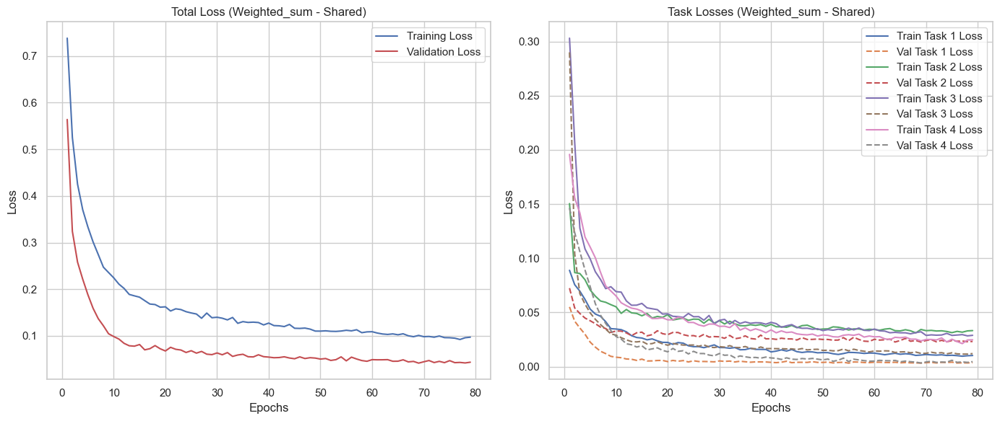

Loss curves plotted for shared_weighted_sum

Training Separate Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 0.7227
    Task 1 Loss: 0.0471
    Task 2 Loss: 0.1396
    Task 3 Loss: 0.0900
    Task 4 Loss: 0.4461
  Val Total Loss: 0.5631
    Task 1 Loss: 0.0259
    Task 2 Loss: 0.0420
    Task 3 Loss: 0.0493
    Task 4 Loss: 0.4459
Validation loss decreased. Saving model to models\model_weighted_sum_separate.pt
Epoch [2/100]
  Train Total Loss: 0.5206
    Task 1 Loss: 0.0127
    Task 2 Loss: 0.0289
    Task 3 Loss: 0.0330
    Task 4 Loss: 0.4461
  Val Total Loss: 0.5041
    Task 1 Loss: 0.0080
    Task 2 Loss: 0.0245
    Task 3 Loss: 0.0258
    Task 4 Loss: 0.4459
Validation loss decreased. Saving model to models\model_weighted_sum_separate.pt
Epoch [3/100]
  Train Total Loss: 0.4906
    Task 1 Loss: 0.0041
    Task 2 Loss: 0.0199
    Task 3 Loss: 0.0206
    Task 4 Loss: 0.4461
  Val Total Loss: 0.4895
    Task 1 Loss: 0.0035
    Task 2 Loss: 0.0201
    Task 3 Loss: 

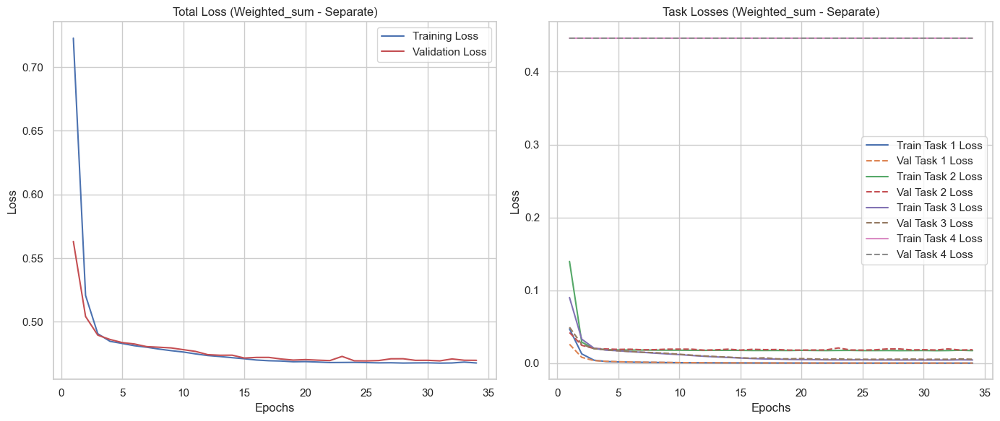

Loss curves plotted for separate_weighted_sum

Training Ref_based_isa Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 1.7109
    Task 1 Loss: 0.0536
    Task 2 Loss: 0.5621
    Task 3 Loss: 0.3102
    Task 4 Loss: 0.7849
  Val Total Loss: 1.4939
    Task 1 Loss: 0.0557
    Task 2 Loss: 0.4676
    Task 3 Loss: 0.2956
    Task 4 Loss: 0.6750
Validation loss decreased. Saving model to models\model_weighted_sum_Ref_Based_Isa.pt
Epoch [2/100]
  Train Total Loss: 1.2014
    Task 1 Loss: 0.0524
    Task 2 Loss: 0.3150
    Task 3 Loss: 0.2859
    Task 4 Loss: 0.5480
  Val Total Loss: 1.0139
    Task 1 Loss: 0.0548
    Task 2 Loss: 0.2546
    Task 3 Loss: 0.2702
    Task 4 Loss: 0.4343
Validation loss decreased. Saving model to models\model_weighted_sum_Ref_Based_Isa.pt
Epoch [3/100]
  Train Total Loss: 0.8101
    Task 1 Loss: 0.0514
    Task 2 Loss: 0.1386
    Task 3 Loss: 0.2483
    Task 4 Loss: 0.3717
  Val Total Loss: 0.6773
    Task 1 Loss: 0.0541
    Task 2 Loss: 0.0934


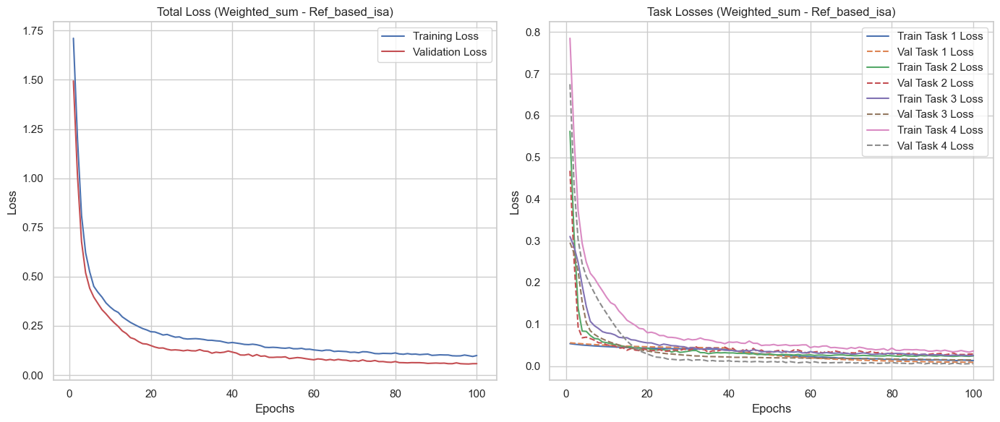

Loss curves plotted for Ref_Based_Isa_weighted_sum

Training Data_based_isa Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 1.5646
    Task 1 Loss: 0.0516
    Task 2 Loss: 0.5003
    Task 3 Loss: 0.3665
    Task 4 Loss: 0.6462
  Val Total Loss: 1.3460
    Task 1 Loss: 0.0546
    Task 2 Loss: 0.4090
    Task 3 Loss: 0.3503
    Task 4 Loss: 0.5320
Validation loss decreased. Saving model to models\model_weighted_sum_Data_Based_Isa.pt
Epoch [2/100]
  Train Total Loss: 1.1735
    Task 1 Loss: 0.0503
    Task 2 Loss: 0.3496
    Task 3 Loss: 0.2839
    Task 4 Loss: 0.4897
  Val Total Loss: 1.0333
    Task 1 Loss: 0.0517
    Task 2 Loss: 0.2944
    Task 3 Loss: 0.2773
    Task 4 Loss: 0.4098
Validation loss decreased. Saving model to models\model_weighted_sum_Data_Based_Isa.pt
Epoch [3/100]
  Train Total Loss: 0.8715
    Task 1 Loss: 0.0519
    Task 2 Loss: 0.2388
    Task 3 Loss: 0.2017
    Task 4 Loss: 0.3791
  Val Total Loss: 0.7393
    Task 1 Loss: 0.0504
    Task 2 Loss:

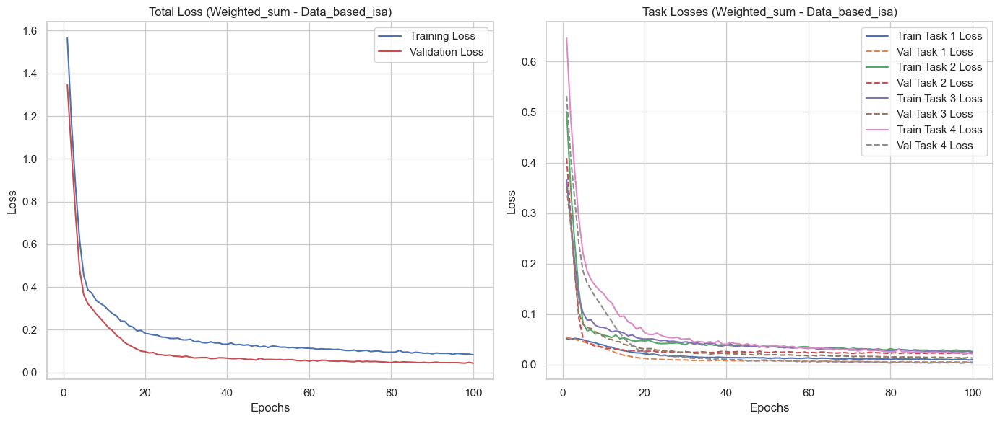

Loss curves plotted for Data_Based_Isa_weighted_sum

Training More_shared_layer Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 1.4022
    Task 1 Loss: 0.3622
    Task 2 Loss: 0.4856
    Task 3 Loss: 0.2374
    Task 4 Loss: 0.3170
  Val Total Loss: 1.2203
    Task 1 Loss: 0.3091
    Task 2 Loss: 0.4395
    Task 3 Loss: 0.1845
    Task 4 Loss: 0.2871
Validation loss decreased. Saving model to models\model_weighted_sum_More_Shared_Layer.pt
Epoch [2/100]
  Train Total Loss: 0.7845
    Task 1 Loss: 0.1798
    Task 2 Loss: 0.2632
    Task 3 Loss: 0.1038
    Task 4 Loss: 0.2377
  Val Total Loss: 0.5459
    Task 1 Loss: 0.0996
    Task 2 Loss: 0.1843
    Task 3 Loss: 0.0758
    Task 4 Loss: 0.1862
Validation loss decreased. Saving model to models\model_weighted_sum_More_Shared_Layer.pt
Epoch [3/100]
  Train Total Loss: 0.4026
    Task 1 Loss: 0.0762
    Task 2 Loss: 0.0784
    Task 3 Loss: 0.0805
    Task 4 Loss: 0.1675
  Val Total Loss: 0.3734
    Task 1 Loss: 0.0643
    Ta

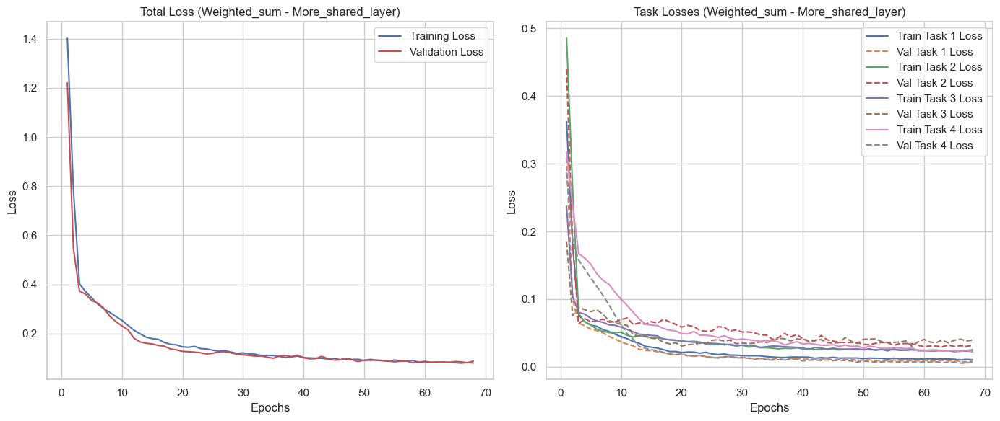

Loss curves plotted for More_Shared_Layer_weighted_sum

Training Few_shared_layers Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 1.4111
    Task 1 Loss: 0.0737
    Task 2 Loss: 0.2092
    Task 3 Loss: 0.6385
    Task 4 Loss: 0.4897
  Val Total Loss: 1.1018
    Task 1 Loss: 0.0485
    Task 2 Loss: 0.0619
    Task 3 Loss: 0.5596
    Task 4 Loss: 0.4318
Validation loss decreased. Saving model to models\model_weighted_sum_Few_Shared_Layers.pt
Epoch [2/100]
  Train Total Loss: 0.9209
    Task 1 Loss: 0.0387
    Task 2 Loss: 0.0558
    Task 3 Loss: 0.4292
    Task 4 Loss: 0.3972
  Val Total Loss: 0.7534
    Task 1 Loss: 0.0349
    Task 2 Loss: 0.0577
    Task 3 Loss: 0.3021
    Task 4 Loss: 0.3588
Validation loss decreased. Saving model to models\model_weighted_sum_Few_Shared_Layers.pt
Epoch [3/100]
  Train Total Loss: 0.5841
    Task 1 Loss: 0.0292
    Task 2 Loss: 0.0415
    Task 3 Loss: 0.2045
    Task 4 Loss: 0.3089
  Val Total Loss: 0.4538
    Task 1 Loss: 0.0216
   

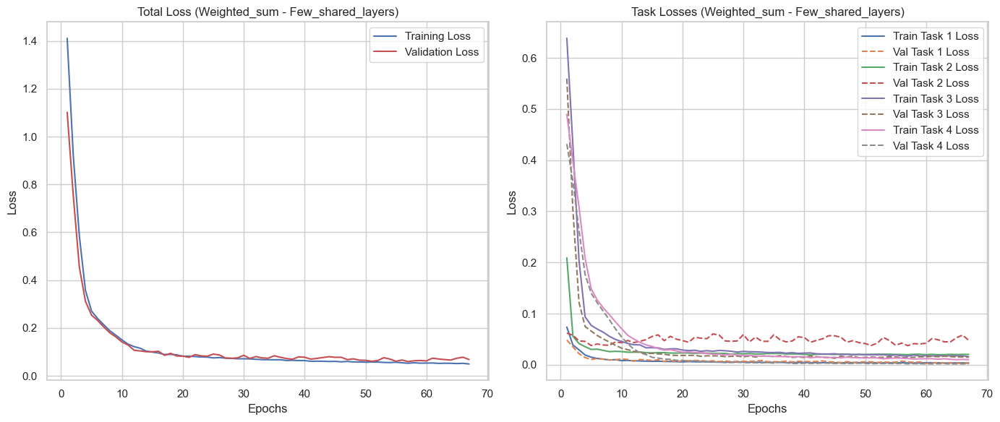

Loss curves plotted for Few_Shared_Layers_weighted_sum

Training Deep_balanced_layer Model with Weighted sum Method:
Epoch [1/100]
  Train Total Loss: 1.1202
    Task 1 Loss: 0.0648
    Task 2 Loss: 0.2208
    Task 3 Loss: 0.2822
    Task 4 Loss: 0.5523
  Val Total Loss: 0.9743
    Task 1 Loss: 0.0639
    Task 2 Loss: 0.2018
    Task 3 Loss: 0.2493
    Task 4 Loss: 0.4593
Validation loss decreased. Saving model to models\model_weighted_sum_Deep_Balanced_Layer.pt
Epoch [2/100]
  Train Total Loss: 0.7572
    Task 1 Loss: 0.0499
    Task 2 Loss: 0.1077
    Task 3 Loss: 0.1793
    Task 4 Loss: 0.4202
  Val Total Loss: 0.6170
    Task 1 Loss: 0.0495
    Task 2 Loss: 0.0742
    Task 3 Loss: 0.1245
    Task 4 Loss: 0.3687
Validation loss decreased. Saving model to models\model_weighted_sum_Deep_Balanced_Layer.pt
Epoch [3/100]
  Train Total Loss: 0.5321
    Task 1 Loss: 0.0462
    Task 2 Loss: 0.0596
    Task 3 Loss: 0.0929
    Task 4 Loss: 0.3334
  Val Total Loss: 0.4668
    Task 1 Loss: 0.04

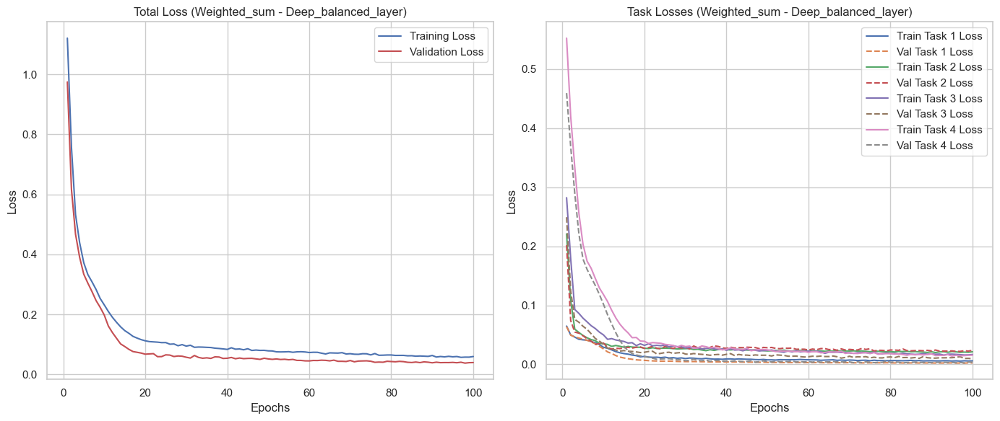

Loss curves plotted for Deep_Balanced_Layer_weighted_sum

Training Shared Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 0.8587
    Task 1 Loss: 0.1246
    Task 2 Loss: 0.1856
    Task 3 Loss: 0.2454
    Task 4 Loss: 0.3030
  Val Total Loss: 0.6437
    Task 1 Loss: 0.1343
    Task 2 Loss: 0.1307
    Task 3 Loss: 0.1531
    Task 4 Loss: 0.2257
Validation loss decreased. Saving model to models\model_mgda_shared.pt
Epoch [2/100]
  Train Total Loss: 0.5464
    Task 1 Loss: 0.1011
    Task 2 Loss: 0.1030
    Task 3 Loss: 0.1320
    Task 4 Loss: 0.2103
  Val Total Loss: 0.3690
    Task 1 Loss: 0.0762
    Task 2 Loss: 0.0626
    Task 3 Loss: 0.0759
    Task 4 Loss: 0.1543
Validation loss decreased. Saving model to models\model_mgda_shared.pt
Epoch [3/100]
  Train Total Loss: 0.4237
    Task 1 Loss: 0.0792
    Task 2 Loss: 0.0783
    Task 3 Loss: 0.1022
    Task 4 Loss: 0.1640
  Val Total Loss: 0.2965
    Task 1 Loss: 0.0530
    Task 2 Loss: 0.0512
    Task 3 Loss: 0.0615
    Task 4

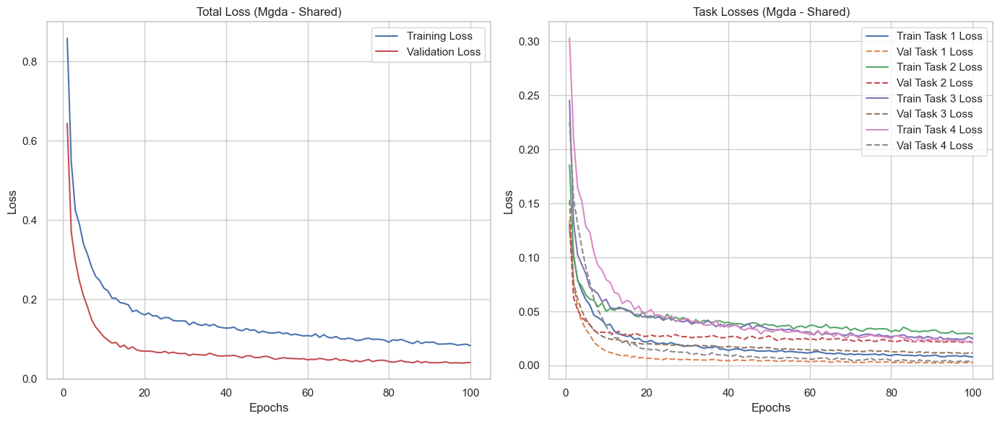

Loss curves plotted for shared_mgda

Training Separate Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 0.7618
    Task 1 Loss: 0.0491
    Task 2 Loss: 0.1572
    Task 3 Loss: 0.1184
    Task 4 Loss: 0.4371
  Val Total Loss: 0.4749
    Task 1 Loss: 0.0287
    Task 2 Loss: 0.0550
    Task 3 Loss: 0.0657
    Task 4 Loss: 0.3256
Validation loss decreased. Saving model to models\model_mgda_separate.pt
Epoch [2/100]
  Train Total Loss: 0.2677
    Task 1 Loss: 0.0138
    Task 2 Loss: 0.0390
    Task 3 Loss: 0.0436
    Task 4 Loss: 0.1713
  Val Total Loss: 0.1940
    Task 1 Loss: 0.0077
    Task 2 Loss: 0.0336
    Task 3 Loss: 0.0336
    Task 4 Loss: 0.1189
Validation loss decreased. Saving model to models\model_mgda_separate.pt
Epoch [3/100]
  Train Total Loss: 0.1247
    Task 1 Loss: 0.0042
    Task 2 Loss: 0.0244
    Task 3 Loss: 0.0245
    Task 4 Loss: 0.0716
  Val Total Loss: 0.0998
    Task 1 Loss: 0.0034
    Task 2 Loss: 0.0228
    Task 3 Loss: 0.0219
    Task 4 Loss: 0.0518
V

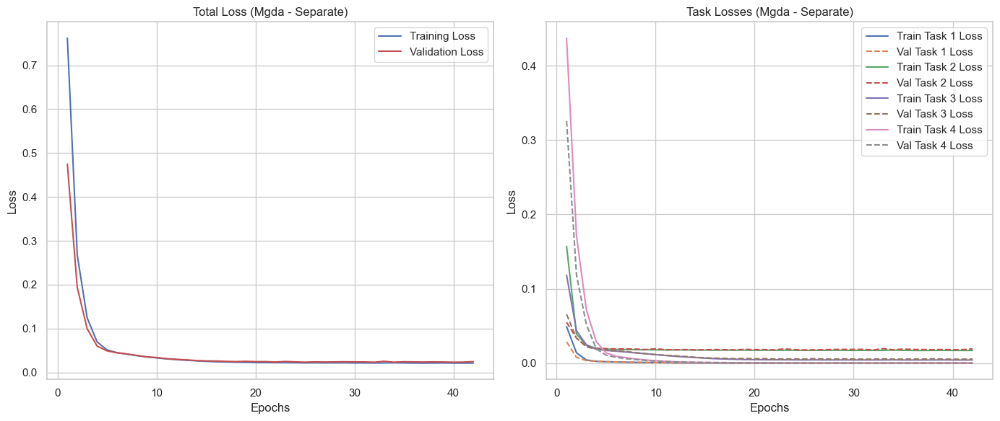

Loss curves plotted for separate_mgda

Training Ref_based_isa Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 1.3802
    Task 1 Loss: 0.0454
    Task 2 Loss: 0.3413
    Task 3 Loss: 0.4729
    Task 4 Loss: 0.5207
  Val Total Loss: 1.2634
    Task 1 Loss: 0.0484
    Task 2 Loss: 0.3384
    Task 3 Loss: 0.4505
    Task 4 Loss: 0.4261
Validation loss decreased. Saving model to models\model_mgda_Ref_Based_Isa.pt
Epoch [2/100]
  Train Total Loss: 1.0605
    Task 1 Loss: 0.0442
    Task 2 Loss: 0.2299
    Task 3 Loss: 0.3781
    Task 4 Loss: 0.4083
  Val Total Loss: 0.9395
    Task 1 Loss: 0.0475
    Task 2 Loss: 0.2140
    Task 3 Loss: 0.3274
    Task 4 Loss: 0.3507
Validation loss decreased. Saving model to models\model_mgda_Ref_Based_Isa.pt
Epoch [3/100]
  Train Total Loss: 0.7469
    Task 1 Loss: 0.0433
    Task 2 Loss: 0.1013
    Task 3 Loss: 0.2791
    Task 4 Loss: 0.3233
  Val Total Loss: 0.6336
    Task 1 Loss: 0.0466
    Task 2 Loss: 0.0731
    Task 3 Loss: 0.2345
    Task

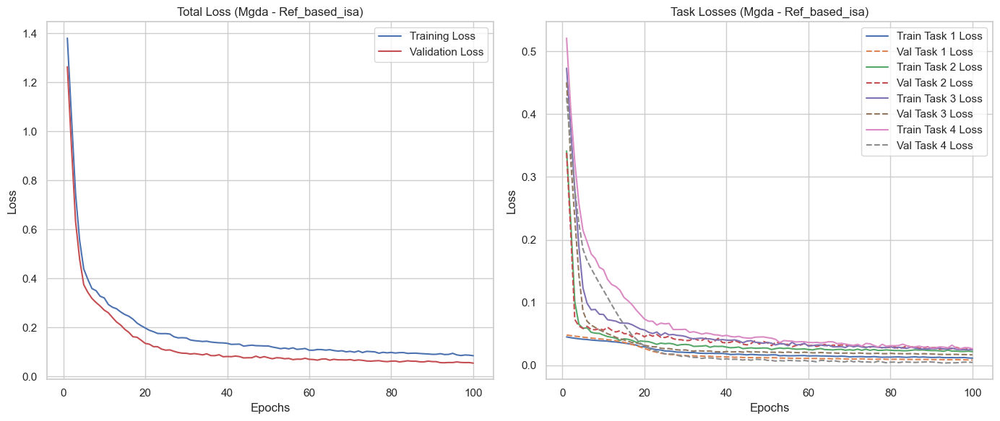

Loss curves plotted for Ref_Based_Isa_mgda

Training Data_based_isa Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 0.9945
    Task 1 Loss: 0.0657
    Task 2 Loss: 0.4281
    Task 3 Loss: 0.1813
    Task 4 Loss: 0.3194
  Val Total Loss: 0.8910
    Task 1 Loss: 0.0614
    Task 2 Loss: 0.3627
    Task 3 Loss: 0.1567
    Task 4 Loss: 0.3102
Validation loss decreased. Saving model to models\model_mgda_Data_Based_Isa.pt
Epoch [2/100]
  Train Total Loss: 0.7821
    Task 1 Loss: 0.0553
    Task 2 Loss: 0.3052
    Task 3 Loss: 0.1483
    Task 4 Loss: 0.2733
  Val Total Loss: 0.7011
    Task 1 Loss: 0.0528
    Task 2 Loss: 0.2635
    Task 3 Loss: 0.1234
    Task 4 Loss: 0.2614
Validation loss decreased. Saving model to models\model_mgda_Data_Based_Isa.pt
Epoch [3/100]
  Train Total Loss: 0.5931
    Task 1 Loss: 0.0478
    Task 2 Loss: 0.2135
    Task 3 Loss: 0.1140
    Task 4 Loss: 0.2177
  Val Total Loss: 0.5045
    Task 1 Loss: 0.0482
    Task 2 Loss: 0.1613
    Task 3 Loss: 0.0907


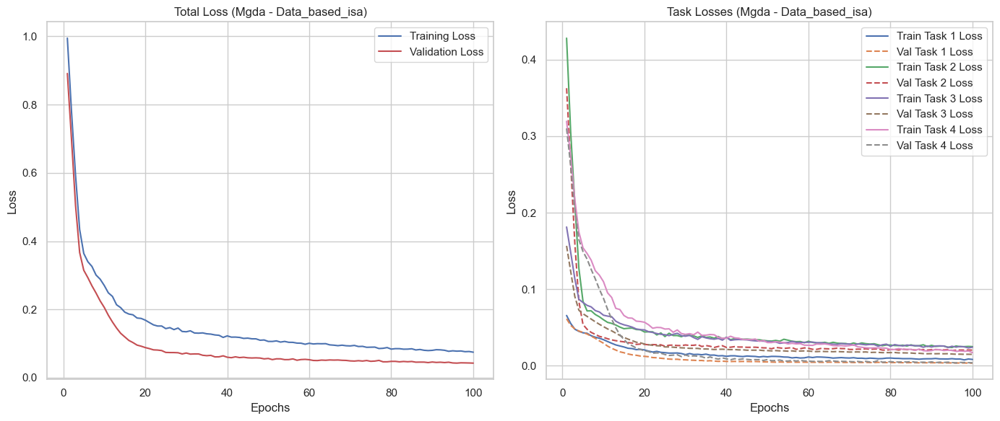

Loss curves plotted for Data_Based_Isa_mgda

Training More_shared_layer Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 1.0880
    Task 1 Loss: 0.1662
    Task 2 Loss: 0.2849
    Task 3 Loss: 0.2373
    Task 4 Loss: 0.3996
  Val Total Loss: 0.9028
    Task 1 Loss: 0.1222
    Task 2 Loss: 0.2659
    Task 3 Loss: 0.1592
    Task 4 Loss: 0.3555
Validation loss decreased. Saving model to models\model_mgda_More_Shared_Layer.pt
Epoch [2/100]
  Train Total Loss: 0.6366
    Task 1 Loss: 0.0876
    Task 2 Loss: 0.1493
    Task 3 Loss: 0.1024
    Task 4 Loss: 0.2972
  Val Total Loss: 0.4975
    Task 1 Loss: 0.0716
    Task 2 Loss: 0.0985
    Task 3 Loss: 0.0871
    Task 4 Loss: 0.2402
Validation loss decreased. Saving model to models\model_mgda_More_Shared_Layer.pt
Epoch [3/100]
  Train Total Loss: 0.4092
    Task 1 Loss: 0.0607
    Task 2 Loss: 0.0650
    Task 3 Loss: 0.0861
    Task 4 Loss: 0.1974
  Val Total Loss: 0.3967
    Task 1 Loss: 0.0586
    Task 2 Loss: 0.0673
    Task 3 Los

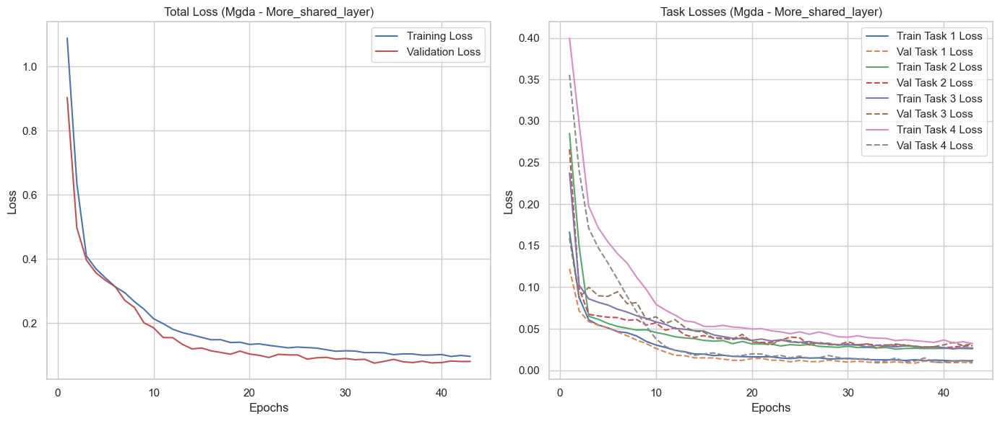

Loss curves plotted for More_Shared_Layer_mgda

Training Few_shared_layers Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 1.5550
    Task 1 Loss: 0.0643
    Task 2 Loss: 0.1729
    Task 3 Loss: 0.3687
    Task 4 Loss: 0.9491
  Val Total Loss: 1.2298
    Task 1 Loss: 0.0519
    Task 2 Loss: 0.0542
    Task 3 Loss: 0.2998
    Task 4 Loss: 0.8240
Validation loss decreased. Saving model to models\model_mgda_Few_Shared_Layers.pt
Epoch [2/100]
  Train Total Loss: 0.9948
    Task 1 Loss: 0.0442
    Task 2 Loss: 0.0488
    Task 3 Loss: 0.2327
    Task 4 Loss: 0.6691
  Val Total Loss: 0.7785
    Task 1 Loss: 0.0430
    Task 2 Loss: 0.0529
    Task 3 Loss: 0.1738
    Task 4 Loss: 0.5089
Validation loss decreased. Saving model to models\model_mgda_Few_Shared_Layers.pt
Epoch [3/100]
  Train Total Loss: 0.6078
    Task 1 Loss: 0.0344
    Task 2 Loss: 0.0368
    Task 3 Loss: 0.1133
    Task 4 Loss: 0.4232
  Val Total Loss: 0.5149
    Task 1 Loss: 0.0289
    Task 2 Loss: 0.0520
    Task 3 

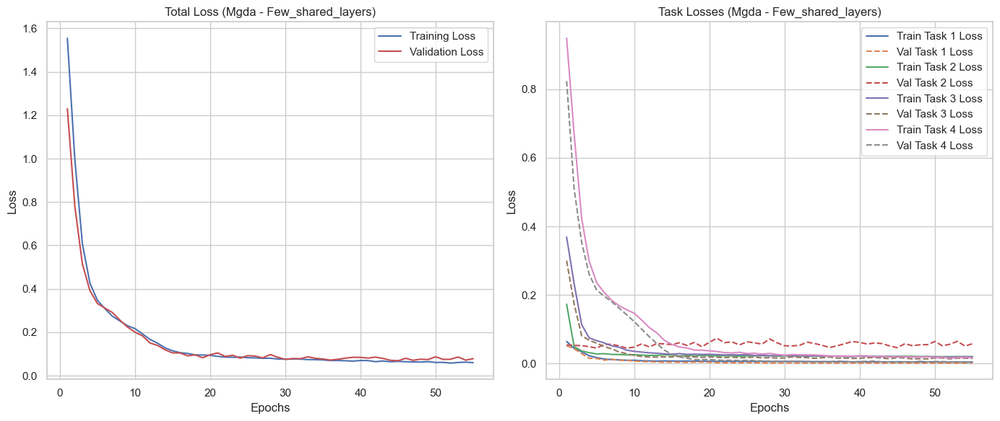

Loss curves plotted for Few_Shared_Layers_mgda

Training Deep_balanced_layer Model with Mgda Method:
Epoch [1/100]
  Train Total Loss: 0.9508
    Task 1 Loss: 0.0705
    Task 2 Loss: 0.4569
    Task 3 Loss: 0.2025
    Task 4 Loss: 0.2210
  Val Total Loss: 0.8348
    Task 1 Loss: 0.0662
    Task 2 Loss: 0.3886
    Task 3 Loss: 0.1615
    Task 4 Loss: 0.2185
Validation loss decreased. Saving model to models\model_mgda_Deep_Balanced_Layer.pt
Epoch [2/100]
  Train Total Loss: 0.6675
    Task 1 Loss: 0.0517
    Task 2 Loss: 0.2969
    Task 3 Loss: 0.1215
    Task 4 Loss: 0.1972
  Val Total Loss: 0.5825
    Task 1 Loss: 0.0512
    Task 2 Loss: 0.2564
    Task 3 Loss: 0.0810
    Task 4 Loss: 0.1938
Validation loss decreased. Saving model to models\model_mgda_Deep_Balanced_Layer.pt
Epoch [3/100]
  Train Total Loss: 0.4434
    Task 1 Loss: 0.0467
    Task 2 Loss: 0.1350
    Task 3 Loss: 0.0817
    Task 4 Loss: 0.1800
  Val Total Loss: 0.3632
    Task 1 Loss: 0.0469
    Task 2 Loss: 0.0676
    T

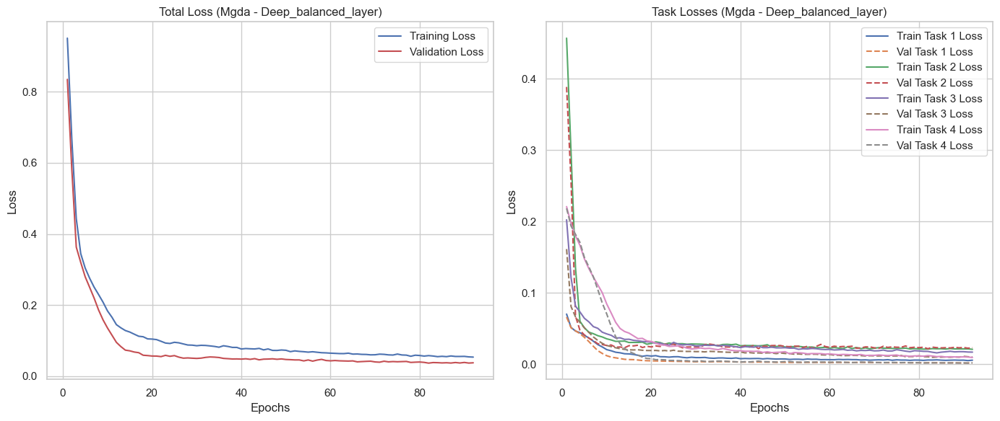

Loss curves plotted for Deep_Balanced_Layer_mgda

Training Shared Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.4472
    Task 1 Loss: 0.1128
    Task 2 Loss: 0.3097
    Task 3 Loss: 0.1933
    Task 4 Loss: 0.2919
  Val Total Loss: 0.2159
    Task 1 Loss: 0.0601
    Task 2 Loss: 0.1139
    Task 3 Loss: 0.0978
    Task 4 Loss: 0.1901
  Task 1 log_sigma: -0.0042
  Task 2 log_sigma: -0.0044
  Task 3 log_sigma: -0.0042
  Task 4 log_sigma: -0.0042
Validation loss decreased. Saving model to models\model_uncertainty_shared.pt
Epoch [2/100]
  Train Total Loss: 0.1841
    Task 1 Loss: 0.0609
    Task 2 Loss: 0.0919
    Task 3 Loss: 0.0962
    Task 4 Loss: 0.1654
  Val Total Loss: 0.1168
    Task 1 Loss: 0.0424
    Task 2 Loss: 0.0547
    Task 3 Loss: 0.0727
    Task 4 Loss: 0.1281
  Task 1 log_sigma: -0.0084
  Task 2 log_sigma: -0.0091
  Task 3 log_sigma: -0.0086
  Task 4 log_sigma: -0.0087
Validation loss decreased. Saving model to models\model_uncertainty_shared.pt
Epoch [

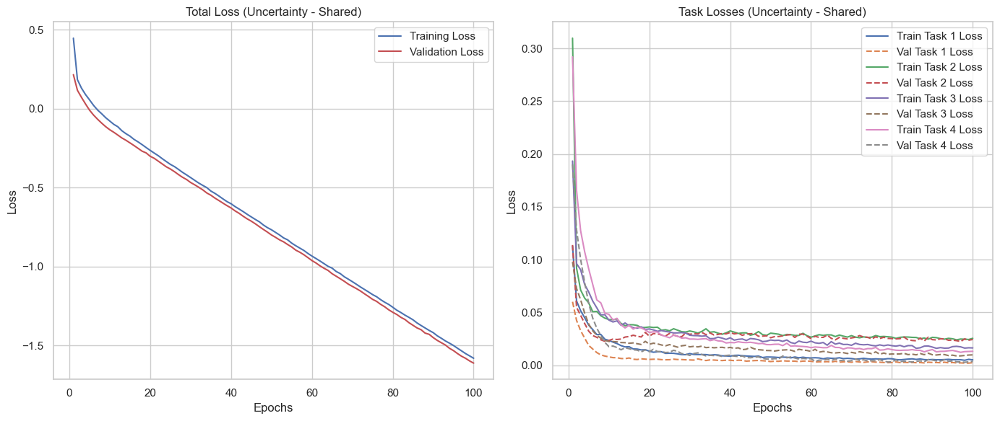

Loss curves plotted for shared_uncertainty

Training Separate Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.2972
    Task 1 Loss: 0.0668
    Task 2 Loss: 0.2161
    Task 3 Loss: 0.1264
    Task 4 Loss: 0.1996
  Val Total Loss: 0.1313
    Task 1 Loss: 0.0390
    Task 2 Loss: 0.0566
    Task 3 Loss: 0.0641
    Task 4 Loss: 0.1345
  Task 1 log_sigma: -0.0042
  Task 2 log_sigma: -0.0044
  Task 3 log_sigma: -0.0042
  Task 4 log_sigma: -0.0042
Validation loss decreased. Saving model to models\model_uncertainty_separate.pt
Epoch [2/100]
  Train Total Loss: 0.0740
    Task 1 Loss: 0.0261
    Task 2 Loss: 0.0403
    Task 3 Loss: 0.0461
    Task 4 Loss: 0.0841
  Val Total Loss: 0.0373
    Task 1 Loss: 0.0181
    Task 2 Loss: 0.0339
    Task 3 Loss: 0.0334
    Task 4 Loss: 0.0556
  Task 1 log_sigma: -0.0084
  Task 2 log_sigma: -0.0089
  Task 3 log_sigma: -0.0085
  Task 4 log_sigma: -0.0086
Validation loss decreased. Saving model to models\model_uncertainty_separate.pt
Epoch [

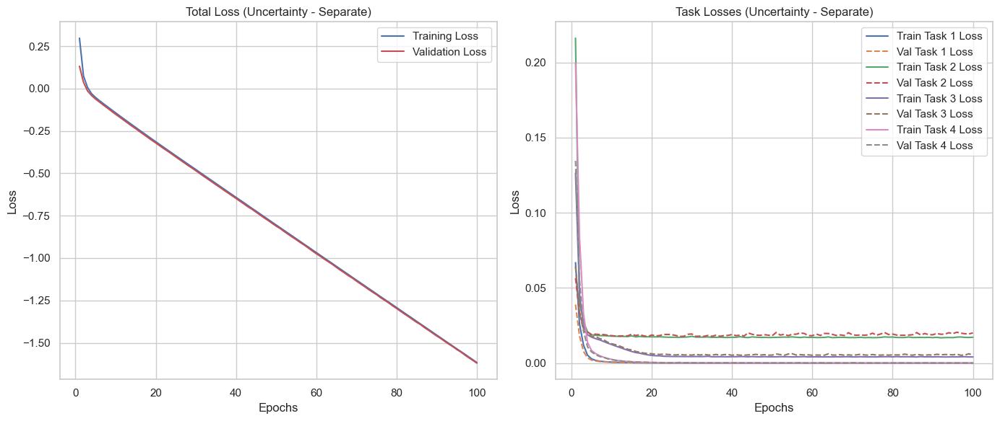

Loss curves plotted for separate_uncertainty

Training Ref_based_isa Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.5163
    Task 1 Loss: 0.0496
    Task 2 Loss: 0.4385
    Task 3 Loss: 0.1789
    Task 4 Loss: 0.3776
  Val Total Loss: 0.4709
    Task 1 Loss: 0.0519
    Task 2 Loss: 0.4053
    Task 3 Loss: 0.1682
    Task 4 Loss: 0.3415
  Task 1 log_sigma: -0.0041
  Task 2 log_sigma: -0.0042
  Task 3 log_sigma: -0.0041
  Task 4 log_sigma: -0.0041
Validation loss decreased. Saving model to models\model_uncertainty_Ref_Based_Isa.pt
Epoch [2/100]
  Train Total Loss: 0.4076
    Task 1 Loss: 0.0479
    Task 2 Loss: 0.3161
    Task 3 Loss: 0.1631
    Task 4 Loss: 0.3271
  Val Total Loss: 0.3776
    Task 1 Loss: 0.0501
    Task 2 Loss: 0.3171
    Task 3 Loss: 0.1527
    Task 4 Loss: 0.2883
  Task 1 log_sigma: -0.0082
  Task 2 log_sigma: -0.0087
  Task 3 log_sigma: -0.0082
  Task 4 log_sigma: -0.0083
Validation loss decreased. Saving model to models\model_uncertainty_Ref_Bas

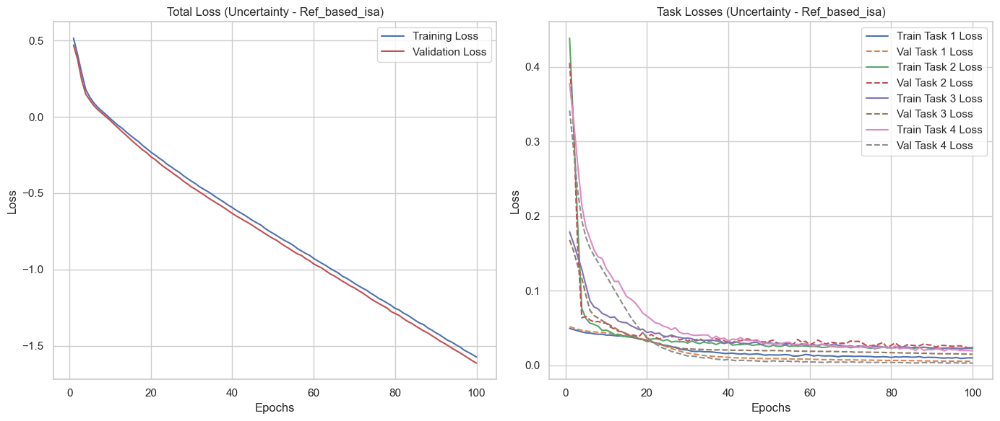

Loss curves plotted for Ref_Based_Isa_uncertainty

Training Data_based_isa Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.7131
    Task 1 Loss: 0.0930
    Task 2 Loss: 0.2027
    Task 3 Loss: 0.4888
    Task 4 Loss: 0.6521
  Val Total Loss: 0.5753
    Task 1 Loss: 0.0807
    Task 2 Loss: 0.2014
    Task 3 Loss: 0.3506
    Task 4 Loss: 0.5413
  Task 1 log_sigma: -0.0041
  Task 2 log_sigma: -0.0041
  Task 3 log_sigma: -0.0042
  Task 4 log_sigma: -0.0042
Validation loss decreased. Saving model to models\model_uncertainty_Data_Based_Isa.pt
Epoch [2/100]
  Train Total Loss: 0.4659
    Task 1 Loss: 0.0751
    Task 2 Loss: 0.1375
    Task 3 Loss: 0.3070
    Task 4 Loss: 0.4504
  Val Total Loss: 0.3722
    Task 1 Loss: 0.0641
    Task 2 Loss: 0.1238
    Task 3 Loss: 0.2238
    Task 4 Loss: 0.3876
  Task 1 log_sigma: -0.0082
  Task 2 log_sigma: -0.0084
  Task 3 log_sigma: -0.0089
  Task 4 log_sigma: -0.0091
Validation loss decreased. Saving model to models\model_uncertainty_

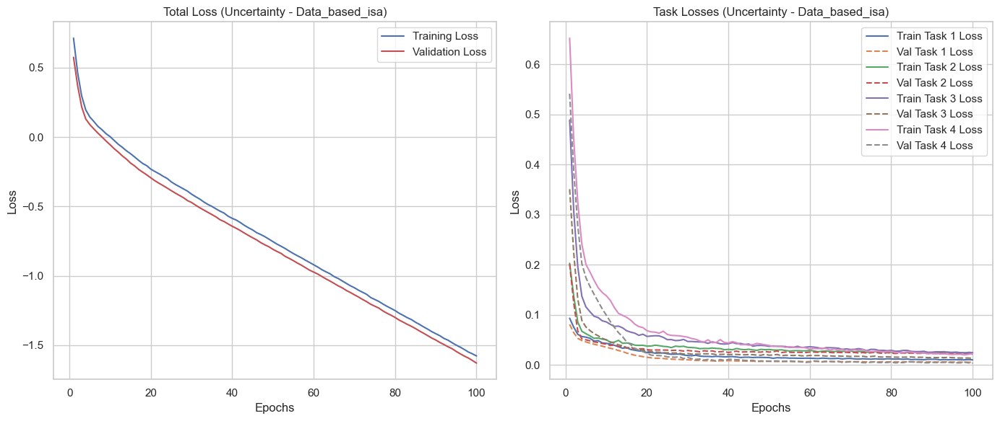

Loss curves plotted for Data_Based_Isa_uncertainty

Training More_shared_layer Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.6907
    Task 1 Loss: 0.0677
    Task 2 Loss: 0.3096
    Task 3 Loss: 0.2374
    Task 4 Loss: 0.7776
  Val Total Loss: 0.5784
    Task 1 Loss: 0.0655
    Task 2 Loss: 0.2929
    Task 3 Loss: 0.1646
    Task 4 Loss: 0.6572
  Task 1 log_sigma: -0.0041
  Task 2 log_sigma: -0.0042
  Task 3 log_sigma: -0.0042
  Task 4 log_sigma: -0.0041
Validation loss decreased. Saving model to models\model_uncertainty_More_Shared_Layer.pt
Epoch [2/100]
  Train Total Loss: 0.3589
    Task 1 Loss: 0.0501
    Task 2 Loss: 0.1481
    Task 3 Loss: 0.0976
    Task 4 Loss: 0.4635
  Val Total Loss: 0.2473
    Task 1 Loss: 0.0492
    Task 2 Loss: 0.0934
    Task 3 Loss: 0.0790
    Task 4 Loss: 0.3332
  Task 1 log_sigma: -0.0082
  Task 2 log_sigma: -0.0087
  Task 3 log_sigma: -0.0087
  Task 4 log_sigma: -0.0096
Validation loss decreased. Saving model to models\model_uncer

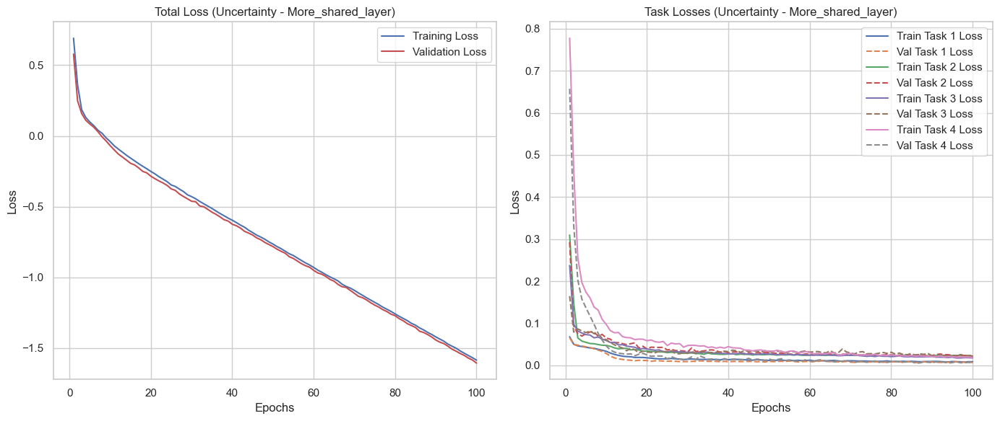

Loss curves plotted for More_Shared_Layer_uncertainty

Training Few_shared_layers Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.5255
    Task 1 Loss: 0.0596
    Task 2 Loss: 0.1691
    Task 3 Loss: 0.3465
    Task 4 Loss: 0.4880
  Val Total Loss: 0.4162
    Task 1 Loss: 0.0517
    Task 2 Loss: 0.0508
    Task 3 Loss: 0.2949
    Task 4 Loss: 0.4612
  Task 1 log_sigma: -0.0041
  Task 2 log_sigma: -0.0043
  Task 3 log_sigma: -0.0042
  Task 4 log_sigma: -0.0040
Validation loss decreased. Saving model to models\model_uncertainty_Few_Shared_Layers.pt
Epoch [2/100]
  Train Total Loss: 0.3706
    Task 1 Loss: 0.0435
    Task 2 Loss: 0.0477
    Task 3 Loss: 0.2452
    Task 4 Loss: 0.4452
  Val Total Loss: 0.3312
    Task 1 Loss: 0.0406
    Task 2 Loss: 0.0526
    Task 3 Loss: 0.1924
    Task 4 Loss: 0.4322
  Task 1 log_sigma: -0.0082
  Task 2 log_sigma: -0.0087
  Task 3 log_sigma: -0.0086
  Task 4 log_sigma: -0.0082
Validation loss decreased. Saving model to models\model_un

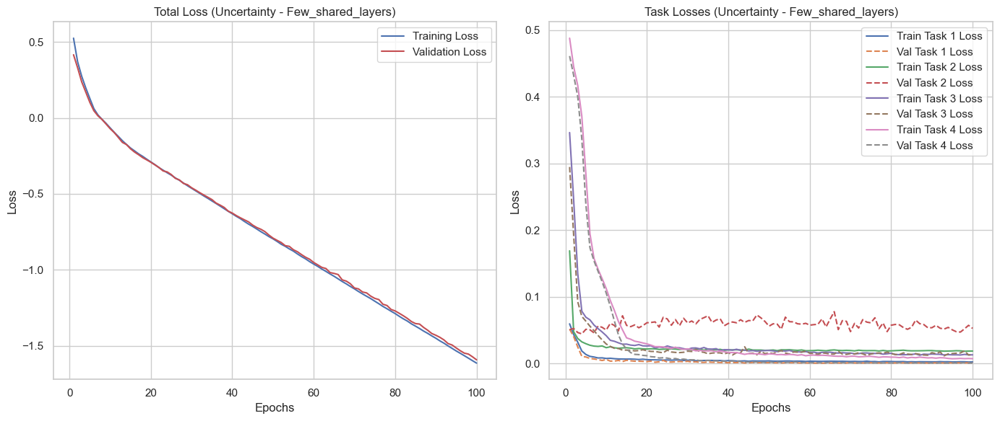

Loss curves plotted for Few_Shared_Layers_uncertainty

Training Deep_balanced_layer Model with Uncertainty Method:
Epoch [1/100]
  Train Total Loss: 0.7990
    Task 1 Loss: 0.1263
    Task 2 Loss: 0.3610
    Task 3 Loss: 0.3598
    Task 4 Loss: 0.7608
  Val Total Loss: 0.7144
    Task 1 Loss: 0.1156
    Task 2 Loss: 0.3338
    Task 3 Loss: 0.2973
    Task 4 Loss: 0.7033
  Task 1 log_sigma: -0.0041
  Task 2 log_sigma: -0.0042
  Task 3 log_sigma: -0.0042
  Task 4 log_sigma: -0.0040
Validation loss decreased. Saving model to models\model_uncertainty_Deep_Balanced_Layer.pt
Epoch [2/100]
  Train Total Loss: 0.5926
    Task 1 Loss: 0.0842
    Task 2 Loss: 0.2502
    Task 3 Loss: 0.1994
    Task 4 Loss: 0.6864
  Val Total Loss: 0.4840
    Task 1 Loss: 0.0660
    Task 2 Loss: 0.2002
    Task 3 Loss: 0.1246
    Task 4 Loss: 0.6281
  Task 1 log_sigma: -0.0083
  Task 2 log_sigma: -0.0086
  Task 3 log_sigma: -0.0088
  Task 4 log_sigma: -0.0085
Validation loss decreased. Saving model to models\mode

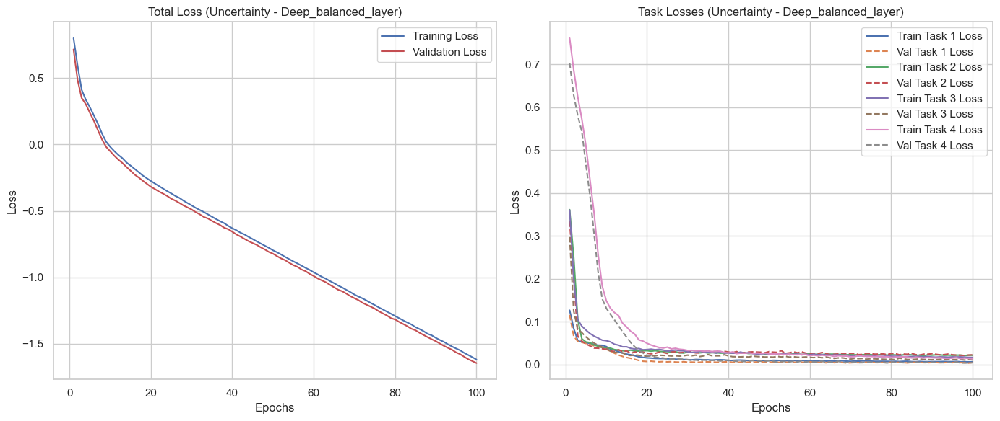

Loss curves plotted for Deep_Balanced_Layer_uncertainty


In [125]:



# Initialize hyperparameters
input_size = X_data_normalized.shape[1]
hidden_size = 256  # Example hidden size
num_epochs = 100
learning_rate = 1e-4  # Reduced from 1e-3 for stability
weights = [1.0, 1.0, 1.0, 1.0]  # Example weights for the 4 tasks

# Initialize scalers for saving
method_list = ['weighted_sum', 'mgda', 'uncertainty'] #, 'cagrad']  # Added 'cagrad'
model_type_list = ['shared', 'separate', 'Ref_Based_Isa', 'Data_Based_Isa', 'More_Shared_Layer', 'Few_Shared_Layers', 'Deep_Balanced_Layer']  # Updated list

# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Loop through methods and model types to train and save models
for method in method_list:
    for model_type in model_type_list:
        print(f"\nTraining {model_type.capitalize()} Model with {method.replace('_', ' ').capitalize()} Method:")

        # Initialize model based on method and model_type
        if method == 'uncertainty':
            if model_type == 'shared':
                model = SharedMTLModelWithUncertainty(input_size, hidden_size, num_tasks=4)
            elif model_type == 'separate':
                model = SeparateMTLModelWithUncertainty(input_size, hidden_size, num_tasks=4)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(
                    input_size, hidden_size1=128, hidden_size2=64,
                    shared_energy_emission_size=32, shared_comfort_size=32,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                raise ValueError("Invalid model type")
        elif method == 'cagrad':
            if model_type == 'shared':
                model = SharedMTLModel(input_size, hidden_size)
            elif model_type == 'separate':
                model = SeparateMTLModel(input_size, hidden_size)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(
                    input_size, hidden_size1=128, hidden_size2=64,
                    shared_energy_emission_size=32, shared_comfort_size=32,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                raise ValueError("Invalid model type")
        else:
            if model_type == 'shared':
                model = SharedMTLModel(input_size, hidden_size)
            elif model_type == 'separate':
                model = SeparateMTLModel(input_size, hidden_size)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(
                    input_size, hidden_size1=128, hidden_size2=64,
                    shared_energy_emission_size=32, shared_comfort_size=32,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                raise ValueError("Invalid model type")

        # Move model to device
        model.to(device)

        # Initialize model weights (optional but recommended)
        # model.apply(initialize_weights)  # Define initialize_weights if needed

        # Train model based on the method
        if method == 'weighted_sum':
            history = train_weighted_sum(
                model, train_loader, val_loader, num_epochs, learning_rate, weights,
                method=method, model_type=model_type
            )
        elif method == 'mgda':
            history = train_mgda(
                model, train_loader, val_loader, num_epochs, learning_rate,
                method=method, model_type=model_type
            )
        elif method == 'uncertainty':
            history = train_uncertainty(
                model, train_loader, val_loader, num_epochs, learning_rate,
                method=method, model_type=model_type
            )
        elif method == 'cagrad':
            history = train_cagrad(
                model, train_loader, val_loader, num_epochs, learning_rate,
                method=method, model_type=model_type
            )
        else:
            raise ValueError("Invalid method")

        # Save the trained model
        model_path = get_model_path(method, model_type)
        torch.save(model.state_dict(), model_path)
        print(f"Model saved to {model_path}")

        # Save the scalers
        scaler_X_path = get_scaler_path(method, model_type, scaler_type='X')
        joblib.dump(scaler_X, scaler_X_path)
        print(f"Input scaler saved to {scaler_X_path}")

        # Save scalers for Y (one per task)
        for i, scaler in enumerate(scalers_Y):
            scaler_Y_path = get_scaler_path(method, model_type, scaler_type=f'Y_{i}')
            joblib.dump(scaler, scaler_Y_path)
            print(f"Scaler for Y_{i} saved to {scaler_Y_path}")

        # Plot loss curves
        plot_loss_curves(history, method=method, model_type=model_type)
        print(f"Loss curves plotted for {model_type}_{method}")


# 9. Evaluate Models


## 9.1. Evaluate Models - Figure Generation



Evaluating Shared Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.009554      1.825196    1.350998  0.927335
Cost      140.973770  25406.294922  159.393524  0.556842
Emission   16.884350    464.805511   21.559349  0.832313
Comfort     5.864876     50.616337    7.114516  0.972491


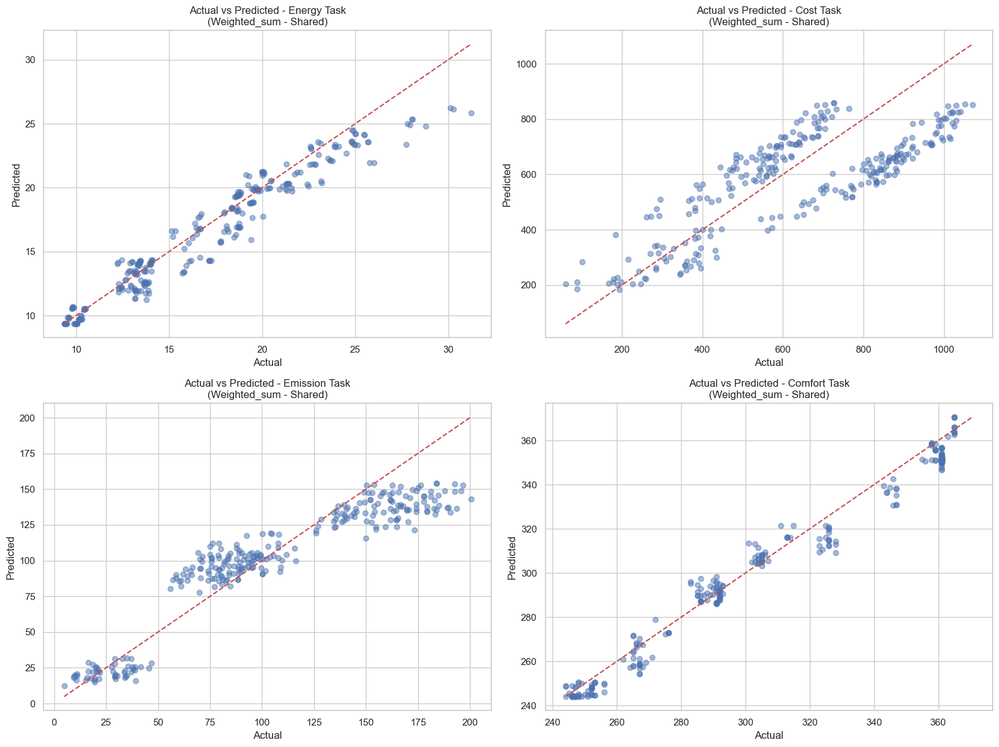


Generating Percentage Error Distribution Plots...


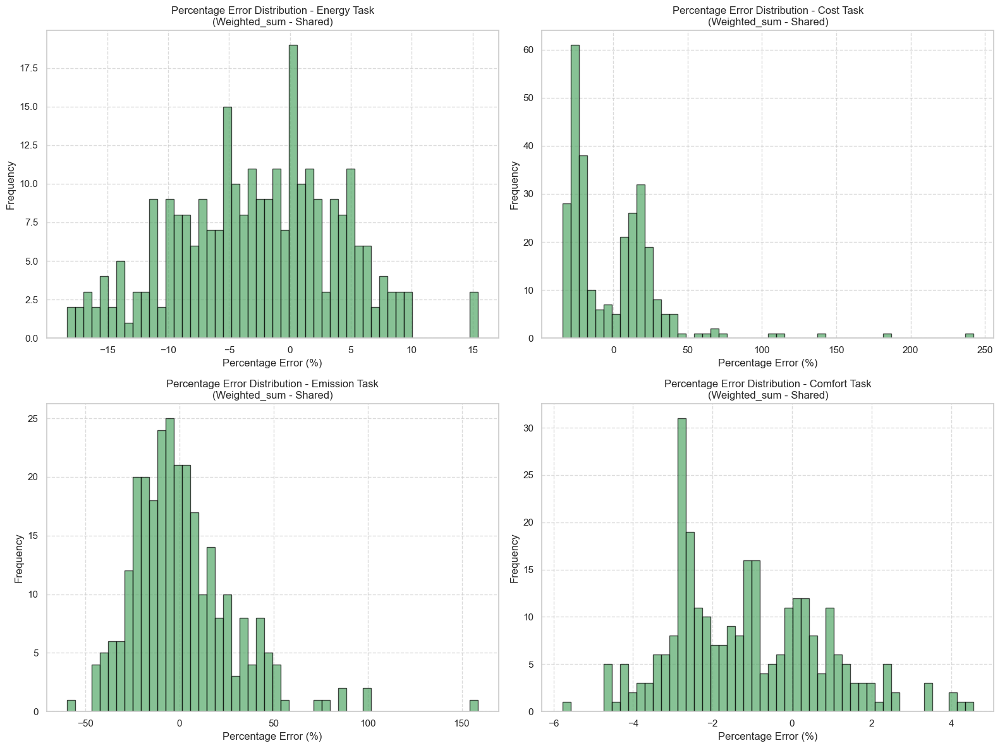


Evaluating Separate Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.178714      0.055733    0.236078  0.997781
Cost      133.844162  21187.250000  145.558411  0.630434
Emission   10.559045    171.458939   13.094233  0.938143
Comfort    66.308525   6236.834961   78.973633 -2.389557


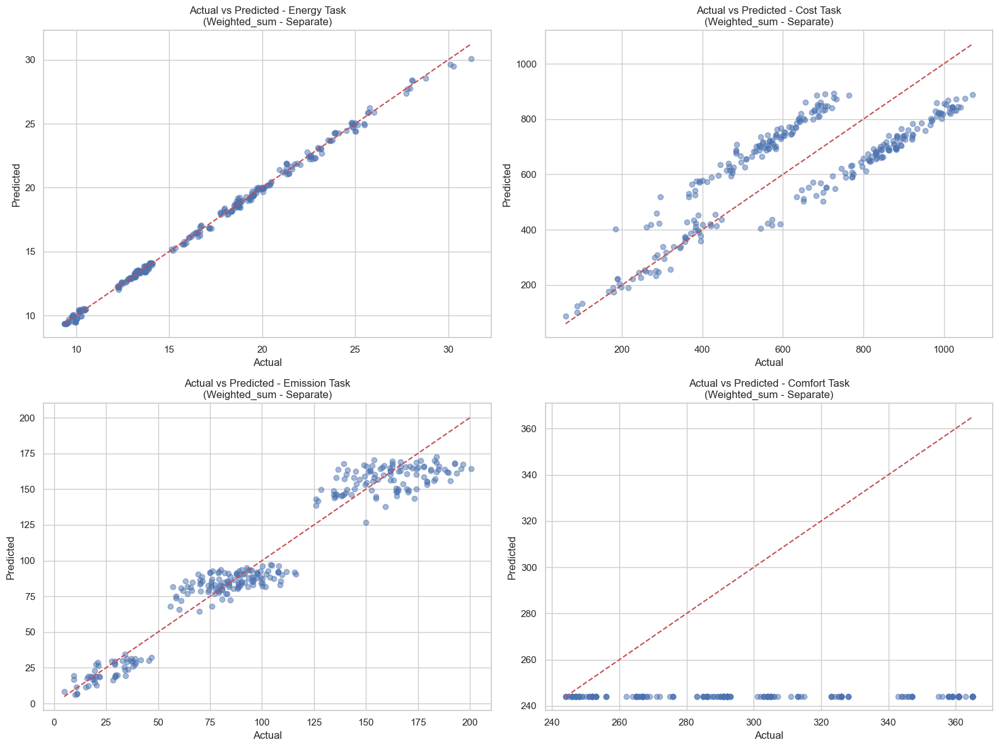


Generating Percentage Error Distribution Plots...


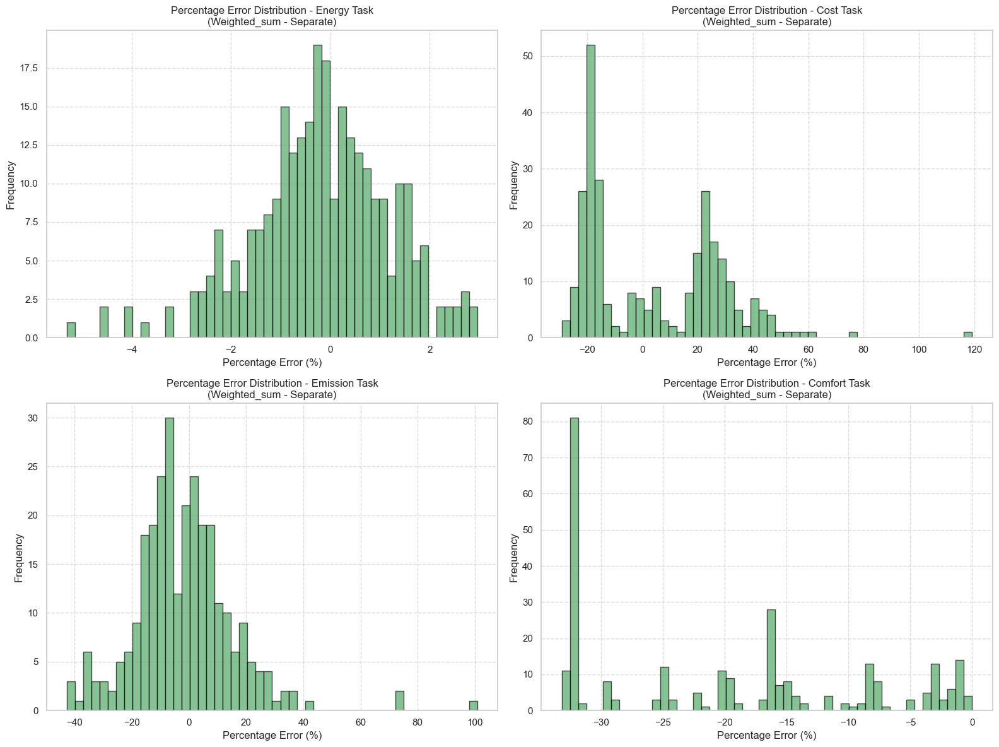


Evaluating Ref_based_isa Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.701795      5.014802    2.239375  0.800349
Cost      142.259964  29628.621094  172.129669  0.483192
Emission   19.222797    581.041016   24.104792  0.790379
Comfort     7.550960     81.077202    9.004288  0.955937


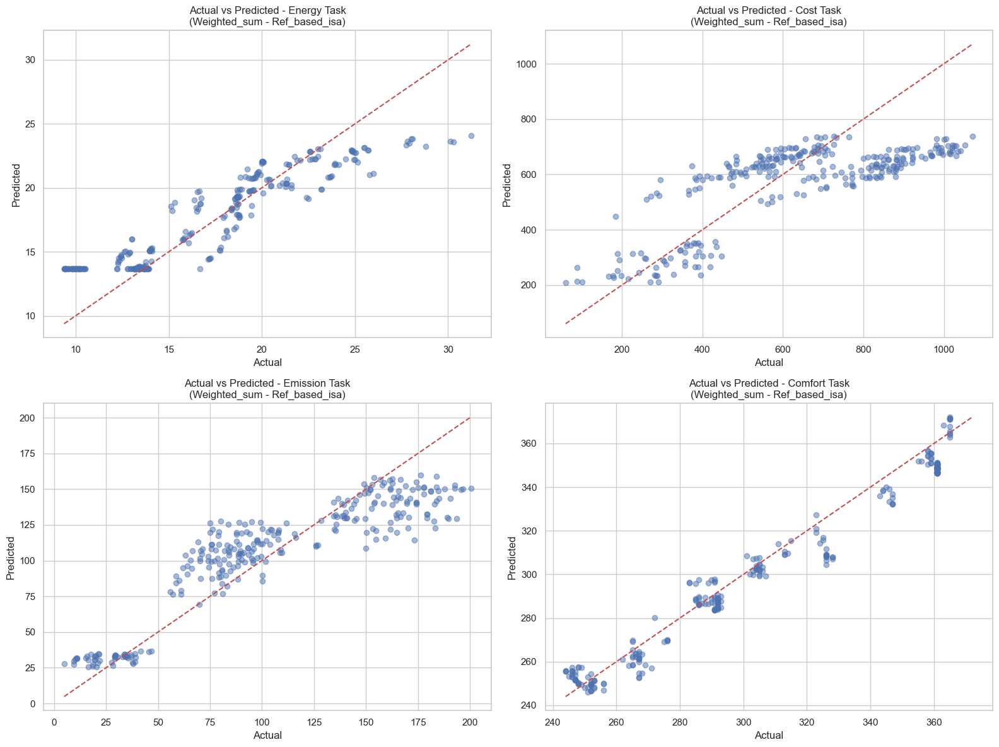


Generating Percentage Error Distribution Plots...


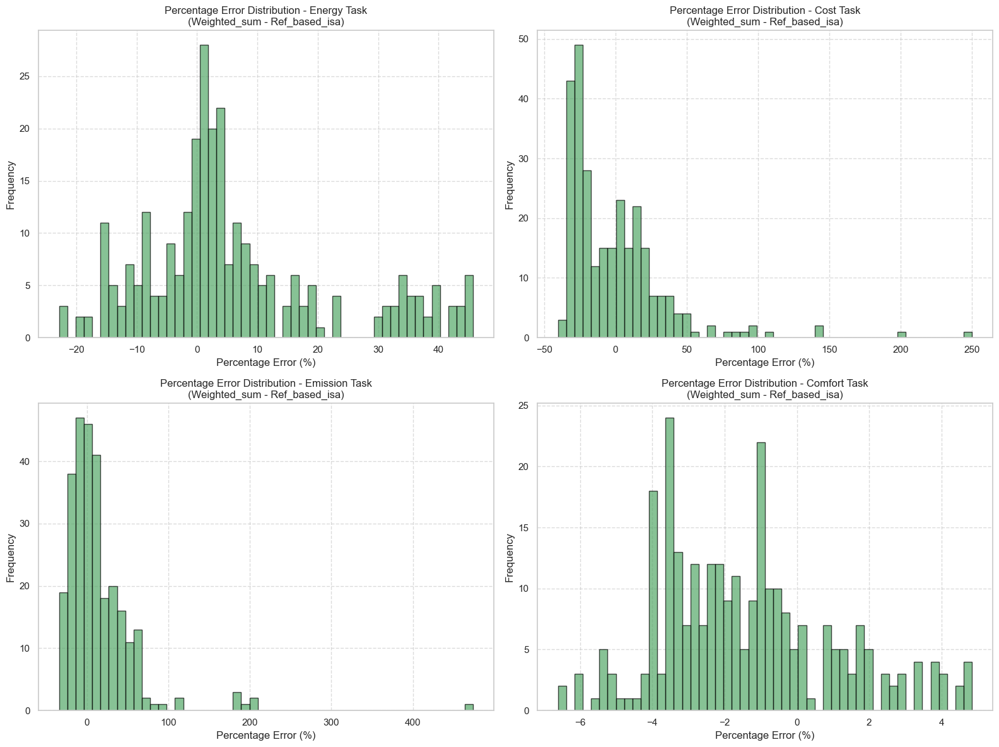


Evaluating Data_based_isa Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.373811      3.024695    1.739165  0.879580
Cost      138.504044  24133.138672  155.348450  0.579049
Emission   18.206245    524.136108   22.894018  0.810909
Comfort     6.270724     59.653000    7.723536  0.967580


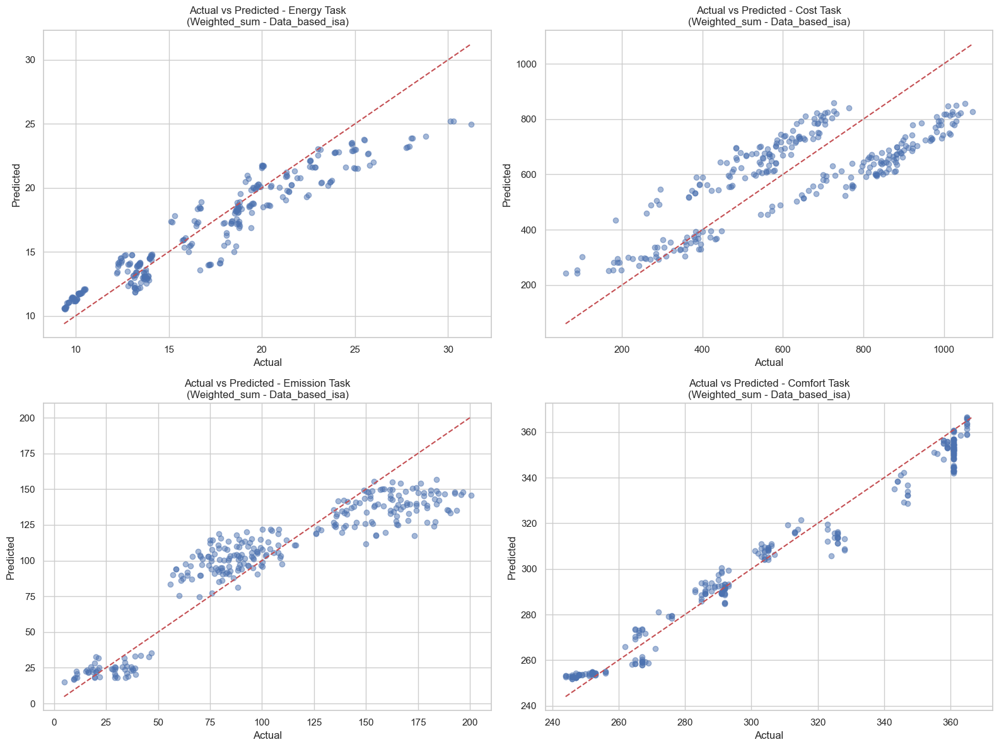


Generating Percentage Error Distribution Plots...


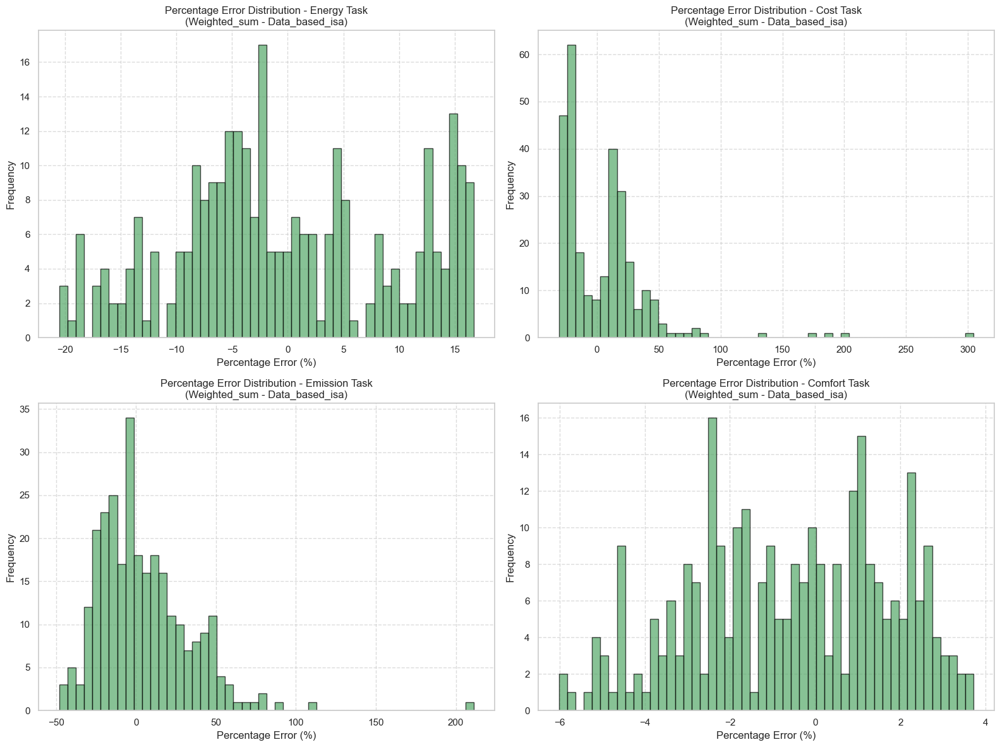


Evaluating More_shared_layer Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.963263      5.887844    2.426488  0.765591
Cost      153.600830  36512.921875  191.083542  0.363110
Emission   25.876877   1145.683350   33.847946  0.586675
Comfort     9.463843    128.281281   11.326133  0.930282


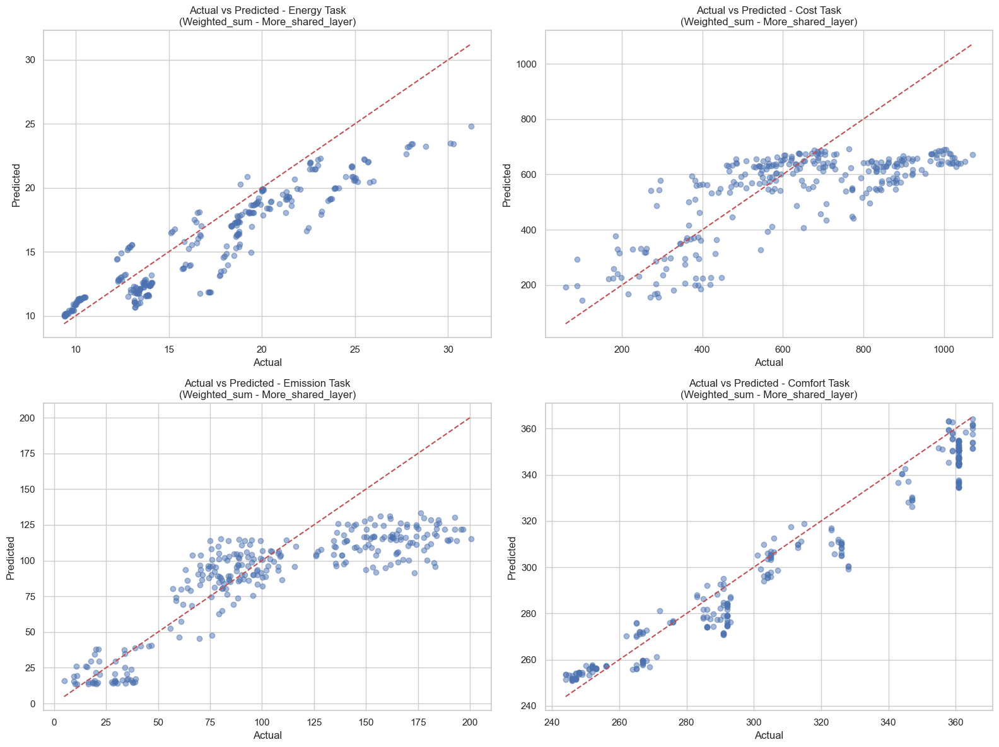


Generating Percentage Error Distribution Plots...


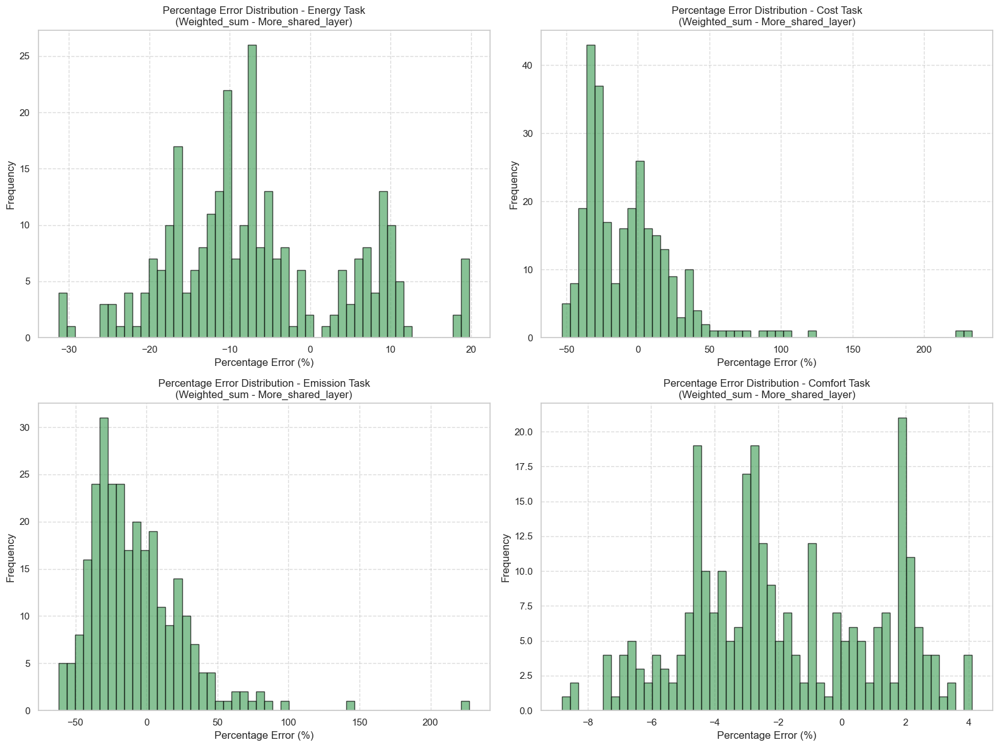


Evaluating Few_shared_layers Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.700699      3.804250    1.950449  0.848544
Cost      150.369186  38816.367188  197.018692  0.322932
Emission   18.362326    561.939880   23.705271  0.797271
Comfort     4.183413     26.960304    5.192331  0.985348


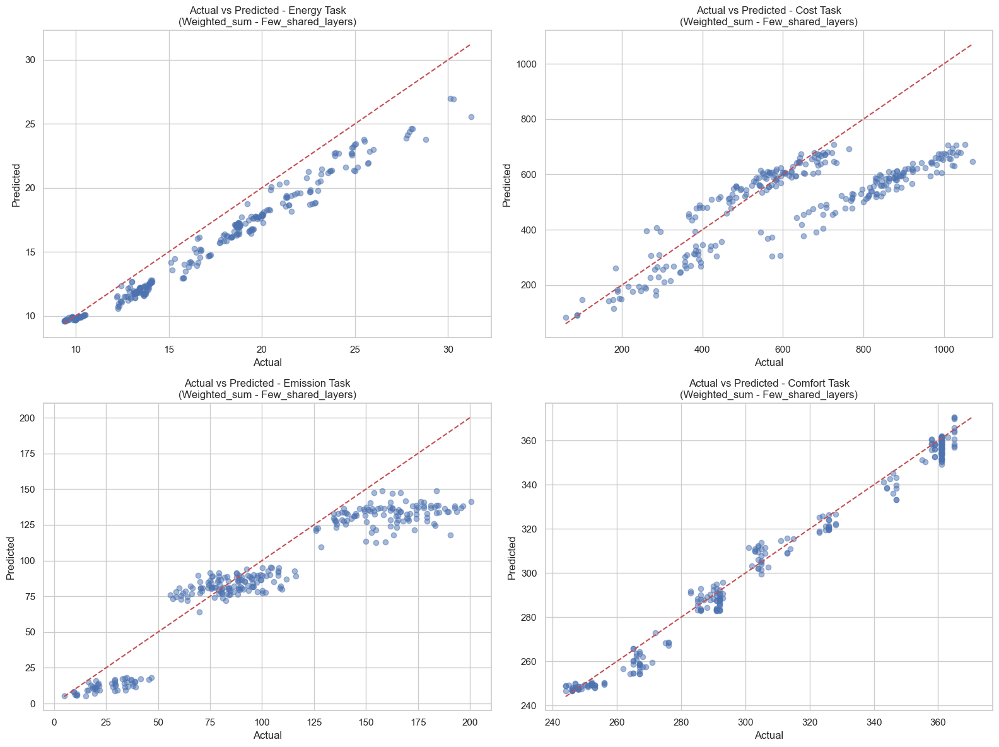


Generating Percentage Error Distribution Plots...


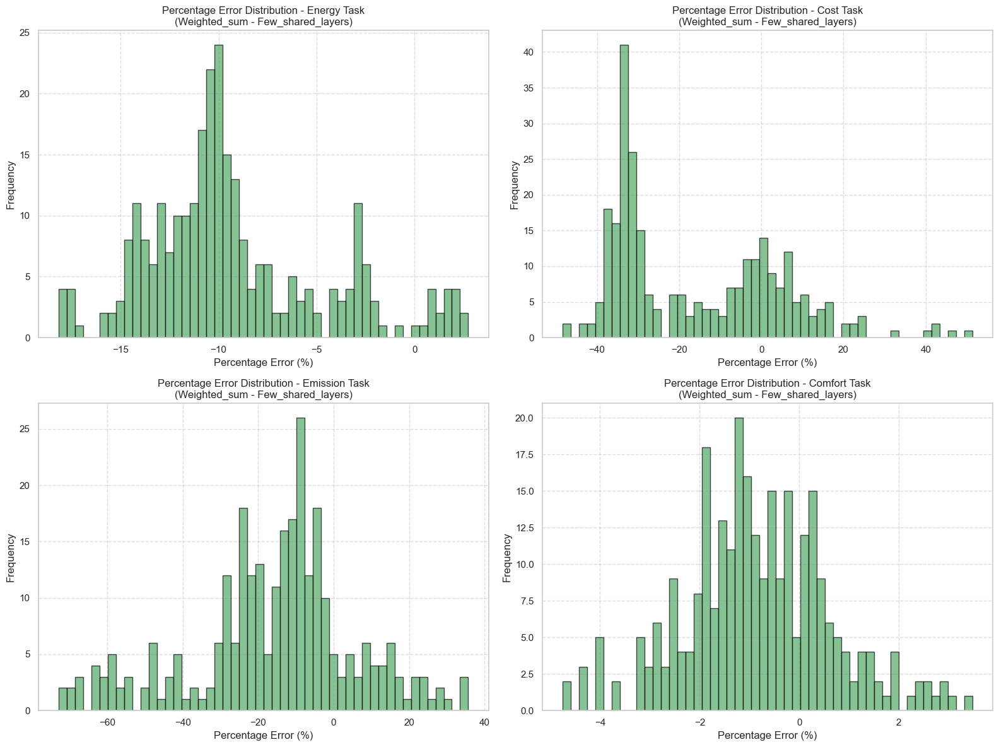


Evaluating Deep_balanced_layer Model with Weighted sum Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.879613      1.171700    1.082451  0.953352
Cost      136.734955  24882.261719  157.741119  0.565982
Emission   14.695926    376.449738   19.402313  0.864189
Comfort     5.158681     38.133625    6.175243  0.979275


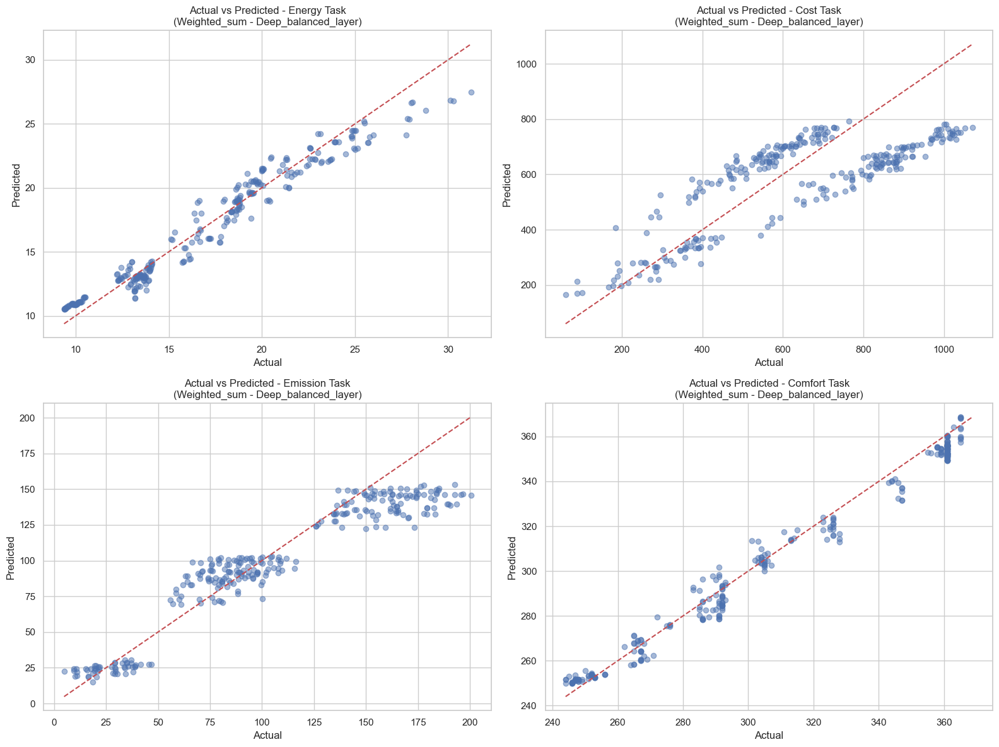


Generating Percentage Error Distribution Plots...


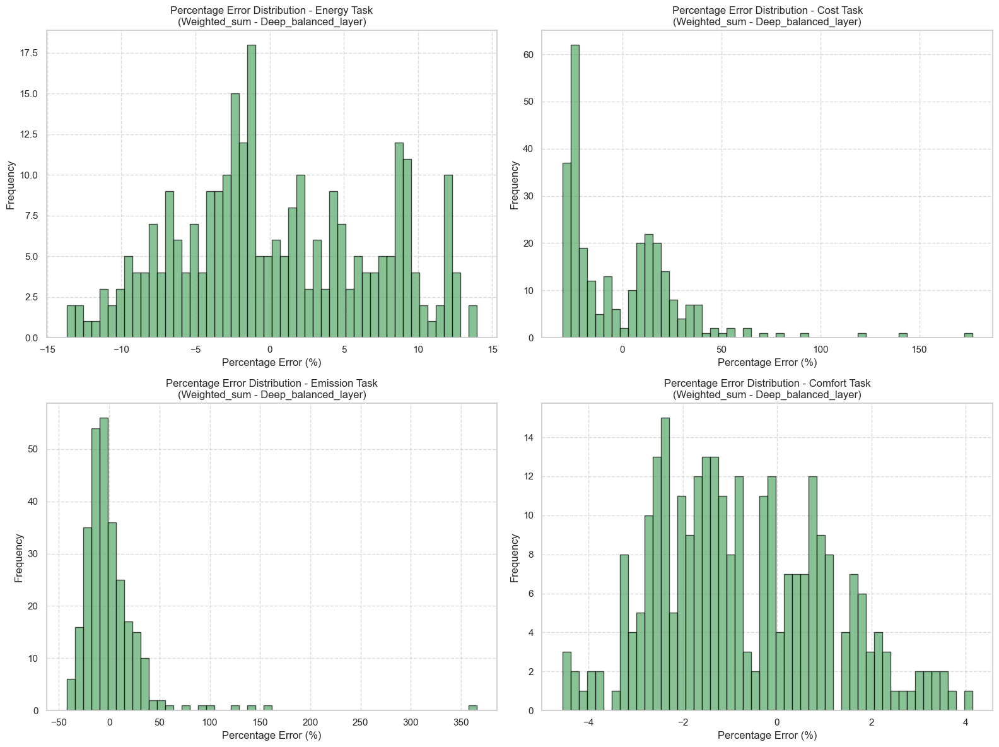


Evaluating Shared Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.915348      1.492767    1.221788  0.940569
Cost      137.946213  23910.826172  154.631256  0.582927
Emission   16.309822    437.501251   20.916531  0.842164
Comfort     6.289588     59.566040    7.717904  0.967627


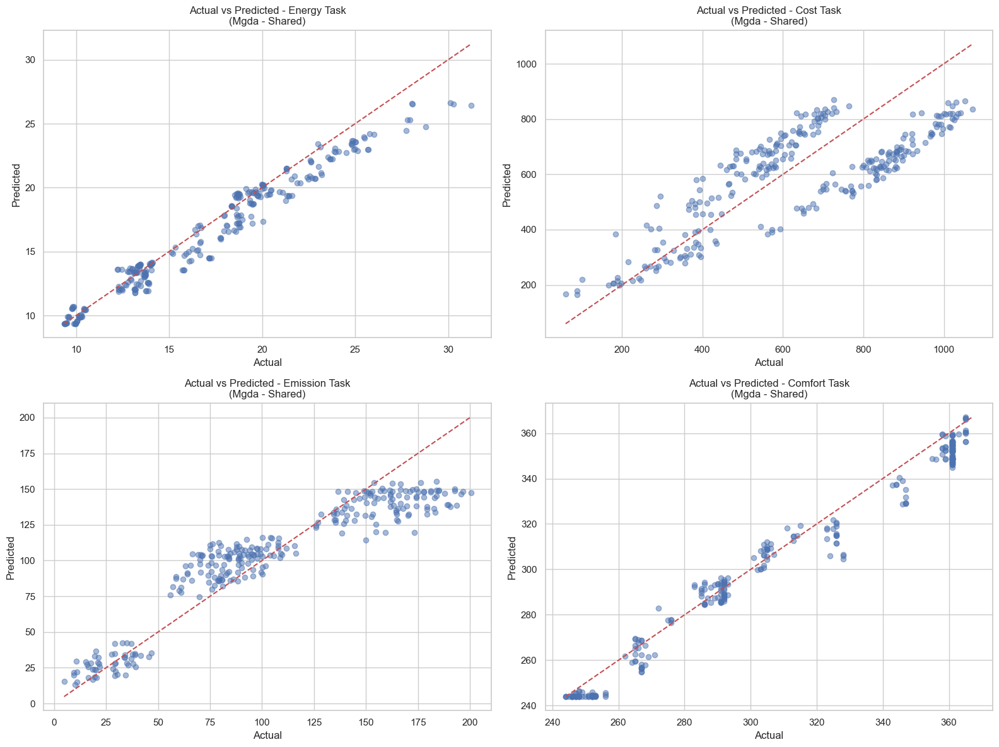


Generating Percentage Error Distribution Plots...


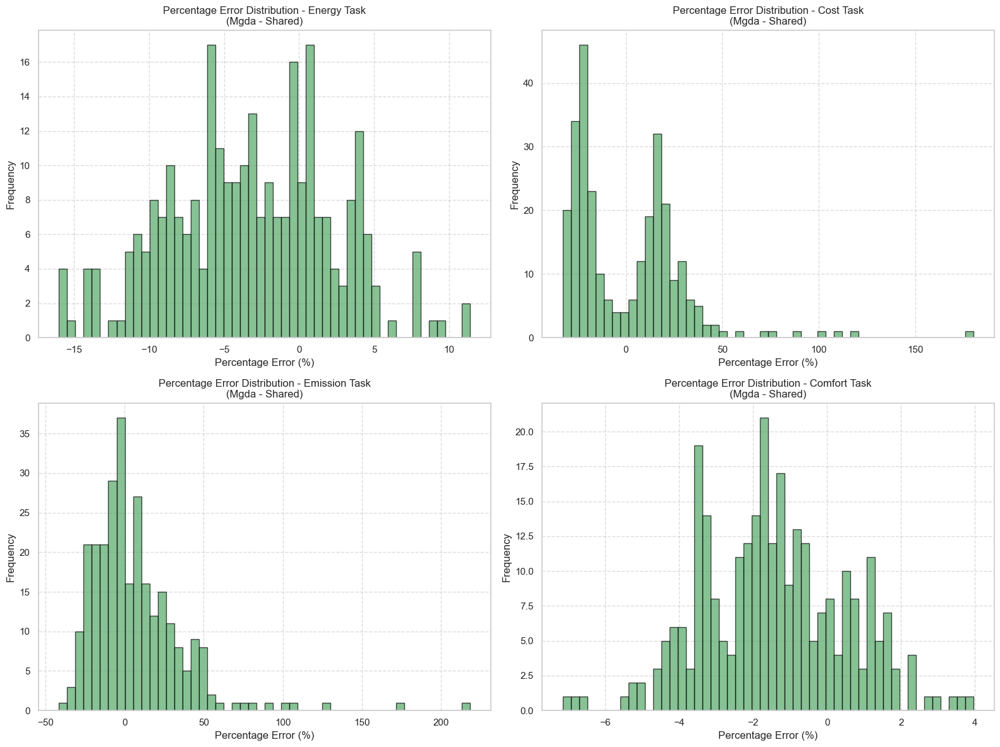


Evaluating Separate Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.124721      0.035002    0.187090  0.998606
Cost      133.567963  21466.660156  146.515045  0.625560
Emission   10.715211    172.048981   13.116744  0.937930
Comfort     1.388280      3.188749    1.785707  0.998267


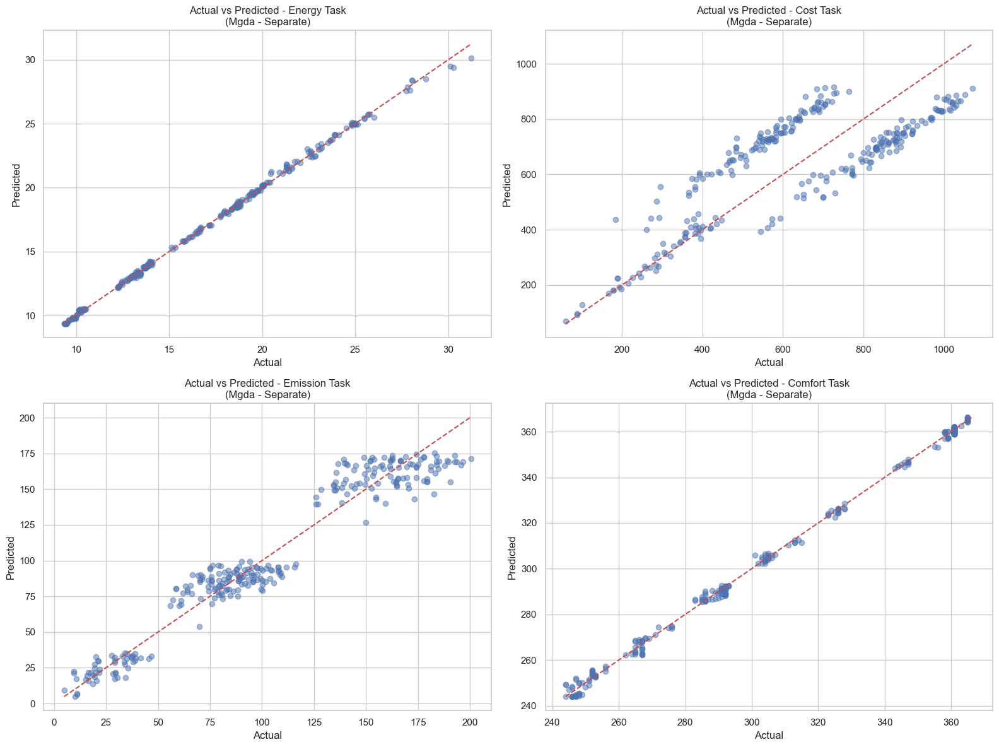


Generating Percentage Error Distribution Plots...


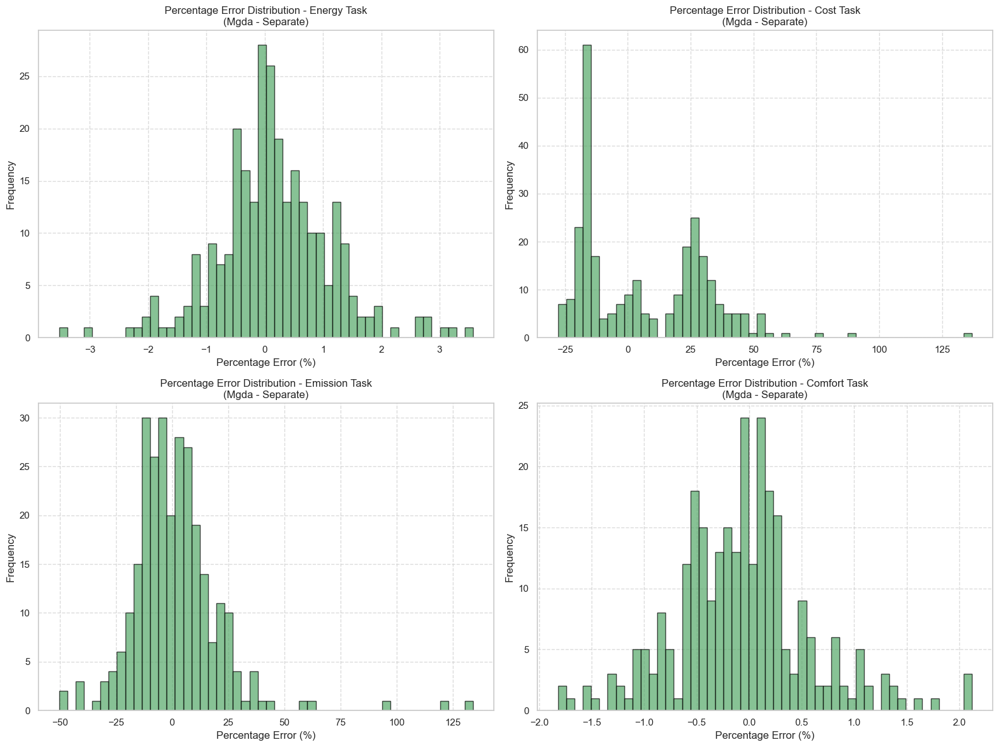


Evaluating Ref_based_isa Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.519989      3.997036    1.999259  0.840869
Cost      139.754593  26539.751953  162.910263  0.537071
Emission   21.604370    677.205322   26.023169  0.755687
Comfort     7.375749     76.525467    8.747884  0.958410


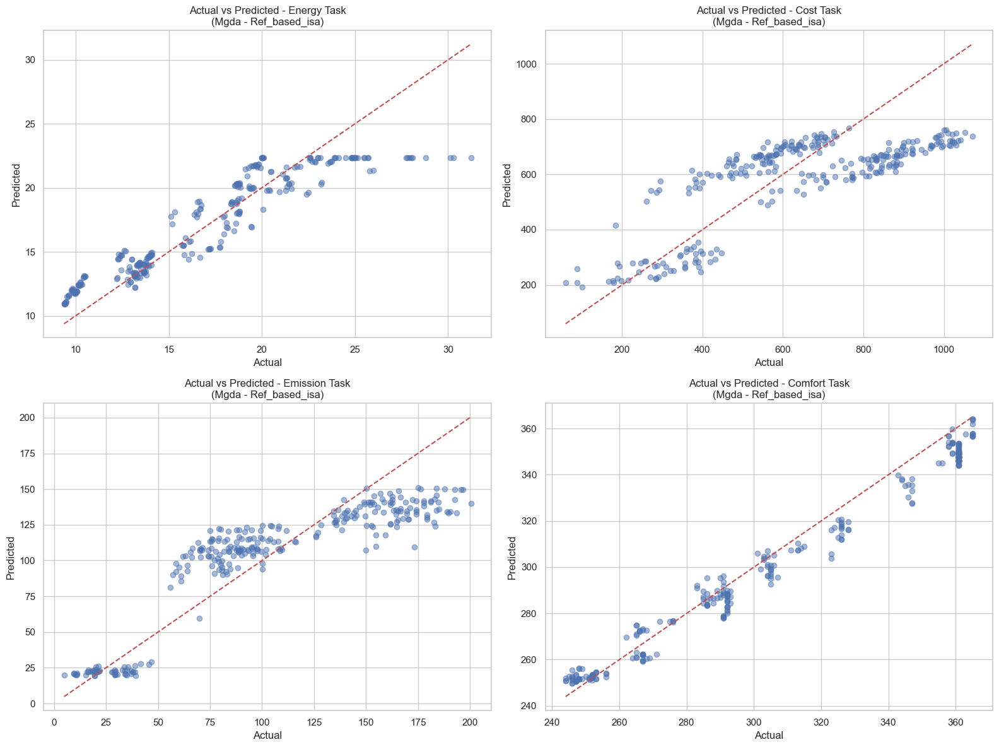


Generating Percentage Error Distribution Plots...


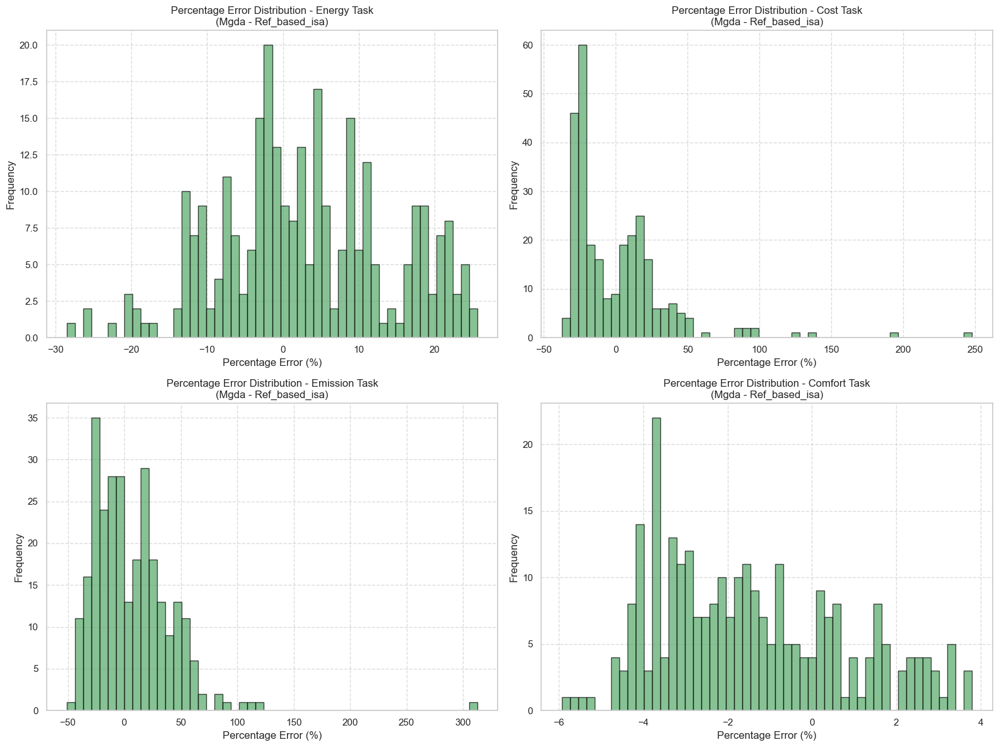


Evaluating Data_based_isa Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.142639      2.065797    1.437288  0.917756
Cost      138.349182  23130.791016  152.088104  0.596533
Emission   20.186502    619.858276   24.896954  0.776375
Comfort     6.656771     61.041058    7.812878  0.966826


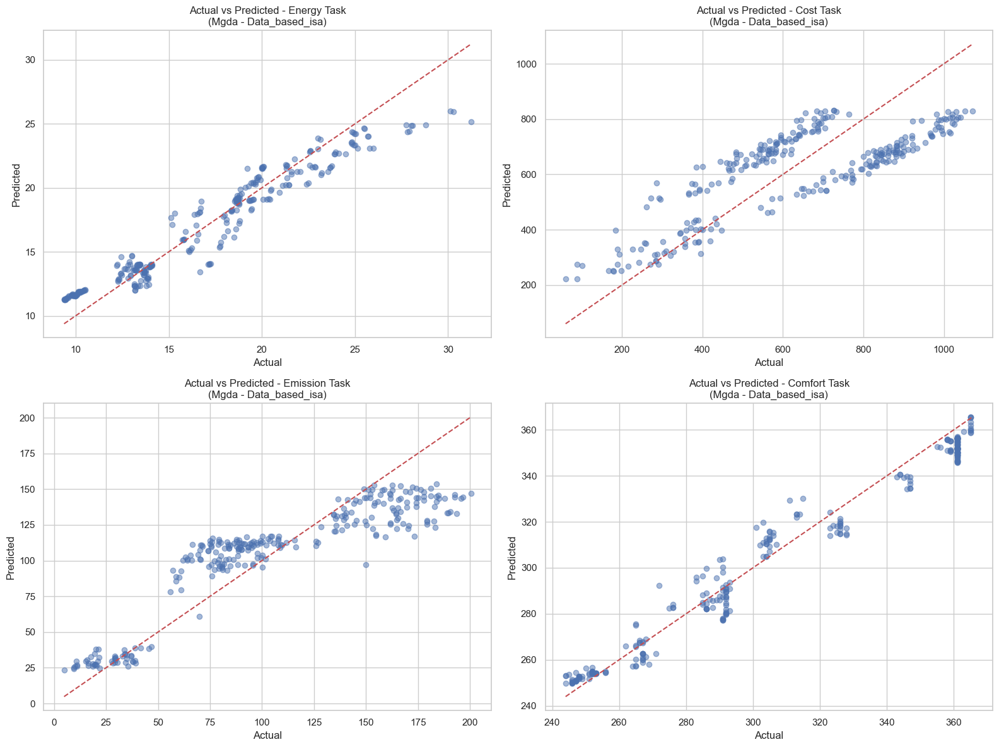


Generating Percentage Error Distribution Plots...


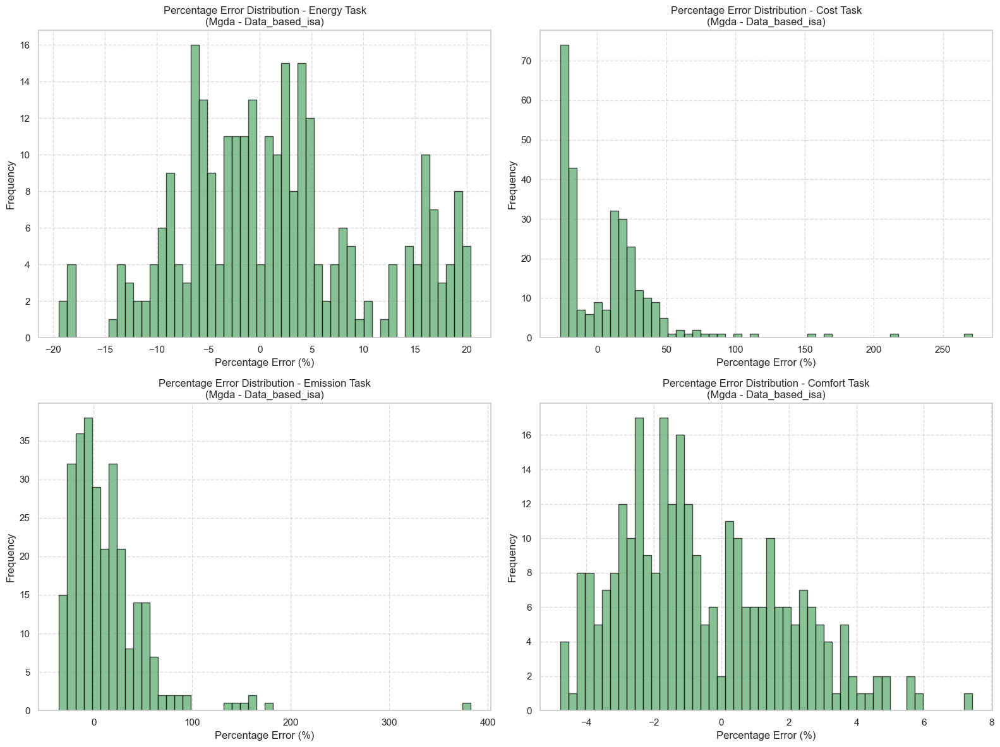


Evaluating More_shared_layer Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.688830      5.121573    2.263089  0.796098
Cost      149.076218  33378.574219  182.698044  0.417782
Emission   25.474321   1019.911987   31.936062  0.632049
Comfort     9.138132    150.724792   12.277002  0.918085


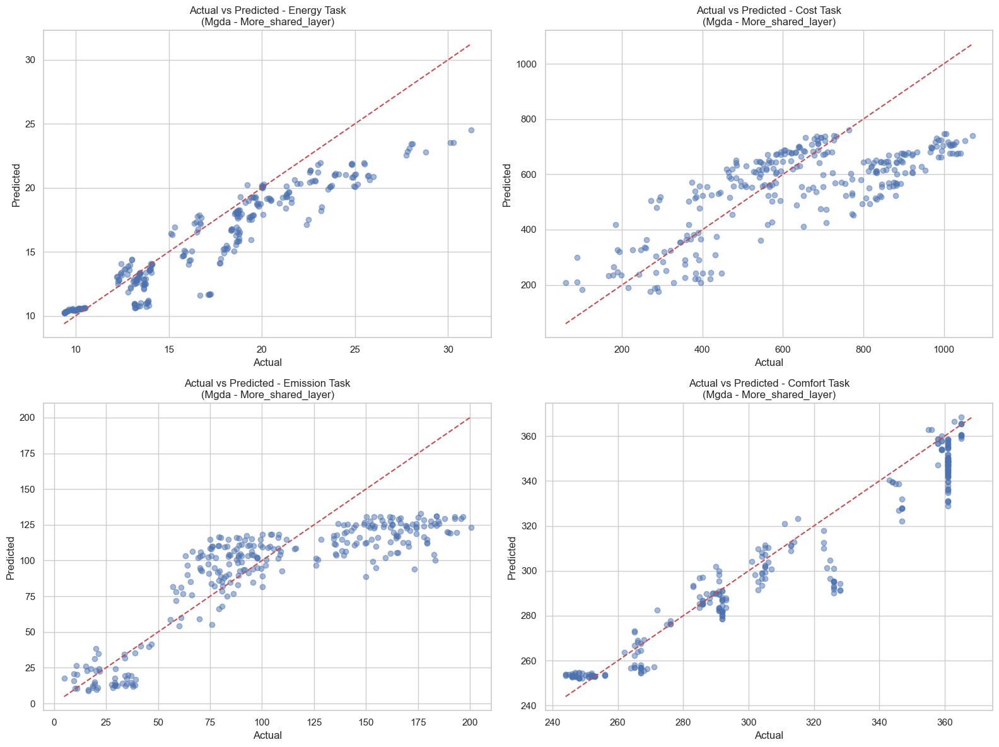


Generating Percentage Error Distribution Plots...


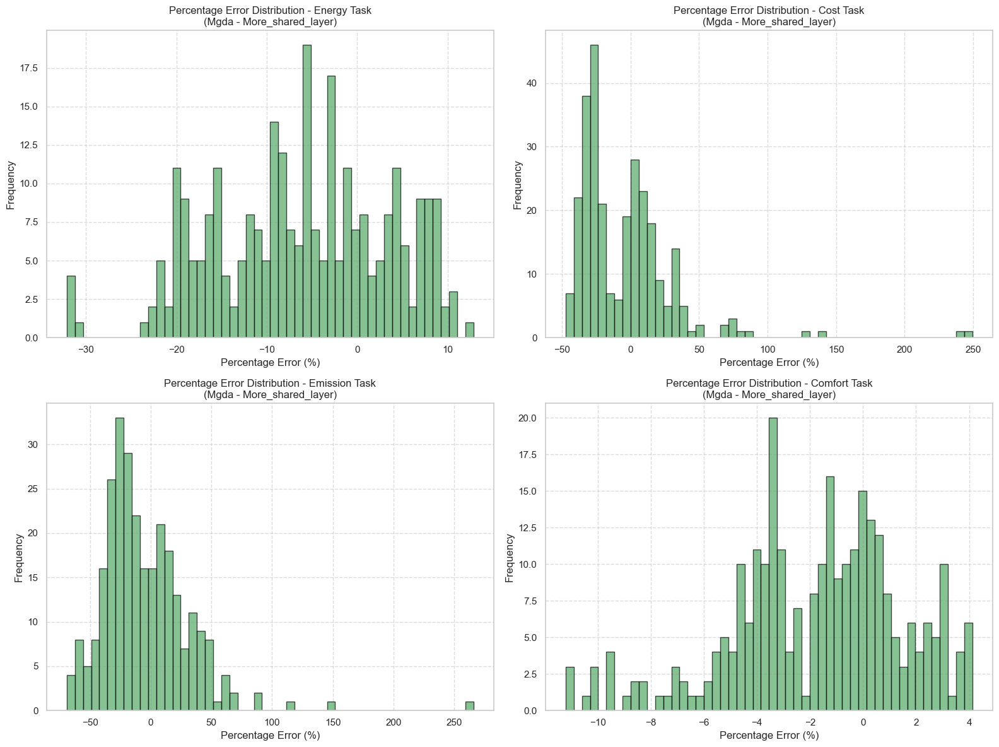


Evaluating Few_shared_layers Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.669397      0.749375    0.865664  0.970166
Cost      170.288605  48565.828125  220.376556  0.152873
Emission   20.301363    704.127747   26.535406  0.745974
Comfort     6.340255     58.177650    7.627428  0.968382


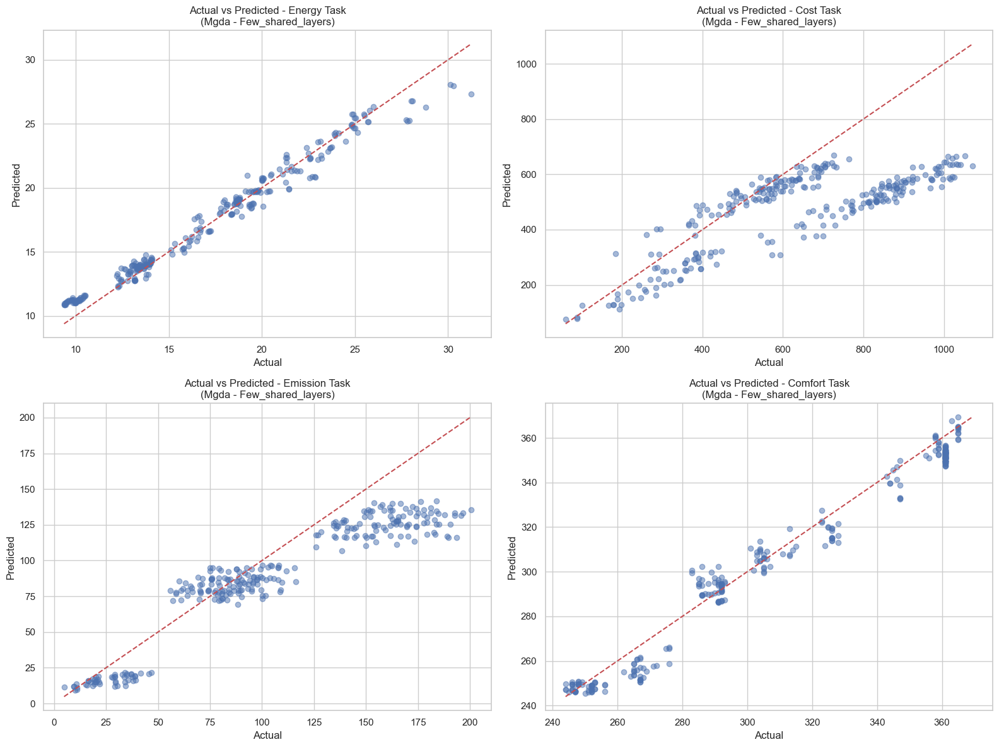


Generating Percentage Error Distribution Plots...


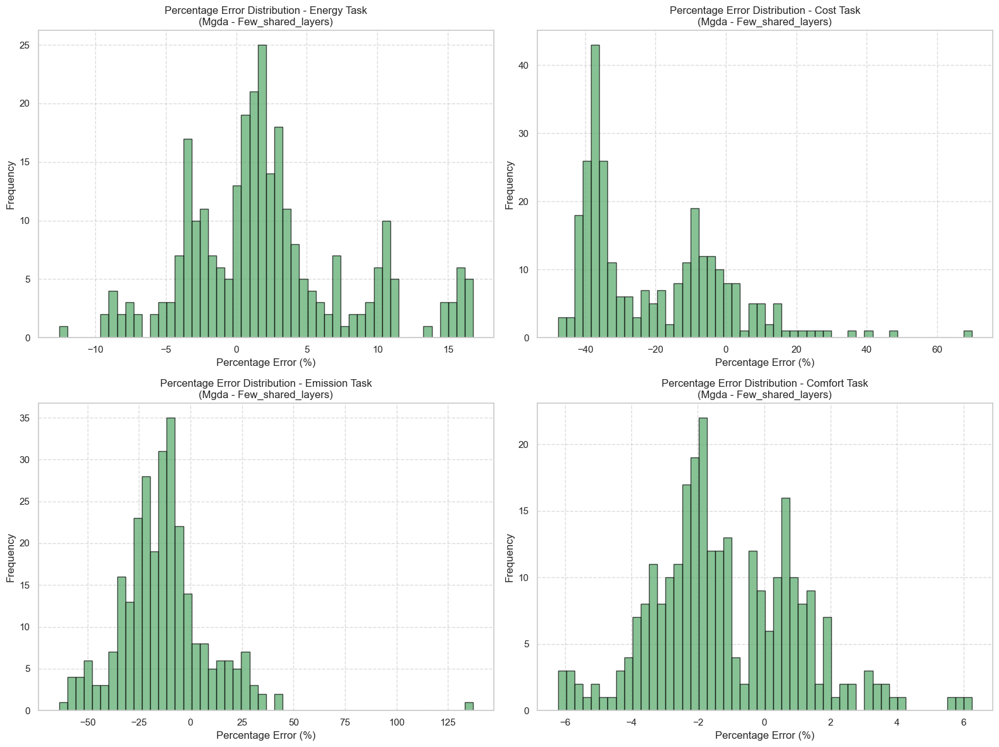


Evaluating Deep_balanced_layer Model with Mgda Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.891004      1.214203    1.101909  0.951660
Cost      136.940857  23785.962891  154.226990  0.585105
Emission   15.619781    408.339722   20.207418  0.852684
Comfort     4.920885     33.803795    5.814103  0.981629


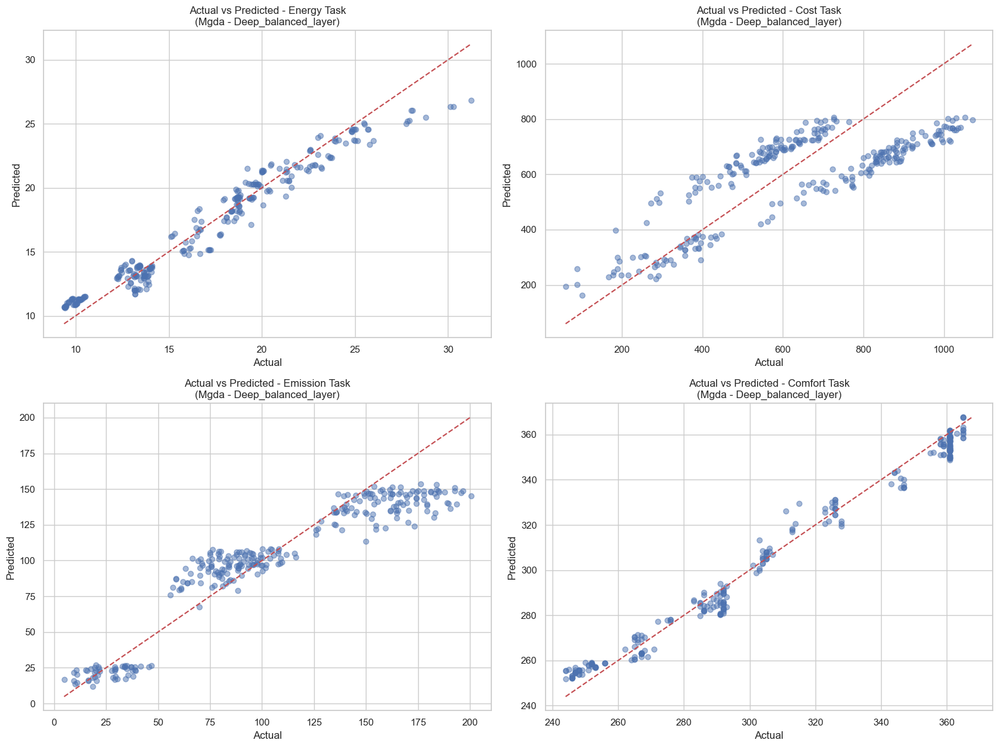


Generating Percentage Error Distribution Plots...


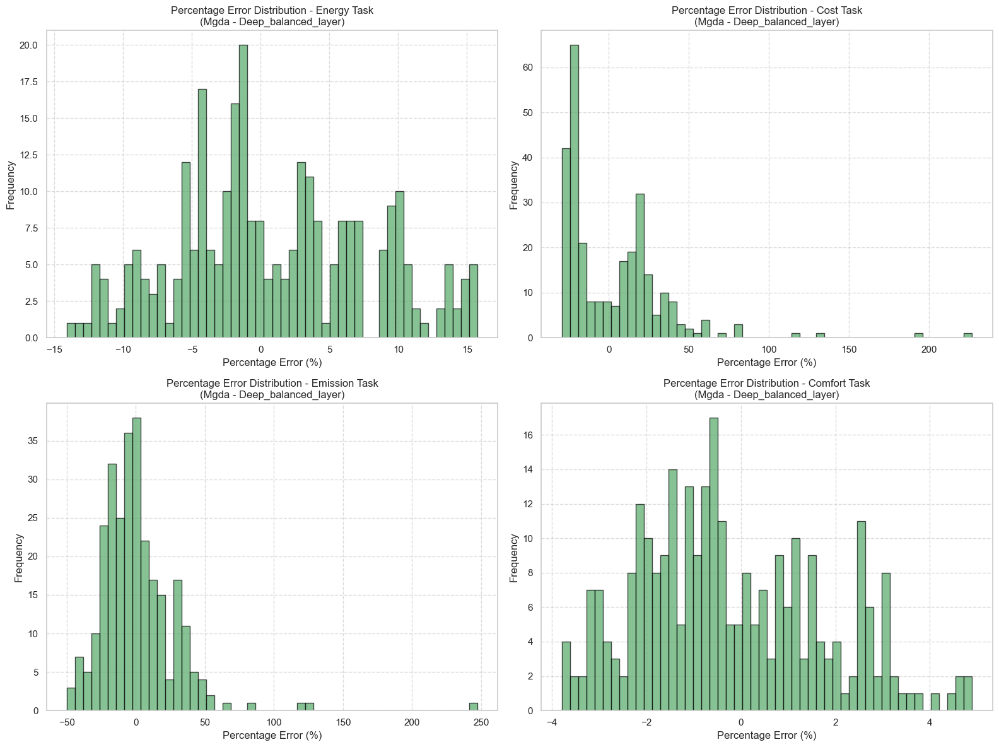


Evaluating Shared Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.980521      1.522024    1.233703  0.939405
Cost      138.811523  27308.662109  165.253326  0.523659
Emission   14.422290    375.050201   19.366213  0.864694
Comfort     6.716558     58.064144    7.619983  0.968444


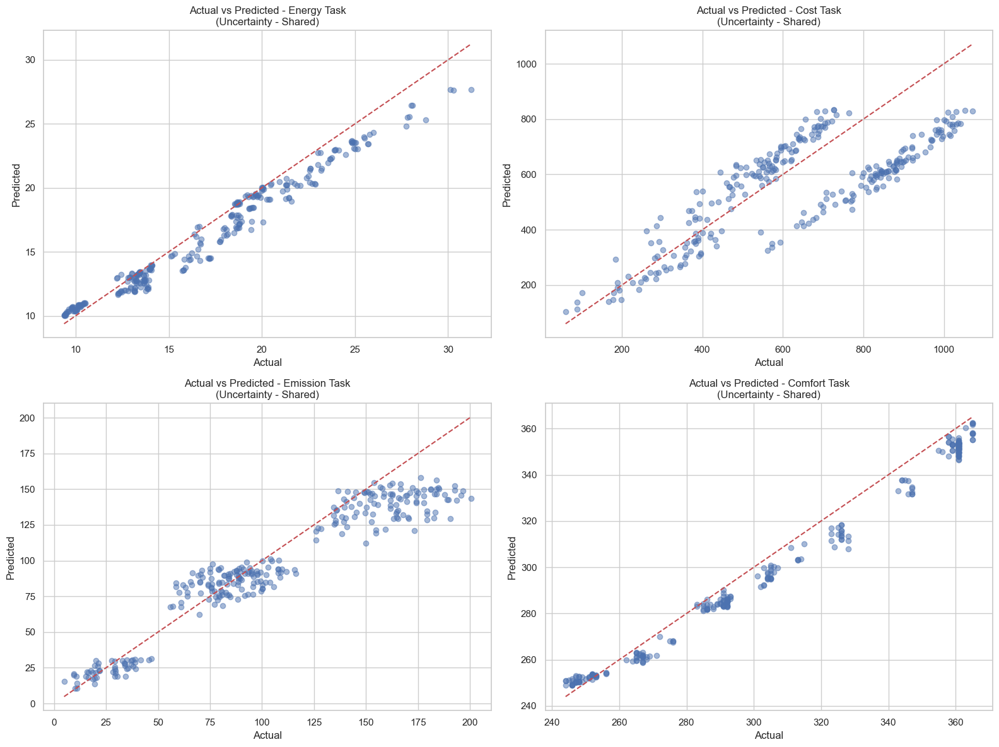


Generating Percentage Error Distribution Plots...


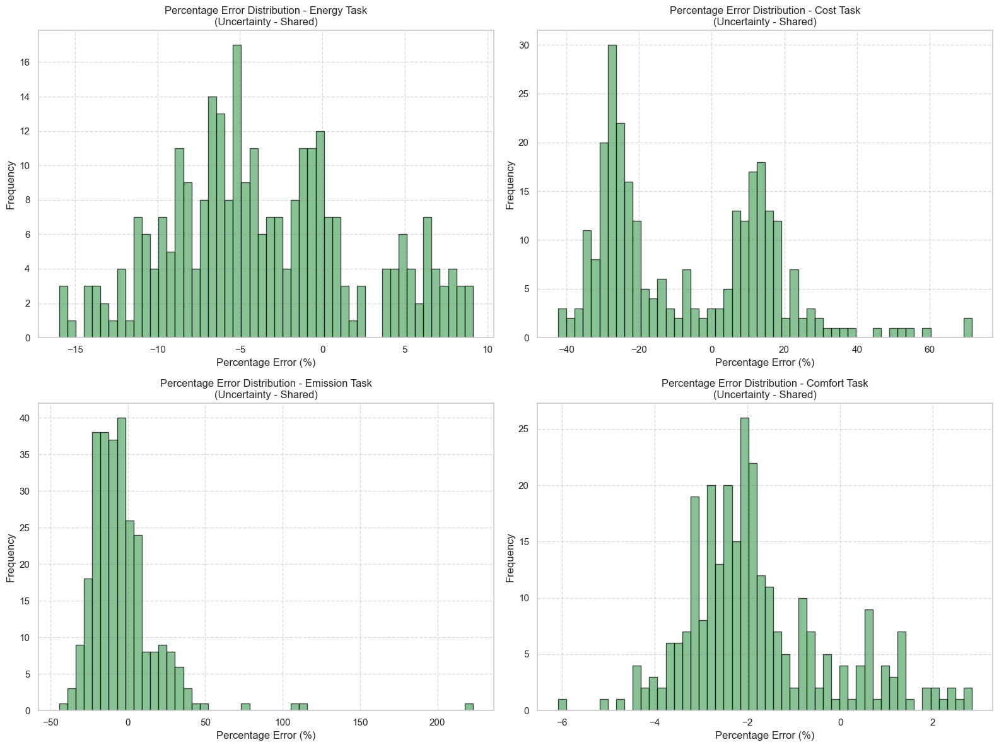


Evaluating Separate Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.068811      0.007976    0.089306  0.999682
Cost      137.204849  22853.837891  151.174866  0.601364
Emission   10.826985    175.937134   13.264130  0.936528
Comfort     0.650722      0.782859    0.884793  0.999575


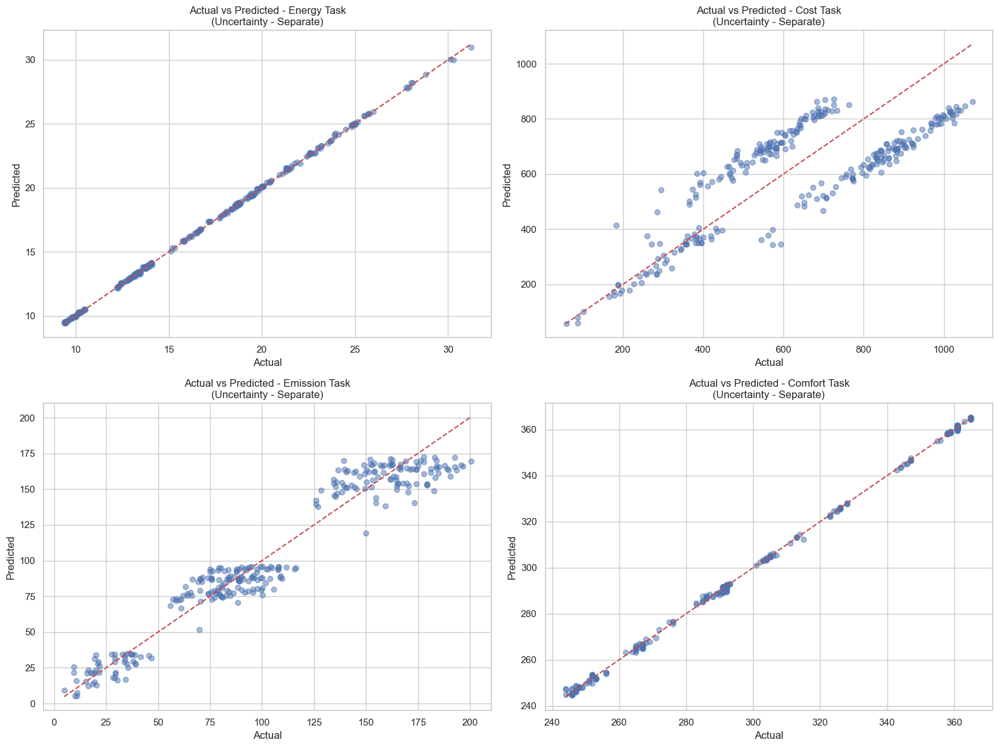


Generating Percentage Error Distribution Plots...


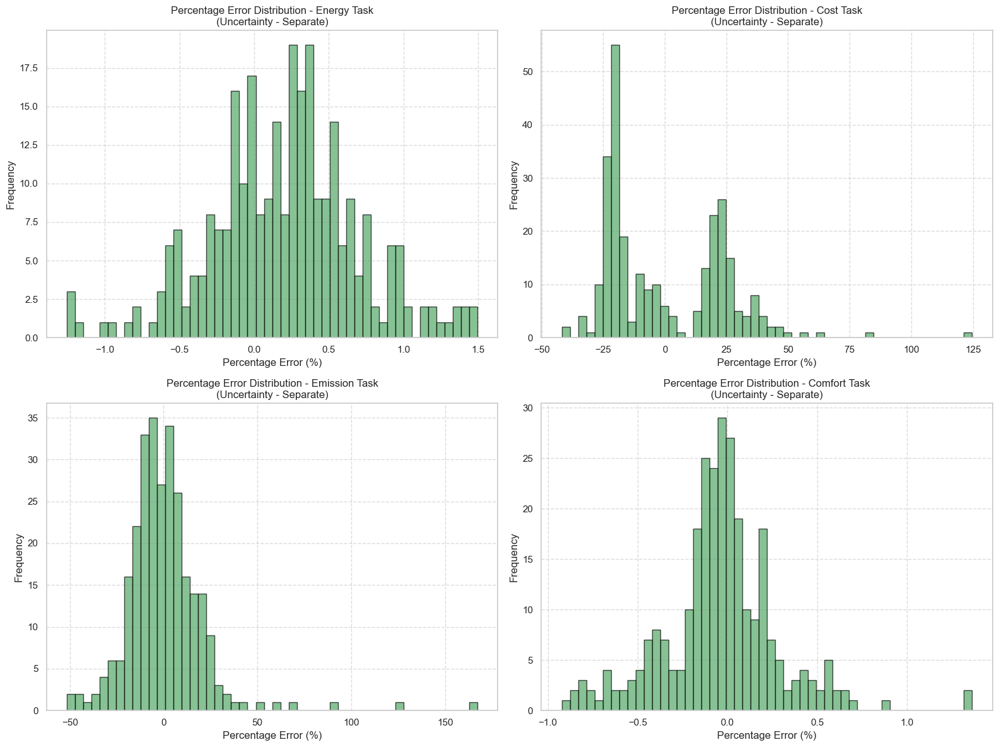


Evaluating Ref_based_isa Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.333181      2.799477    1.673164  0.888546
Cost      139.293945  26666.482422  163.298752  0.534860
Emission   19.953011    595.080811   24.394278  0.785314
Comfort     5.996270     47.680122    6.905079  0.974087


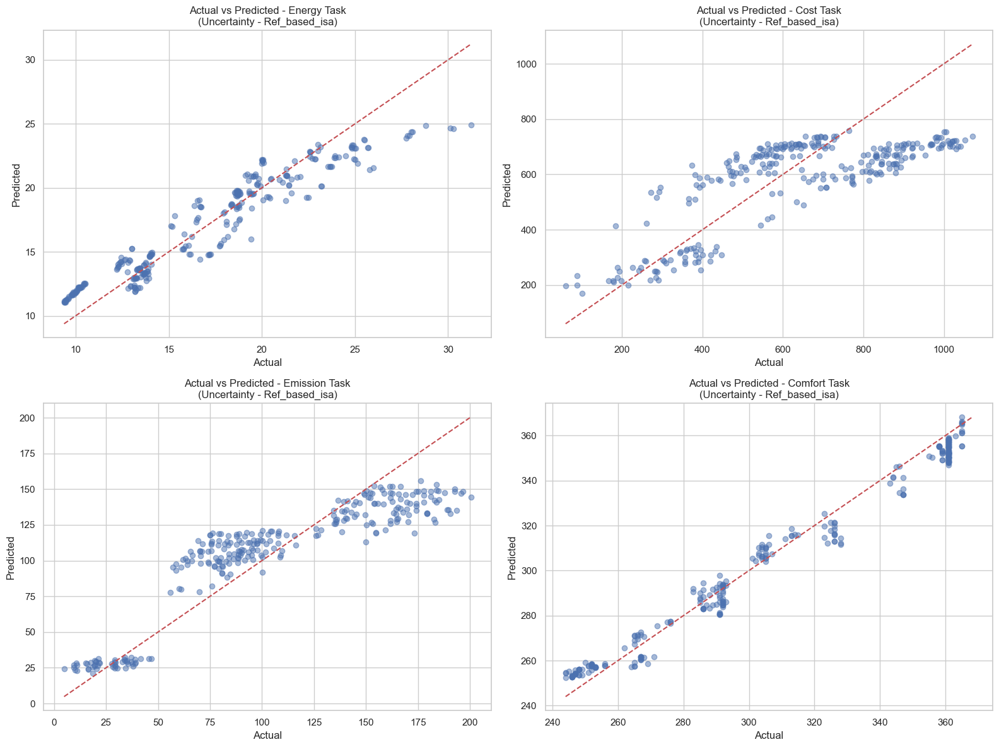


Generating Percentage Error Distribution Plots...


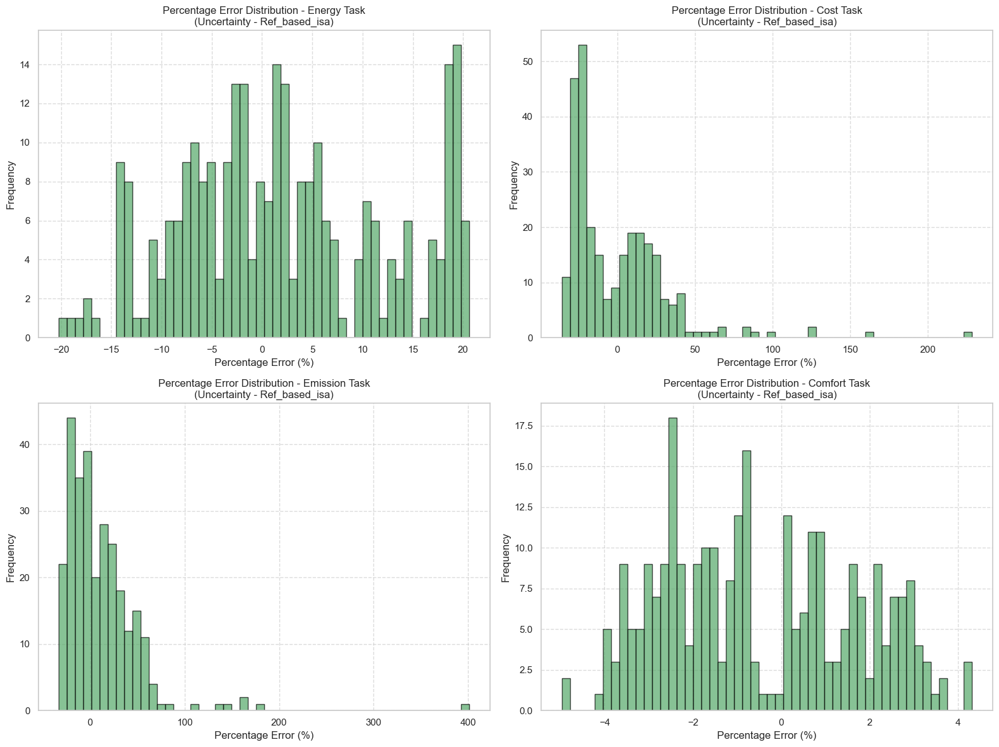


Evaluating Data_based_isa Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.259598      2.709565    1.646075  0.892126
Cost      137.082794  23254.578125  152.494522  0.594374
Emission   17.657272    502.164673   22.409031  0.818835
Comfort     6.050025     54.217430    7.363249  0.970534


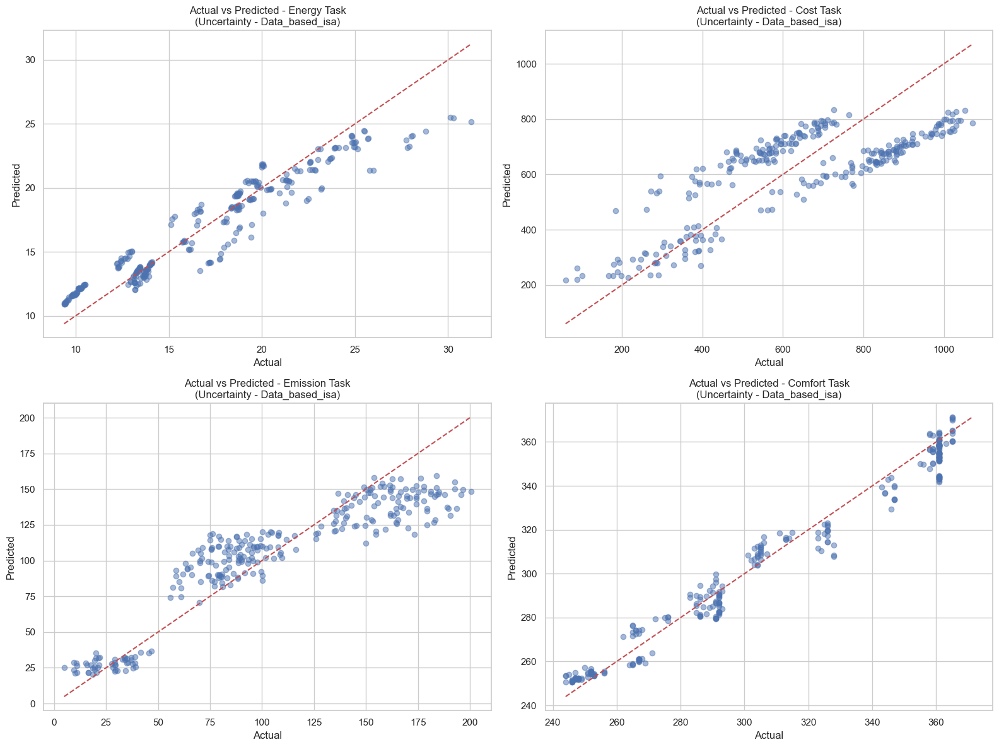


Generating Percentage Error Distribution Plots...


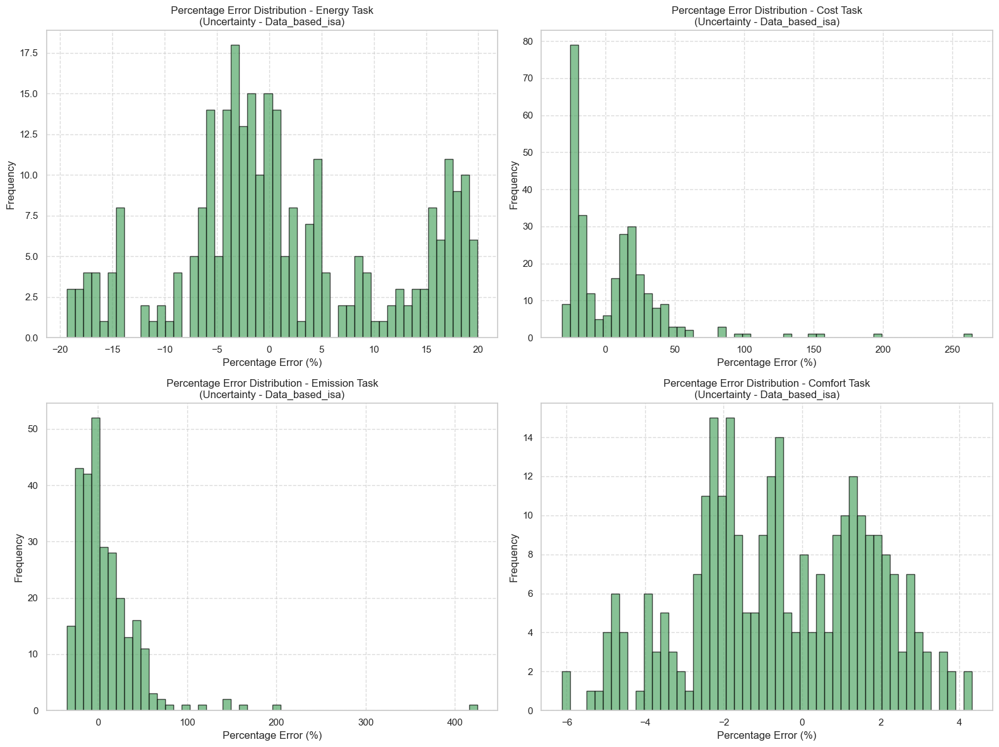


Evaluating More_shared_layer Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.565603      3.933249    1.983242  0.843408
Cost      139.681747  24365.285156  156.093842  0.575000
Emission   21.490465    835.027954   28.896851  0.698749
Comfort     7.669470     81.302696    9.016801  0.955814


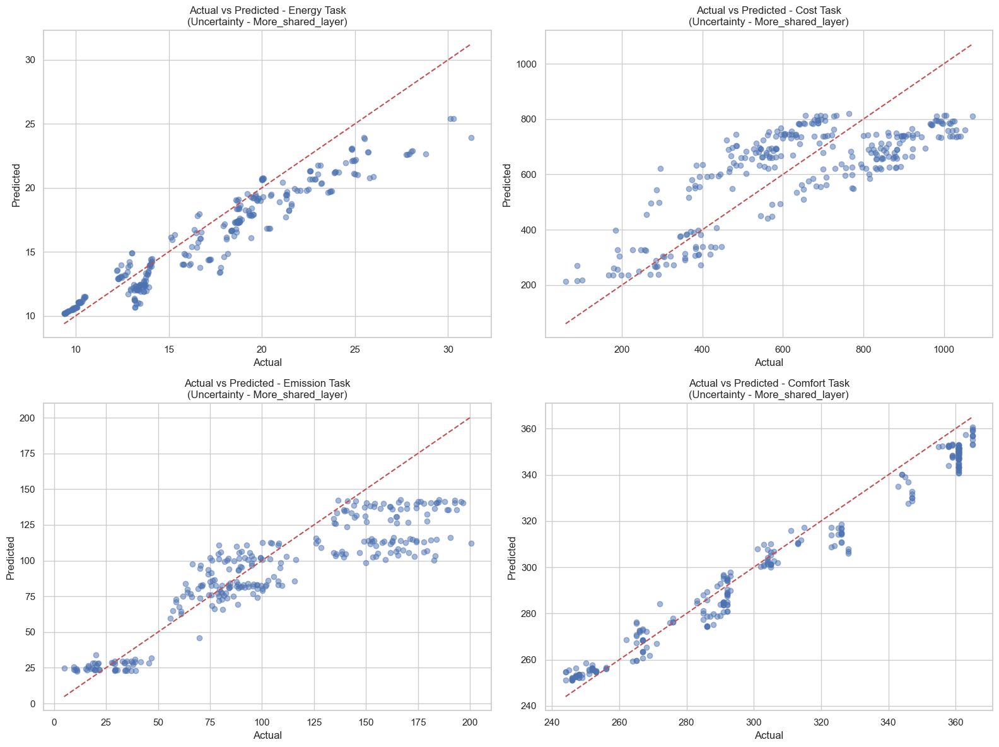


Generating Percentage Error Distribution Plots...


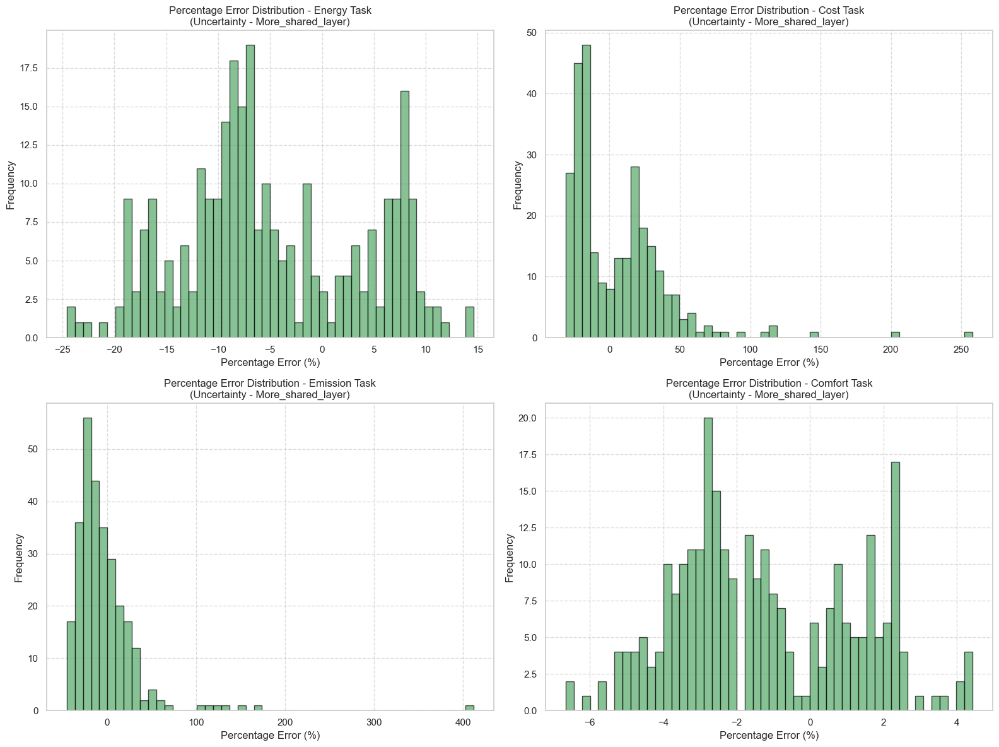


Evaluating Few_shared_layers Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.689699      0.809483    0.899713  0.967773
Cost      181.746750  56845.136719  238.422180  0.008459
Emission   18.022491    548.482727   23.419708  0.802125
Comfort     3.065502     12.812986    3.579523  0.993036


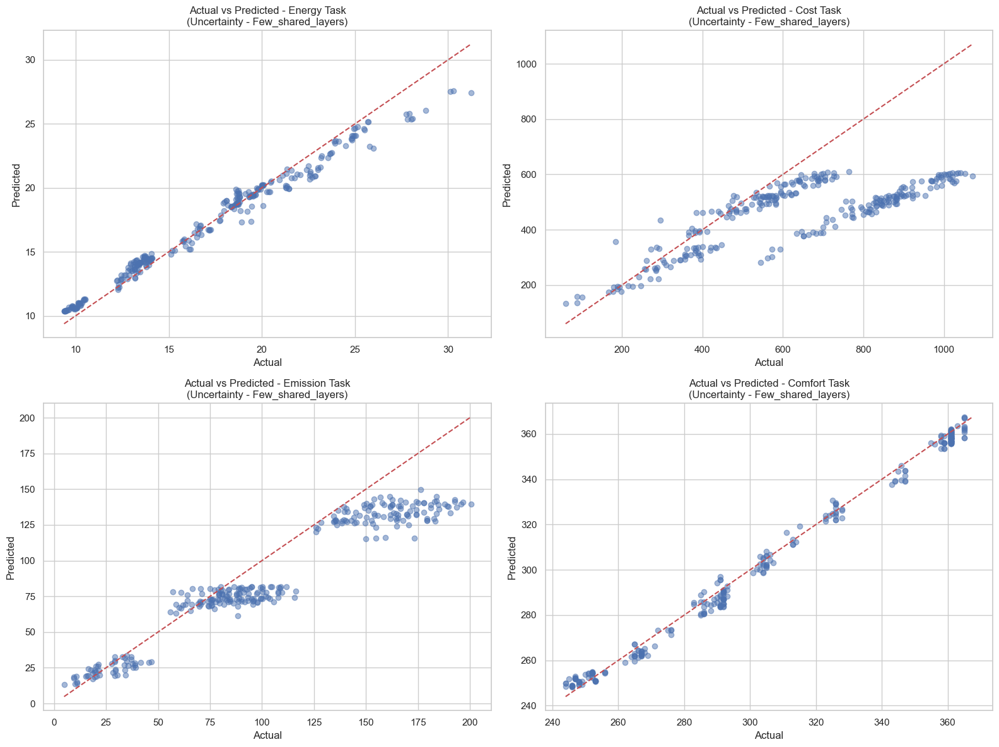


Generating Percentage Error Distribution Plots...


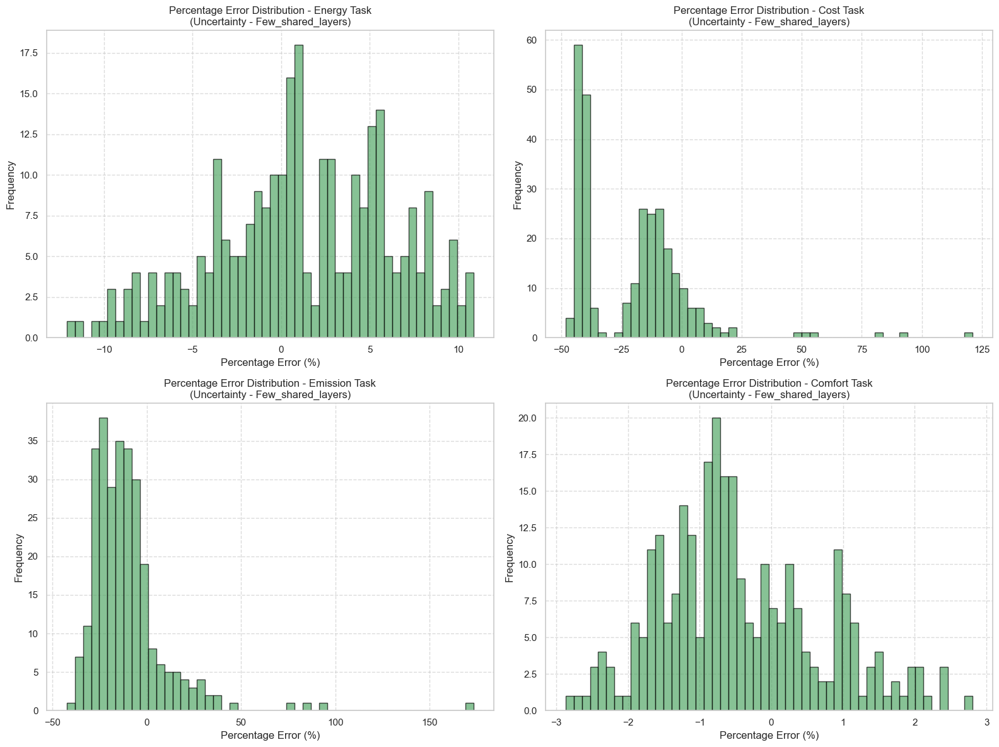


Evaluating Deep_balanced_layer Model with Uncertainty Method:

Generating Actual vs Predicted Plots...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.205781      2.603370    1.613496  0.896354
Cost      137.277542  24959.101562  157.984497  0.564642
Emission   15.160006    392.653748   19.815493  0.858343
Comfort     6.470131     62.008545    7.874550  0.966300


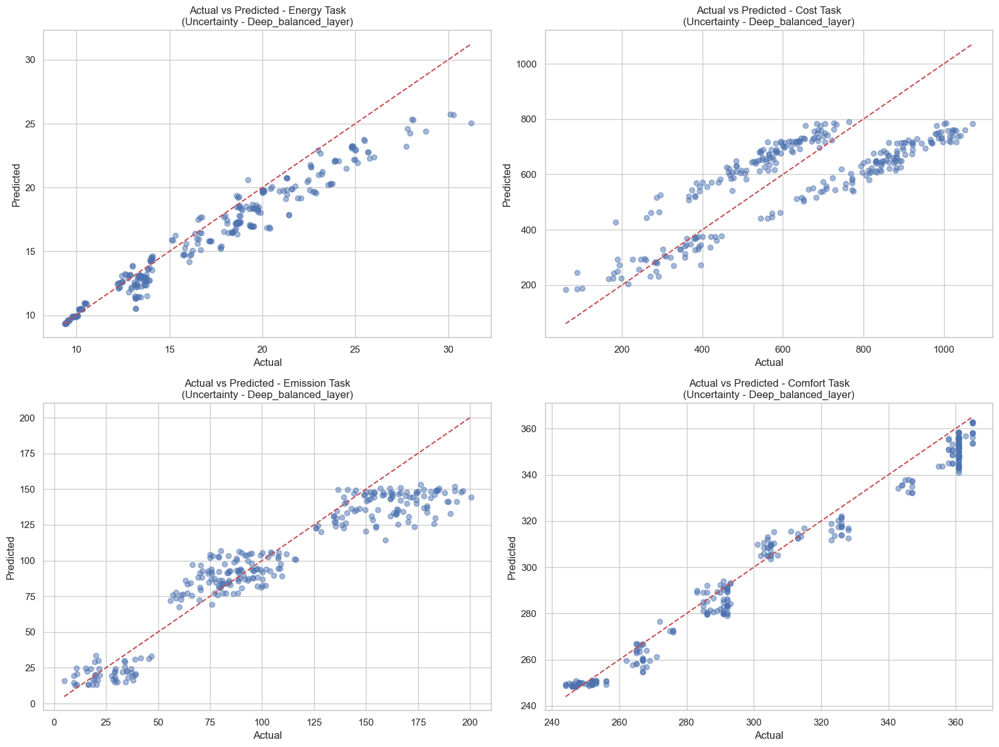


Generating Percentage Error Distribution Plots...


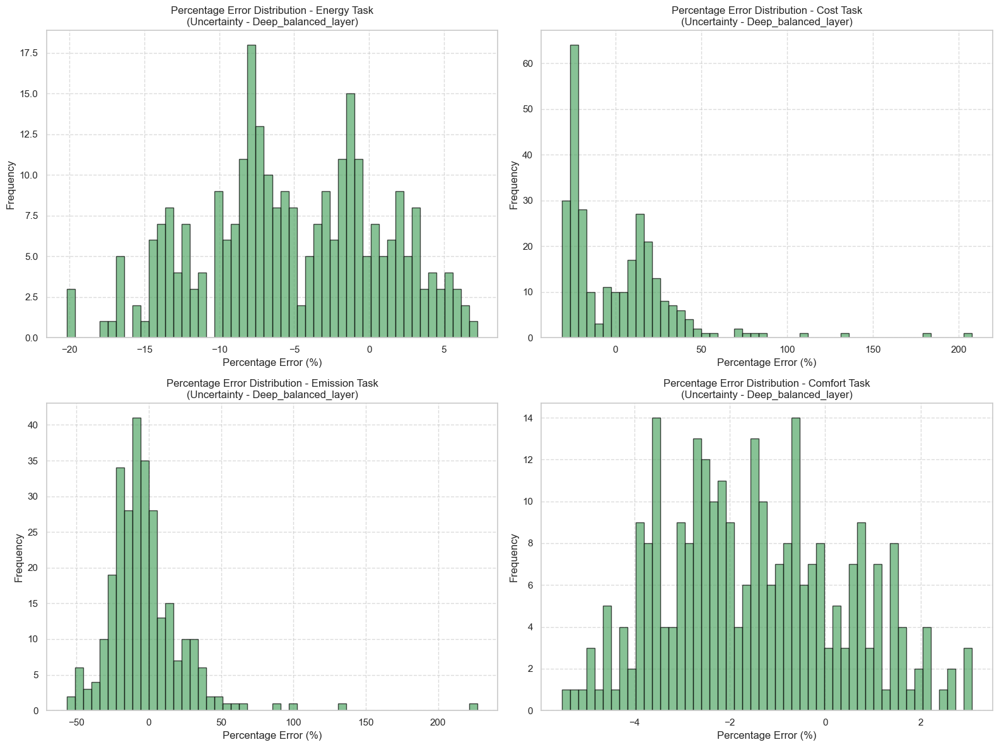

In [126]:
# 9.1. Evaluate Models - Figure Generation

# Define task names
task_names = ['Energy', 'Cost', 'Emission', 'Comfort']


# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Loop through each method and model type to evaluate models
for method in method_list:
    for model_type in model_type_list:
        print(f"\nEvaluating {model_type.capitalize()} Model with {method.replace('_', ' ').capitalize()} Method:")
        
        # Initialize model based on method and model_type
        if method == 'uncertainty':
            if model_type == 'shared':
                model = SharedMTLModelWithUncertainty(input_size, hidden_size, num_tasks=4)
            elif model_type == 'separate':
                model = SeparateMTLModelWithUncertainty(input_size, hidden_size, num_tasks=4)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(input_size, hidden_size1=128, hidden_size2=64, 
                                        shared_energy_emission_size=32, shared_comfort_size=32, 
                                        dropout_rate=0.5, num_tasks=4)
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                print("Invalid model type. Skipping this model.")
                continue
        elif method == 'cagrad':
            if model_type == 'shared':
                model = SharedMTLModel(input_size, hidden_size)
            elif model_type == 'separate':
                model = SeparateMTLModel(input_size, hidden_size)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(input_size, hidden_size1=128, hidden_size2=64, 
                                        shared_energy_emission_size=32, shared_comfort_size=32, 
                                        dropout_rate=0.5, num_tasks=4)
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                print("Invalid model type. Skipping this model.")
                continue
        else:
            if model_type == 'shared':
                model = SharedMTLModel(input_size, hidden_size)
            elif model_type == 'separate':
                model = SeparateMTLModel(input_size, hidden_size)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(input_size, hidden_size1=128, hidden_size2=64, 
                                        shared_energy_emission_size=32, shared_comfort_size=32, 
                                        dropout_rate=0.5, num_tasks=4)
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                print("Invalid model type. Skipping this model.")
                continue

        # Move model to device
        model.to(device)

        # Load the trained model weights
        model_path = get_model_path(method, model_type)
        if not os.path.exists(model_path):
            print(f"Model file {model_path} does not exist. Skipping this model.")
            continue
        model.load_state_dict(torch.load(model_path, map_location=device))
        model.to(device)

        # Load the input scaler
        scaler_X_path = get_scaler_path(method, model_type, scaler_type='X')
        if not os.path.exists(scaler_X_path):
            print(f"Scaler file {scaler_X_path} does not exist. Skipping this model.")
            continue
        scaler_X = joblib.load(scaler_X_path)

        # Load scalers for Y (one per task)
        scalers_Y = []
        for i in range(len(task_names)):
            scaler_Y_path = get_scaler_path(method, model_type, scaler_type=f'Y_{i}')
            if not os.path.exists(scaler_Y_path):
                print(f"Scaler file {scaler_Y_path} does not exist for task {task_names[i]}. Skipping this model.")
                break
            scaler = joblib.load(scaler_Y_path)
            scalers_Y.append(scaler)
        else:
            # Proceed only if all Y scalers are loaded
            pass
        # If break was called in the for-loop above, scalers_Y won't have all scalers
        if len(scalers_Y) != len(task_names):
            print(f"Incomplete scalers for model {model_type}_{method}. Skipping this model.")
            continue

        # Define feature names
        feature_names = input_features  # Ensure this matches the order and number of input features

        # ---------------------------------------------------
        # 9.1.1. Actual vs Predicted Plots
        # ---------------------------------------------------
        print("\nGenerating Actual vs Predicted Plots...")
        # Evaluate to get targets and predictions
        metrics_df, targets_real, predictions_real = evaluate_model_inverse_transform(
            model, test_loader, scalers_Y, method=method, model_type=model_type
        )
        plot_actual_vs_predicted(targets_real, predictions_real, method=method, model_type=model_type)

        # ---------------------------------------------------
        # 9.1.2. Percentage Error Distribution Plots
        # ---------------------------------------------------
        print("\nGenerating Percentage Error Distribution Plots...")
        evaluate_model_percentage_error(
            model, test_loader, scalers_Y, method=method, model_type=model_type, save_plots=True
        )

        # Note: Additional plots can be added here following the same structure


## 9.2. Evaluate Models - Numerical Evaluations and Model Ranking



Evaluating Shared Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.009554      1.825196    1.350998  0.927335
Cost      140.973770  25406.294922  159.393524  0.556842
Emission   16.884350    464.805511   21.559349  0.832313
Comfort     5.864876     50.616337    7.114516  0.972491

Performing Error Analysis...

Energy Task: 44 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 13.35, Predicted: 11.91, Error: 10.81%
Actual: 17.79, Predicted: 15.83, Error: 11.04%
Actual: 16.17, Predicted: 14.29, Error: 11.64%
Actual: 15.72, Predicted: 13.33, Error: 15.22%
Actual: 15.80, Predicted: 13.40, Error: 15.19%

Cost Task: 245 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 549.86, Error: 16.00%
Actual: 881.00, Predicted: 646.88, Error: 26.57%
Actual: 923.00, Predi

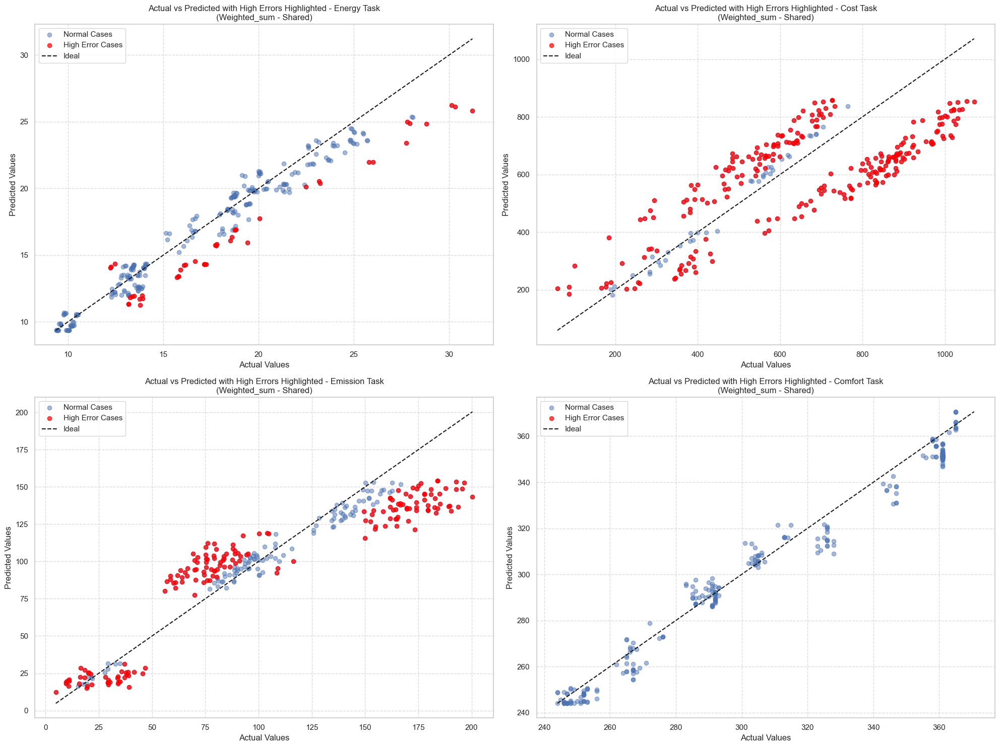


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.411954    1.851195  0.863566
Cost      143.160568  169.686401  0.497760
Emission   21.822380   28.388680  0.709252
Comfort    10.060144   13.674582  0.898374


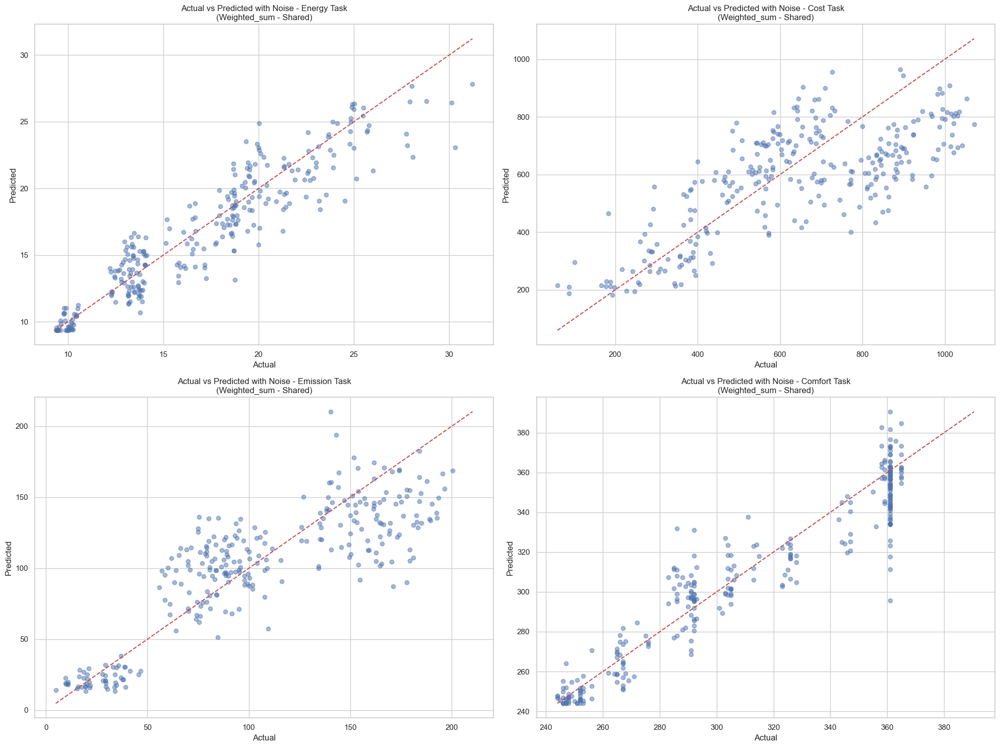


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - Shared:
                 MAE        RMSE        R2
Task                                      
Energy      1.009554    1.350998  0.927335
Cost      140.973770  159.393524  0.556842
Emission   16.884350   21.559349  0.832313
Comfort     5.864876    7.114516  0.972491


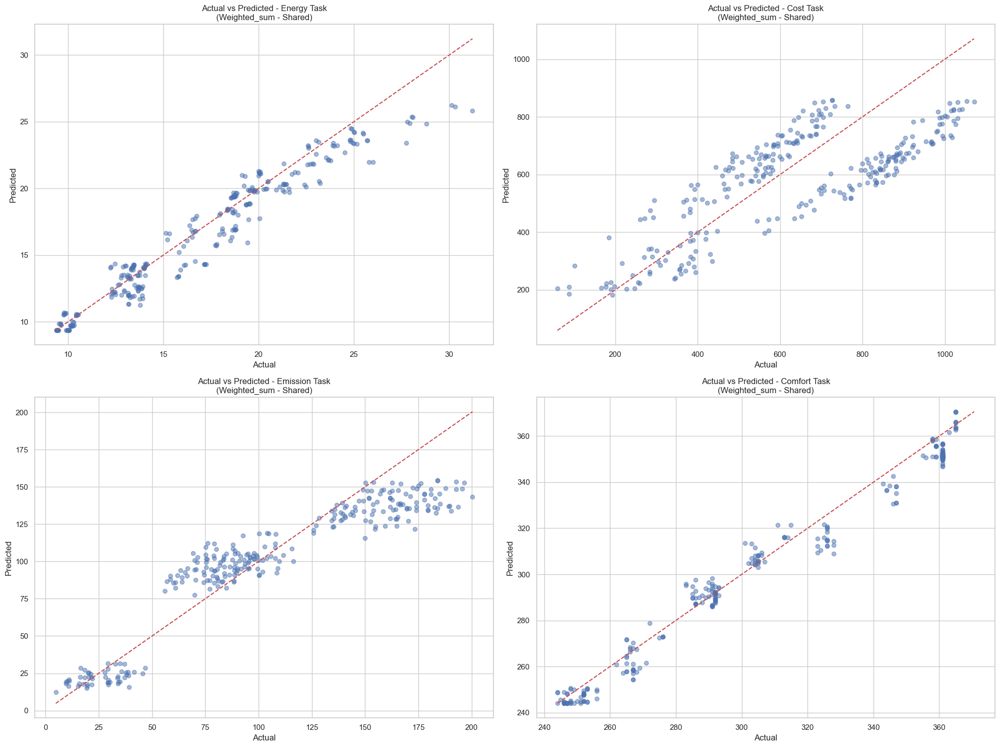


Evaluating Separate Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.178714      0.055733    0.236078  0.997781
Cost      133.844162  21187.250000  145.558411  0.630434
Emission   10.559045    171.458939   13.094233  0.938143
Comfort    66.308525   6236.834961   78.973633 -2.389557

Performing Error Analysis...

Energy Task: 0 cases with > 10.0% error.
Sample high-error cases for Energy Task:

Cost Task: 247 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 604.67, Error: 27.57%
Actual: 881.00, Predicted: 690.98, Error: 21.57%
Actual: 923.00, Predicted: 782.40, Error: 15.23%
Actual: 901.00, Predicted: 740.90, Error: 17.77%
Actual: 295.00, Predicted: 519.19, Error: 76.00%

Emission Task: 139 cases with > 10.0% error.
Sample high-error cases for Emission Task:
Actual: 30.29, Pred

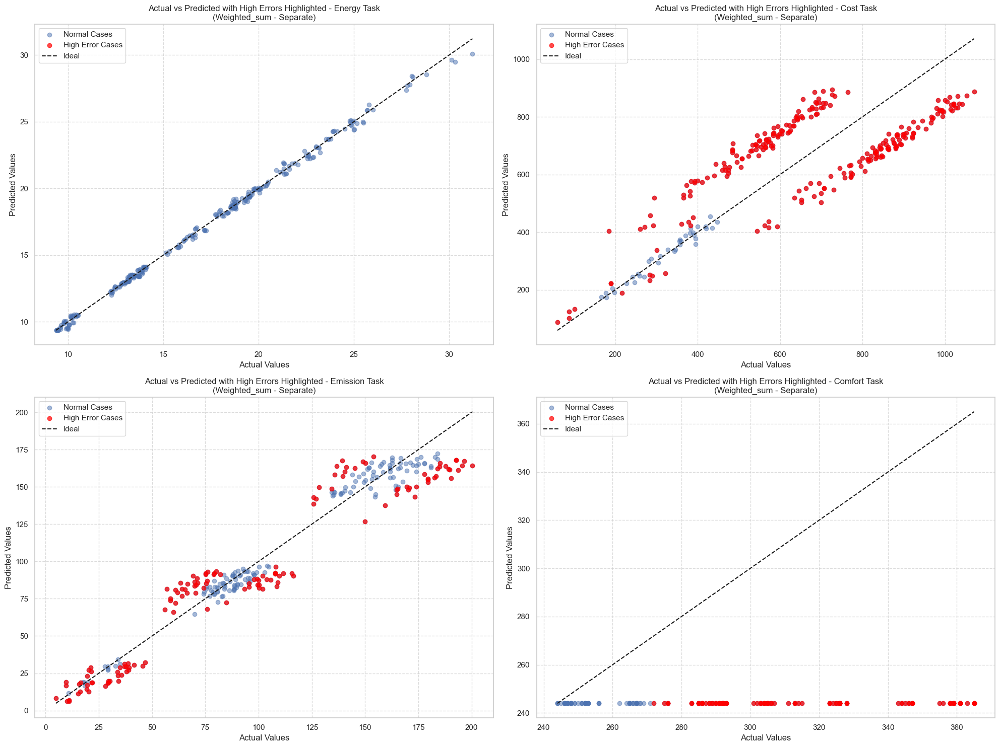


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.271762    1.813900  0.869008
Cost      136.588852  156.867325  0.570778
Emission   23.859070   31.734468  0.636680
Comfort    66.308525   78.973633 -2.389557


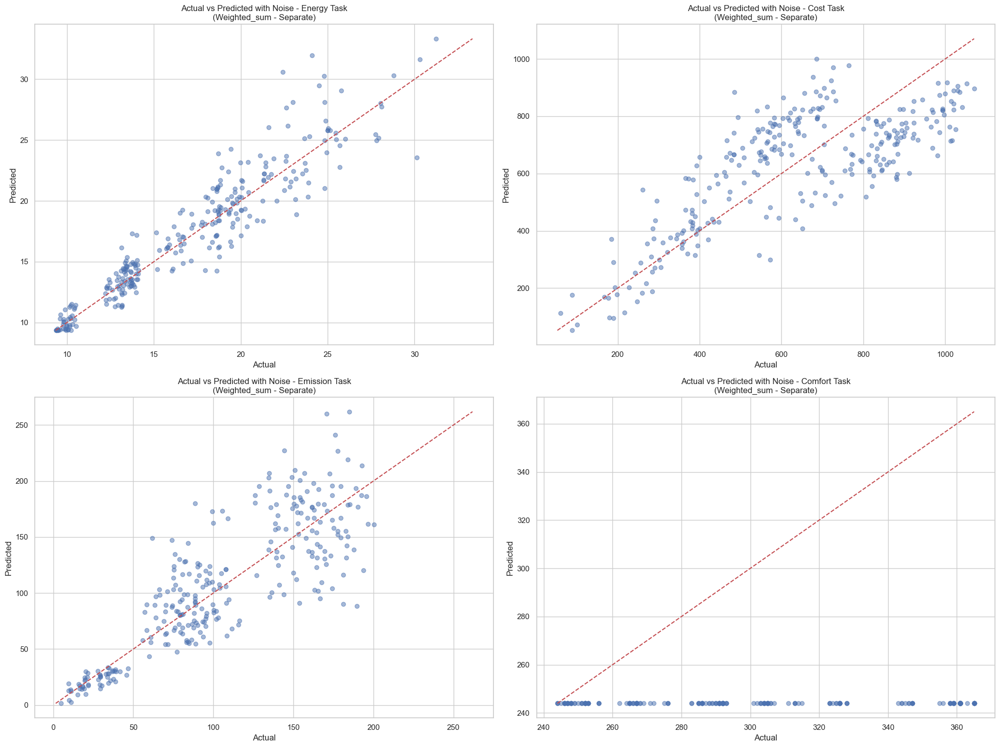


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - Separate:
                 MAE        RMSE        R2
Task                                      
Energy      0.178714    0.236078  0.997781
Cost      133.844162  145.558411  0.630434
Emission   10.559045   13.094233  0.938143
Comfort    66.308525   78.973633 -2.389557


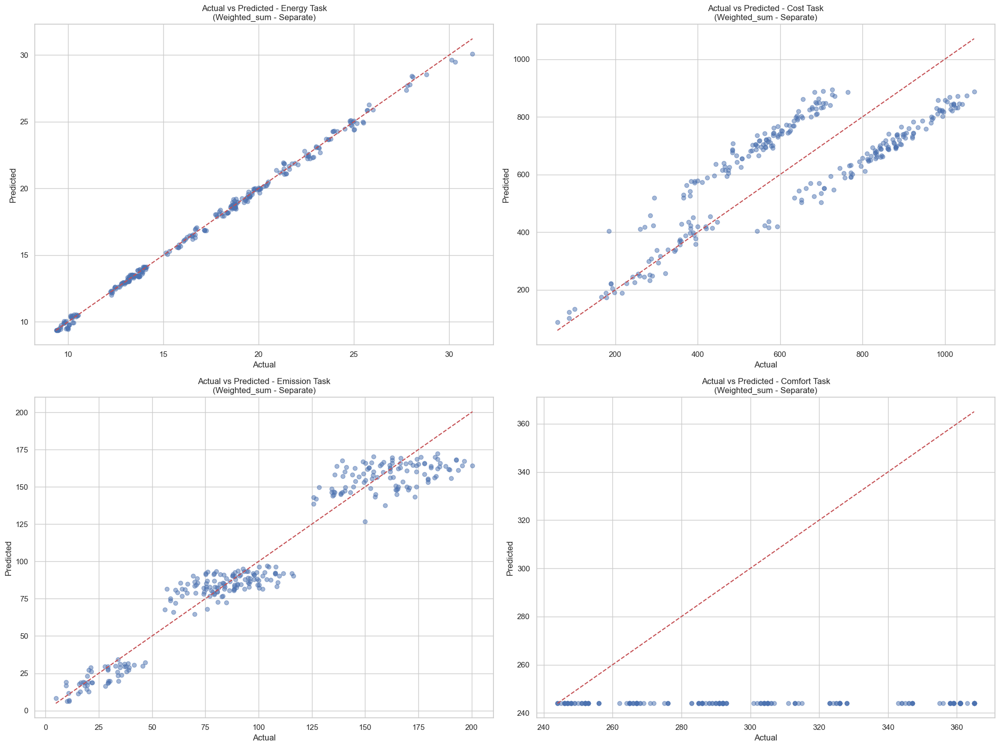


Evaluating Ref_based_isa Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.701795      5.014802    2.239375  0.800349
Cost      142.259964  29628.621094  172.129669  0.483192
Emission   19.222797    581.041016   24.104792  0.790379
Comfort     7.550960     81.077202    9.004288  0.955937

Performing Error Analysis...

Energy Task: 109 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 23.54, Predicted: 20.80, Error: 11.62%
Actual: 12.81, Predicted: 14.79, Error: 15.42%
Actual: 9.50, Predicted: 13.67, Error: 43.93%
Actual: 16.66, Predicted: 18.77, Error: 12.66%
Actual: 16.55, Predicted: 19.67, Error: 18.86%

Cost Task: 224 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 232.72, Error: 17.83%
Actual: 474.00, Predicted: 559.49, Error: 18.04%
Actual: 881.00

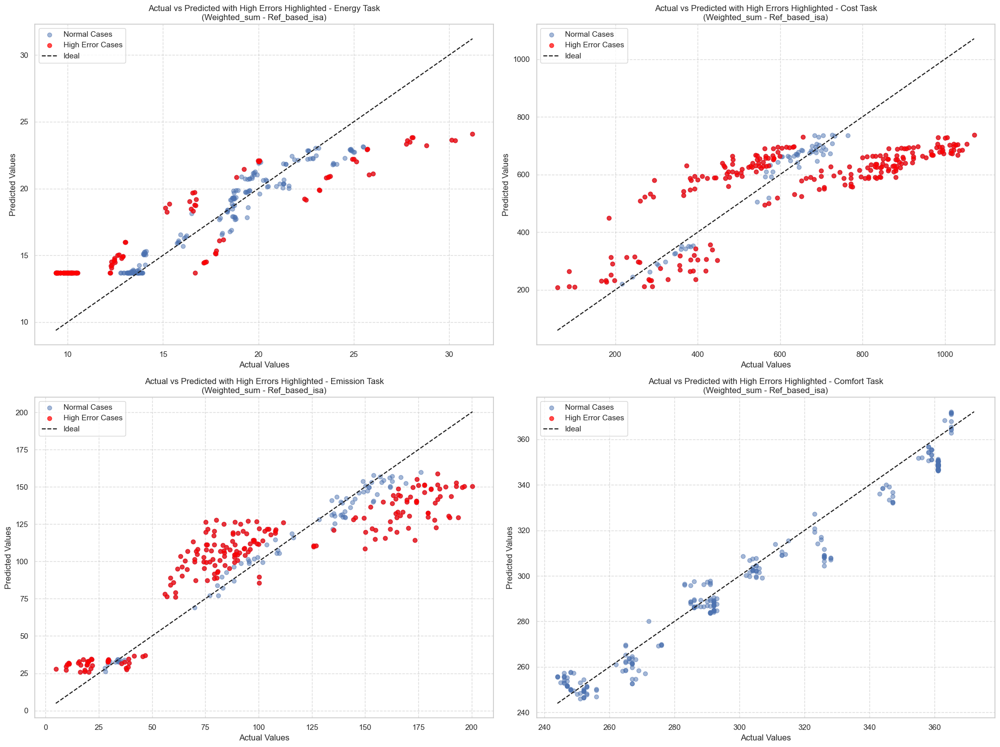


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.984107    2.520299  0.747115
Cost      147.212173  178.980118  0.441238
Emission   23.221277   28.783018  0.701118
Comfort    10.421679   13.579989  0.899775


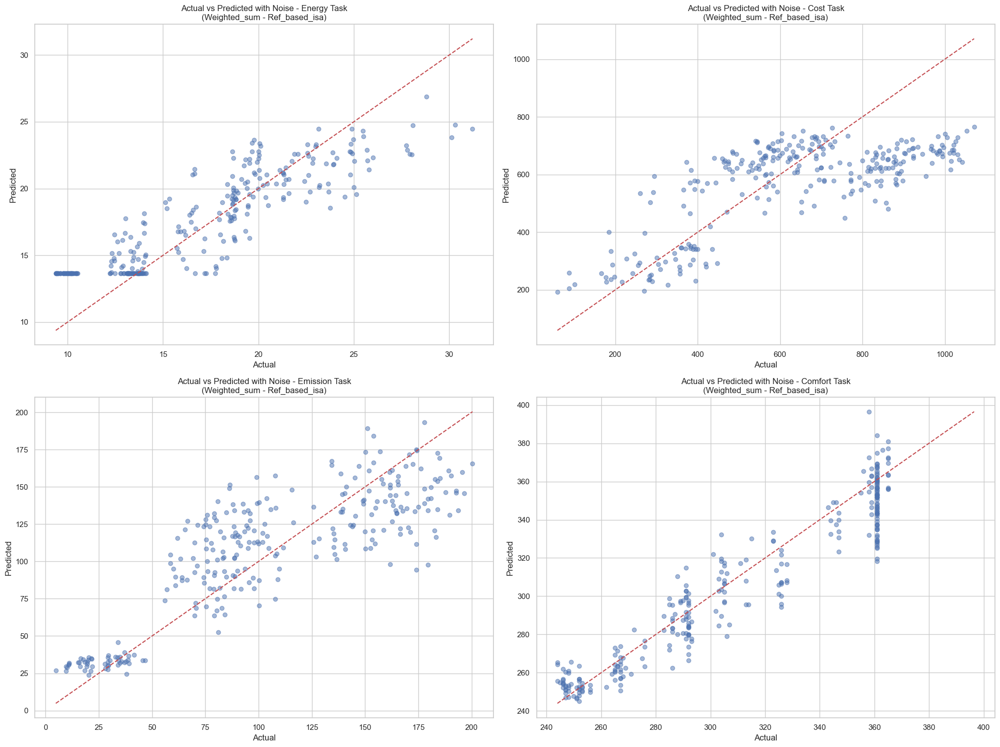


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - Ref_based_isa:
                 MAE        RMSE        R2
Task                                      
Energy      1.701795    2.239375  0.800349
Cost      142.259964  172.129669  0.483192
Emission   19.222797   24.104792  0.790379
Comfort     7.550960    9.004288  0.955937


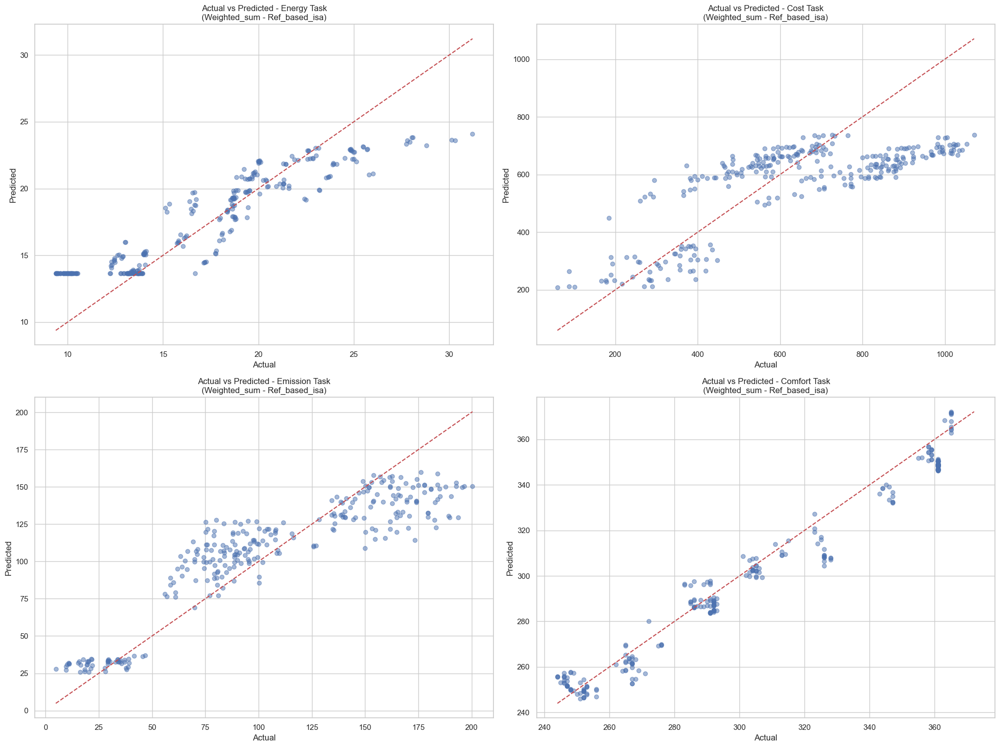


Evaluating Data_based_isa Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.373811      3.024695    1.739165  0.879580
Cost      138.504044  24133.138672  155.348450  0.579049
Emission   18.206245    524.136108   22.894018  0.810909
Comfort     6.270724     59.653000    7.723536  0.967580

Performing Error Analysis...

Energy Task: 102 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 23.54, Predicted: 20.18, Error: 14.26%
Actual: 9.50, Predicted: 10.70, Error: 12.62%
Actual: 16.66, Predicted: 18.40, Error: 10.48%
Actual: 16.55, Predicted: 18.38, Error: 11.11%
Actual: 10.29, Predicted: 11.74, Error: 14.17%

Cost Task: 251 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 253.09, Error: 28.15%
Actual: 474.00, Predicted: 560.19, Error: 18.18%
Actual: 881.0

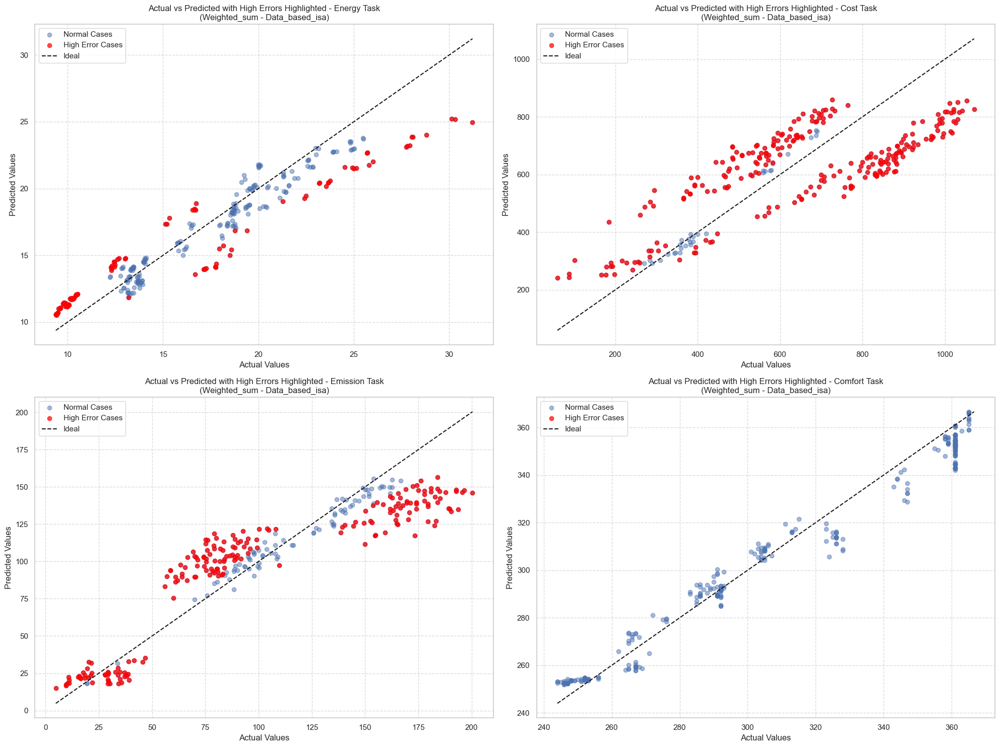


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.737680    2.171523  0.812264
Cost      137.680374  162.021469  0.542108
Emission   21.456335   28.227564  0.712542
Comfort    10.458020   13.986238  0.893688


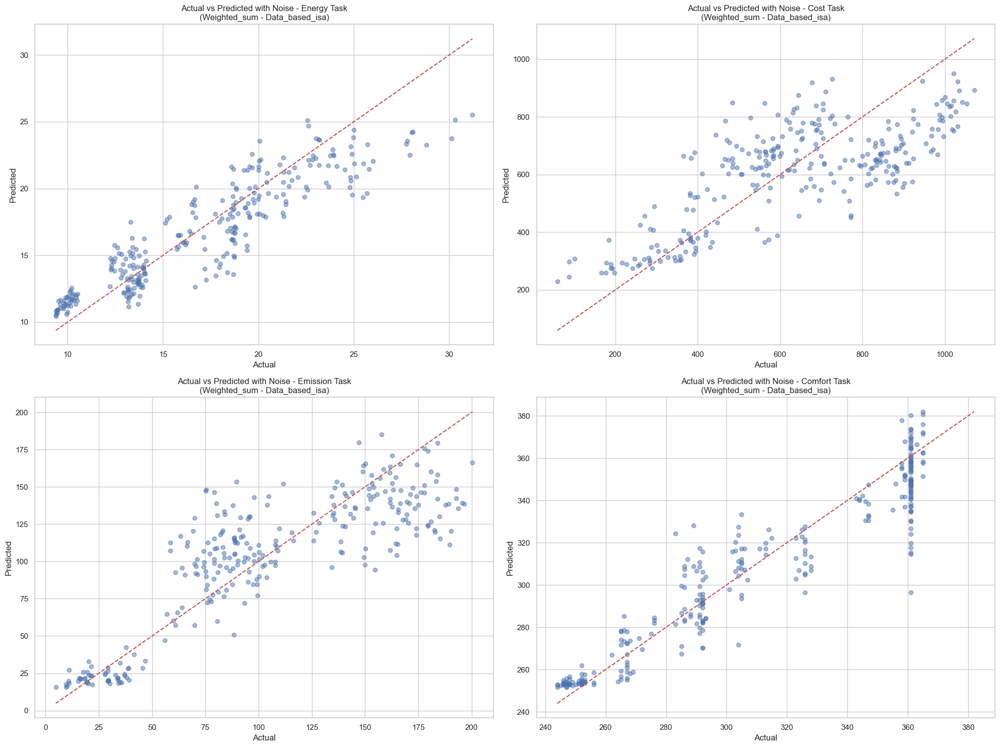


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - Data_based_isa:
                 MAE        RMSE        R2
Task                                      
Energy      1.373811    1.739165  0.879580
Cost      138.504044  155.348450  0.579049
Emission   18.206245   22.894018  0.810909
Comfort     6.270724    7.723536  0.967580


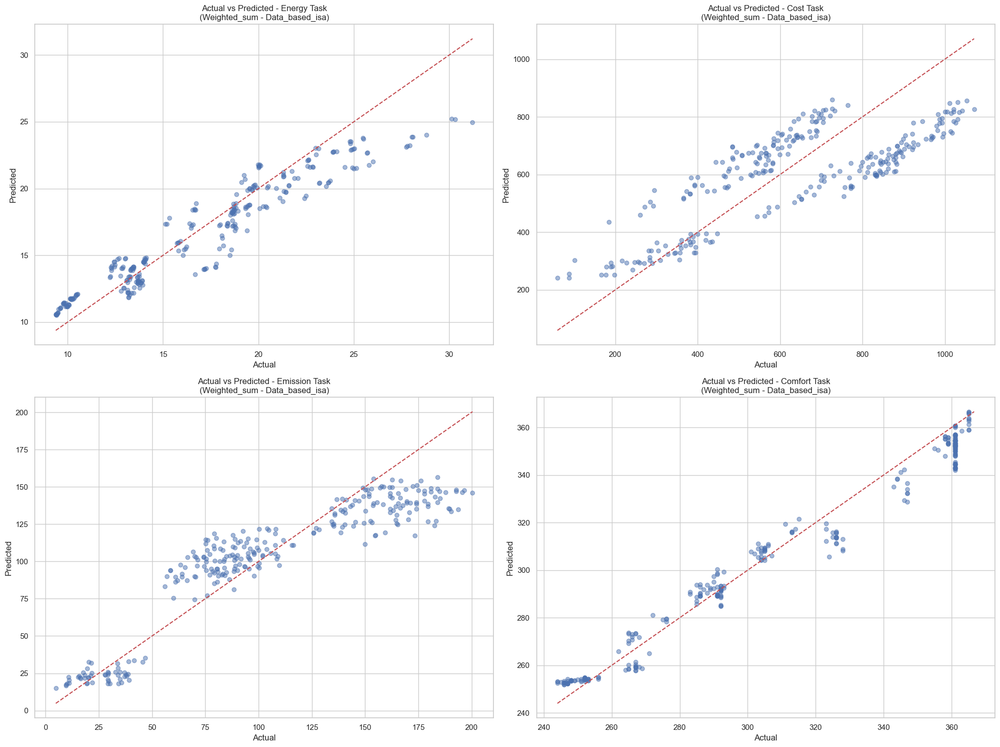


Evaluating More_shared_layer Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.963263      5.887844    2.426488  0.765591
Cost      153.600830  36512.921875  191.083542  0.363110
Emission   25.876877   1145.683350   33.847946  0.586675
Comfort     9.463843    128.281281   11.326133  0.930282

Performing Error Analysis...

Energy Task: 141 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 21.29, Predicted: 19.09, Error: 10.36%
Actual: 24.79, Predicted: 21.67, Error: 12.58%
Actual: 13.35, Predicted: 10.99, Error: 17.71%
Actual: 19.46, Predicted: 16.98, Error: 12.75%
Actual: 13.21, Predicted: 11.85, Error: 10.26%

Cost Task: 212 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 225.77, Error: 14.31%
Actual: 881.00, Predicted: 639.38, Error: 27.43%
Actual: 9

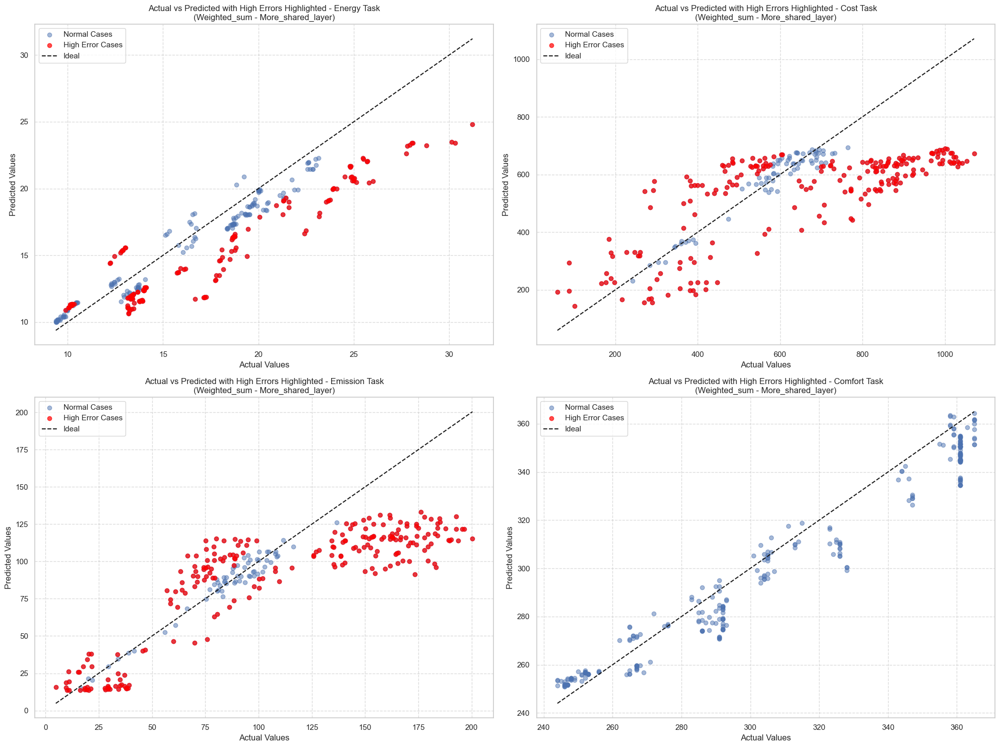


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      2.131901    2.734131  0.702384
Cost      161.207748  202.234314  0.286610
Emission   28.167921   36.822231  0.510844
Comfort    12.079041   15.316829  0.872498


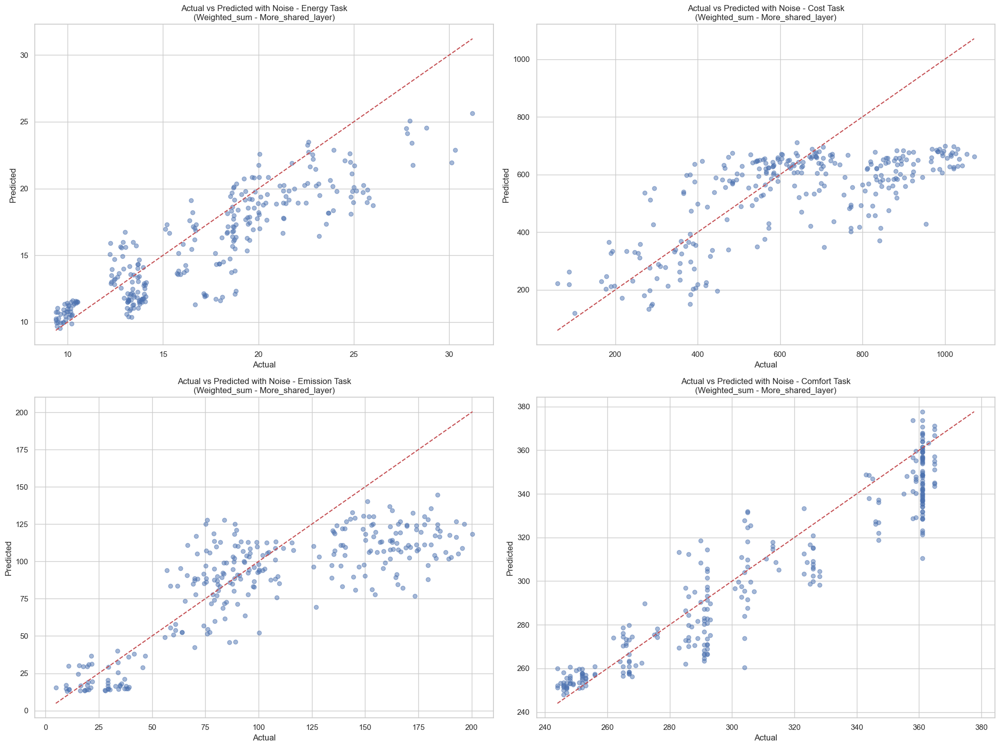


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - More_shared_layer:
                 MAE        RMSE        R2
Task                                      
Energy      1.963263    2.426488  0.765591
Cost      153.600830  191.083542  0.363110
Emission   25.876877   33.847946  0.586675
Comfort     9.463843   11.326133  0.930282


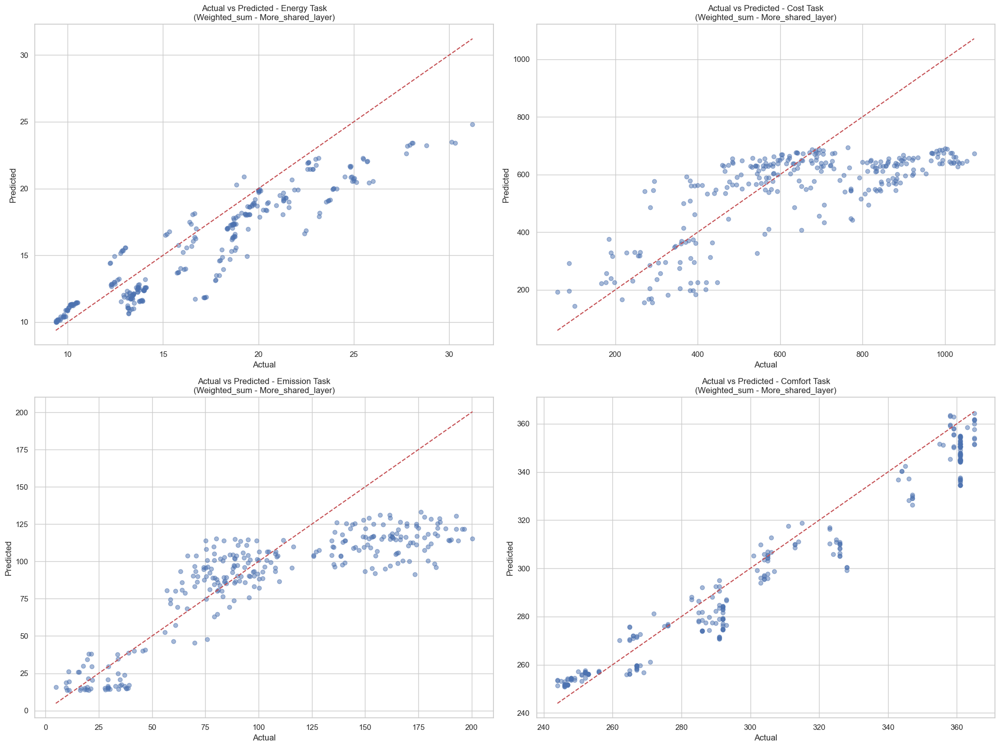


Evaluating Few_shared_layers Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.700699      3.804250    1.950449  0.848544
Cost      150.369186  38816.367188  197.018692  0.322932
Emission   18.362326    561.939880   23.705271  0.797271
Comfort     4.183413     26.960304    5.192331  0.985348

Performing Error Analysis...

Energy Task: 150 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 13.35, Predicted: 11.92, Error: 10.74%
Actual: 20.37, Predicted: 18.29, Error: 10.17%
Actual: 13.68, Predicted: 11.74, Error: 14.16%
Actual: 19.46, Predicted: 16.80, Error: 13.67%
Actual: 13.21, Predicted: 11.78, Error: 10.81%

Cost Task: 196 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 149.13, Error: 24.49%
Actual: 474.00, Predicted: 528.62, Error: 11.52%
Actual: 8

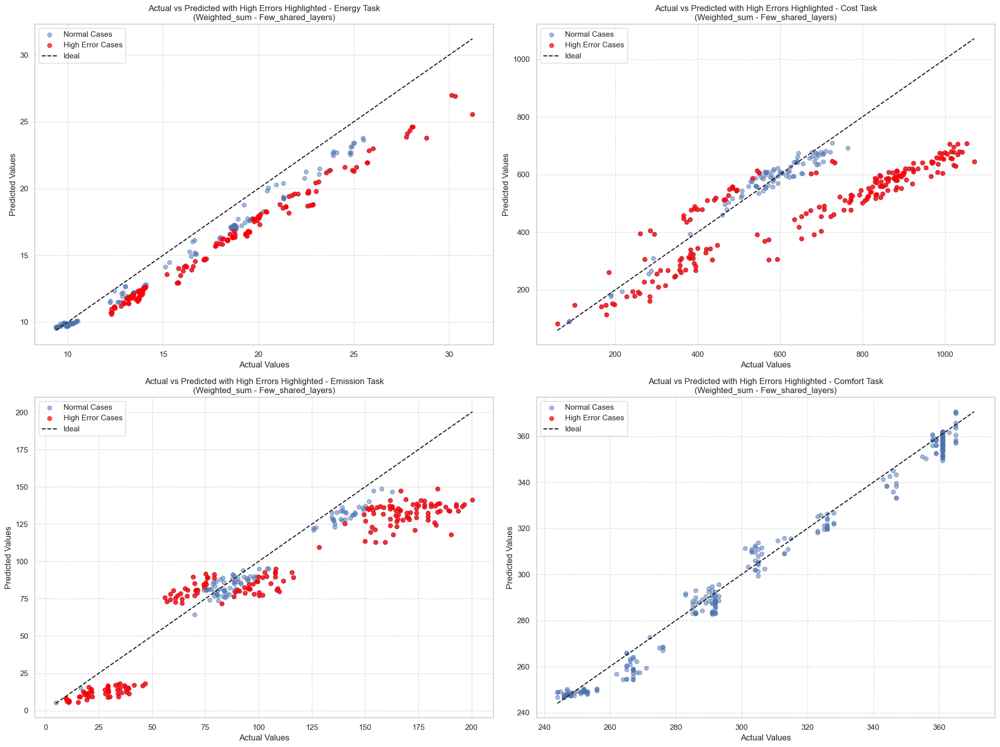


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.783566    2.301462  0.789125
Cost      154.214157  201.634094  0.290838
Emission   24.532089   32.126511  0.627648
Comfort    10.126817   13.120064  0.906449


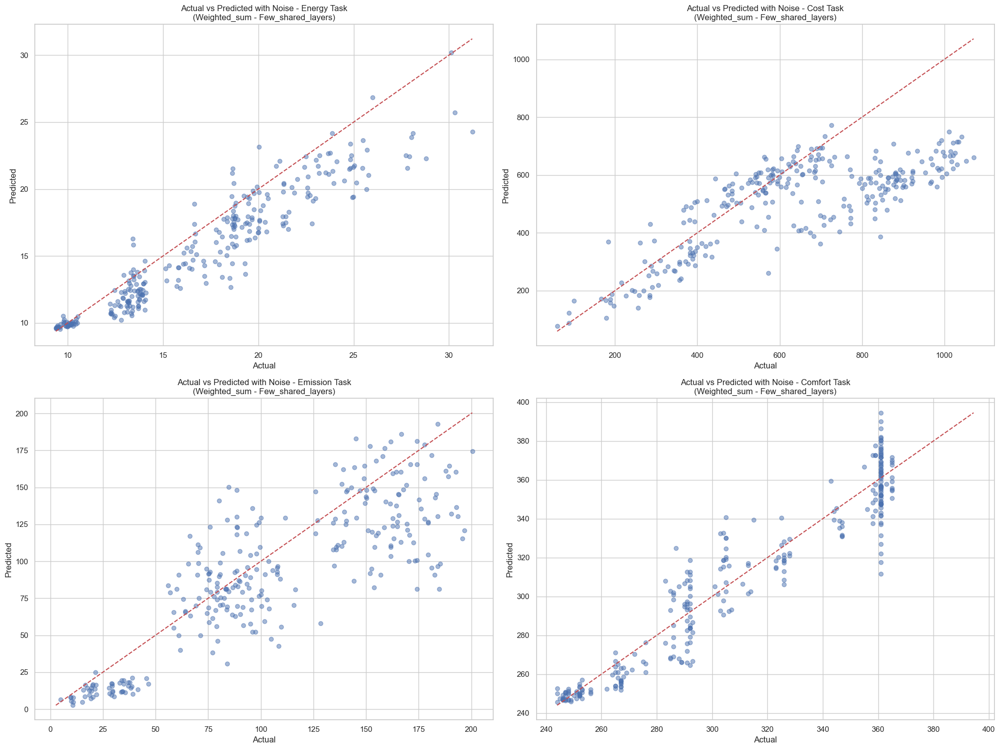


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - Few_shared_layers:
                 MAE        RMSE        R2
Task                                      
Energy      1.700699    1.950449  0.848544
Cost      150.369186  197.018692  0.322932
Emission   18.362326   23.705271  0.797271
Comfort     4.183413    5.192331  0.985348


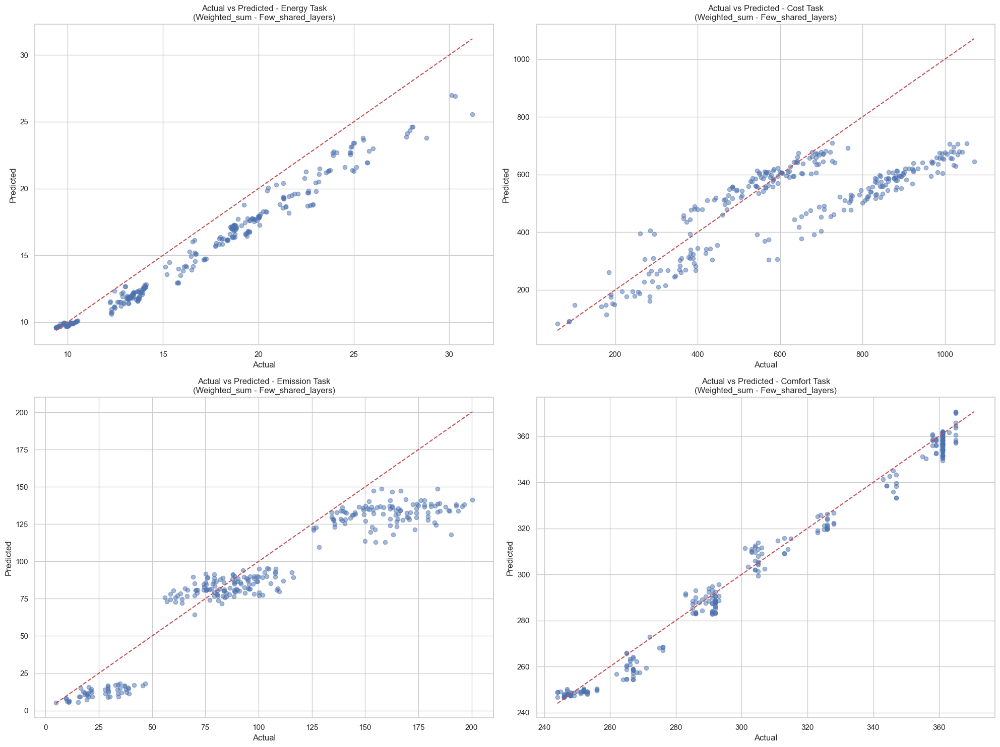


Evaluating Deep_balanced_layer Model with Weighted sum Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.879613      1.171700    1.082451  0.953352
Cost      136.734955  24882.261719  157.741119  0.565982
Emission   14.695926    376.449738   19.402313  0.864189
Comfort     5.158681     38.133625    6.175243  0.979275

Performing Error Analysis...

Energy Task: 32 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 9.50, Predicted: 10.62, Error: 11.75%
Actual: 16.55, Predicted: 18.84, Error: 13.88%
Actual: 16.17, Predicted: 14.49, Error: 10.41%
Actual: 9.62, Predicted: 10.81, Error: 12.31%
Actual: 17.73, Predicted: 15.73, Error: 11.26%

Cost Task: 240 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 551.42, Error: 16.33%
Actual: 881.00, Predicted: 639.31, Error: 27.43%
Actual: 92

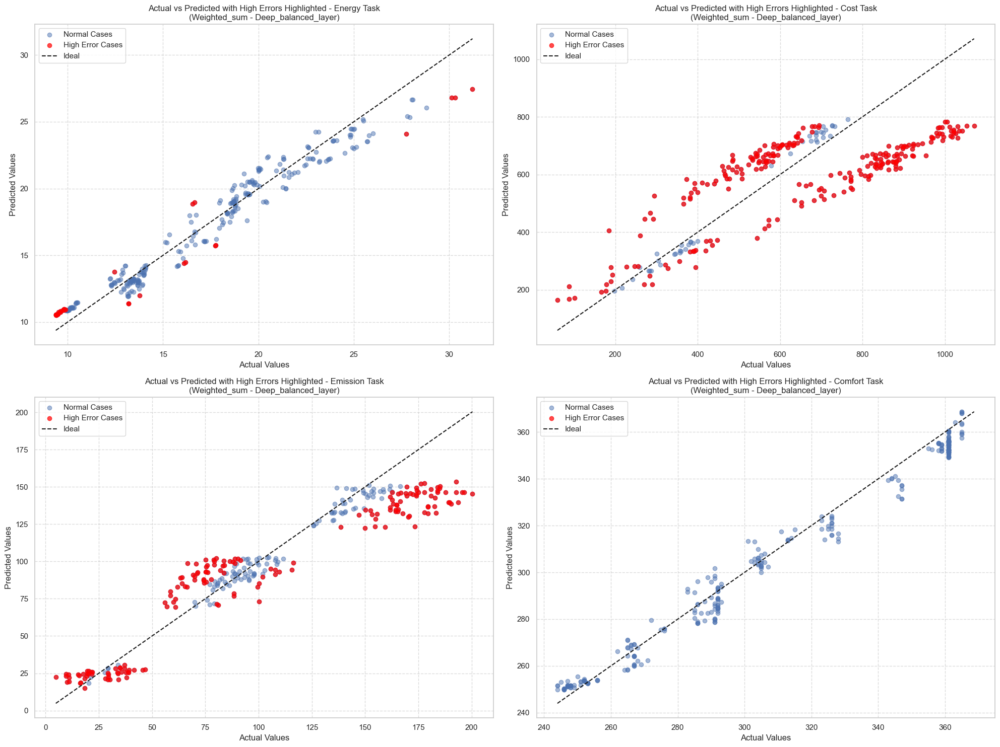


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.388984    1.739188  0.879577
Cost      138.224731  164.018326  0.530752
Emission   21.792463   28.498446  0.706999
Comfort    10.429978   13.827649  0.896086


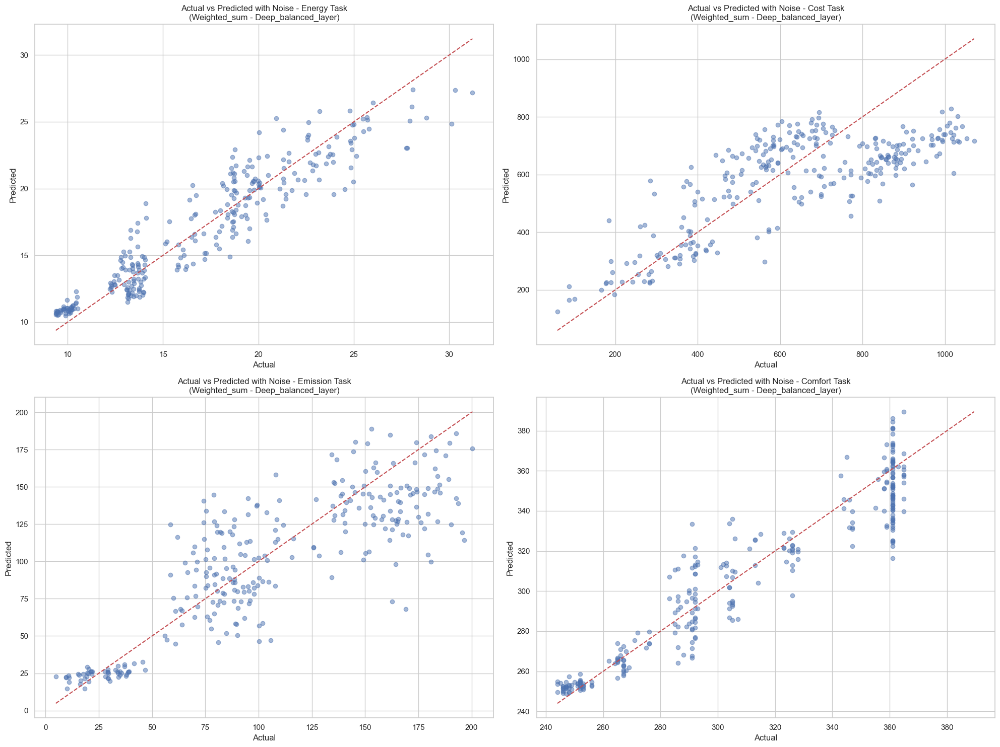


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Weighted_sum - Deep_balanced_layer:
                 MAE        RMSE        R2
Task                                      
Energy      0.879613    1.082451  0.953352
Cost      136.734955  157.741119  0.565982
Emission   14.695926   19.402313  0.864189
Comfort     5.158681    6.175243  0.979275


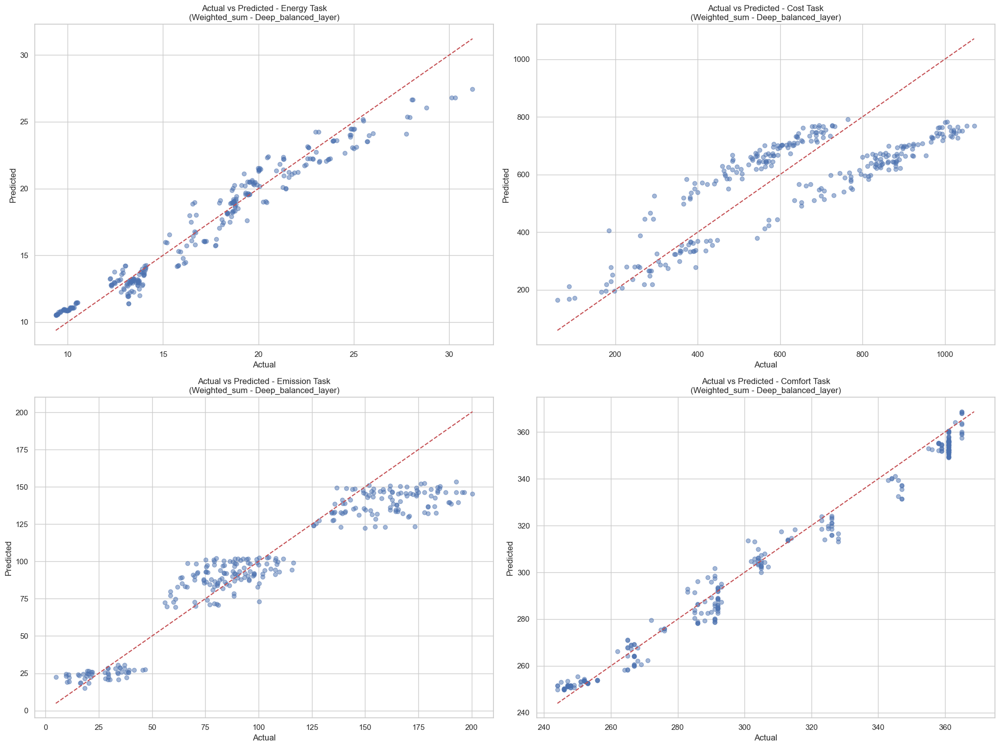


Evaluating Shared Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.915348      1.492767    1.221788  0.940569
Cost      137.946213  23910.826172  154.631256  0.582927
Emission   16.309822    437.501251   20.916531  0.842164
Comfort     6.289588     59.566040    7.717904  0.967627

Performing Error Analysis...

Energy Task: 33 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 19.46, Predicted: 17.22, Error: 11.53%
Actual: 21.60, Predicted: 19.36, Error: 10.37%
Actual: 17.79, Predicted: 15.99, Error: 10.10%
Actual: 16.17, Predicted: 14.32, Error: 11.42%
Actual: 15.72, Predicted: 13.56, Error: 13.80%

Cost Task: 252 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 535.58, Error: 12.99%
Actual: 881.00, Predicted: 672.40, Error: 23.68%
Actual: 923.00, Predicted: 81

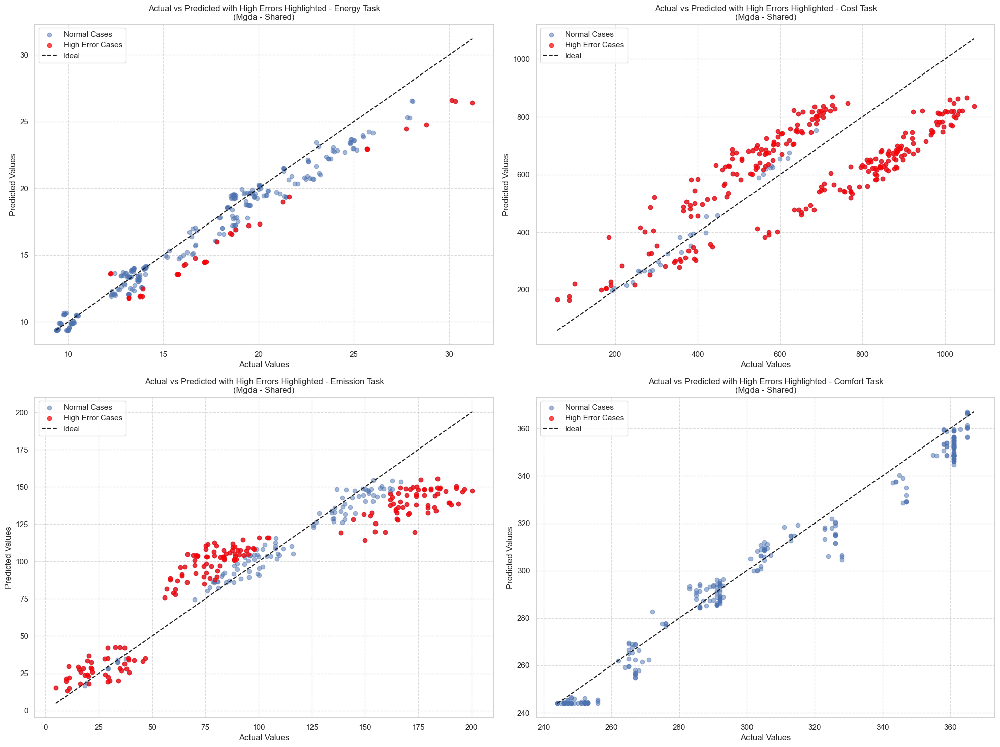


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.173047    1.581172  0.900465
Cost      144.949753  172.641830  0.480112
Emission   20.791500   26.865681  0.739611
Comfort     9.621315   12.670248  0.912753


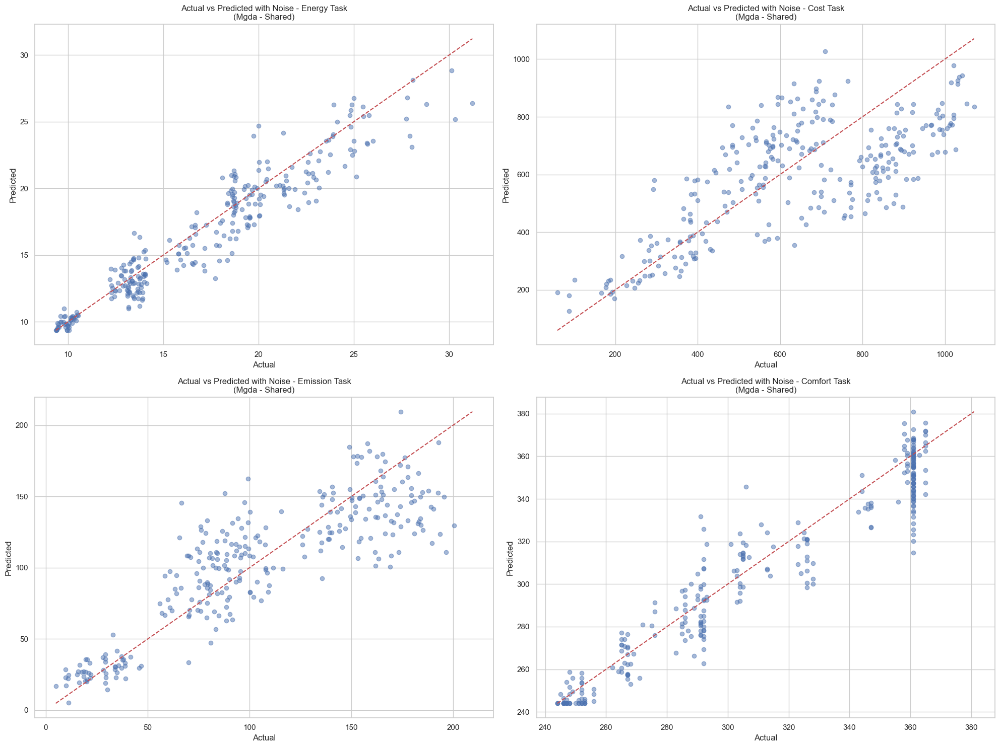


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - Shared:
                 MAE        RMSE        R2
Task                                      
Energy      0.915348    1.221788  0.940569
Cost      137.946213  154.631256  0.582927
Emission   16.309822   20.916531  0.842164
Comfort     6.289588    7.717904  0.967627


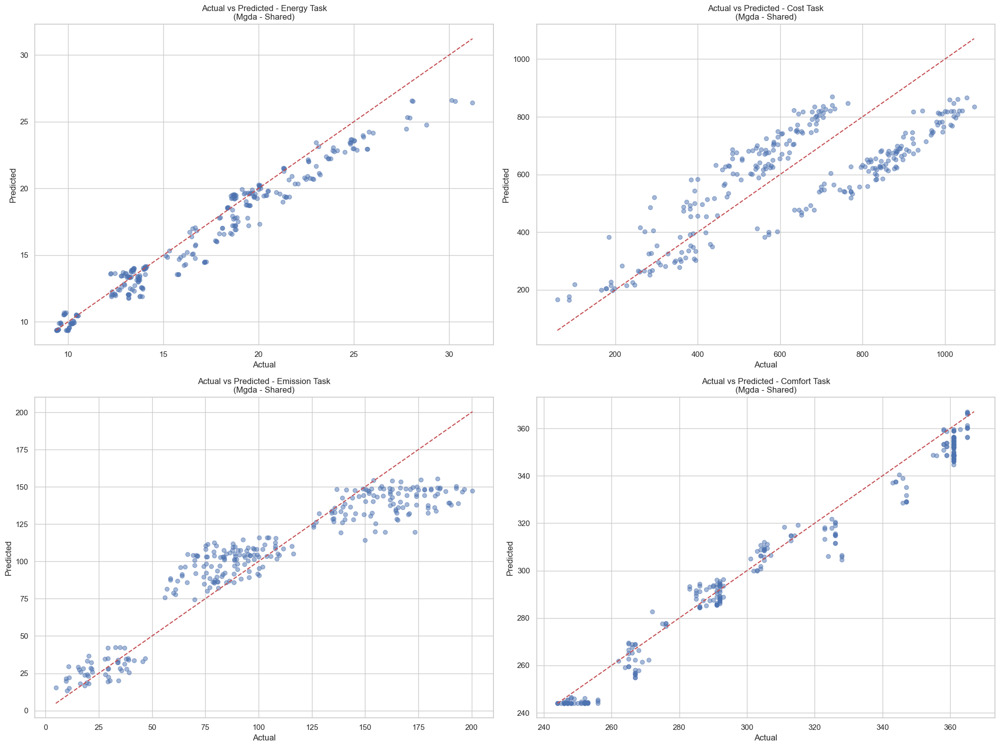


Evaluating Separate Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.124721      0.035002    0.187090  0.998606
Cost      133.567963  21466.660156  146.515045  0.625560
Emission   10.715211    172.048981   13.116744  0.937930
Comfort     1.388280      3.188749    1.785707  0.998267

Performing Error Analysis...

Energy Task: 0 cases with > 10.0% error.
Sample high-error cases for Energy Task:

Cost Task: 241 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 598.54, Error: 26.27%
Actual: 881.00, Predicted: 707.13, Error: 19.74%
Actual: 923.00, Predicted: 792.12, Error: 14.18%
Actual: 901.00, Predicted: 751.43, Error: 16.60%
Actual: 295.00, Predicted: 554.18, Error: 87.86%

Emission Task: 147 cases with > 10.0% error.
Sample high-error cases for Emission Task:
Actual: 30.29, Predicted: 1

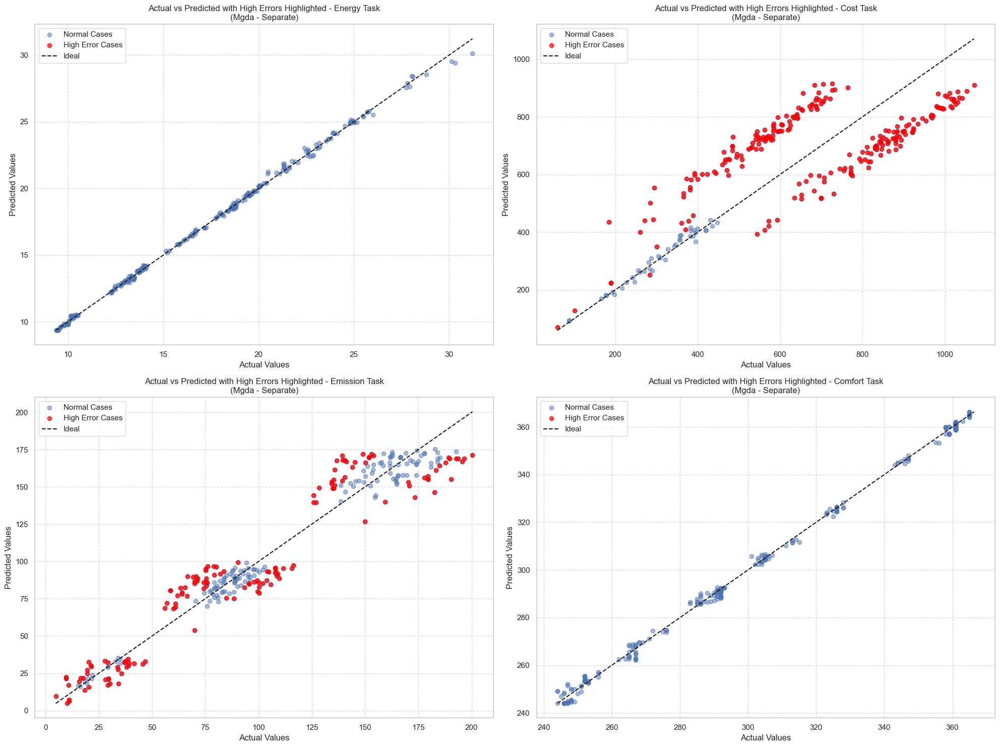


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.223906    1.689450  0.886366
Cost      139.168854  158.597977  0.561254
Emission   23.957642   31.714525  0.637136
Comfort     9.716876   13.392551  0.902522


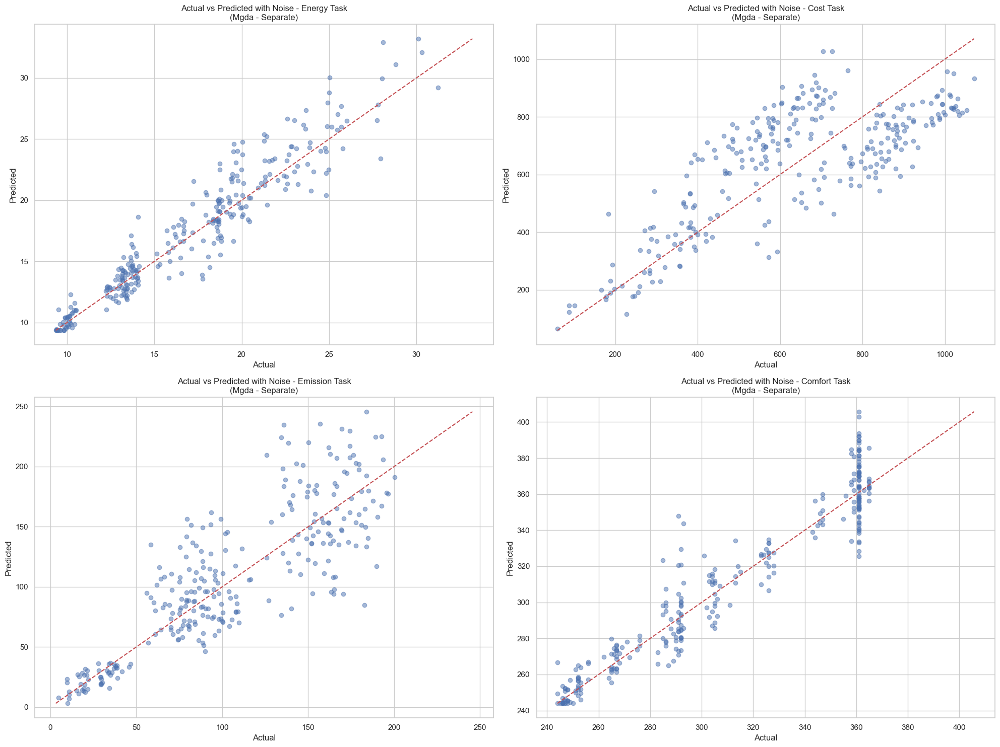


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - Separate:
                 MAE        RMSE        R2
Task                                      
Energy      0.124721    0.187090  0.998606
Cost      133.567963  146.515045  0.625560
Emission   10.715211   13.116744  0.937930
Comfort     1.388280    1.785707  0.998267


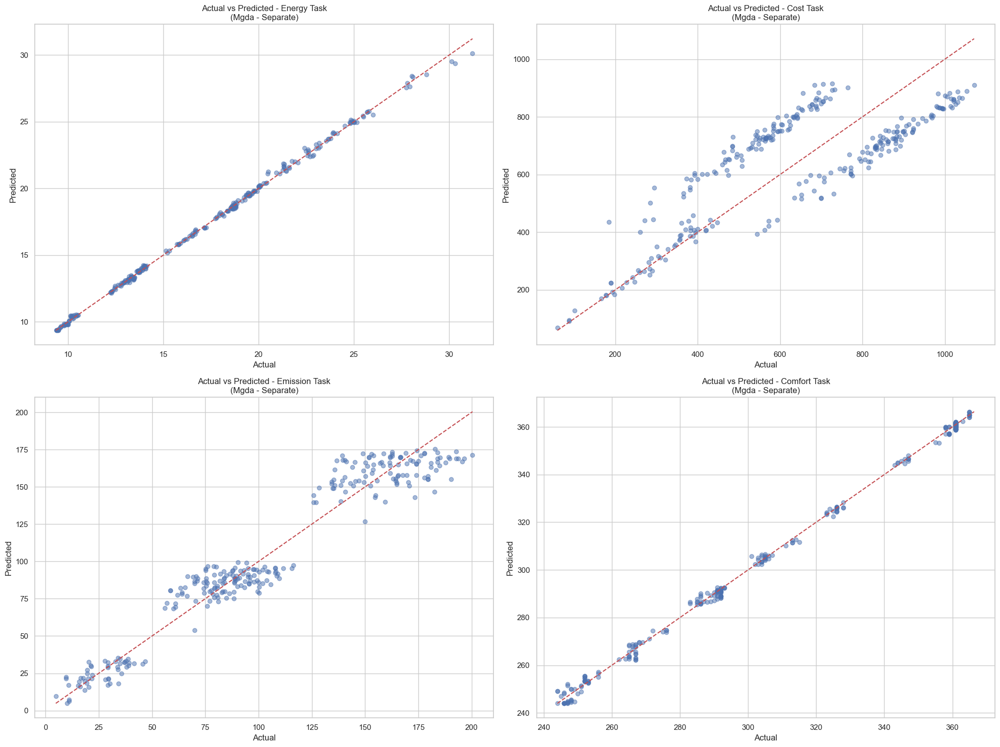


Evaluating Ref_based_isa Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.519989      3.997036    1.999259  0.840869
Cost      139.754593  26539.751953  162.910263  0.537071
Emission   21.604370    677.205322   26.023169  0.755687
Comfort     7.375749     76.525467    8.747884  0.958410

Performing Error Analysis...

Energy Task: 117 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 19.46, Predicted: 16.95, Error: 12.91%
Actual: 19.66, Predicted: 21.75, Error: 10.63%
Actual: 9.50, Predicted: 11.11, Error: 16.93%
Actual: 16.66, Predicted: 18.38, Error: 10.35%
Actual: 16.55, Predicted: 18.91, Error: 14.29%

Cost Task: 237 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 588.14, Error: 24.08%
Actual: 881.00, Predicted: 662.09, Error: 24.85%
Actual: 923.00, Predic

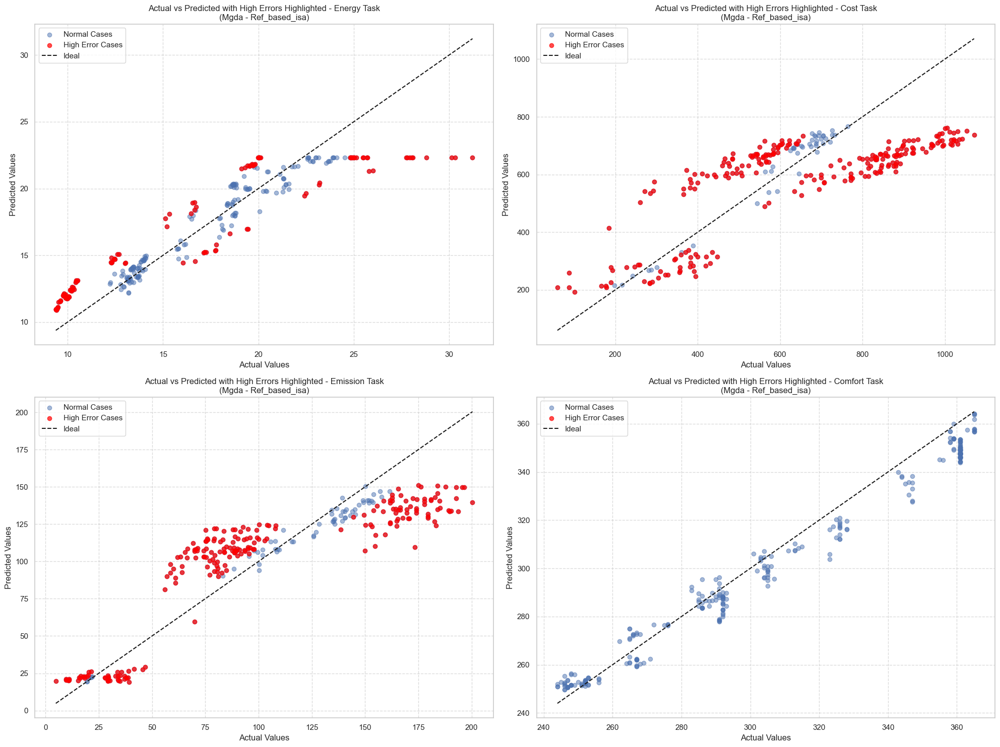


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.763474    2.265943  0.795583
Cost      141.788742  168.810898  0.502929
Emission   23.702343   29.921389  0.677009
Comfort    10.460472   14.021142  0.893157


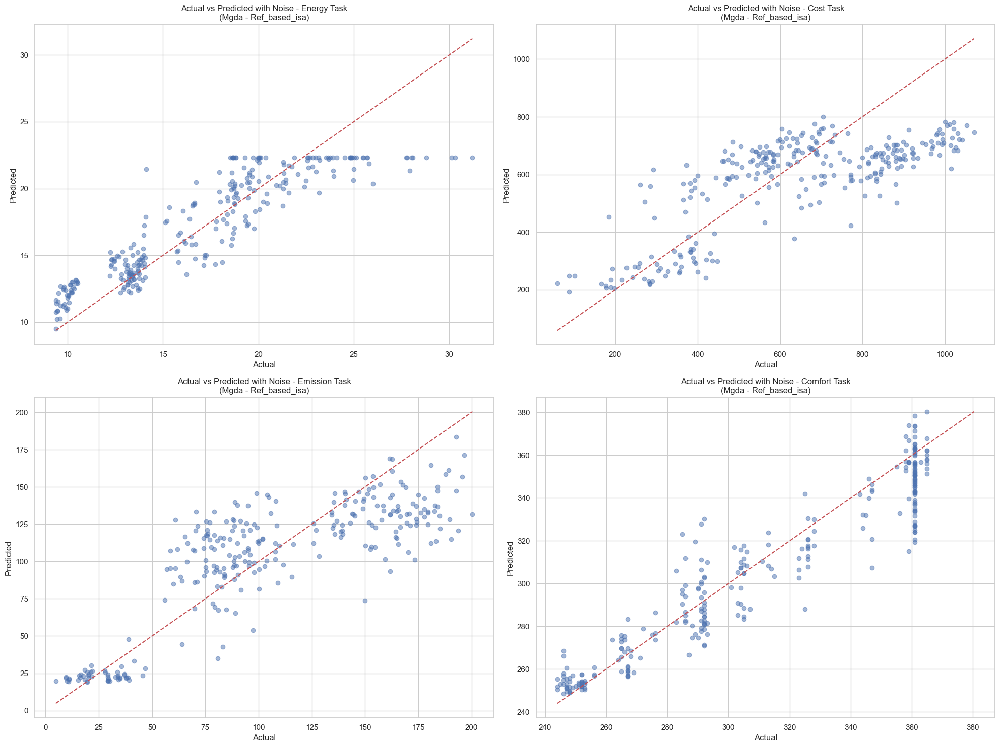


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - Ref_based_isa:
                 MAE        RMSE        R2
Task                                      
Energy      1.519989    1.999259  0.840869
Cost      139.754593  162.910263  0.537071
Emission   21.604370   26.023169  0.755687
Comfort     7.375749    8.747884  0.958410


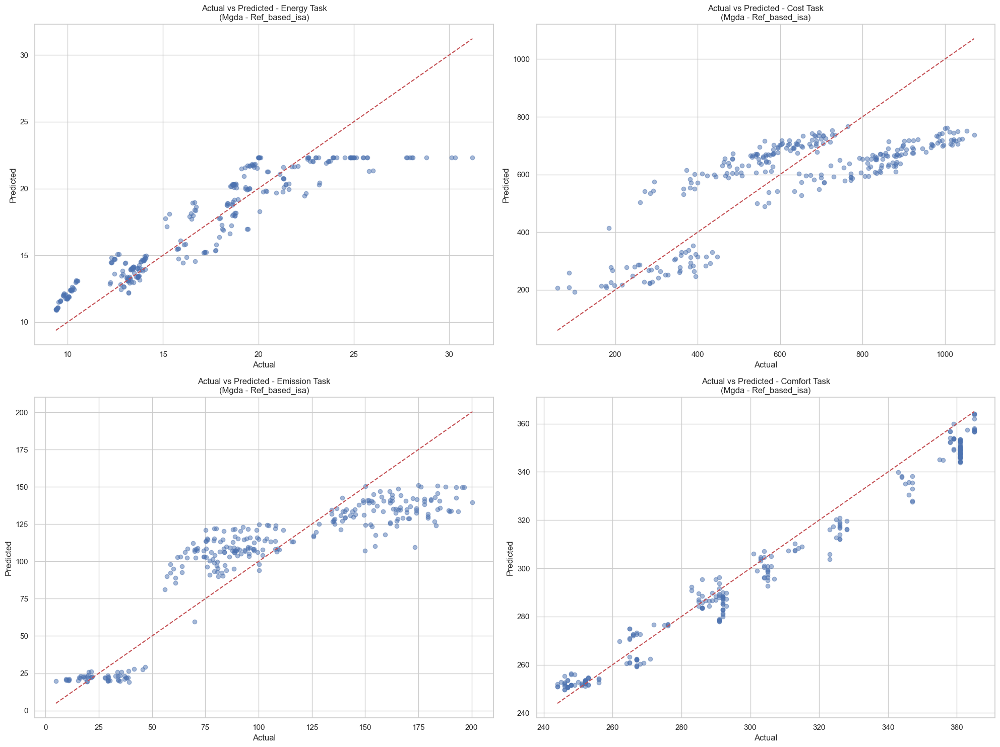


Evaluating Data_based_isa Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.142639      2.065797    1.437288  0.917756
Cost      138.349182  23130.791016  152.088104  0.596533
Emission   20.186502    619.858276   24.896954  0.776375
Comfort     6.656771     61.041058    7.812878  0.966826

Performing Error Analysis...

Energy Task: 75 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 9.50, Predicted: 11.34, Error: 19.41%
Actual: 10.29, Predicted: 11.88, Error: 15.45%
Actual: 17.79, Predicted: 15.74, Error: 11.53%
Actual: 9.62, Predicted: 11.55, Error: 20.07%
Actual: 12.88, Predicted: 14.22, Error: 10.42%

Cost Task: 256 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 251.75, Error: 27.47%
Actual: 474.00, Predicted: 585.49, Error: 23.52%
Actual: 881.00, Predict

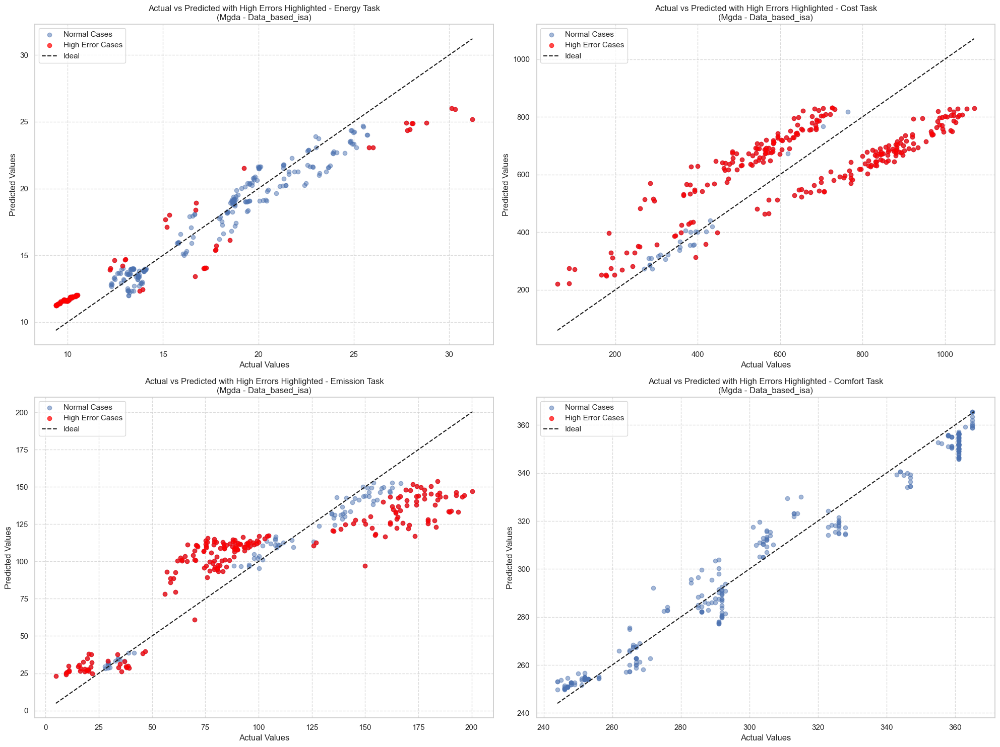


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.565511    1.942558  0.849767
Cost      137.195541  159.503281  0.556231
Emission   22.680056   28.771605  0.701355
Comfort    10.151843   13.245824  0.904647


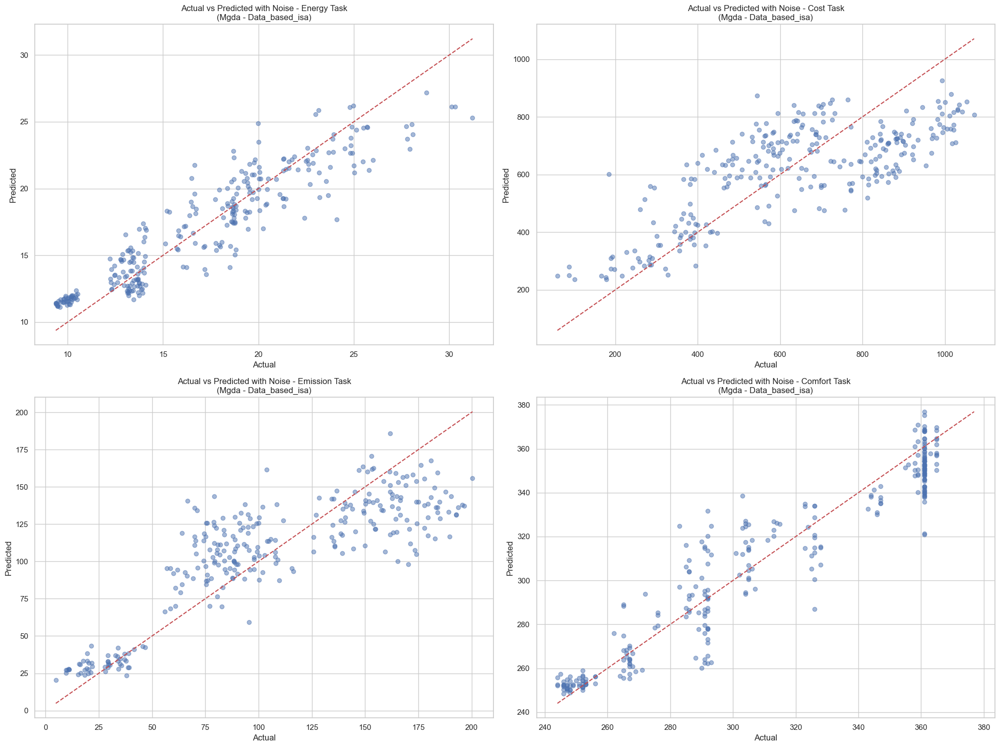


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - Data_based_isa:
                 MAE        RMSE        R2
Task                                      
Energy      1.142639    1.437288  0.917756
Cost      138.349182  152.088104  0.596533
Emission   20.186502   24.896954  0.776375
Comfort     6.656771    7.812878  0.966826


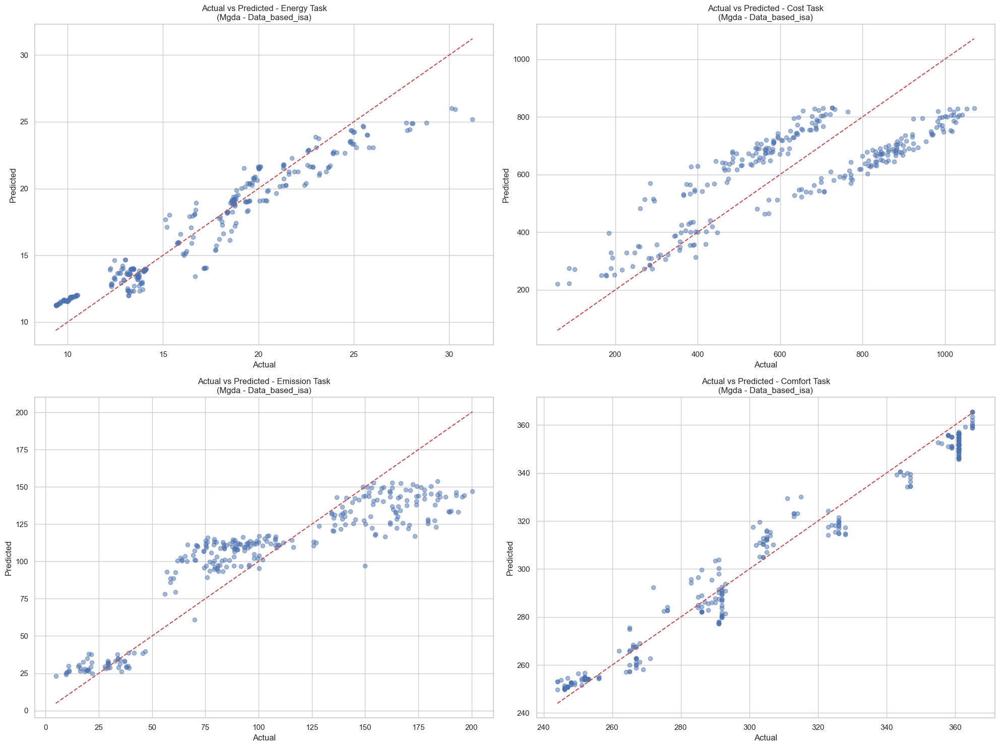


Evaluating More_shared_layer Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.688830      5.121573    2.263089  0.796098
Cost      149.076218  33378.574219  182.698044  0.417782
Emission   25.474321   1019.911987   31.936062  0.632049
Comfort     9.138132    150.724792   12.277002  0.918085

Performing Error Analysis...

Energy Task: 96 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 24.79, Predicted: 21.87, Error: 11.75%
Actual: 13.35, Predicted: 10.75, Error: 19.48%
Actual: 23.54, Predicted: 19.87, Error: 15.57%
Actual: 21.60, Predicted: 18.84, Error: 12.77%
Actual: 17.79, Predicted: 14.47, Error: 18.67%

Cost Task: 216 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 235.60, Error: 19.29%
Actual: 881.00, Predicted: 644.70, Error: 26.82%
Actual: 923.00, Pr

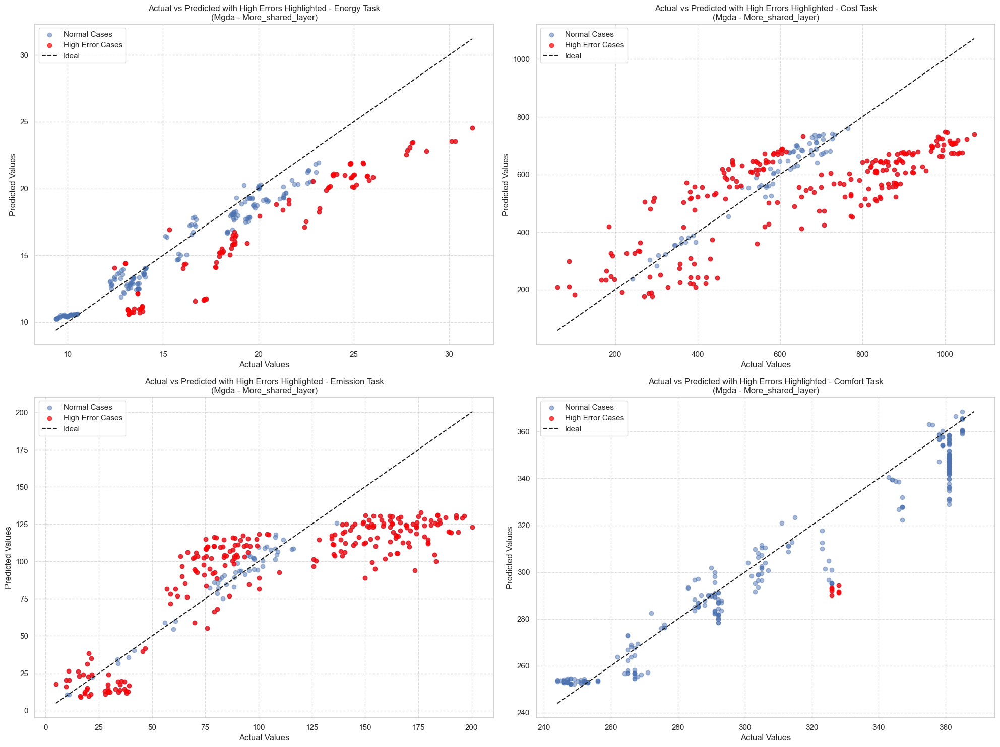


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.915365    2.488071  0.753542
Cost      154.531067  190.124557  0.369487
Emission   27.325544   33.916470  0.585000
Comfort    11.708365   16.111574  0.858923


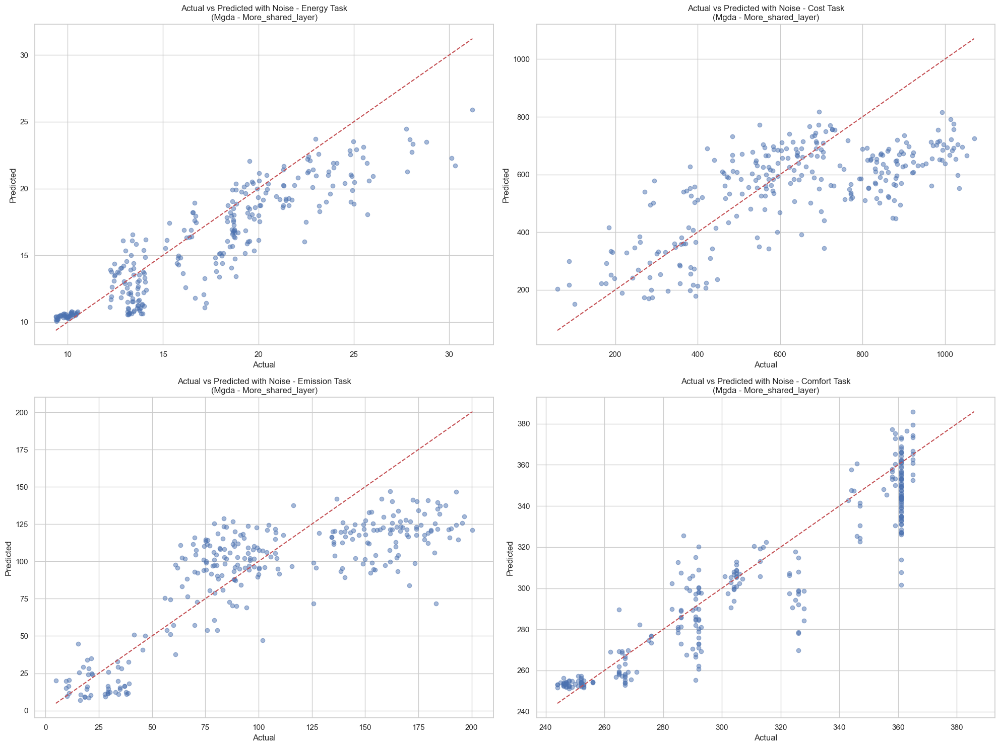


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - More_shared_layer:
                 MAE        RMSE        R2
Task                                      
Energy      1.688830    2.263089  0.796098
Cost      149.076218  182.698044  0.417782
Emission   25.474321   31.936062  0.632049
Comfort     9.138132   12.277002  0.918085


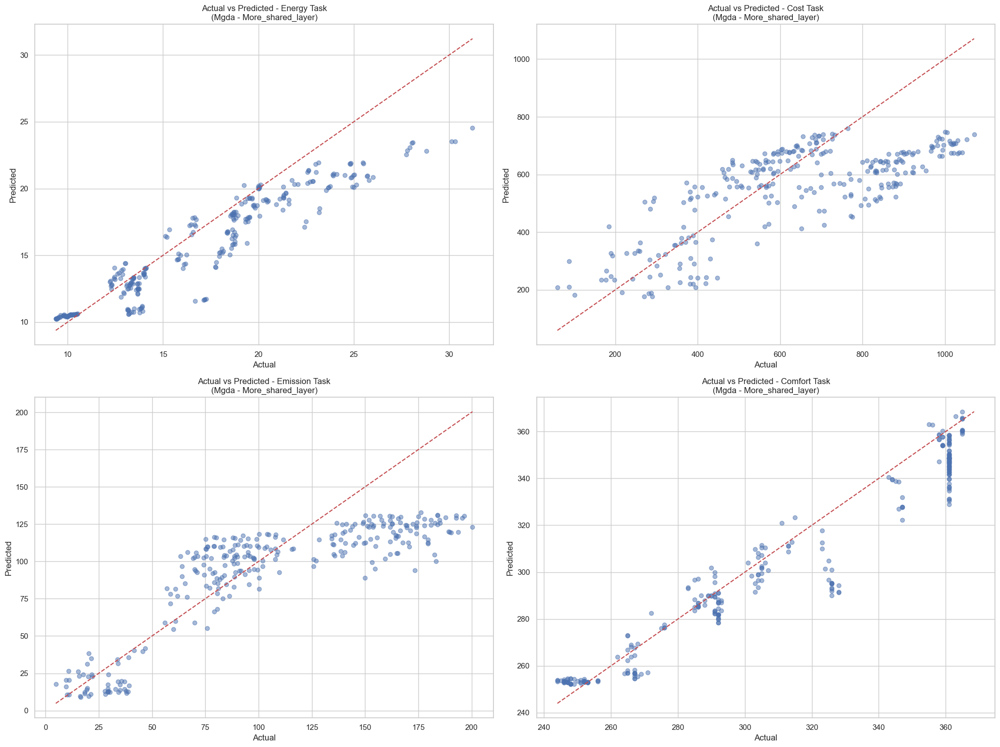


Evaluating Few_shared_layers Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.669397      0.749375    0.865664  0.970166
Cost      170.288605  48565.828125  220.376556  0.152873
Emission   20.301363    704.127747   26.535406  0.745974
Comfort     6.340255     58.177650    7.627428  0.968382

Performing Error Analysis...

Energy Task: 38 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 9.50, Predicted: 11.01, Error: 15.87%
Actual: 10.29, Predicted: 11.39, Error: 10.70%
Actual: 9.62, Predicted: 11.13, Error: 15.62%
Actual: 10.06, Predicted: 11.14, Error: 10.67%
Actual: 10.05, Predicted: 11.14, Error: 10.84%

Cost Task: 204 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 129.06, Error: 34.65%
Actual: 881.00, Predicted: 500.63, Error: 43.17%
Actual: 923.00, Pred

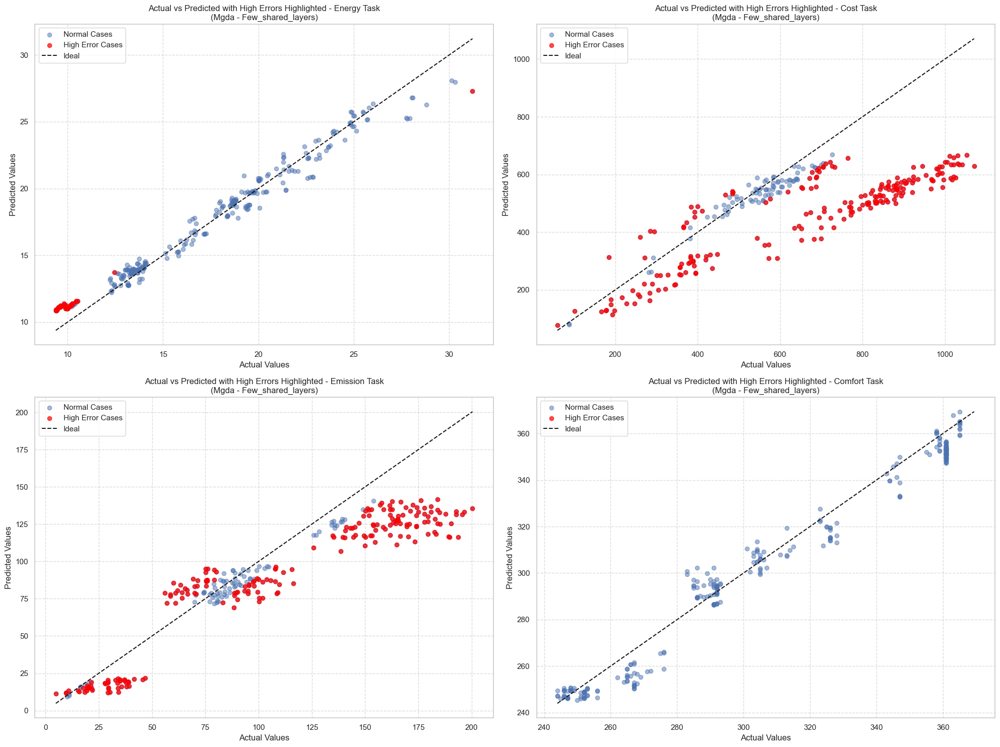


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.270709    1.642255  0.892626
Cost      174.400543  225.097046  0.116194
Emission   24.478704   32.063335  0.629111
Comfort    10.155114   13.292703  0.903970


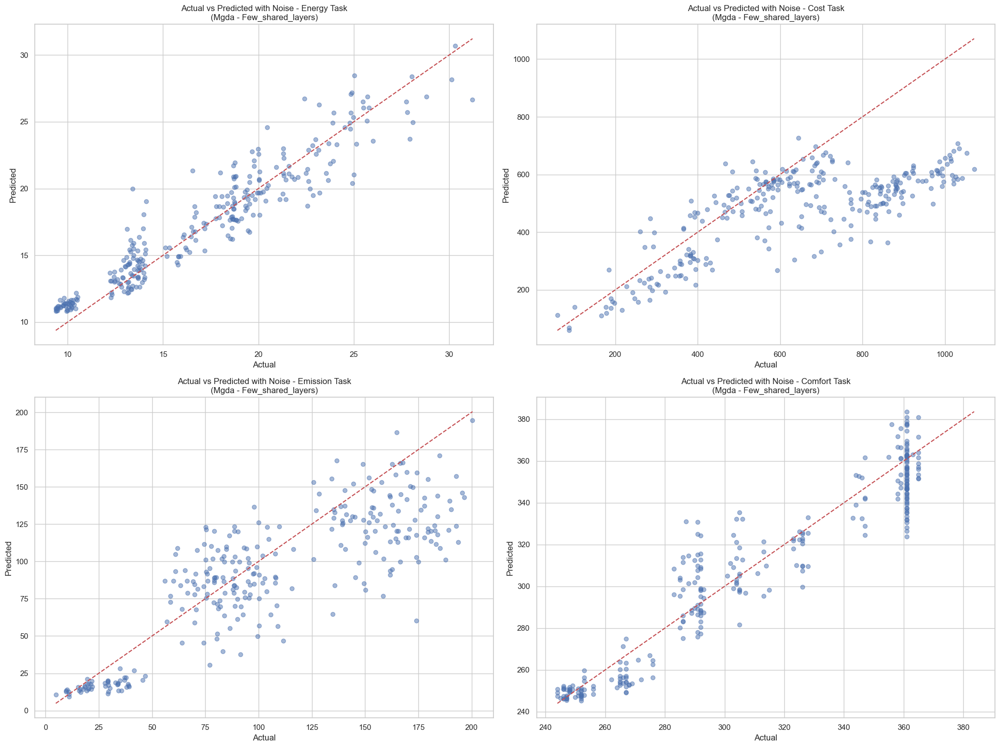


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - Few_shared_layers:
                 MAE        RMSE        R2
Task                                      
Energy      0.669397    0.865664  0.970166
Cost      170.288605  220.376556  0.152873
Emission   20.301363   26.535406  0.745974
Comfort     6.340255    7.627428  0.968382


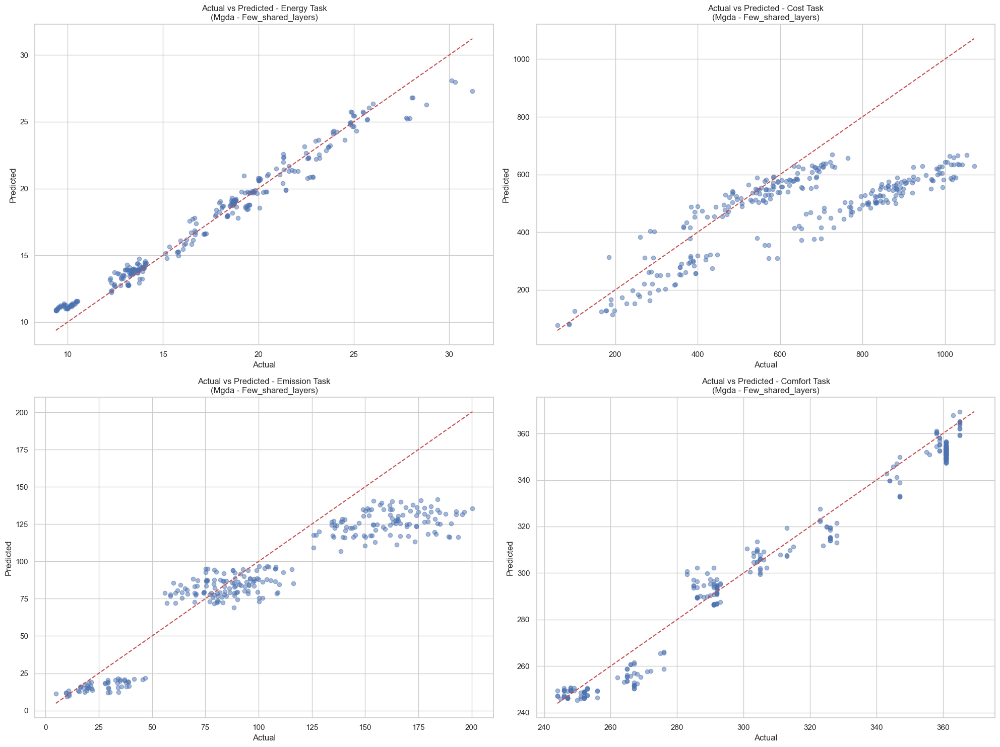


Evaluating Deep_balanced_layer Model with Mgda Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.891004      1.214203    1.101909  0.951660
Cost      136.940857  23785.962891  154.226990  0.585105
Emission   15.619781    408.339722   20.207418  0.852684
Comfort     4.920885     33.803795    5.814103  0.981629

Performing Error Analysis...

Energy Task: 46 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 9.50, Predicted: 10.77, Error: 13.40%
Actual: 9.62, Predicted: 11.12, Error: 15.55%
Actual: 17.13, Predicted: 15.16, Error: 11.52%
Actual: 9.60, Predicted: 11.00, Error: 14.64%
Actual: 9.89, Predicted: 11.32, Error: 14.46%

Cost Task: 246 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 235.84, Error: 19.41%
Actual: 474.00, Predicted: 555.16, Error: 17.12%
Actual: 881.00, Pred

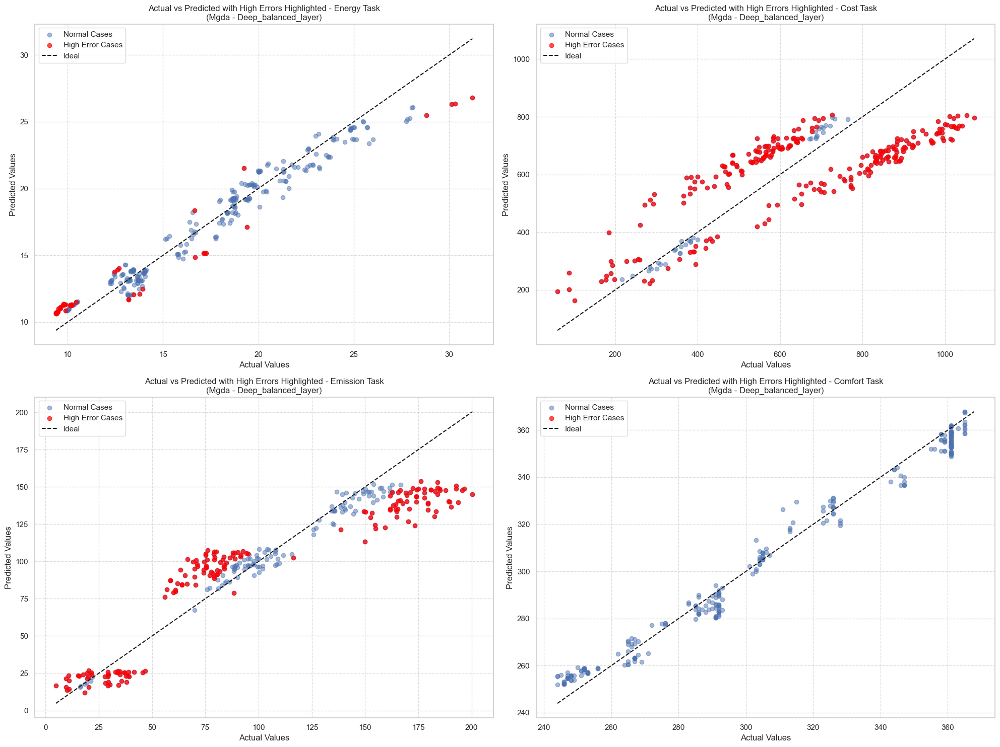


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.469127    1.893832  0.857209
Cost      140.919693  162.516891  0.539304
Emission   21.569698   29.237911  0.691596
Comfort     9.874850   13.781688  0.896775


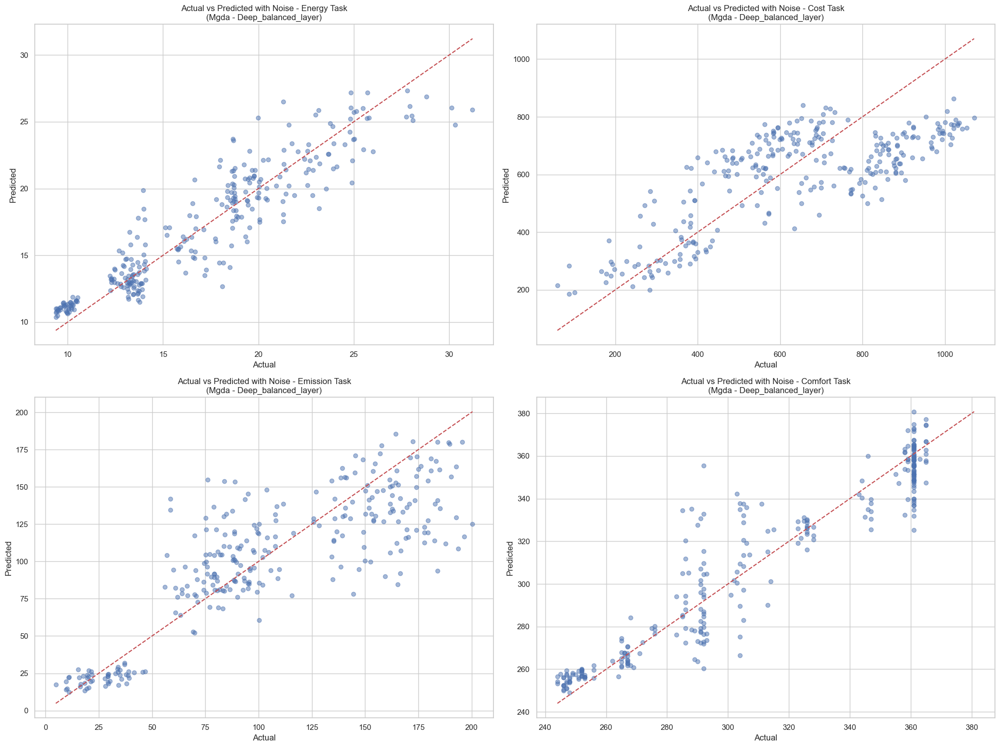


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Mgda - Deep_balanced_layer:
                 MAE        RMSE        R2
Task                                      
Energy      0.891004    1.101909  0.951660
Cost      136.940857  154.226990  0.585105
Emission   15.619781   20.207418  0.852684
Comfort     4.920885    5.814103  0.981629


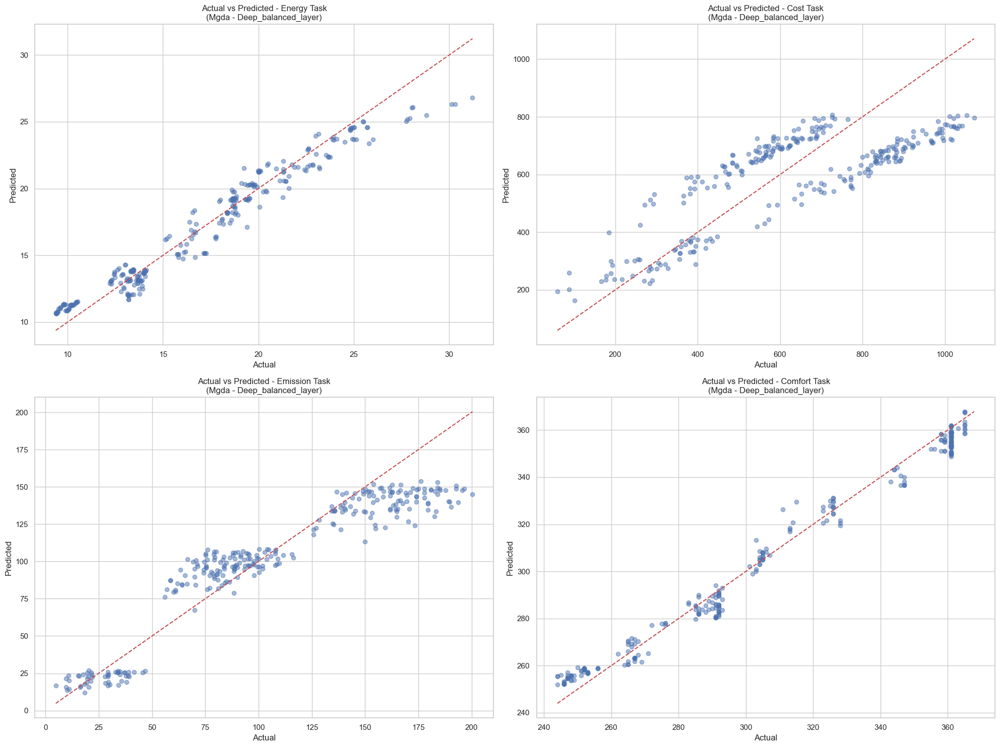


Evaluating Shared Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.980521      1.522024    1.233703  0.939405
Cost      138.811523  27308.662109  165.253326  0.523659
Emission   14.422290    375.050201   19.366213  0.864694
Comfort     6.716558     58.064144    7.619983  0.968444

Performing Error Analysis...

Energy Task: 34 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 19.46, Predicted: 17.37, Error: 10.76%
Actual: 21.60, Predicted: 18.93, Error: 12.36%
Actual: 17.79, Predicted: 15.93, Error: 10.45%
Actual: 16.17, Predicted: 14.42, Error: 10.79%
Actual: 15.72, Predicted: 13.55, Error: 13.85%

Cost Task: 234 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 146.86, Error: 25.64%
Actual: 474.00, Predicted: 526.33, Error: 11.04%
Actual: 881.00, Predic

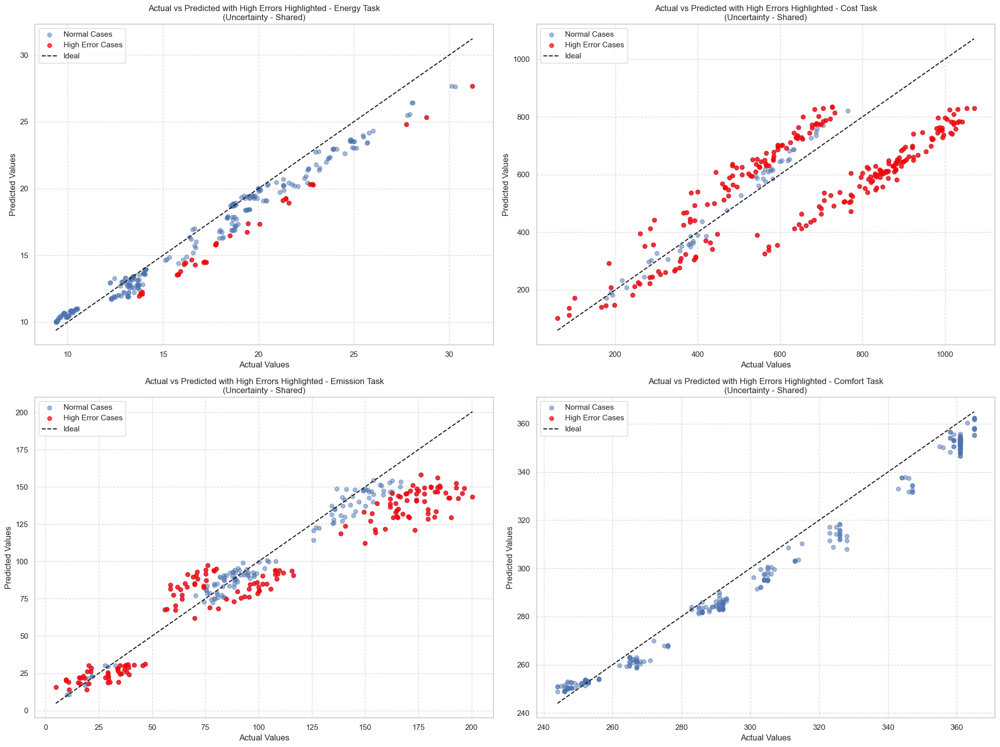


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.363968    1.755245  0.877343
Cost      143.955688  176.939133  0.453909
Emission   24.575262   32.754341  0.612952
Comfort    11.783082   14.710628  0.882391


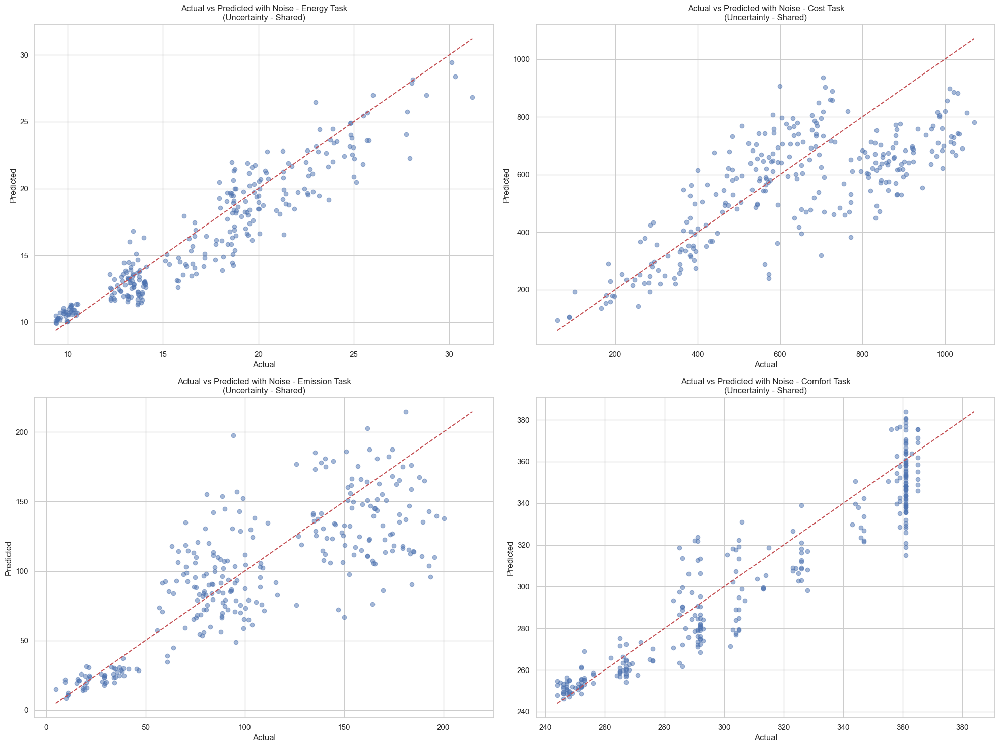


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - Shared:
                 MAE        RMSE        R2
Task                                      
Energy      0.980521    1.233703  0.939405
Cost      138.811523  165.253326  0.523659
Emission   14.422290   19.366213  0.864694
Comfort     6.716558    7.619983  0.968444


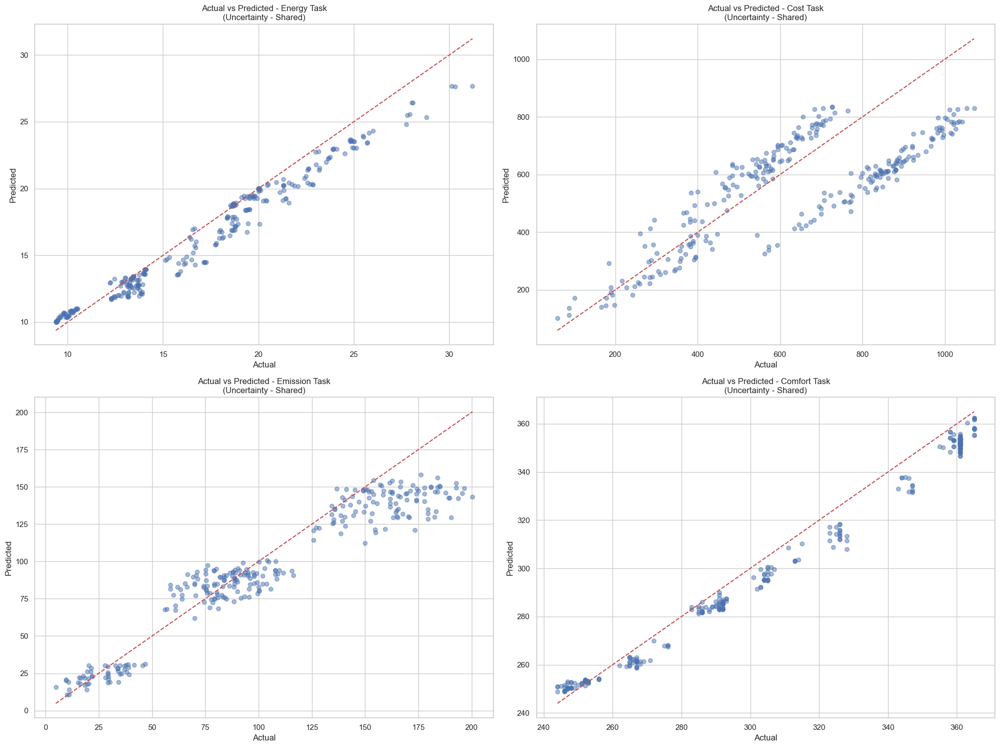


Evaluating Separate Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.068811      0.007976    0.089306  0.999682
Cost      137.204849  22853.837891  151.174866  0.601364
Emission   10.826985    175.937134   13.264130  0.936528
Comfort     0.650722      0.782859    0.884793  0.999575

Performing Error Analysis...

Energy Task: 0 cases with > 10.0% error.
Sample high-error cases for Energy Task:

Cost Task: 247 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 578.06, Error: 21.95%
Actual: 881.00, Predicted: 688.44, Error: 21.86%
Actual: 923.00, Predicted: 760.47, Error: 17.61%
Actual: 901.00, Predicted: 696.35, Error: 22.71%
Actual: 295.00, Predicted: 542.18, Error: 83.79%

Emission Task: 143 cases with > 10.0% error.
Sample high-error cases for Emission Task:
Actual: 30.29, Predi

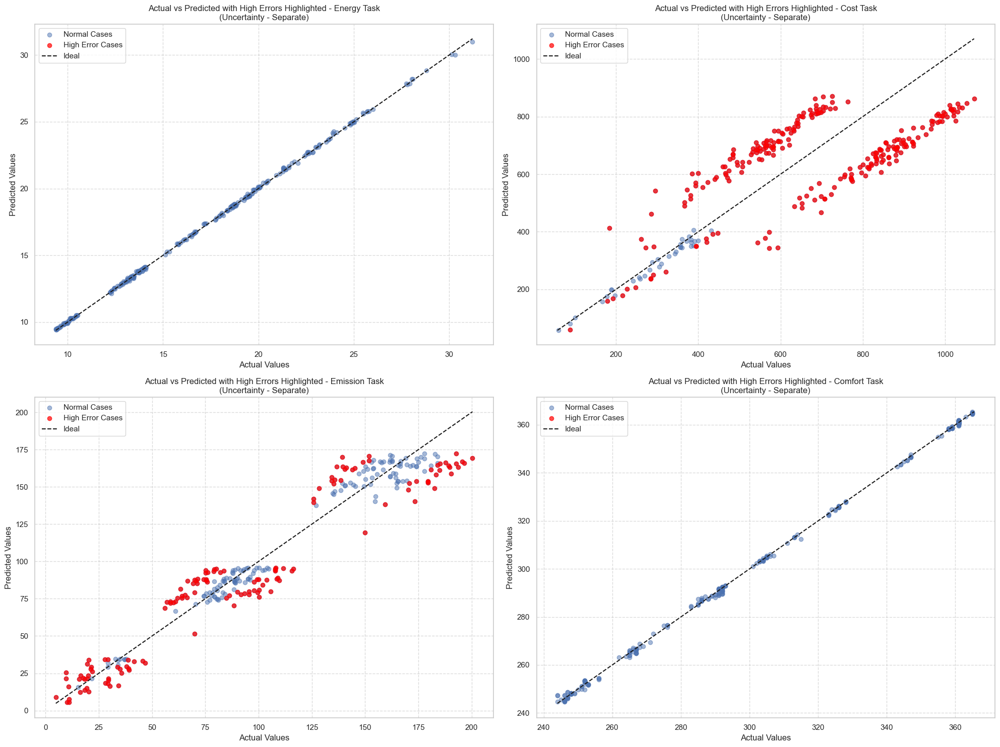


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.161667    1.576408  0.901064
Cost      135.481079  158.180695  0.563560
Emission   23.682182   32.224319  0.625377
Comfort     9.088577   12.659552  0.912901


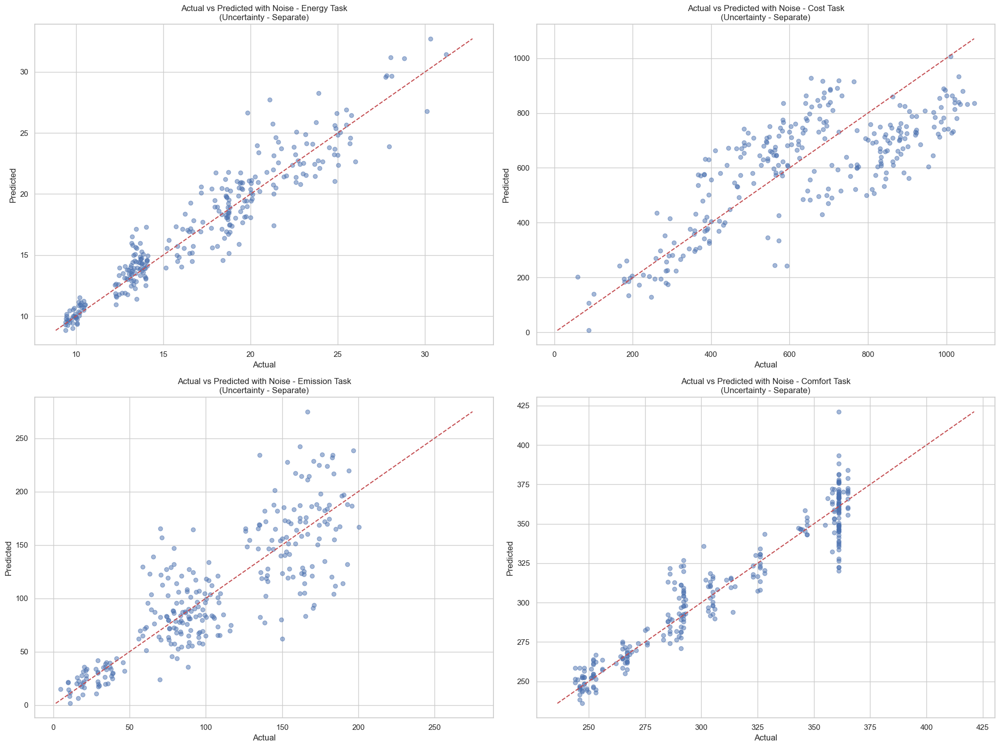


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - Separate:
                 MAE        RMSE        R2
Task                                      
Energy      0.068811    0.089306  0.999682
Cost      137.204849  151.174866  0.601364
Emission   10.826985   13.264130  0.936528
Comfort     0.650722    0.884793  0.999575


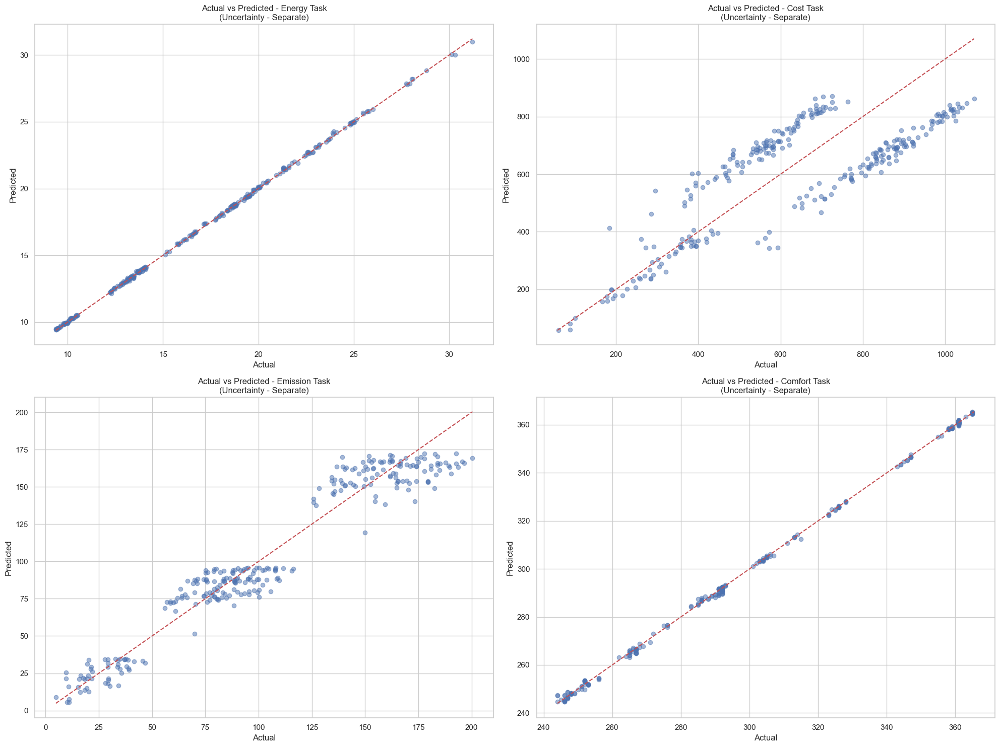


Evaluating Ref_based_isa Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.333181      2.799477    1.673164  0.888546
Cost      139.293945  26666.482422  163.298752  0.534860
Emission   19.953011    595.080811   24.394278  0.785314
Comfort     5.996270     47.680122    6.905079  0.974087

Performing Error Analysis...

Energy Task: 102 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 12.81, Predicted: 14.19, Error: 10.75%
Actual: 9.50, Predicted: 11.23, Error: 18.19%
Actual: 16.66, Predicted: 18.53, Error: 11.25%
Actual: 16.55, Predicted: 18.98, Error: 14.71%
Actual: 10.29, Predicted: 12.20, Error: 18.59%

Cost Task: 238 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 474.00, Predicted: 566.42, Error: 19.50%
Actual: 881.00, Predicted: 670.79, Error: 23.86%
Actual: 923.00,

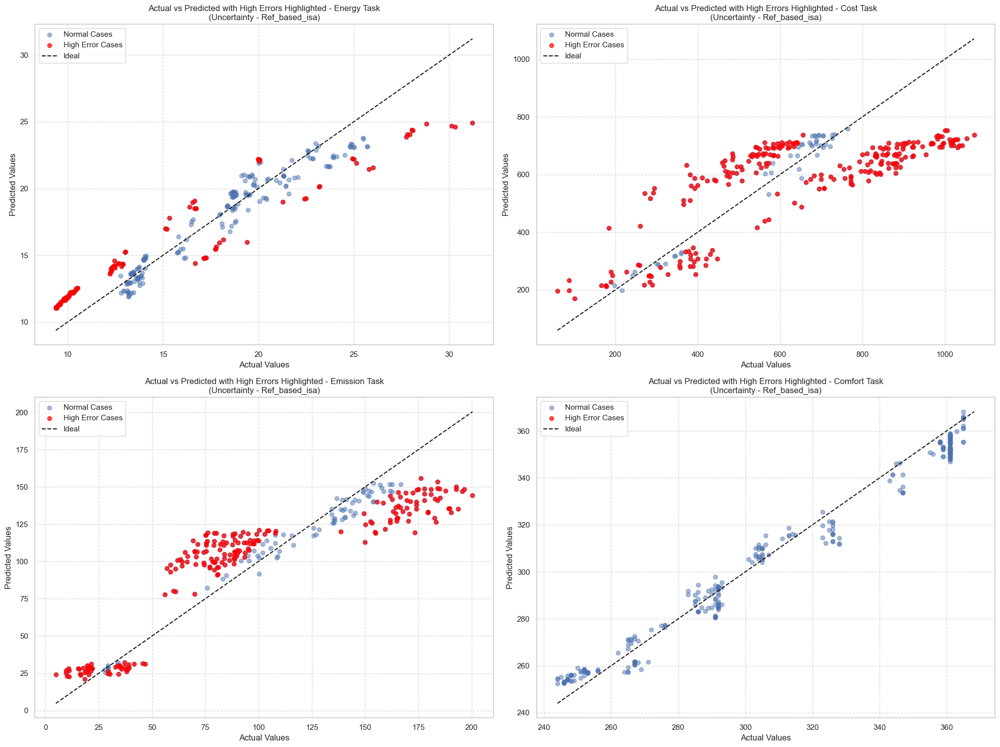


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.757044    2.230276  0.801968
Cost      140.850433  168.881821  0.502511
Emission   22.477880   28.663773  0.703589
Comfort    10.808969   14.422833  0.886948


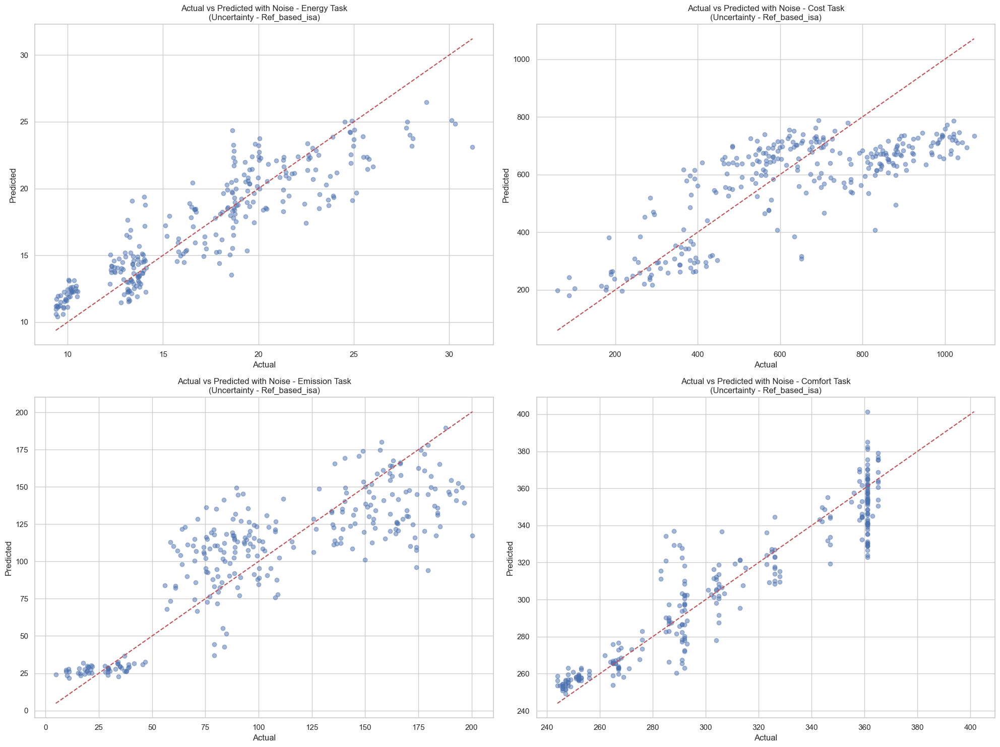


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - Ref_based_isa:
                 MAE        RMSE        R2
Task                                      
Energy      1.333181    1.673164  0.888546
Cost      139.293945  163.298752  0.534860
Emission   19.953011   24.394278  0.785314
Comfort     5.996270    6.905079  0.974087


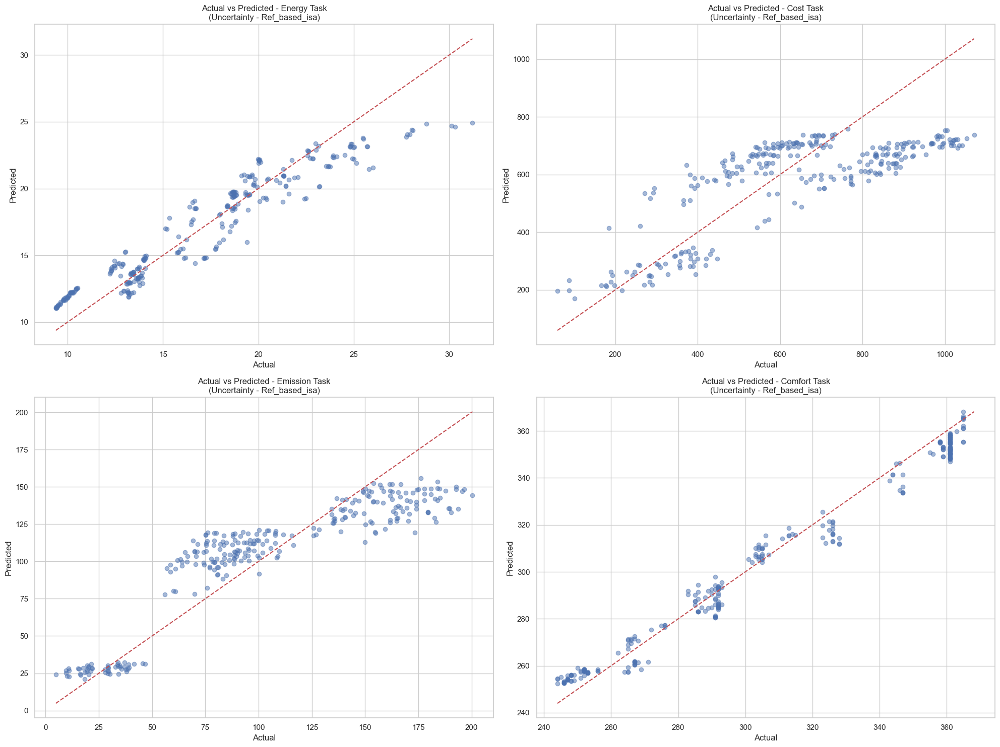


Evaluating Data_based_isa Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.259598      2.709565    1.646075  0.892126
Cost      137.082794  23254.578125  152.494522  0.594374
Emission   17.657272    502.164673   22.409031  0.818835
Comfort     6.050025     54.217430    7.363249  0.970534

Performing Error Analysis...

Energy Task: 97 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 19.46, Predicted: 17.15, Error: 11.89%
Actual: 12.81, Predicted: 14.94, Error: 16.61%
Actual: 9.50, Predicted: 11.09, Error: 16.76%
Actual: 16.55, Predicted: 18.32, Error: 10.73%
Actual: 10.29, Predicted: 12.12, Error: 17.80%

Cost Task: 249 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 234.15, Error: 18.56%
Actual: 474.00, Predicted: 562.87, Error: 18.75%
Actual: 881.00,

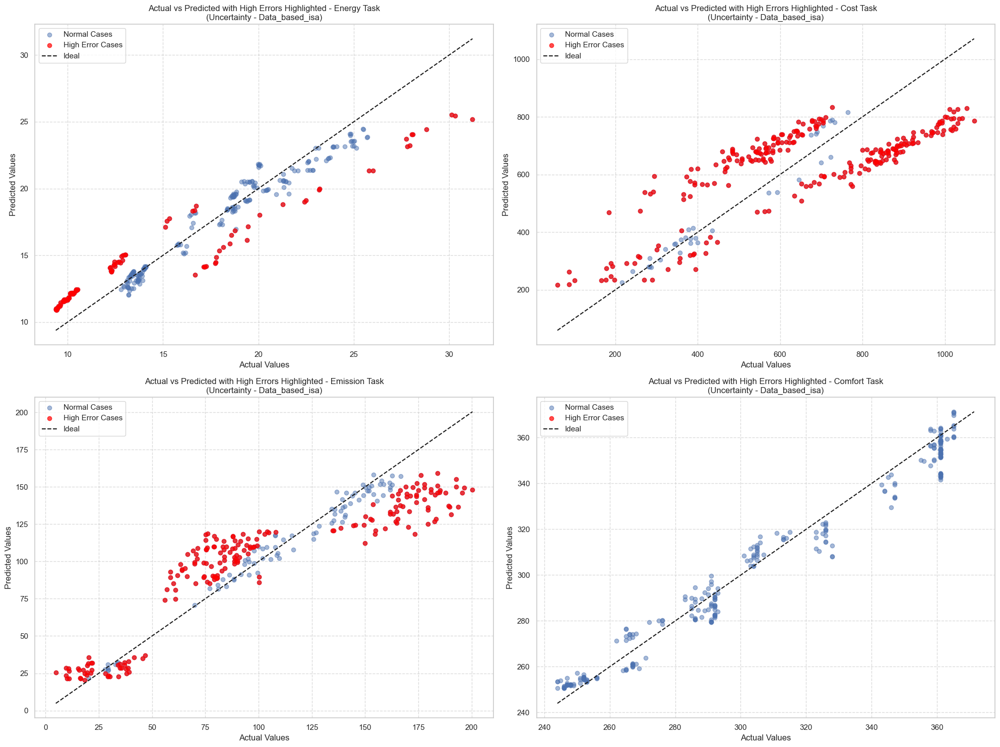


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.711146    2.119311  0.821184
Cost      141.346939  162.588867  0.538896
Emission   22.322161   29.036579  0.695829
Comfort    10.727213   14.093456  0.892052


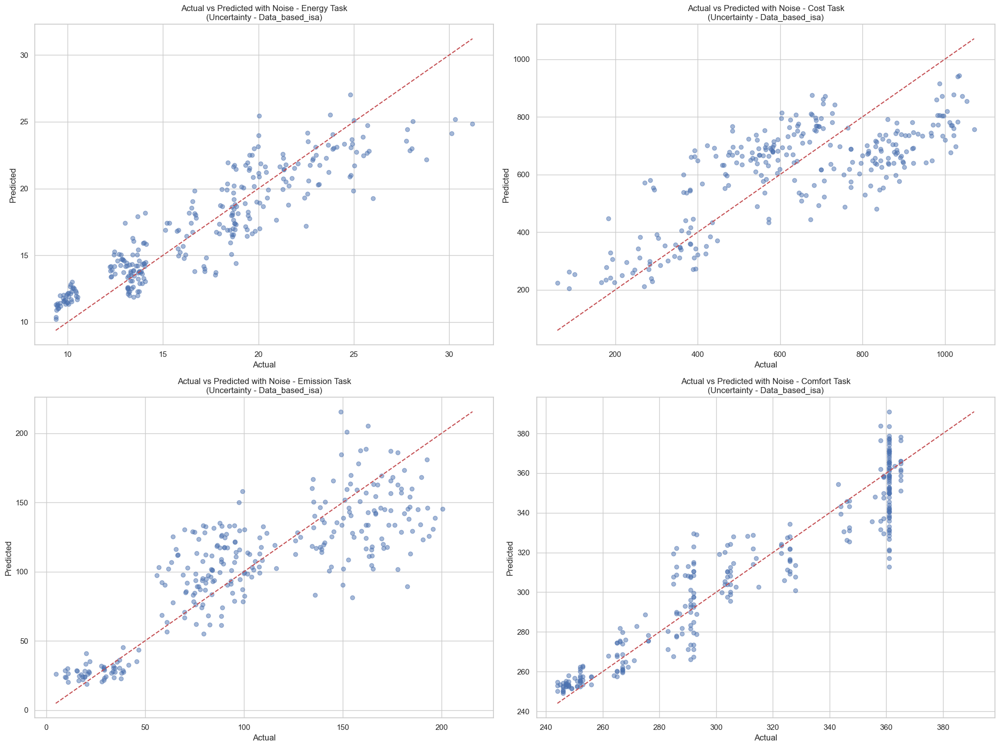


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - Data_based_isa:
                 MAE        RMSE        R2
Task                                      
Energy      1.259598    1.646075  0.892126
Cost      137.082794  152.494522  0.594374
Emission   17.657272   22.409031  0.818835
Comfort     6.050025    7.363249  0.970534


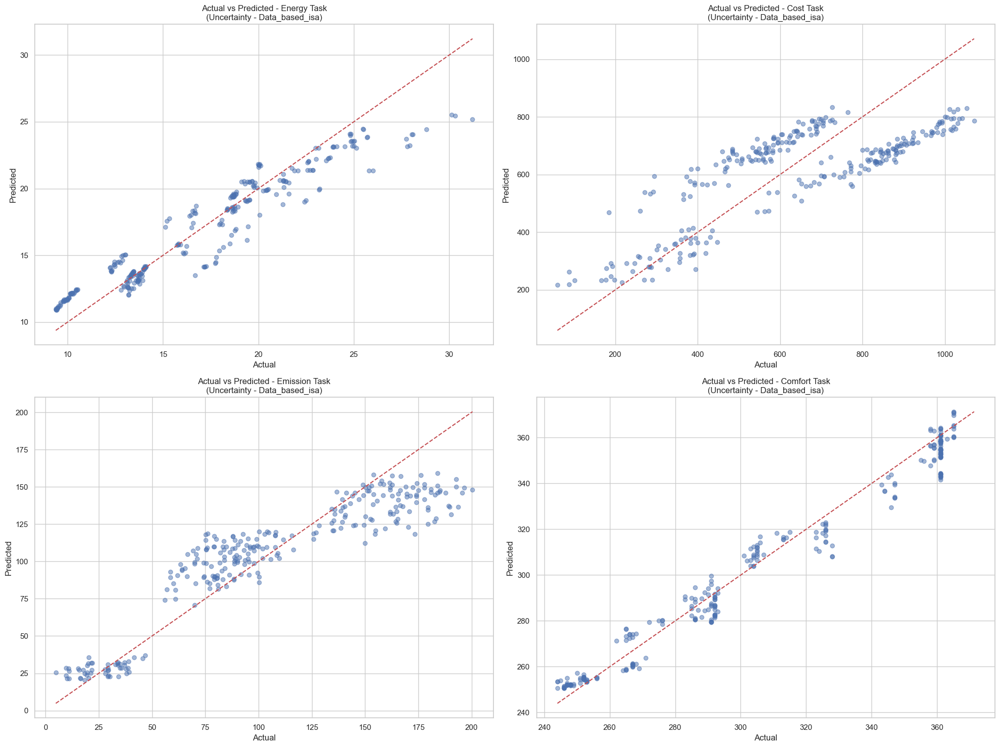


Evaluating More_shared_layer Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.565603      3.933249    1.983242  0.843408
Cost      139.681747  24365.285156  156.093842  0.575000
Emission   21.490465    835.027954   28.896851  0.698749
Comfort     7.669470     81.302696    9.016801  0.955814

Performing Error Analysis...

Energy Task: 87 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 13.35, Predicted: 10.99, Error: 17.67%
Actual: 20.37, Predicted: 16.85, Error: 17.25%
Actual: 23.54, Predicted: 19.66, Error: 16.50%
Actual: 21.60, Predicted: 18.61, Error: 13.85%
Actual: 17.79, Predicted: 13.75, Error: 22.69%

Cost Task: 250 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 236.03, Error: 19.51%
Actual: 474.00, Predicted: 549.25, Error: 15.88%
Actual: 881

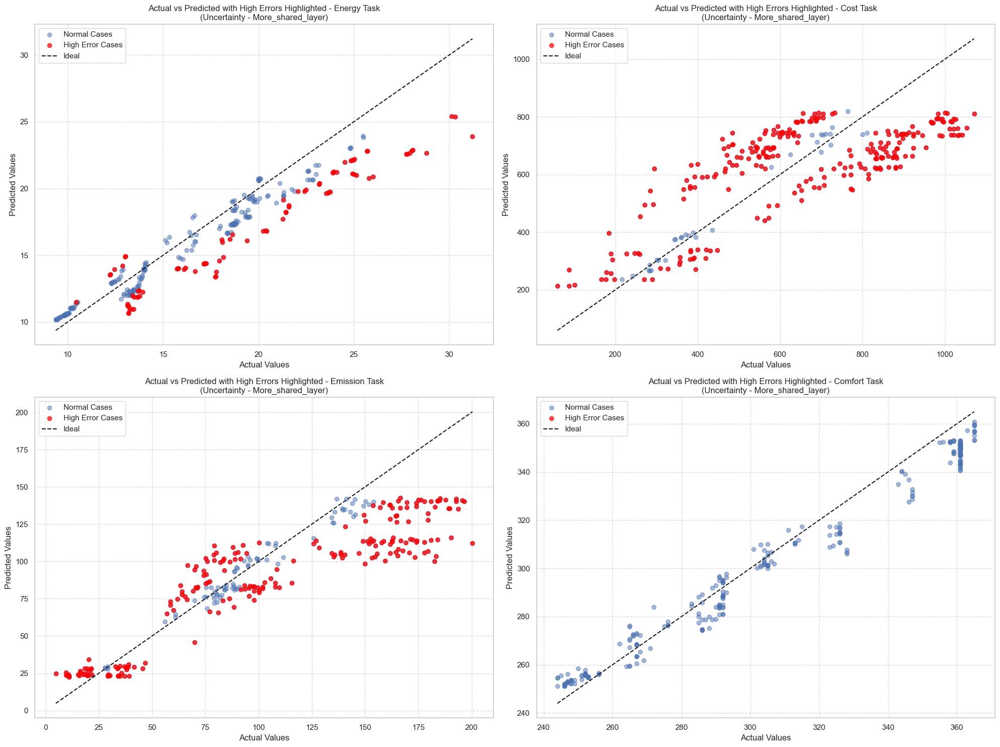


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.666140    2.178310  0.811089
Cost      140.366745  164.294830  0.529169
Emission   26.719990   34.452827  0.571770
Comfort    10.762562   14.301461  0.888842


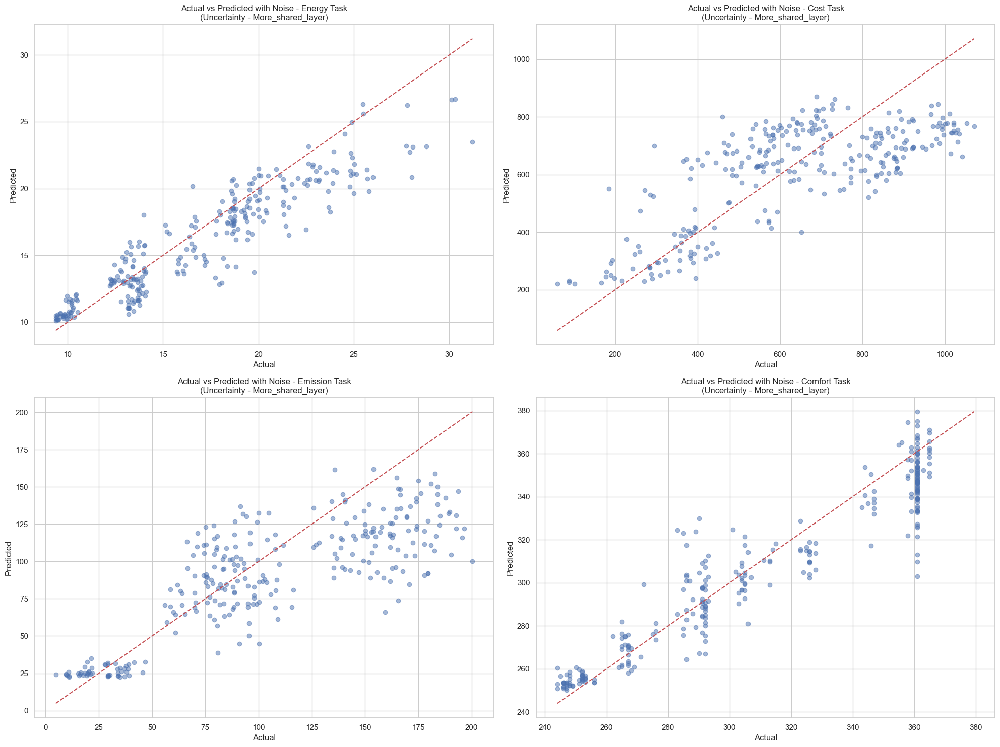


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - More_shared_layer:
                 MAE        RMSE        R2
Task                                      
Energy      1.565603    1.983242  0.843408
Cost      139.681747  156.093842  0.575000
Emission   21.490465   28.896851  0.698749
Comfort     7.669470    9.016801  0.955814


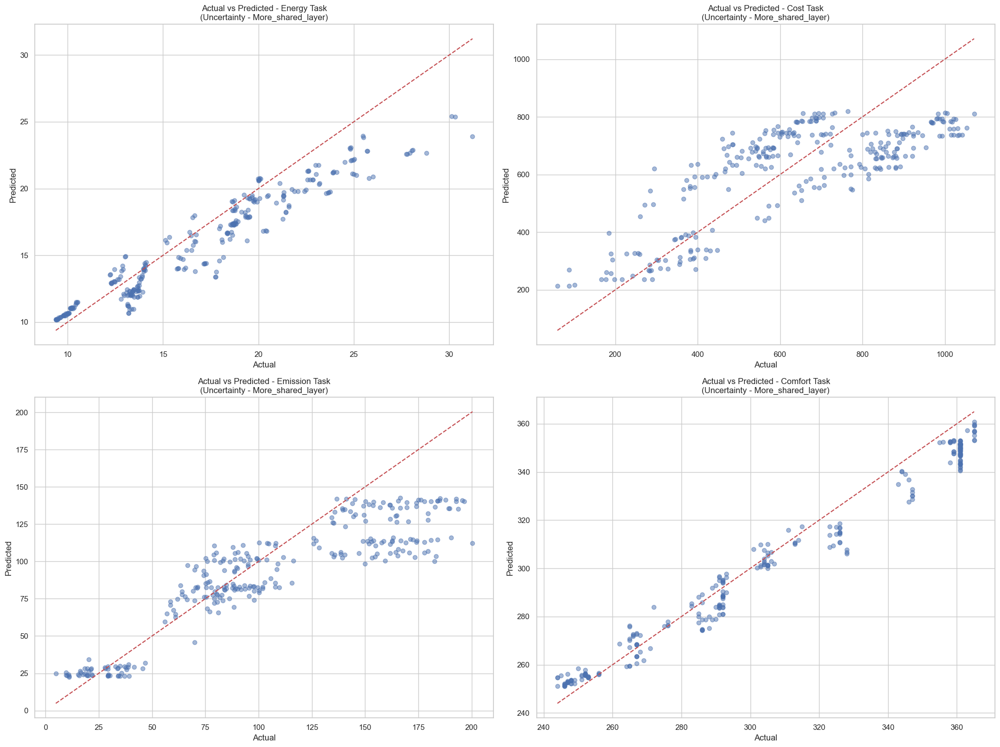


Evaluating Few_shared_layers Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      0.689699      0.809483    0.899713  0.967773
Cost      181.746750  56845.136719  238.422180  0.008459
Emission   18.022491    548.482727   23.419708  0.802125
Comfort     3.065502     12.812986    3.579523  0.993036

Performing Error Analysis...

Energy Task: 8 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 9.62, Predicted: 10.67, Error: 10.84%
Actual: 19.41, Predicted: 17.37, Error: 10.49%
Actual: 31.22, Predicted: 27.45, Error: 12.09%
Actual: 26.00, Predicted: 23.07, Error: 11.28%
Actual: 9.41, Predicted: 10.37, Error: 10.15%

Cost Task: 210 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 176.87, Error: 10.44%
Actual: 881.00, Predicted: 510.88, Error: 42.01%
Actual: 923.00

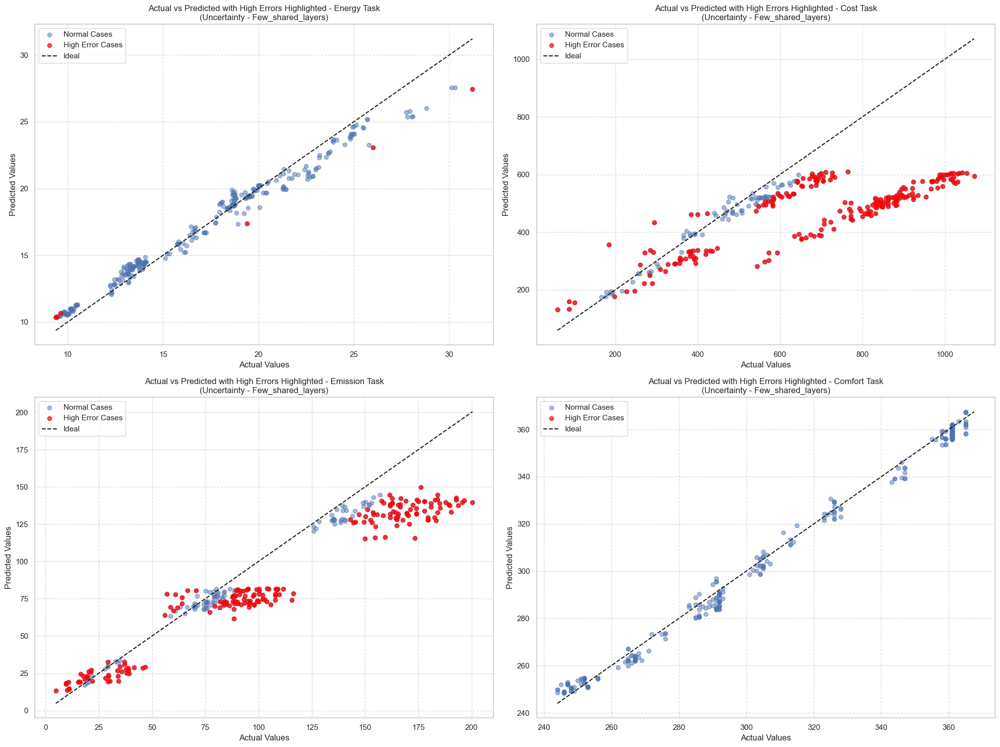


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.167397    1.547690  0.904636
Cost      186.835968  239.384186  0.000441
Emission   26.733995   35.173260  0.553674
Comfort     8.856219   12.926483  0.909189


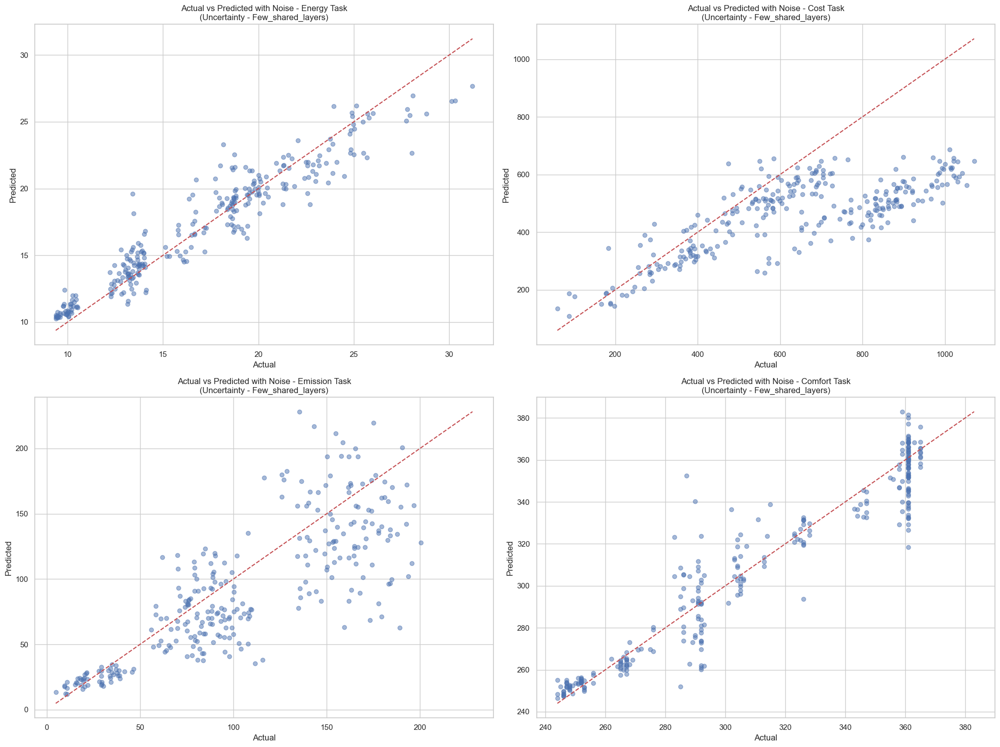


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - Few_shared_layers:
                 MAE        RMSE        R2
Task                                      
Energy      0.689699    0.899713  0.967773
Cost      181.746750  238.422180  0.008459
Emission   18.022491   23.419708  0.802125
Comfort     3.065502    3.579523  0.993036


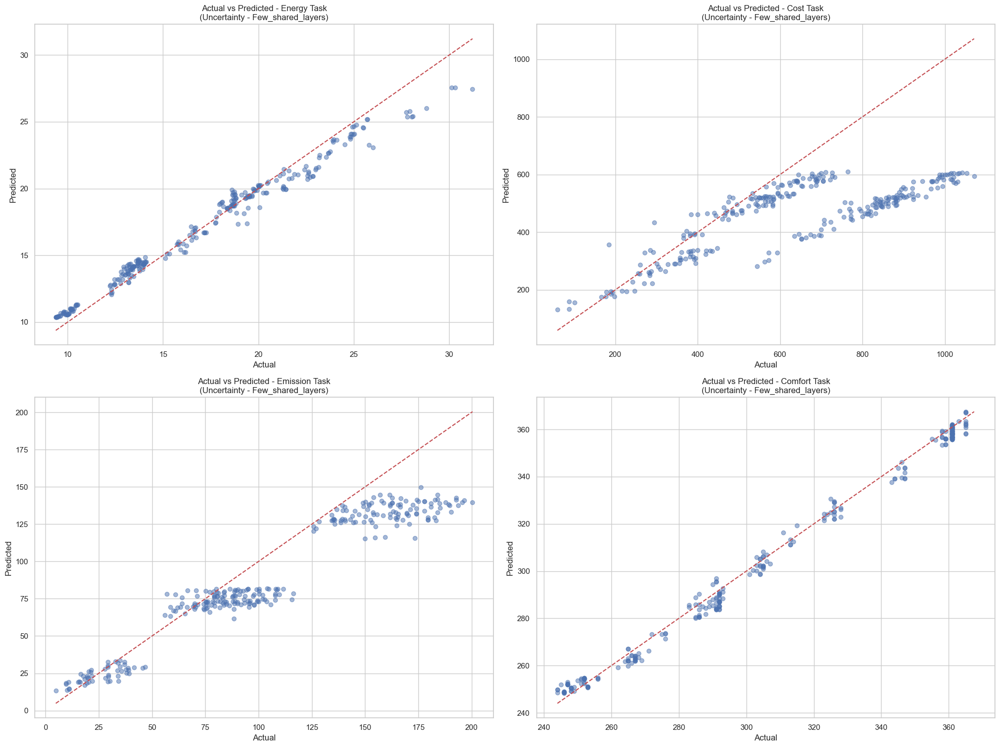


Evaluating Deep_balanced_layer Model with Uncertainty Method:

Performing Numerical Evaluation (Metrics Calculation)...
                 MAE           MSE        RMSE        R2
Task                                                    
Energy      1.205781      2.603370    1.613496  0.896354
Cost      137.277542  24959.101562  157.984497  0.564642
Emission   15.160006    392.653748   19.815493  0.858343
Comfort     6.470131     62.008545    7.874550  0.966300

Performing Error Analysis...

Energy Task: 58 cases with > 10.0% error.
Sample high-error cases for Energy Task:
Actual: 13.35, Predicted: 11.48, Error: 13.98%
Actual: 20.37, Predicted: 16.89, Error: 17.08%
Actual: 23.54, Predicted: 20.21, Error: 14.13%
Actual: 19.32, Predicted: 17.12, Error: 11.41%
Actual: 17.79, Predicted: 15.41, Error: 13.38%

Cost Task: 241 cases with > 10.0% error.
Sample high-error cases for Cost Task:
Actual: 197.50, Predicted: 223.39, Error: 13.11%
Actual: 474.00, Predicted: 542.28, Error: 14.41%
Actual: 8

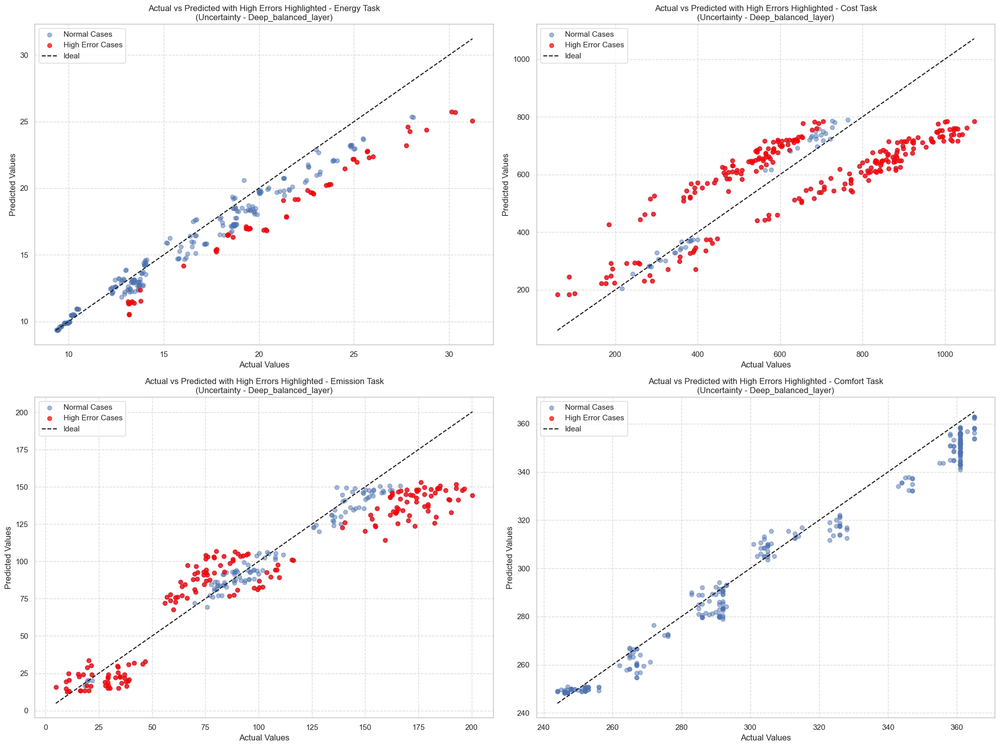


Performing Robustness Testing...

Robustness Testing with Noise Level 0.1:
                 MAE        RMSE        R2
Task                                      
Energy      1.405318    1.900389  0.856218
Cost      138.184265  164.502304  0.527979
Emission   22.289127   29.285843  0.690584
Comfort     9.639527   12.671726  0.912733


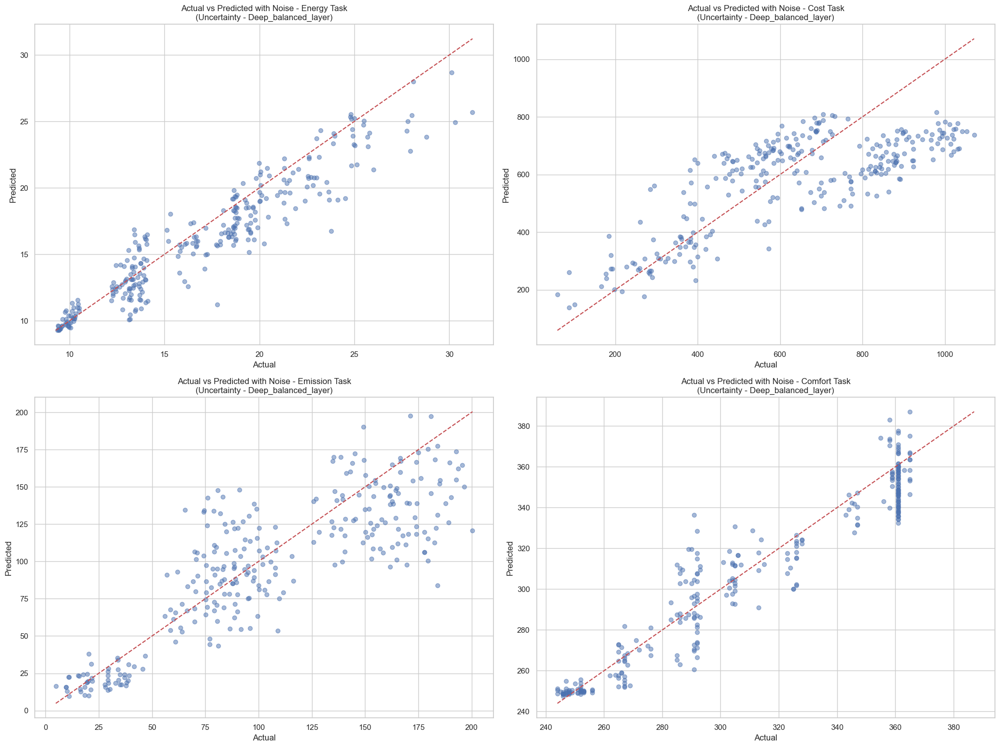


Performing Real-World Validation on Test Data...

Real-World Validation Metrics (Test Data) - Uncertainty - Deep_balanced_layer:
                 MAE        RMSE        R2
Task                                      
Energy      1.205781    1.613496  0.896354
Cost      137.277542  157.984497  0.564642
Emission   15.160006   19.815493  0.858343
Comfort     6.470131    7.874550  0.966300


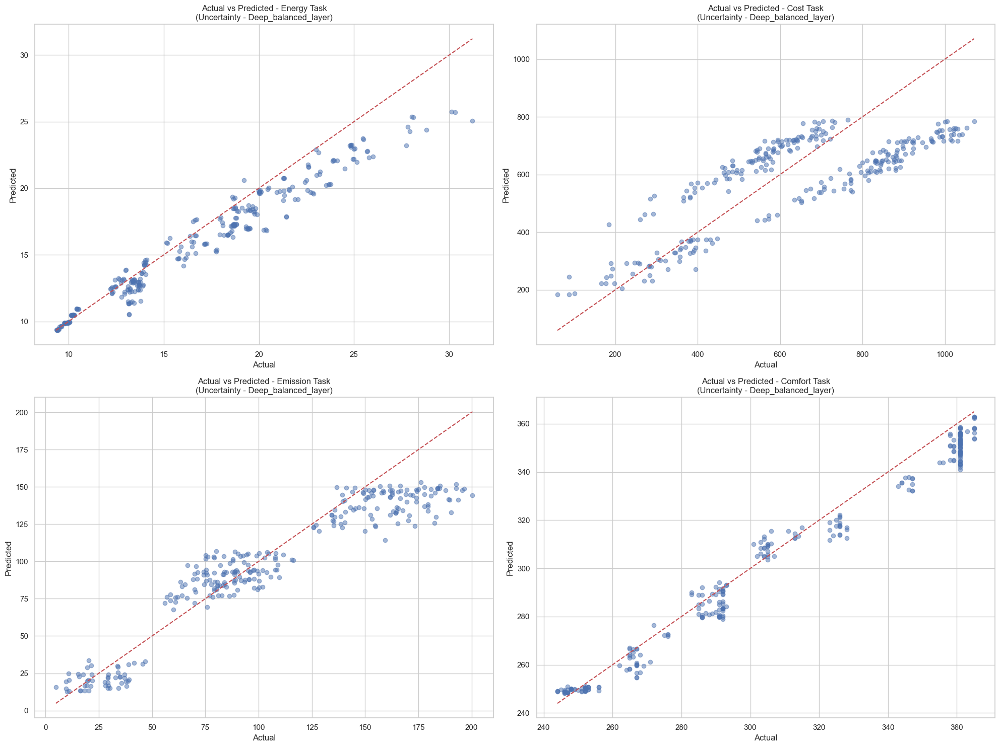


Ranking All Models Based on Performance Metrics...

Ranked Models:
                               Model        MAE  Norm_MAE       RMSE  \
0                      separate_mgda  36.449043  1.000000  40.401146   
1               separate_uncertainty  37.187843  0.954601  41.353275   
2           Deep_Balanced_Layer_mgda  39.593132  0.806798  45.337605   
3   Deep_Balanced_Layer_weighted_sum  39.367290  0.820676  46.100285   
4                        shared_mgda  40.365242  0.759352  46.121872   
5    Deep_Balanced_Layer_uncertainty  40.028366  0.780053  46.822010   
6         Data_Based_Isa_uncertainty  40.512421  0.750308  45.978218   
7                 shared_uncertainty  40.232719  0.767496  48.368305   
8        Data_Based_Isa_weighted_sum  41.088707  0.714896  46.926292   
9                shared_weighted_sum  41.183140  0.709093  47.354595   
10               Data_Based_Isa_mgda  41.583775  0.684474  46.558807   
11         Ref_Based_Isa_uncertainty  41.644104  0.680767  49.067814

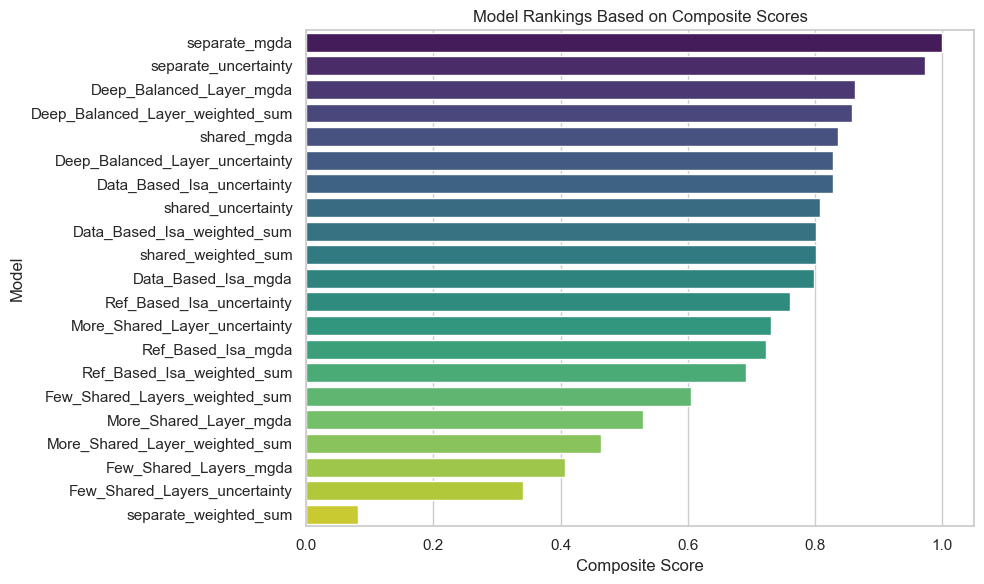

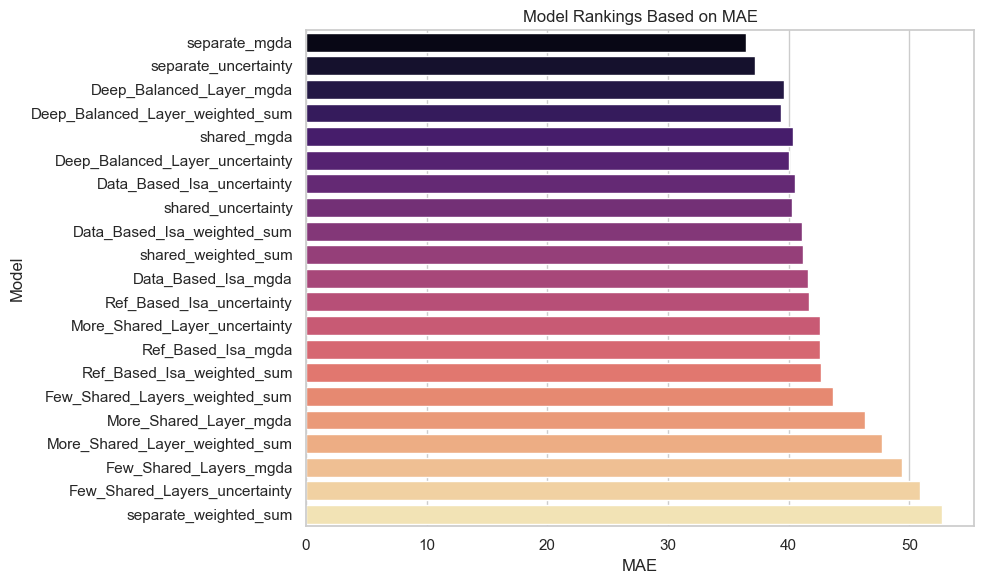

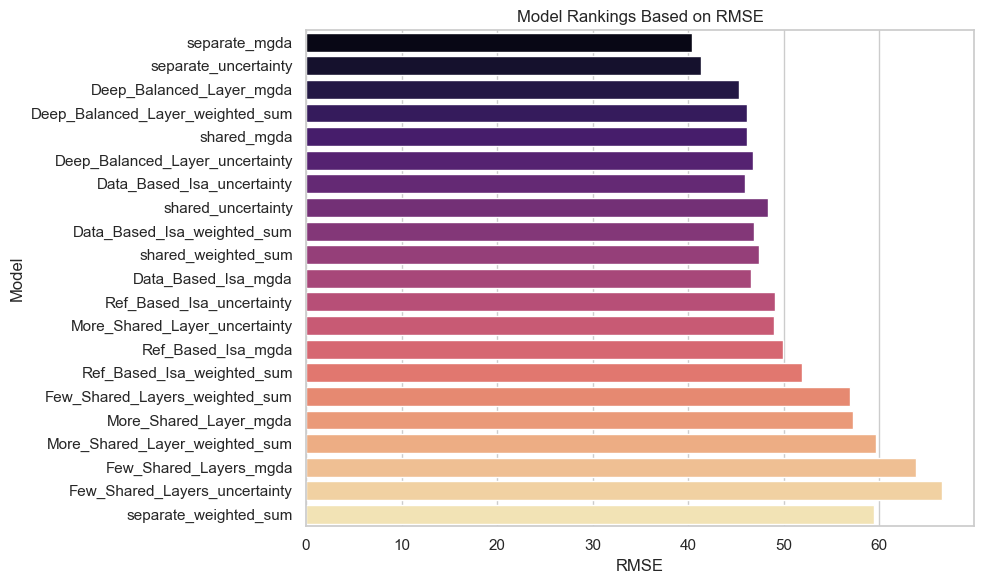

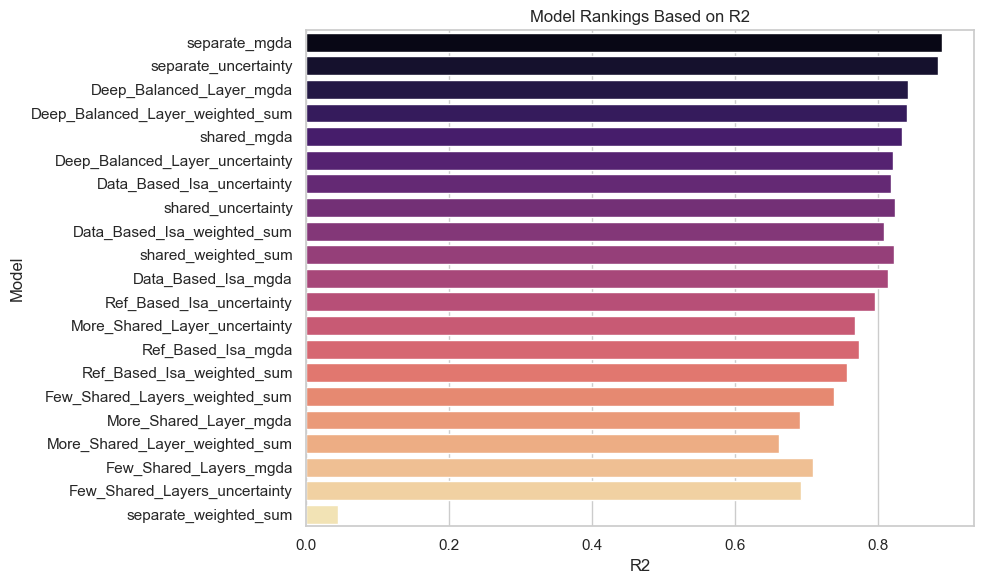

In [127]:
# 9.2. Evaluate Models - Numerical Evaluations and Model Ranking

# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize dictionaries to store evaluation metrics
evaluation_dict = {}
robustness_metrics_dict = {}
real_world_validation_dict = {}

# Define task names
task_names = ['Energy', 'Cost', 'Emission', 'Comfort']

# Loop through each method and model type to evaluate models
for method in method_list:
    for model_type in model_type_list:
        print(f"\nEvaluating {model_type.capitalize()} Model with {method.replace('_', ' ').capitalize()} Method:")
        
        # Initialize model based on method and model_type
        if method == 'uncertainty':
            if model_type == 'shared':
                model = SharedMTLModelWithUncertainty(input_size, hidden_size, num_tasks=4)
            elif model_type == 'separate':
                model = SeparateMTLModelWithUncertainty(input_size, hidden_size, num_tasks=4)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(
                    input_size, hidden_size1=128, hidden_size2=64, 
                    shared_energy_emission_size=32, shared_comfort_size=32, 
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                print("Invalid model type. Skipping this model.")
                continue
        elif method == 'cagrad':
            if model_type == 'shared':
                model = SharedMTLModel(input_size, hidden_size)
            elif model_type == 'separate':
                model = SeparateMTLModel(input_size, hidden_size)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(
                    input_size, hidden_size1=128, hidden_size2=64,
                    shared_energy_emission_size=32, shared_comfort_size=32,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                print("Invalid model type. Skipping this model.")
                continue
        else:
            if model_type == 'shared':
                model = SharedMTLModel(input_size, hidden_size)
            elif model_type == 'separate':
                model = SeparateMTLModel(input_size, hidden_size)
            elif model_type == 'Ref_Based_Isa':
                model = Ref_Based(input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
            elif model_type == 'Data_Based_Isa':
                model = Data_Based(
                    input_size, hidden_size1=128, hidden_size2=64,
                    shared_energy_emission_size=32, shared_comfort_size=32,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'More_Shared_Layer':
                model = More_Shared(
                    input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                    dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Few_Shared_Layers':
                model = Few_Shared(
                    input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
                )
            elif model_type == 'Deep_Balanced_Layer':
                model = Deep_Balanced(
                    input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                    dropout_rate=0.5, num_tasks=4
                )
            else:
                print("Invalid model type. Skipping this model.")
                continue

        # Move model to device
        model.to(device)

        # Load the trained model weights
        model_path = get_model_path(method, model_type)
        if not os.path.exists(model_path):
            print(f"Model file {model_path} does not exist. Skipping this model.")
            continue
        model.load_state_dict(torch.load(model_path, map_location=device))
        model.to(device)

        # Load the input scaler
        scaler_X_path = get_scaler_path(method, model_type, scaler_type='X')
        if not os.path.exists(scaler_X_path):
            print(f"Scaler file {scaler_X_path} does not exist. Skipping this model.")
            continue
        scaler_X = joblib.load(scaler_X_path)

        # Load scalers for Y (one per task)
        scalers_Y = []
        for i in range(len(task_names)):
            scaler_Y_path = get_scaler_path(method, model_type, scaler_type=f'Y_{i}')
            if not os.path.exists(scaler_Y_path):
                print(f"Scaler file {scaler_Y_path} does not exist for task {task_names[i]}. Skipping this model.")
                break
            scaler = joblib.load(scaler_Y_path)
            scalers_Y.append(scaler)
        else:
            # Proceed only if all Y scalers are loaded
            pass
        # If break was called in the for-loop above, scalers_Y won't have all scalers
        if len(scalers_Y) != len(task_names):
            print(f"Incomplete scalers for model {model_type}_{method}. Skipping this model.")
            continue

        # Define feature names
        feature_names = input_features  # Ensure this matches the order and number of input features

        # ---------------------------------------------------
        # 9.2.1. Inverse Transformation and Metric Calculation
        # ---------------------------------------------------
        print("\nPerforming Numerical Evaluation (Metrics Calculation)...")
        metrics_df, targets_real, predictions_real = evaluate_model_inverse_transform(
            model, test_loader, scalers_Y, method=method, model_type=model_type
        )
        key = f'{model_type}_{method}'
        evaluation_dict[key] = metrics_df

        # ---------------------------------------------------
        # 9.2.2. Error Analysis
        # ---------------------------------------------------
        print("\nPerforming Error Analysis...")
        # Modified error_analysis function to plot all tasks in one figure
        def error_analysis_consolidated(predictions, targets, threshold=10.0, method='evaluation', model_type='shared'):
            """
            Identifies and analyzes cases where the absolute percentage error exceeds the threshold.
            Plots all tasks in a single figure with four subplots.
            """
            num_tasks = targets.shape[1]
            task_names = ['Energy', 'Cost', 'Emission', 'Comfort']

            fig, axes = plt.subplots(2, 2, figsize=(20, 15))  # Adjust figure size as needed
            axes = axes.flatten()

            for i in range(num_tasks):
                task = task_names[i]
                errors = 100 * np.abs((predictions[:, i] - targets[:, i]) / (np.abs(targets[:, i]) + 1e-6))
                high_error_indices = np.where(errors > threshold)[0]
                print(f"\n{task} Task: {len(high_error_indices)} cases with > {threshold}% error.")

                # Display some high-error cases
                sample_indices = high_error_indices[:5]  # Show first 5
                print(f"Sample high-error cases for {task} Task:")
                for idx in sample_indices:
                    print(f"Actual: {targets[idx, i]:.2f}, Predicted: {predictions[idx, i]:.2f}, Error: {errors[idx]:.2f}%")

                # Plotting in the consolidated figure
                axes[i].scatter(targets[:, i], predictions[:, i], alpha=0.5, label='Normal Cases')
                axes[i].scatter(targets[high_error_indices, i], predictions[high_error_indices, i], color='red', alpha=0.7, label='High Error Cases')
                min_val = min(targets[:, i].min(), predictions[:, i].min())
                max_val = max(targets[:, i].max(), predictions[:, i].max())
                axes[i].plot([min_val, max_val], [min_val, max_val], 'k--', label='Ideal')
                axes[i].set_xlabel('Actual Values')
                axes[i].set_ylabel('Predicted Values')
                axes[i].set_title(f'Actual vs Predicted with High Errors Highlighted - {task} Task\n({method.capitalize()} - {model_type.capitalize()})')
                axes[i].legend()
                axes[i].grid(True, linestyle='--', alpha=0.7)
            
            plt.tight_layout()
            plt.show()

        error_analysis_consolidated(predictions_real, targets_real, threshold=10.0, method=method, model_type=model_type)

        # ---------------------------------------------------
        # 9.2.3. Robustness Testing
        # ---------------------------------------------------
        print("\nPerforming Robustness Testing...")
        # Modified robustness_testing function to plot all tasks in one figure
        def robustness_testing_consolidated(model, data_loader, scalers_Y, noise_level=0.1, method='evaluation', model_type='shared'):
            """
            Tests model robustness by adding Gaussian noise to the inputs.
            Plots all tasks in a single figure with four subplots.
            """
            model.eval()
            device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
            model.to(device)

            all_targets = []
            all_predictions = []

            with torch.no_grad():
                for inputs, targets in data_loader:
                    inputs = inputs.to(device)
                    targets = targets.to(device)
                    # Add Gaussian noise
                    noise = torch.randn_like(inputs) * noise_level
                    noisy_inputs = inputs + noise
                    outputs = model(noisy_inputs)
                    preds = torch.cat(outputs, dim=1)
                    all_predictions.append(preds.cpu().numpy())
                    all_targets.append(targets.cpu().numpy())

            all_predictions = np.vstack(all_predictions)
            all_targets = np.vstack(all_targets)

            # Apply inverse transformation
            all_targets_real_list = []
            all_predictions_real_list = []
            for i in range(len(scalers_Y)):
                y_true = all_targets[:, i].reshape(-1, 1)
                y_pred = all_predictions[:, i].reshape(-1, 1)
                scaler = scalers_Y[i]
                y_true_real = scaler.inverse_transform(y_true)
                y_pred_real = scaler.inverse_transform(y_pred)
                all_targets_real_list.append(y_true_real)
                all_predictions_real_list.append(y_pred_real)
            all_targets_real = np.hstack(all_targets_real_list)
            all_predictions_real = np.hstack(all_predictions_real_list)

            # Compute and display metrics
            task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
            metrics = {
                'Task': task_names,
                'MAE': [],
                'RMSE': [],
                'R2': []
            }

            for i in range(len(scalers_Y)):
                mse = mean_squared_error(all_targets_real[:, i], all_predictions_real[:, i])
                rmse = np.sqrt(mse)
                mae = mean_absolute_error(all_targets_real[:, i], all_predictions_real[:, i])
                r2 = r2_score(all_targets_real[:, i], all_predictions_real[:, i])

                metrics['MAE'].append(mae)
                metrics['RMSE'].append(rmse)
                metrics['R2'].append(r2)

            metrics_df = pd.DataFrame(metrics).set_index('Task')
            print(f"\nRobustness Testing with Noise Level {noise_level}:")
            print(metrics_df)

            # Plotting in consolidated figure
            fig, axes = plt.subplots(2, 2, figsize=(20, 15))  # Adjust figure size as needed
            axes = axes.flatten()
            for i, task in enumerate(task_names):
                axes[i].scatter(all_targets_real[:, i], all_predictions_real[:, i], alpha=0.5)
                min_val = min(all_targets_real[:, i].min(), all_predictions_real[:, i].min())
                max_val = max(all_targets_real[:, i].max(), all_predictions_real[:, i].max())
                axes[i].plot([min_val, max_val], [min_val, max_val], 'r--')
                axes[i].set_xlabel('Actual')
                axes[i].set_ylabel('Predicted')
                axes[i].set_title(f'Actual vs Predicted with Noise - {task} Task\n({method.capitalize()} - {model_type.capitalize()})')
                axes[i].grid(True)
            plt.tight_layout()
            plt.show()

            return metrics_df

        robustness_metrics = robustness_testing_consolidated(
            model=model,
            data_loader=test_loader,
            scalers_Y=scalers_Y,
            noise_level=0.1,  # Adjust noise level as needed
            method=method,
            model_type=model_type
        )
        robustness_metrics_dict[key] = robustness_metrics

        # ---------------------------------------------------
        # 9.2.4. Real-World Validation on Test Data
        # ---------------------------------------------------
        print("\nPerforming Real-World Validation on Test Data...")
        # Modified real_world_validation function to plot all tasks in one figure
        def real_world_validation_consolidated(model, data_loader, scalers_Y, method='evaluation', model_type='shared'):
            """
            Validates the model on the test data.
            Plots all tasks in a single figure with four subplots.
            """
            model.eval()
            device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
            model.to(device)

            all_targets = []
            all_predictions = []

            with torch.no_grad():
                for inputs, targets in data_loader:
                    inputs = inputs.to(device)
                    targets = targets.to(device)
                    outputs = model(inputs)
                    preds = torch.cat(outputs, dim=1)
                    all_predictions.append(preds.cpu().numpy())
                    all_targets.append(targets.cpu().numpy())

            all_predictions = np.vstack(all_predictions)
            all_targets = np.vstack(all_targets)

            # Apply inverse transformation
            all_targets_real_list = []
            all_predictions_real_list = []
            for i in range(len(scalers_Y)):
                y_true = all_targets[:, i].reshape(-1, 1)
                y_pred = all_predictions[:, i].reshape(-1, 1)
                scaler = scalers_Y[i]
                y_true_real = scaler.inverse_transform(y_true)
                y_pred_real = scaler.inverse_transform(y_pred)
                all_targets_real_list.append(y_true_real)
                all_predictions_real_list.append(y_pred_real)
            all_targets_real = np.hstack(all_targets_real_list)
            all_predictions_real = np.hstack(all_predictions_real_list)

            # Compute metrics
            task_names = ['Energy', 'Cost', 'Emission', 'Comfort']
            metrics = {
                'Task': task_names,
                'MAE': [],
                'RMSE': [],
                'R2': []
            }

            for i in range(len(scalers_Y)):
                mae = mean_absolute_error(all_targets_real[:, i], all_predictions_real[:, i])
                mse = mean_squared_error(all_targets_real[:, i], all_predictions_real[:, i])
                rmse = np.sqrt(mse)
                r2 = r2_score(all_targets_real[:, i], all_predictions_real[:, i])

                metrics['MAE'].append(mae)
                metrics['RMSE'].append(rmse)
                metrics['R2'].append(r2)

            metrics_df = pd.DataFrame(metrics).set_index('Task')
            print(f"\nReal-World Validation Metrics (Test Data) - {method.capitalize()} - {model_type.capitalize()}:")
            print(metrics_df)

            # Plotting in consolidated figure
            fig, axes = plt.subplots(2, 2, figsize=(20, 15))  # Adjust figure size as needed
            axes = axes.flatten()
            for i, task in enumerate(task_names):
                axes[i].scatter(all_targets_real[:, i], all_predictions_real[:, i], alpha=0.5)
                min_val = min(all_targets_real[:, i].min(), all_predictions_real[:, i].min())
                max_val = max(all_targets_real[:, i].max(), all_predictions_real[:, i].max())
                axes[i].plot([min_val, max_val], [min_val, max_val], 'r--')
                axes[i].set_xlabel('Actual')
                axes[i].set_ylabel('Predicted')
                axes[i].set_title(f'Actual vs Predicted - {task} Task\n({method.capitalize()} - {model_type.capitalize()})')
                axes[i].grid(True)
            plt.tight_layout()
            plt.show()

            return metrics_df, all_targets_real, all_predictions_real

        real_world_metrics, _, _ = real_world_validation_consolidated(
            model=model,
            data_loader=test_loader,
            scalers_Y=scalers_Y,
            method=method,
            model_type=model_type
        )
        real_world_validation_dict[key] = real_world_metrics

# ---------------------------------------------------
# 9.2.5. Model Ranking
# ---------------------------------------------------
print("\nRanking All Models Based on Performance Metrics...")
ranked_models_df = rank_models(evaluation_dict, weights={'MAE': 0.30, 'RMSE': 0.30, 'R2': 0.40})
print("\nRanked Models:")
print(ranked_models_df)

# ---------------------------------------------------
# 9.2.6. Visualize Ranked Models
# ---------------------------------------------------
print("\nVisualizing Ranked Models...")
visualize_ranked_models(ranked_models_df)


## 9.3. Performance Metrics Table


In [128]:
# 9.3. Performance Metrics Table

import pandas as pd

# Initialize a list to collect data for each model
performance_data = []

# Iterate through each model in evaluation_dict
for model_key, metrics_df in evaluation_dict.items():
    # Initialize a dictionary to store metrics for the current model
    model_metrics = {}
    model_metrics['Model'] = model_key
    
    # Extract metrics for each task
    for task in task_names:
        model_metrics[f'{task}_MAE'] = metrics_df.loc[task, 'MAE']
        model_metrics[f'{task}_MSE'] = metrics_df.loc[task, 'MSE']
        model_metrics[f'{task}_RMSE'] = metrics_df.loc[task, 'RMSE']
        model_metrics[f'{task}_R2'] = metrics_df.loc[task, 'R2']
    
    # Compute average metrics across all tasks
    model_metrics['Average_MAE'] = metrics_df['MAE'].mean()
    model_metrics['Average_MSE'] = metrics_df['MSE'].mean()
    model_metrics['Average_RMSE'] = metrics_df['RMSE'].mean()
    model_metrics['Average_R2'] = metrics_df['R2'].mean()
    
    # Append the model's metrics to the list
    performance_data.append(model_metrics)

# Create a DataFrame from the collected data
performance_df = pd.DataFrame(performance_data)

# Set 'Model' as the index
performance_df.set_index('Model', inplace=True)

# Display the raw performance metrics
print("\n--- Raw Performance Metrics ---")
print(performance_df)

# Normalize MAE, MSE, and RMSE across all models for each task
# We'll perform Min-Max normalization for each metric and task

# Define the metrics and tasks to normalize
metrics_to_normalize = ['MAE', 'MSE', 'RMSE']
tasks = ['Energy', 'Cost', 'Emission', 'Comfort']

# Iterate through each metric and task to compute normalized values
for metric in metrics_to_normalize:
    for task in tasks:
        col = f'{task}_{metric}'
        norm_col = f'{task}_{metric}_Norm'
        min_val = performance_df[col].min()
        max_val = performance_df[col].max()
        # Avoid division by zero
        if max_val - min_val == 0:
            performance_df[norm_col] = 1.0
        else:
            performance_df[norm_col] = (performance_df[col] - min_val) / (max_val - min_val)

# Optionally, normalize the average metrics as well
for metric in metrics_to_normalize:
    avg_col = f'Average_{metric}'
    norm_avg_col = f'Average_{metric}_Norm'
    min_val = performance_df[avg_col].min()
    max_val = performance_df[avg_col].max()
    if max_val - min_val == 0:
        performance_df[norm_avg_col] = 1.0
    else:
        performance_df[norm_avg_col] = (performance_df[avg_col] - min_val) / (max_val - min_val)

# Reorder columns for better readability
# Place raw metrics first, followed by normalized metrics
raw_columns = []
norm_columns = []
for metric in metrics_to_normalize:
    for task in tasks:
        raw_columns.append(f'{task}_{metric}')
        norm_columns.append(f'{task}_{metric}_Norm')
for metric in metrics_to_normalize:
    raw_columns.append(f'Average_{metric}')
    norm_columns.append(f'Average_{metric}_Norm')

performance_df = performance_df[raw_columns + norm_columns]

# Display the comprehensive performance metrics table
print("\n--- Comprehensive Performance Metrics with Normalized Values ---")
print(performance_df)

# Optionally, save the performance table to a CSV file
performance_df.to_csv('performance_metrics_table.csv')
print("\nPerformance metrics table saved to 'performance_metrics_table.csv'")



--- Raw Performance Metrics ---
                                  Energy_MAE  Energy_MSE  Energy_RMSE  \
Model                                                                   
shared_weighted_sum                 1.009554    1.825196     1.350998   
separate_weighted_sum               0.178714    0.055733     0.236078   
Ref_Based_Isa_weighted_sum          1.701795    5.014802     2.239375   
Data_Based_Isa_weighted_sum         1.373811    3.024695     1.739165   
More_Shared_Layer_weighted_sum      1.963263    5.887844     2.426488   
Few_Shared_Layers_weighted_sum      1.700699    3.804250     1.950449   
Deep_Balanced_Layer_weighted_sum    0.879613    1.171700     1.082451   
shared_mgda                         0.915348    1.492767     1.221788   
separate_mgda                       0.124721    0.035002     0.187090   
Ref_Based_Isa_mgda                  1.519989    3.997036     1.999259   
Data_Based_Isa_mgda                 1.142639    2.065797     1.437288   
More_Shared_Layer_

In [129]:
# Define weights for ranking (adjust as needed)
weights = {
    'MAE': 0.30,
    'RMSE': 0.30,
    'R2': 0.40
}

# Rank the models
ranked_models = rank_models(evaluation_dict, weights=weights)

# Display the ranked models
if not ranked_models.empty:
    print("\nRanked Models:")
    print(ranked_models)
else:
    print("No models were ranked due to missing metrics.")

# Visualize the ranked models
#visualize_ranked_models(ranked_models)



Ranked Models:
                               Model        MAE  Norm_MAE       RMSE  \
0                      separate_mgda  36.449043  1.000000  40.401146   
1               separate_uncertainty  37.187843  0.954601  41.353275   
2           Deep_Balanced_Layer_mgda  39.593132  0.806798  45.337605   
3   Deep_Balanced_Layer_weighted_sum  39.367290  0.820676  46.100285   
4                        shared_mgda  40.365242  0.759352  46.121872   
5    Deep_Balanced_Layer_uncertainty  40.028366  0.780053  46.822010   
6         Data_Based_Isa_uncertainty  40.512421  0.750308  45.978218   
7                 shared_uncertainty  40.232719  0.767496  48.368305   
8        Data_Based_Isa_weighted_sum  41.088707  0.714896  46.926292   
9                shared_weighted_sum  41.183140  0.709093  47.354595   
10               Data_Based_Isa_mgda  41.583775  0.684474  46.558807   
11         Ref_Based_Isa_uncertainty  41.644104  0.680767  49.067814   
12     More_Shared_Layer_uncertainty  42.601818 

# 10. Inference on New Data



In [130]:
# 10. Inference on New Data

import os
import numpy as np
import pandas as pd
import joblib
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset

# Assume all necessary imports and previous code (model definitions, training functions, etc.) are already present
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Helper function to select the appropriate model based on method and model_type
def select_model(method, model_type, input_size, hidden_size):

    if method == 'uncertainty':
        if model_type == 'shared':
            model = SharedMTLModelWithUncertainty(input_size=input_size, hidden_size=hidden_size, num_tasks=4)
        elif model_type == 'separate':
            model = SeparateMTLModelWithUncertainty(input_size=input_size, hidden_size=hidden_size, num_tasks=4)
        elif model_type == 'Ref_Based_Isa':
            model = Ref_Based(input_size=input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
        elif model_type == 'Data_Based_Isa':
            model = Data_Based(
                input_size=input_size, hidden_size1=128, hidden_size2=64,
                shared_energy_emission_size=32, shared_comfort_size=32,
                dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'More_Shared_Layer':
            model = More_Shared(
                input_size=input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'Few_Shared_Layers':
            model = Few_Shared(
                input_size=input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'Deep_Balanced_Layer':
            model = Deep_Balanced(
                input_size=input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                dropout_rate=0.5, num_tasks=4
            )
        else:
            raise ValueError(f"Unsupported model_type '{model_type}' for method 'uncertainty'")
    elif method == 'cagrad':
        if model_type == 'shared':
            model = SharedMTLModel(input_size=input_size, hidden_size=hidden_size)
        elif model_type == 'separate':
            model = SeparateMTLModel(input_size=input_size, hidden_size=hidden_size)
        elif model_type == 'Ref_Based_Isa':
            model = Ref_Based(input_size=input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
        elif model_type == 'Data_Based_Isa':
            model = Data_Based(
                input_size=input_size, hidden_size1=128, hidden_size2=64,
                shared_energy_emission_size=32, shared_comfort_size=32,
                dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'More_Shared_Layer':
            model = More_Shared(
                input_size=input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'Few_Shared_Layers':
            model = Few_Shared(
                input_size=input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'Deep_Balanced_Layer':
            model = Deep_Balanced(
                input_size=input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                dropout_rate=0.5, num_tasks=4
            )
        else:
            raise ValueError(f"Unsupported model_type '{model_type}' for method 'cagrad'")
    else:  # Default methods like 'weighted_sum', 'mgda'
        if model_type == 'shared':
            model = SharedMTLModel(input_size=input_size, hidden_size=hidden_size)
        elif model_type == 'separate':
            model = SeparateMTLModel(input_size=input_size, hidden_size=hidden_size)
        elif model_type == 'Ref_Based_Isa':
            model = Ref_Based(input_size=input_size, hidden_size1=128, hidden_size2=64, dropout_rate=0.5, num_tasks=4)
        elif model_type == 'Data_Based_Isa':
            model = Data_Based(
                input_size=input_size, hidden_size1=128, hidden_size2=64,
                shared_energy_emission_size=32, shared_comfort_size=32,
                dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'More_Shared_Layer':
            model = More_Shared(
                input_size=input_size, hidden_size1=256, hidden_size2=128, hidden_size3=64,
                dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'Few_Shared_Layers':
            model = Few_Shared(
                input_size=input_size, hidden_size_shared=128, dropout_rate=0.5, num_tasks=4
            )
        elif model_type == 'Deep_Balanced_Layer':
            model = Deep_Balanced(
                input_size=input_size, hidden_size1=200, hidden_size2=100, hidden_size3=50,
                dropout_rate=0.5, num_tasks=4
            )
        else:
            raise ValueError(f"Unsupported model_type '{model_type}' for method '{method}'")
    
    return model

# Example usage in Inference
def perform_inference(method, model_type, input_features, num_targets, input_size, hidden_size):

    # Prepare new data (Here we use df_inputs as an example)
    df_new = df_inputs[input_features]
    
    # Load the scalers
    scaler_X_path = get_scaler_path(method, model_type, scaler_type='X')
    if not os.path.exists(scaler_X_path):
        raise FileNotFoundError(f"Scaler for X not found at path: {scaler_X_path}")
    scaler_X = joblib.load(scaler_X_path)
    
    scalers_Y = []
    for i in range(num_targets):
        scaler_Y_path = get_scaler_path(method, model_type, scaler_type=f'Y_{i}')
        if not os.path.exists(scaler_Y_path):
            raise FileNotFoundError(f"Scaler for Y_{i} not found at path: {scaler_Y_path}")
        scaler = joblib.load(scaler_Y_path)
        scalers_Y.append(scaler)
    
    # Select and initialize the correct model
    model = select_model(method, model_type, input_size, hidden_size)
    
    # Load the model
    model_path = get_model_path(method, model_type)
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Model file not found at path: {model_path}")
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()  # Set the model to evaluation mode
    
    # Prepare the input data
    X_new = df_new[input_features].values
    X_new_scaled = scaler_X.transform(X_new)
    X_new_tensor = torch.tensor(X_new_scaled, dtype=torch.float32).to(device)
    
    # Make predictions
    with torch.no_grad():
        outputs = model(X_new_tensor)
    
    # Process predictions
    if isinstance(outputs, (tuple, list)):
        predictions_normalized = torch.cat(outputs, dim=1).cpu().numpy()
    else:
        predictions_normalized = outputs.cpu().numpy()
    
    predictions_original_scale_list = []
    for i in range(num_targets):
        y_pred_normalized = predictions_normalized[:, i].reshape(-1, 1)
        scaler = scalers_Y[i]
        y_pred_original = scaler.inverse_transform(y_pred_normalized)
        predictions_original_scale_list.append(y_pred_original)
    
    predictions_original_scale = np.hstack(predictions_original_scale_list)
    
    # Display predictions
    print("Predictions on original scale:\n", predictions_original_scale)
    return predictions_original_scale

# Example Call
# Define parameters
method = 'uncertainty'  # Adjust accordingly ('weighted_sum', 'mgda', 'uncertainty', 'cagrad') uncertainty
model_type = 'Data_Based_Isa'  # Adjust accordingly ('shared', 'separate', etc.)  separate
input_features = [TIME_HORIZON_LABEL, WINDOWS_U_FACTOR, GROUND_FLOOR_THERMAL_RESISTANCE,
                  EXT_WALLS_THERMAL_RESISTANCE, ROOF_THERMAL_RESISTANCE]
num_targets = 4  # [ANNUAL_ENERGY_CONSUMPTION, TOTAL_COST, TOTAL_CARBON_EMISSION, COMFORT_DAYS]
input_size = X_data_normalized.shape[1]
hidden_size = 256  # Example hidden size; ensure it matches the one used during training

# Perform inference
try:
    predictions = perform_inference(method, model_type, input_features, num_targets, input_size, hidden_size)
except Exception as e:
    print(f"An error occurred during inference: {e}")


Predictions on original scale:
 [[ 26.18963  193.63586   18.691946 356.07895 ]
 [ 25.207056 230.60258   19.795479 357.46866 ]
 [ 25.171116 232.10054   19.76762  357.64905 ]
 ...
 [ 11.318519 752.52136  139.52959  251.6557  ]
 [ 10.940752 784.9207   149.36438  250.79733 ]
 [ 10.909124 787.9154   150.26851  250.74379 ]]


In [131]:
predictions

array([[ 26.18963 , 193.63586 ,  18.691946, 356.07895 ],
       [ 25.207056, 230.60258 ,  19.795479, 357.46866 ],
       [ 25.171116, 232.10054 ,  19.76762 , 357.64905 ],
       ...,
       [ 11.318519, 752.52136 , 139.52959 , 251.6557  ],
       [ 10.940752, 784.9207  , 149.36438 , 250.79733 ],
       [ 10.909124, 787.9154  , 150.26851 , 250.74379 ]], dtype=float32)

In [132]:
df_outputs

,Simulation ID,annual_energy_consumption,total_cost,total_carbon_emission,comfort_days
0,1,35.413285,0,0,363
1,2,31.153529,182,9.36,365
2,3,31.012411,179,4.83,365
3,4,30.903447,200,17.16,365
4,5,30.680979,222,8.5,365
...,...,...,...,...,...
1870,621,13.193043,869,137.68,264
1871,622,9.678521,1051,147.04,247
1872,623,9.589839,1048,142.51,247
1873,624,9.402648,1069,154.84,246


# 11. MOOoooooow

in previous sections, I’ve already developed a multitask learning (MTL) model that processes data for time scenarios and retrofitting configurations. With this MTL model, using different architectures, we can predict energy consumption, CO2 emissions, embodied CO2 emissions, retrofitting costs, and comfort levels. So, this MTL model is already developed, and it’s ready. In Section 10, it gets user data, then with trained model makes predictions and output. then in 11.0 i made some visualization functions. in section 10 and 11.2 you can define which trianed architecture and trained you want to use. 

then in section 11.1 
it gets data from user (for now i used same input data), and taking the predicted values generated by the model in Section 10—and performing a multi-objective optimization. a Pareto approach, to identify optimal solutions based on the weights assigned to each objective. then it goes for MCDM that i have in 12. 11.0 is also about defining the functions. and 13 is for post processing. 

then in section 11.2: In this method, the optimization is based on the boundaries or constraints of the input data. we specify the year (2020, 2050, 2100), the minimum and maximum values for retrofitting stress, and other parameters. Then, we develop the multi-objective optimization and identify the Pareto front for these configurations. and goes for MCDM



for multi criteria decission making and algorithm in11.2 i used pymoo library. https://pymoo.org/algorithms/soo/ga.html#nb-ga 
so, now it is much easier to use any algorithms 



### 11.1. User-Driven Optimization with Pareto and MCDM


In [133]:
# 11.1 User-Driven Multi-Objective Optimization

import numpy as np
import pandas as pd


# Assuming 'predictions' is a NumPy array from Section 10
# predictions shape: (num_samples, 4) -> [Annual Energy Consumption, Total Retrofit Cost, Total CO2 Emission, Comfort Days]

# 1. Extract Objectives from Predictions
annual_energy_consumption = predictions[:, 0]
total_retrofit_cost = predictions[:, 1]
total_carbon_emission = predictions[:, 2]
comfort_days = predictions[:, 3]

# Convert 'Comfort Days' to a minimization objective by negating
negative_comfort_days = -comfort_days

# 2. Combine Objectives into a DataFrame for Easier Handling
pareto_df = pd.DataFrame({
    'Time Horizon': df_inputs['time_horizon'],
    'Windows U-Factor': df_inputs['windows_U_Factor'],
    'Ground Floor Thermal Resistance': df_inputs['groundfloor_thermal_resistance'],
    'External Walls Thermal Resistance': df_inputs['ext_walls_thermal_resistance'],
    'Roof Thermal Resistance': df_inputs['roof_thermal_resistance'],
    'Annual Energy Consumption': annual_energy_consumption,
    'Total Retrofit Cost': total_retrofit_cost,
    'Total CO2 Emission': total_carbon_emission,
    'Negative Comfort Days': negative_comfort_days
})

# 3. Define Pareto Efficiency Function (Corrected)
def is_pareto_efficient(costs, maximize=None, return_mask=True):

    # Convert maximize to minimize by inverting the sign
    if maximize is not None:
        assert len(maximize) == costs.shape[1]
        costs = costs * np.array([-1 if m else 1 for m in maximize])

    num_points = costs.shape[0]
    is_efficient = np.ones(num_points, dtype=bool)
    for i in range(num_points):
        if is_efficient[i]:
            # Check for domination
            is_efficient &= ~np.all(costs <= costs[i], axis=1) | np.any(costs < costs[i], axis=1)
            is_efficient[i] = True  # Keep self as efficient
    if return_mask:
        return is_efficient
    else:
        return np.where(is_efficient)[0]

# 4. Identify Pareto-Optimal Solutions
# 3. Identify Pareto-Optimal Solutions
objectives = pareto_df[['Annual Energy Consumption', 'Total Retrofit Cost', 'Total CO2 Emission', 'Negative Comfort Days']].values
pareto_mask = is_pareto_efficient(objectives, maximize=[False, False, False, True])
pareto_solutions = pareto_df[pareto_mask].reset_index(drop=True)




# For Approach 11.1
df_pareto_11_1 = pareto_solutions.copy()




### 11.2. Constraint-Based Optimization with Pareto and MCDM



In [134]:
# 11.2 Constraint-Based Multi-Objective Optimization

import numpy as np
import pandas as pd
import torch
import joblib
from pymoo.optimize import minimize
from pymoo.algorithms.moo.nsga2 import NSGA2
from pymoo.core.problem import ElementwiseProblem

# Define allowed time horizons and parameter constraints
ALLOWED_YEARS = np.array([2020, 2050, 2100])

# Define minimum and maximum values for each retrofitting parameter
MIN_WINDOW_U_FACTOR = 0.2  # Minimum U-Factor for windows
MAX_WINDOW_U_FACTOR = 2.0  # Maximum U-Factor for windows

MIN_GROUND_FLOOR_RESISTANCE = 0.5  # Minimum ground floor thermal resistance
MAX_GROUND_FLOOR_RESISTANCE = 5.0  # Maximum ground floor thermal resistance

MIN_EXT_WALLS_RESISTANCE = 0.5  # Minimum external walls thermal resistance
MAX_EXT_WALLS_RESISTANCE = 5.0  # Maximum external walls thermal resistance

MIN_ROOF_RESISTANCE = 0.5  # Minimum roof thermal resistance
MAX_ROOF_RESISTANCE = 5.0  # Maximum roof thermal resistance

# Define the function to load model and scalers
def load_model_and_scalers(method, model_type, num_targets, input_size, hidden_size):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Load the scalers
    scaler_X_path = get_scaler_path(method, model_type, scaler_type='X')
    scaler_X = joblib.load(scaler_X_path)
    
    scalers_Y = []
    for i in range(num_targets):
        scaler_Y_path = get_scaler_path(method, model_type, scaler_type=f'Y_{i}')
        scaler_Y = joblib.load(scaler_Y_path)
        scalers_Y.append(scaler_Y)
    
    # Load the model
    model = select_model(method, model_type, input_size, hidden_size)
    model_path = get_model_path(method, model_type)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    
    return model, scaler_X, scalers_Y, device

# Parameters for loading
method = 'uncertainty'  # Adjust accordingly ('weighted_sum', 'mgda', 'uncertainty', 'cagrad')
model_type = 'Data_Based_Isa'  # Adjust accordingly ('shared', 'separate', etc.)
input_features = [
    'time_horizon',
    'windows_U_Factor',
    'groundfloor_thermal_resistance',
    'ext_walls_thermal_resistance',
    'roof_thermal_resistance'
]
num_targets = 4  # [Annual Energy Consumption, Total Retrofit Cost, Total CO2 Emission, Comfort Days]
input_size = len(input_features)
hidden_size = 256  # Ensure this matches the one used during training

# Load the model and scalers using the provided function
model, scaler_X, scalers_Y, device = load_model_and_scalers(method, model_type, num_targets, input_size, hidden_size)

# Define the Custom Optimization Problem
class BuildingOptimizationProblem(ElementwiseProblem):
    def __init__(self):
        # Number of variables (inputs)
        n_var = 5  # time_horizon, windows_U_Factor, groundfloor_thermal_resistance, ext_walls_thermal_resistance, roof_thermal_resistance

        # Variable bounds
        xl = np.array([
            ALLOWED_YEARS.min(),                # time_horizon lower bound
            MIN_WINDOW_U_FACTOR,                # windows_U_Factor lower bound
            MIN_GROUND_FLOOR_RESISTANCE,        # groundfloor_thermal_resistance lower bound
            MIN_EXT_WALLS_RESISTANCE,           # ext_walls_thermal_resistance lower bound
            MIN_ROOF_RESISTANCE                  # roof_thermal_resistance lower bound
        ])
        xu = np.array([
            ALLOWED_YEARS.max(),                # time_horizon upper bound
            MAX_WINDOW_U_FACTOR,                # windows_U_Factor upper bound
            MAX_GROUND_FLOOR_RESISTANCE,        # groundfloor_thermal_resistance upper bound
            MAX_EXT_WALLS_RESISTANCE,           # ext_walls_thermal_resistance upper bound
            MAX_ROOF_RESISTANCE                  # roof_thermal_resistance upper bound
        ])

        super().__init__(
            n_var=n_var,
            n_obj=4,  # Number of objectives
            n_constr=0,  # Number of constraints
            xl=xl,
            xu=xu,
            type_var=np.double  # Continuous variables
        )

        self.model = model
        self.scaler_X = scaler_X
        self.scalers_Y = scalers_Y

    def _evaluate(self, x, out, *args, **kwargs):
        # x is a numpy array of input variables

        # Handle the time_horizon (discrete variable by snapping to nearest allowed year)
        time_horizon = x[0]
        closest_year = ALLOWED_YEARS[np.argmin(np.abs(ALLOWED_YEARS - time_horizon))]
        x[0] = closest_year  # Update the year to the closest allowed value

        # Construct the input vector
        input_vector = np.array(x)

        # Scale the input
        input_scaled = self.scaler_X.transform([input_vector])

        # Convert to torch tensor
        input_tensor = torch.tensor(input_scaled, dtype=torch.float32).to(device)

        # Get the predictions from the model
        with torch.no_grad():
            outputs_normalized = self.model(input_tensor)

        # If the model returns multiple outputs (e.g., for uncertainty methods), concatenate them
        if isinstance(outputs_normalized, (tuple, list)):
            outputs_normalized = torch.cat(outputs_normalized, dim=1)

        outputs_normalized = outputs_normalized.cpu().numpy()

        # Inverse transform the outputs to original scale
        outputs_original_scale = []
        for i in range(len(self.scalers_Y)):
            y_pred_normalized = outputs_normalized[0, i].reshape(-1, 1)
            scaler = self.scalers_Y[i]
            y_pred_original = scaler.inverse_transform(y_pred_normalized)
            outputs_original_scale.append(y_pred_original[0, 0])

        # Define the objectives
        # Objective 1: Minimize Annual Energy Consumption
        # Objective 2: Minimize Total Retrofit Cost
        # Objective 3: Minimize Total CO2 Emission
        # Objective 4: Maximize Comfort Days (by minimizing its negative)
        f1 = outputs_original_scale[0]  # Annual Energy Consumption
        f2 = outputs_original_scale[1]  # Total Retrofit Cost
        f3 = outputs_original_scale[2]  # Total CO2 Emission
        f4 = -outputs_original_scale[3]  # Negative Comfort Days

        out["F"] = [f1, f2, f3, f4]

# Initialize the Optimization Algorithm
algorithm = NSGA2(
    pop_size=100,  # Population size; adjust based on computational resources
    eliminate_duplicates=True
)

# Define the Number of Generations (Iterations)
n_generations = 200  # Adjust based on desired convergence and computational resources

# Create an Instance of the Problem
problem = BuildingOptimizationProblem()

# Execute the Optimization
res = minimize(
    problem,
    algorithm,
    ('n_gen', n_generations),
    seed=42,
    verbose=True
)

# Extract Pareto-Optimal Solutions
pareto_objectives = res.F  # Objective function values
pareto_variables = res.X    # Decision variables (input configurations)

# Convert to DataFrame for Easier Handling
pareto_objectives_df = pd.DataFrame(pareto_objectives, columns=[
    'Annual Energy Consumption',
    'Total Retrofit Cost',
    'Total CO2 Emission',
    'Negative Comfort Days'
])

pareto_variables_df = pd.DataFrame(pareto_variables, columns=[
    'Time Horizon',
    'Windows U-Factor',
    'Ground Floor Thermal Resistance',
    'External Walls Thermal Resistance',
    'Roof Thermal Resistance'
])

# Combine Objectives and Variables
pareto_full_df_constraint = pd.concat([pareto_variables_df, pareto_objectives_df], axis=1)

# Store Pareto-Optimal Solutions for MCDM
df_pareto_11_2 = pareto_full_df_constraint.copy()

# Save Pareto Solutions for Section 12 (Optional)
# For example:
# pareto_full_df_constraint.to_csv('pareto_pareto_11_2.csv', index=False)


n_gen  |  n_eval  | n_nds  |      eps      |   indicator  
     1 |      100 |     69 |             - |             -
     2 |      200 |    100 |  0.0293659740 |         ideal
     3 |      300 |    100 |  0.0165363241 |         ideal
     4 |      400 |    100 |  0.0031516561 |         nadir
     5 |      500 |    100 |  0.0108424856 |         ideal
     6 |      600 |    100 |  0.0171147344 |         nadir
     7 |      700 |    100 |  0.0211053939 |         ideal
     8 |      800 |    100 |  0.0041659314 |         ideal
     9 |      900 |    100 |  0.0096918935 |         ideal
    10 |     1000 |    100 |  0.0041373787 |         nadir
    11 |     1100 |    100 |  0.0033334104 |         ideal
    12 |     1200 |    100 |  0.0027774105 |         ideal
    13 |     1300 |    100 |  0.0137045764 |         ideal
    14 |     1400 |    100 |  0.0138305641 |         nadir
    15 |     1500 |    100 |  0.0058564932 |         ideal
    16 |     1600 |    100 |  0.0027277318 |         nad

In [135]:
# pip install pipreqs


# 12. Multi-Criteria Decision Making (MCDM)


In [136]:
# 12. Multi-Criteria Decision Making (MCDM)

from pymoo.decomposition.asf import ASF
from pymoo.mcdm.pseudo_weights import PseudoWeights
from pymoo.mcdm.high_tradeoff import HighTradeoffPoints

def perform_mcdm(pareto_full_df, approach='11_1'):
    # Copy the DataFrame to avoid modifying the original
    pareto_df = pareto_full_df.copy()
    
    # Extract objective values
    F = pareto_df[['Annual Energy Consumption', 'Total CO2 Emission', 'Total Retrofit Cost', 'Negative Comfort Days']].values
    
    # Normalize the objectives
    # We need to ensure that all objectives are to be minimized for normalization
    # Since 'Negative Comfort Days' is already a minimization objective, we can proceed to normalize
    F_normalized = (F - F.min(axis=0)) / (F.max(axis=0) - F.min(axis=0))
    
    # Define weights for your objectives (must sum to 1)
    if approach == '11_1':
        weights_array = np.array([0.3, 0.3, 0.2, 0.2])  # Adjust based on your preferences for Approach 11.1
    elif approach == '11_2':
        weights_array = np.array([0.25, 0.25, 0.25, 0.25])  # Adjust based on your preferences for Approach 11.2
    else:
        raise ValueError("Approach must be either '11_1' or '11_2'.")
    
    # Calculate Weighted Score for each solution
    weighted_scores = np.dot(F_normalized, weights_array)
    
    # Add Weighted Score to the DataFrame
    pareto_df['Weighted_Score'] = weighted_scores
    
    # Sort the DataFrame by Weighted Score (ascending order)
    pareto_df_sorted = pareto_df.sort_values(by='Weighted_Score').reset_index(drop=True)
    
    # Initialize the decomposition method for ASF
    decomp = ASF()
    
    # Compute the scalarization (distance to ideal point)
    I = decomp.do(F, weights_array).argmin()
    
    # Select the best solution according to ASF
    best_solution_asf = pareto_df.iloc[I]
    
    # Pseudo-Weights Method
    pseudo_weights_method = PseudoWeights(weights_array)
    
    # Get the index of the solution that best matches the target weights
    index_pseudo, pseudo_weights = pseudo_weights_method.do(F, return_pseudo_weights=True)
    
    # Retrieve the best solution according to Pseudo-Weights
    best_solution_pseudo = pareto_df.iloc[index_pseudo]
    
    # High Trade-off Points Method
    tradeoff_method = HighTradeoffPoints()
    
    # Get indices of high trade-off points
    indices_tradeoff = tradeoff_method.do(F)
    
    # Retrieve the high trade-off solutions
    tradeoff_solutions = pareto_df.iloc[indices_tradeoff]
    
    # Print results
    print(f"\nBest Solution According to Compromise Programming (ASF) for Approach {approach}:")
    print(best_solution_asf)
    
    print(f"\nBest Solution According to Pseudo-Weights for Approach {approach}:")
    print(best_solution_pseudo)
    
    print(f"\nHigh Trade-off Solutions for Approach {approach}:")
    print(tradeoff_solutions)
    
    return pareto_df_sorted, best_solution_asf, best_solution_pseudo, tradeoff_solutions

# Apply MCDM to Approach 11.1 Pareto Front
print("\nMCDM Results for Approach 11.1 (User-Driven Optimization):")
df_pareto_11_1_with_score, best_asf_11_1, best_pseudo_11_1, tradeoff_11_1 = perform_mcdm(df_pareto_11_1, approach='11_1')

# Apply MCDM to Approach 11.2 Pareto Front
print("\nMCDM Results for Approach 11.2 (Constraint-Based Optimization):")
df_pareto_11_2_with_score, best_asf_11_2, best_pseudo_11_2, tradeoff_11_2 = perform_mcdm(df_pareto_11_2, approach='11_2')



MCDM Results for Approach 11.1 (User-Driven Optimization):

Best Solution According to Compromise Programming (ASF) for Approach 11_1:
Time Horizon                               2020
Windows U-Factor                            2.9
Ground Floor Thermal Resistance             5.6
External Walls Thermal Resistance          0.45
Roof Thermal Resistance                    0.48
Annual Energy Consumption              25.67767
Total Retrofit Cost                  190.700912
Total CO2 Emission                    19.427359
Negative Comfort Days                -348.90863
Weighted_Score                         0.336065
Name: 100, dtype: object

Best Solution According to Pseudo-Weights for Approach 11_1:
Time Horizon                               2050
Windows U-Factor                           1.21
Ground Floor Thermal Resistance             4.8
External Walls Thermal Resistance           4.2
Roof Thermal Resistance                    0.48
Annual Energy Consumption             17.113243
Total Ret

# 13. Post-Processing and Analysis


### 13.1 Post-Processing and Visualization


In [137]:
# 13. Post-Processing and Visualization

# Import necessary libraries (if not already imported)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.cluster import KMeans
import joblib
from itertools import combinations
from pandas.plotting import parallel_coordinates
from pymoo.decomposition.asf import ASF
from pymoo.mcdm.pseudo_weights import PseudoWeights
from pymoo.mcdm.high_tradeoff import HighTradeoffPoints

# Constants for Objective and Input Names
OBJECTIVE_NAMES = [
    'Annual Energy Consumption',
    'Total CO2 Emission',
    'Total Retrofit Cost',
    'Negative Comfort Days'
]

INPUT_FEATURES = [
    'Time Horizon',
    'Windows U-Factor',
    'Ground Floor Thermal Resistance',
    'External Walls Thermal Resistance',
    'Roof Thermal Resistance'
]


In [138]:
def plot_pareto_front_with_mcdm(pareto_df, weighted_scores, best_asf, best_pseudo, tradeoff_solutions):
    # Define all possible pairs of objectives
    objective_pairs = list(combinations(OBJECTIVE_NAMES, 2))
    num_pairs = len(objective_pairs)

    # Define subplot grid size (2 rows x 3 columns for 6 pairs)
    cols = 3
    rows = 2
    fig, axes = plt.subplots(rows, cols, figsize=(24, 16))
    axes = axes.flatten()

    for idx, (obj1, obj2) in enumerate(objective_pairs):
        ax = axes[idx]
        
        # Scatter plot of Pareto front
        scatter = ax.scatter(
            pareto_df[obj1],
            pareto_df[obj2],
            c=weighted_scores,
            cmap='viridis',
            s=50,
            alpha=0.9,
            label='Pareto Front'
        )
        cbar = plt.colorbar(scatter, ax=ax, label='Weighted Score')
        
        # Plot Best ASF solution
        ax.scatter(
            best_asf[obj1],
            best_asf[obj2],
            color='red',
            marker='*',
            s=250,
            label='Best ASF'
        )
        # Plot Best Pseudo-Weights solution
        ax.scatter(
            best_pseudo[obj1],
            best_pseudo[obj2],
            color='blue',
            marker='D',
            s=150,
            label='Best Pseudo-Weights'
        )
        # Plot High Trade-off Solutions
        ax.scatter(
            tradeoff_solutions[obj1],
            tradeoff_solutions[obj2],
            color='orange',
            marker='X',
            s=150,
            label='High Trade-off Points'
        )

        ax.set_xlabel(obj1, fontsize=12)
        ax.set_ylabel(obj2, fontsize=12)
        ax.set_title(f'Pareto Front: {obj1} vs {obj2}', fontsize=16)
        ax.legend(fontsize=12)
        ax.grid(True)

        # Set axis limits based on data, with a buffer
        obj1_min, obj1_max = pareto_df[obj1].min(), pareto_df[obj1].max()
        obj2_min, obj2_max = pareto_df[obj2].min(), pareto_df[obj2].max()
        buffer_obj1 = 0.05 * (obj1_max - obj1_min)
        buffer_obj2 = 0.05 * (obj2_max - obj2_min)
        ax.set_xlim(obj1_min - buffer_obj1, obj1_max + buffer_obj1)
        ax.set_ylim(obj2_min - buffer_obj2, obj2_max + buffer_obj2)

    # Remove any unused subplots if number of pairs < rows*cols
    for idx in range(len(objective_pairs), rows*cols):
        fig.delaxes(axes[idx])

    plt.suptitle('Pareto Front with MCDM Highlights Across Objective Pairs', fontsize=20)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to accommodate suptitle
    plt.show()



def cluster_scenarios(predictions_df, n_clusters=5, objective_names=OBJECTIVE_NAMES):
    # Select objectives for clustering
    cluster_data = predictions_df[objective_names]
    
    # Apply K-Means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    predictions_df['cluster'] = kmeans.fit_predict(cluster_data)
    
    # Save the KMeans model for future use (optional)
    # joblib.dump(kmeans, 'kmeans_model.joblib')
    
    return predictions_df


def plot_clusters(predictions_df, objective_names=OBJECTIVE_NAMES):
    sns.pairplot(
        predictions_df,
        vars=objective_names,
        hue='cluster',
        palette='Set1',
        diag_kind='kde',
        plot_kws={'alpha': 0.7}
    )
    plt.suptitle('Clustering of Retrofitting Scenarios', y=1.02)
    plt.show()


def perform_sensitivity_analysis(predictions_df, input_features=INPUT_FEATURES, target='Annual Energy Consumption'):
    X = predictions_df[input_features]
    y = predictions_df[target]
    
    # Train a simple linear regression model
    lr = LinearRegression()
    lr.fit(X, y)
    
    # Coefficients indicate sensitivity
    coefficients = pd.Series(lr.coef_, index=input_features)
    print(f"Sensitivity Analysis for {target}:")
    print(coefficients)
    
    return coefficients


def plot_correlation_matrix(pareto_df, input_features=INPUT_FEATURES, objective_names=OBJECTIVE_NAMES):
    correlation_data = pareto_df[input_features + objective_names + ['Weighted_Score']]
    corr_matrix = correlation_data.corr()
    
    plt.figure(figsize=(14, 12))
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5)
    plt.title('Correlation Matrix of Objectives and Configurations', fontsize=16)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()



def plot_3d_scatter(predictions_df, x='Annual Energy Consumption', y='Total Retrofit Cost', z='Total CO2 Emission',
                    color='Comfort Days', hover_data=None, title='3D Scatter Plot of Retrofitting Scenarios'):
    if hover_data is None:
        hover_data = INPUT_FEATURES + ['Weighted_Score']

    fig = px.scatter_3d(
        predictions_df,
        x=x,
        y=y,
        z=z,
        color=color,
        size=color,
        hover_data=hover_data,
        title=title,
        color_continuous_scale='Rainbow',
        size_max=18
    )
    fig.update_layout(scene=dict(
        xaxis_title=x,
        yaxis_title=y,
        zaxis_title=z
    ))
    fig.show()


def plot_parallel_coordinates(pareto_df, input_features=INPUT_FEATURES, objective_names=OBJECTIVE_NAMES,
                              cluster_column='cluster', title='Parallel Coordinates Plot of Retrofitting Scenarios'):
    # Normalize the data
    scaler_vis = MinMaxScaler()
    scaled_columns = input_features + objective_names + ['Weighted_Score']
    scaled_data = scaler_vis.fit_transform(pareto_df[scaled_columns])
    scaled_df = pd.DataFrame(scaled_data, columns=scaled_columns)
    scaled_df['Cluster'] = pareto_df[cluster_column]
    
    # Create parallel coordinates plot using Plotly
    fig = px.parallel_coordinates(
        scaled_df,
        dimensions=scaled_columns,
        color='Weighted_Score',  # Color based on Weighted_Score
        color_continuous_scale=px.colors.sequential.Viridis,
        color_continuous_midpoint=scaled_df['Weighted_Score'].mean(),
        title=title
    )
    fig.show()


def plot_pareto_subplots(pareto_df, weighted_scores, best_asf, best_pseudo, tradeoff_solutions, title='Pareto Front Analysis'):
    fig, axes = plt.subplots(2, 2, figsize=(20, 16))
    
    # Scatter Plot: Annual Energy Consumption vs Total CO2 Emission
    scatter = axes[0, 0].scatter(
        pareto_df['Annual Energy Consumption'],
        pareto_df['Total CO2 Emission'],
        c=weighted_scores,
        cmap='viridis',
        s=50,
        alpha=0.9
    )
    axes[0, 0].scatter(
        best_asf['Annual Energy Consumption'],
        best_asf['Total CO2 Emission'],
        color='red',
        marker='*',
        s=250,
        label='Best ASF'
    )
    axes[0, 0].scatter(
        best_pseudo['Annual Energy Consumption'],
        best_pseudo['Total CO2 Emission'],
        color='blue',
        marker='D',
        s=150,
        label='Best Pseudo-Weights'
    )
    axes[0, 0].scatter(
        tradeoff_solutions['Annual Energy Consumption'],
        tradeoff_solutions['Total CO2 Emission'],
        color='orange',
        marker='X',
        s=150,
        label='High Trade-off Points'
    )
    axes[0, 0].set_xlabel('Annual Energy Consumption (kWh)', fontsize=12)
    axes[0, 0].set_ylabel('Total CO₂ Emission (kg)', fontsize=12)
    axes[0, 0].set_title('Pareto Front: Energy Consumption vs CO₂ Emission', fontsize=16)
    axes[0, 0].legend(fontsize=12)
    axes[0, 0].grid(True)
    
    # Correlation Matrix Heatmap
    correlation_data = pareto_df[INPUT_FEATURES + OBJECTIVE_NAMES + ['Weighted_Score']]
    corr_matrix = correlation_data.corr()
    sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5, ax=axes[0, 1])
    axes[0, 1].set_title('Correlation Matrix', fontsize=16)
    
    plt.tight_layout()
    plt.suptitle(title, fontsize=20, y=1.02)
    plt.show()




def plot_density_based_pareto(pareto_df, weighted_scores, title='Density-Based Pareto Front'):
    plt.figure(figsize=(12, 8))
    sns.kdeplot(
        x=pareto_df['Annual Energy Consumption'],
        y=pareto_df['Total CO2 Emission'],
        cmap="Blues",
        shade=True,
        bw_adjust=.5,
        alpha=0.5
    )
    scatter = plt.scatter(
        pareto_df['Annual Energy Consumption'],
        pareto_df['Total CO2 Emission'],
        c=weighted_scores,
        cmap='viridis',
        s=50,
        alpha=0.9,
        edgecolor='k'
    )
    plt.colorbar(scatter, label='Weighted Score')
    plt.xlabel('Annual Energy Consumption (kWh)', fontsize=12)
    plt.ylabel('Total CO2 Emission (kg)', fontsize=12)
    plt.title(title, fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    plt.show()













In [139]:
# For Approach 11.1
df_pareto_11_1_with_score['Comfort Days'] = -df_pareto_11_1_with_score['Negative Comfort Days']

# For Approach 11.2
df_pareto_11_2_with_score['Comfort Days'] = -df_pareto_11_2_with_score['Negative Comfort Days']


### 13. Post-Processing for user input (11.1)


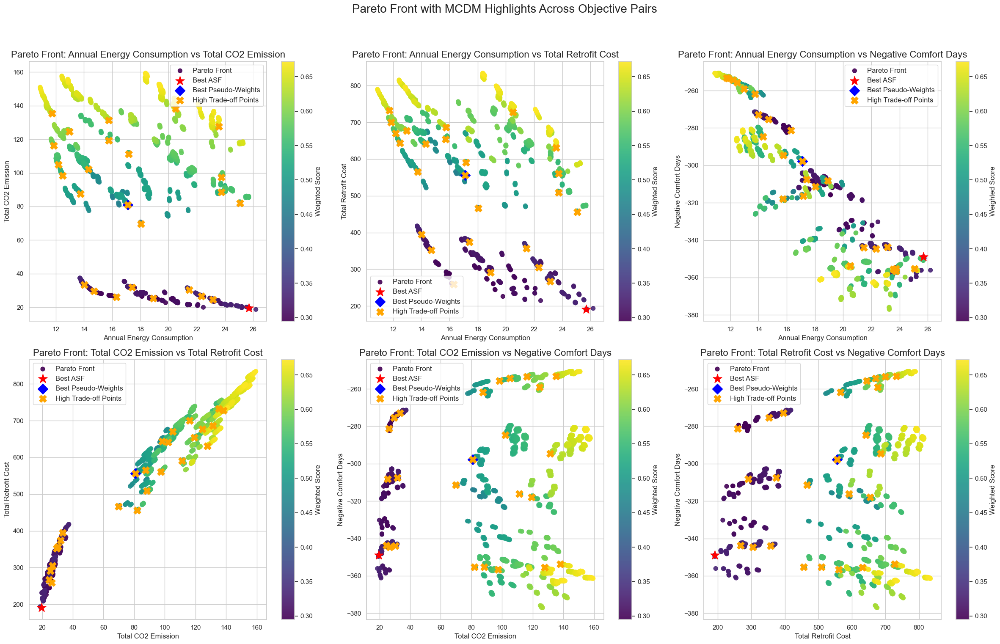

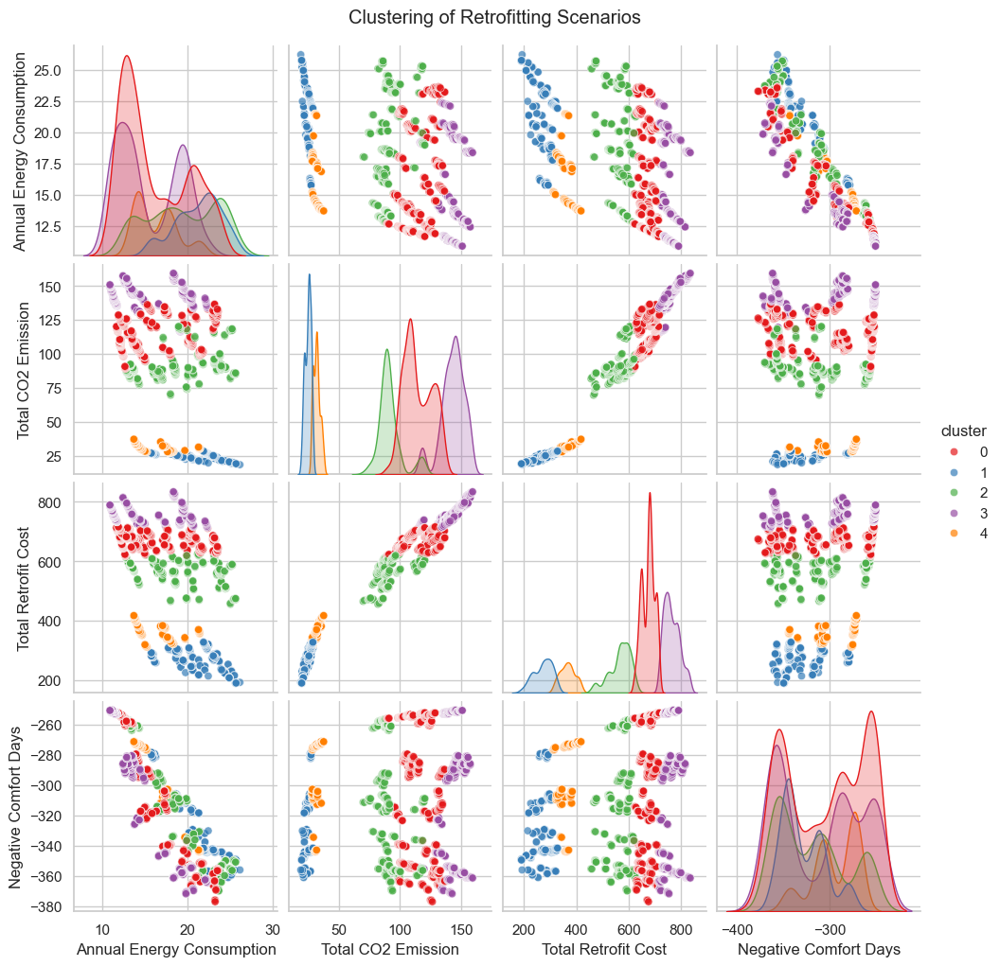

Sensitivity Analysis for Annual Energy Consumption:
Time Horizon                        -0.101247
Windows U-Factor                     1.416663
Ground Floor Thermal Resistance     -0.487089
External Walls Thermal Resistance   -0.498262
Roof Thermal Resistance             -0.231774
dtype: float64


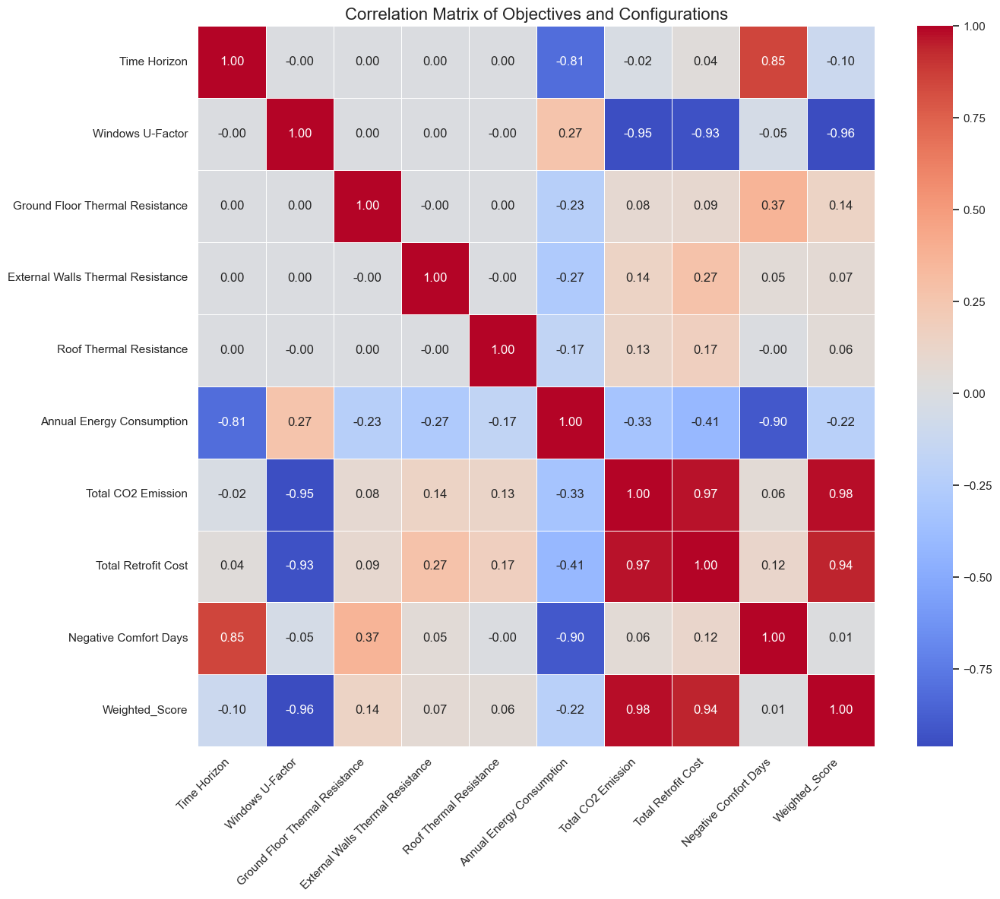

In [140]:
# Extract Weighted_Score
weighted_scores_11_1 = df_pareto_11_1_with_score['Weighted_Score'].values

# Function 1: Plot Pareto Front with MCDM Highlights
plot_pareto_front_with_mcdm(
    pareto_df=df_pareto_11_1_with_score,
    weighted_scores=weighted_scores_11_1,
    best_asf=best_asf_11_1,
    best_pseudo=best_pseudo_11_1,
    tradeoff_solutions=tradeoff_11_1
)


# Function 2: Perform Clustering
df_pareto_11_1_with_score = cluster_scenarios(df_pareto_11_1_with_score, n_clusters=5)

# Function 3: Plot Clustering Results
plot_clusters(df_pareto_11_1_with_score)

# Function 4: Perform Sensitivity Analysis
coefficients_11_1 = perform_sensitivity_analysis(df_pareto_11_1_with_score)

# Function 5: Plot Correlation Matrix
plot_correlation_matrix(df_pareto_11_1_with_score)

# Function 6: Plot 3D Scatter Plot
plot_3d_scatter(df_pareto_11_1_with_score)

# Function 7: Plot Parallel Coordinates
plot_parallel_coordinates(df_pareto_11_1_with_score)


# Function 9: Plot Density-Based Pareto Front
#plot_density_based_pareto(
#    pareto_df=df_pareto_11_1_with_score,
#    weighted_scores=weighted_scores_11_1,
#    title='Density-Based Pareto Front - Approach 11.1')




### 13. Post-Processing for boundaries (11.2)


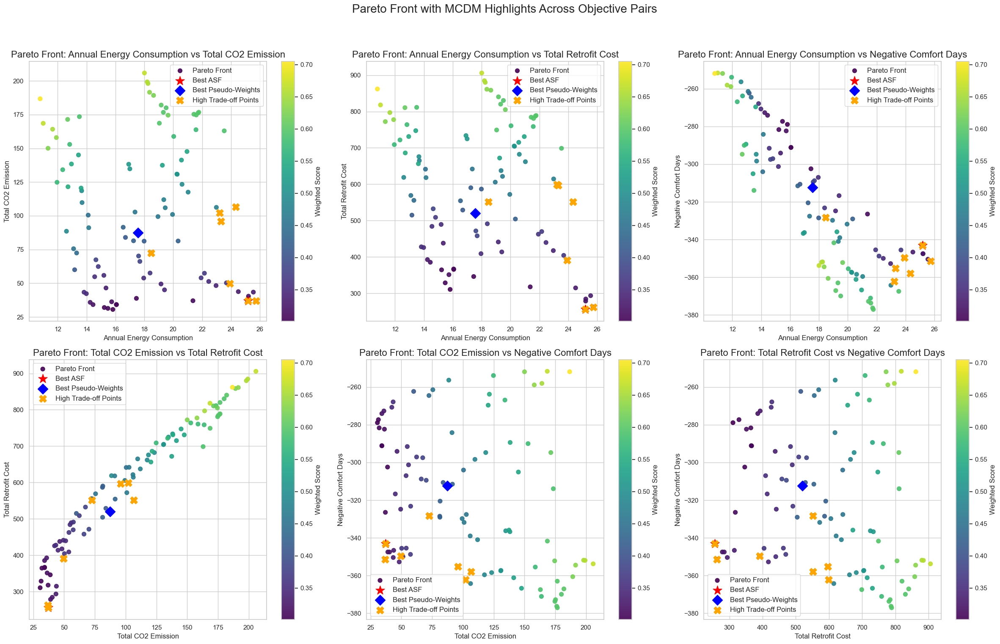

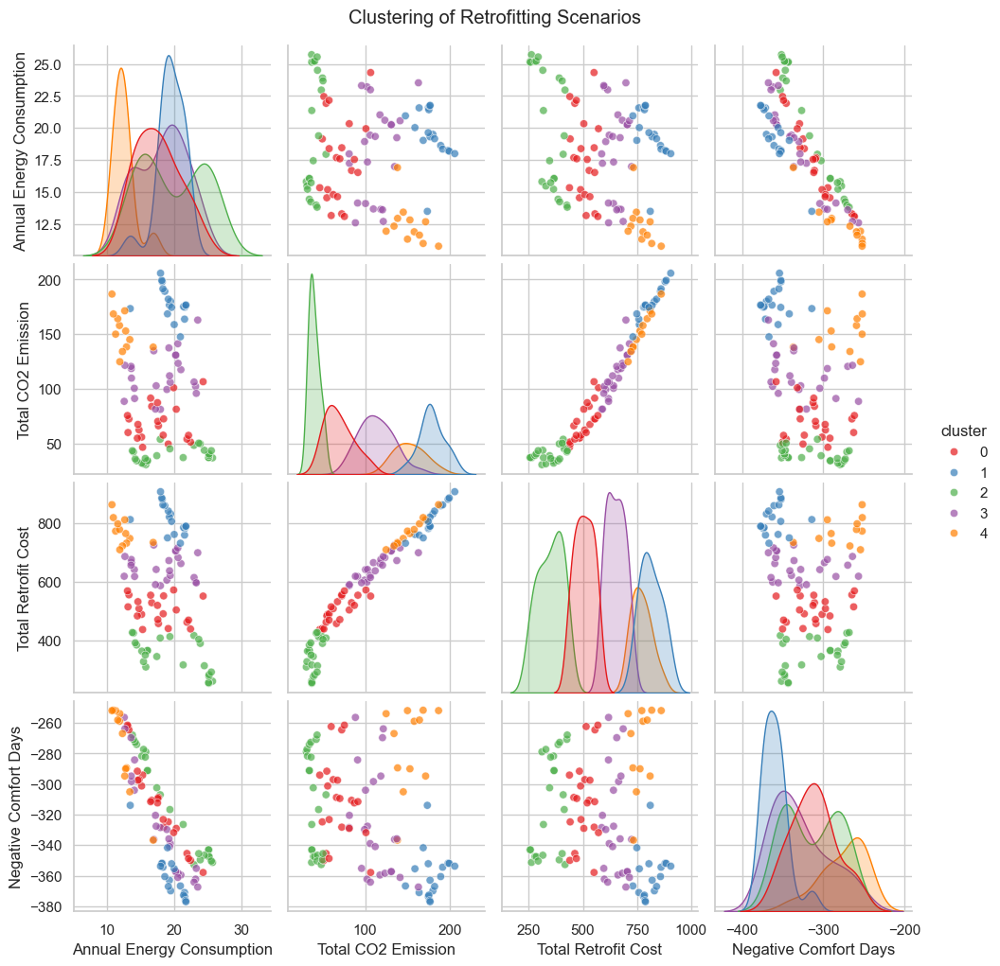

Sensitivity Analysis for Annual Energy Consumption:
Time Horizon                        -0.105204
Windows U-Factor                     1.333017
Ground Floor Thermal Resistance     -0.387638
External Walls Thermal Resistance   -0.561999
Roof Thermal Resistance             -0.320378
dtype: float64


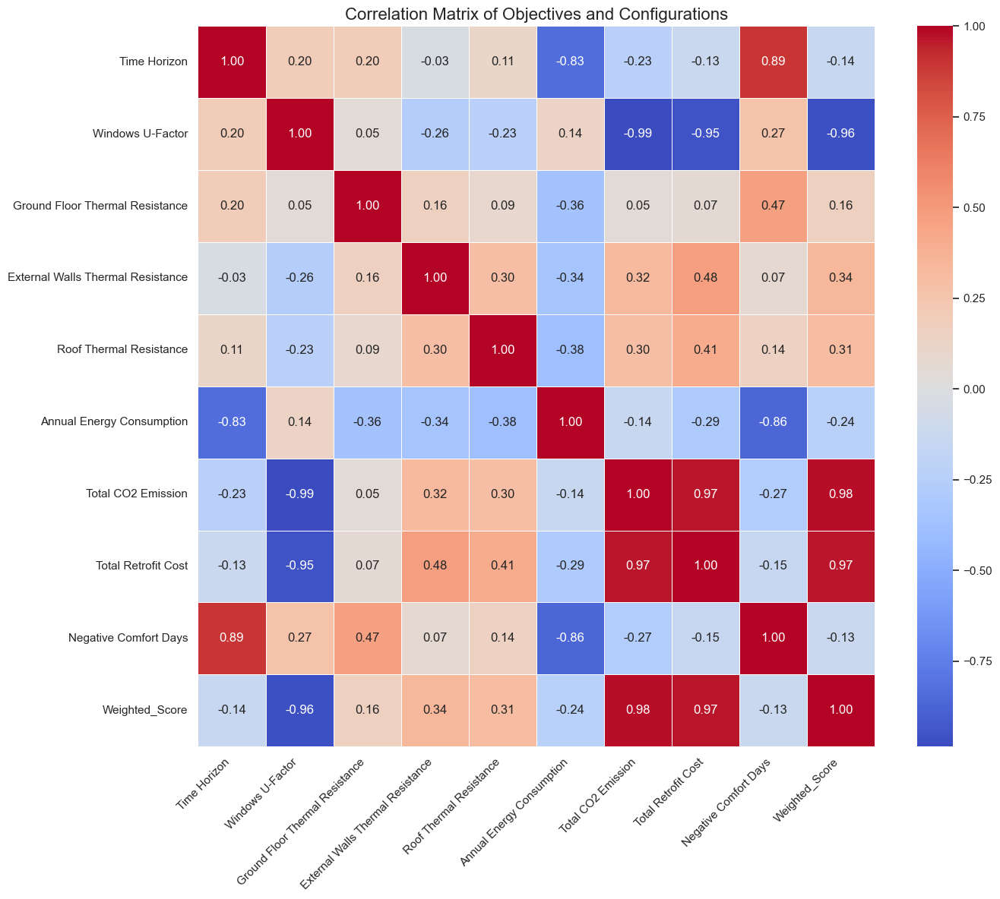

In [141]:
# Extract Weighted_Score
weighted_scores_11_2 = df_pareto_11_2_with_score['Weighted_Score'].values

# Function 1: Plot Pareto Front with MCDM Highlights
plot_pareto_front_with_mcdm(
    pareto_df=df_pareto_11_2_with_score,
    weighted_scores=weighted_scores_11_2,
    best_asf=best_asf_11_2,
    best_pseudo=best_pseudo_11_2,
    tradeoff_solutions=tradeoff_11_2
)

# Function 2: Perform Clustering
df_pareto_11_2_with_score = cluster_scenarios(df_pareto_11_2_with_score, n_clusters=5)

# Function 3: Plot Clustering Results
plot_clusters(df_pareto_11_2_with_score)


# Function 4: Perform Sensitivity Analysis
coefficients_11_2 = perform_sensitivity_analysis(df_pareto_11_2_with_score)

# Function 5: Plot Correlation Matrix
plot_correlation_matrix(df_pareto_11_2_with_score)


# Function 6: Plot 3D Scatter Plot
plot_3d_scatter(df_pareto_11_2_with_score)

# Function 7: Plot Parallel Coordinates
plot_parallel_coordinates(df_pareto_11_2_with_score)




## df inputs

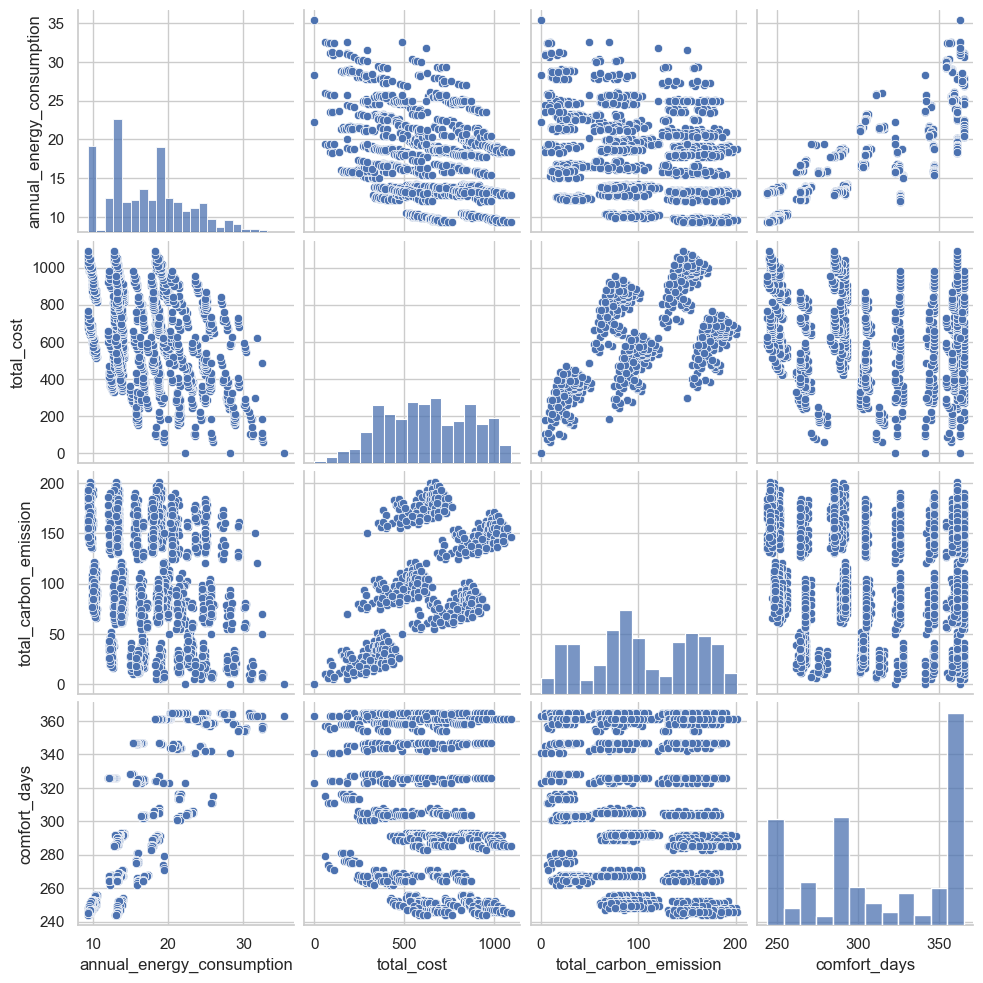

In [142]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = df_outputs.drop(columns=['Simulation ID'])
sns.pairplot(df)
plt.show()

